## Notebook for plotting t-SNE embeddings & histogram plots

**Created on 12th July, 2024; modified on 25th August, 2024**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.colors as mcolors
from matplotlib.patches import Circle
mpl.rcParams['figure.dpi'] = 300
# mpl.rcParams['figure.figsize'] = (4, 3)
mpl.rcParams['font.size'] = 8
mpl.rcParams['font.family'] = 'Arial'
mpl.rcParams['ps.fonttype'] = 42
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as py
import colorsys
import os, sys
from sklearn.decomposition import PCA
from sklearn.manifold import MDS, TSNE
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, MaxAbsScaler, Normalizer
from typing import List
from rdkit import Chem
from rdkit.Chem import AllChem, Descriptors, Draw, PandasTools, rdMolDescriptors, Fragments
import optuna
from scipy.spatial import distance
from sklearn.neighbors import NearestNeighbors
from scipy.stats import rankdata
import scipy
from scipy.spatial.distance import pdist, squareform
from scipy.stats import gaussian_kde

from rdkit import Chem
from rdkit.Chem import AllChem, DataStructs, PandasTools, Fragments, rdMolDescriptors, Descriptors, rdDepictor
from rdkit.Chem.Draw import rdMolDraw2D
from rdkit.Chem.PandasTools import ChangeMoleculeRendering
import thermo
import plotly.express as px
from IPython.display import SVG, display
from bokeh.plotting import figure, show, output_notebook, ColumnDataSource
from bokeh.models import HoverTool, ColorBar, CategoricalColorMapper
from bokeh.transform import factor_cmap
from bokeh.plotting import figure, output_file, save
from bokeh.transform import linear_cmap
from bokeh.palettes import Turbo256, d3
import pdb
# output_notebook()
from bokeh.models import GlyphRenderer

In [2]:
%%bash
pwd
ls -ltr

/Users/riteshk/Library/CloudStorage/Box-Box/Research-postdoc/AD-AFB/red-embed-opt
total 69696
-rw-r--r--@ 1 riteshk  staff  197774334 Aug  3  2024 unlabel_tsne.csv
-rw-r--r--@ 1 riteshk  staff      29496 Aug  4  2024 label_ecfp_pca_add_feat_082423.csv
-rw-r--r--  1 riteshk  staff   13278632 Aug  4  2024 unlabel_ini_sota_uniq_080424.csv
-rw-------@ 1 riteshk  staff        148 Aug  4  2024 param_tsne_default_openTSNE.csv
-rw-------@ 1 riteshk  staff   27849407 Aug  4  2024 tsne_default_openTSNE.csv
-rw-------@ 1 riteshk  staff    6208336 Aug  7  2024 X_tsne_trial_4_openTSNE.npy
-rw-------@ 1 riteshk  staff    6208336 Aug  7  2024 X_tsne_trial_5_openTSNE.npy
-rw-------@ 1 riteshk  staff    6208336 Aug  7  2024 X_tsne_trial_6_openTSNE.npy
-rw-------@ 1 riteshk  staff    6208336 Aug  7  2024 X_tsne_trial_7_openTSNE.npy
-rw-------@ 1 riteshk  staff    6208336 Aug  7  2024 X_tsne_trial_8_openTSNE.npy
-rw-------@ 1 riteshk  staff    6208336 Aug  7  2024 X_tsne_trial_9_openTSNE.npy
-rw-------@ 

### Solvent class distribution -> mutually exclusive distribution (not using now)

#### Histogram: bar plot

In [123]:
df_or = pd.read_csv('unlabel_ini_sota_uniq_080424.csv')
df_or

,std_smiles,expt_test,class
0,CN(C)C=O,0,Amide
1,CN1CCN(C)C1=O,0,Amide
2,CN(C)C(=O)N(C)C,0,Amide
3,CB(C)C=O,0,Others
4,[CH2]N(C)C=O,0,Amide
...,...,...,...
388008,COCCOCC1CCCO1,-1,Ether
388009,FC(F)COCCOCC(F)F,-2,Ether
388010,FC(F)COCCOCC(F)(F)F,-2,Ether
388011,FCCOCCF,-2,Ether


In [125]:
df_or.loc[df_or['std_smiles'] == 'CN1COCC1=O']

,std_smiles,expt_test,class
56,CN1COCC1=O,0,Ether


In [124]:
classes = df_or['class'].unique().tolist()
classes

['Amide',
 'Others',
 'Ether',
 'Amine',
 'Nitro',
 'Ketone',
 'Anhydride',
 'Sulfoxide',
 'Ester',
 'Silyl ether',
 'Sulfonyl fluoride',
 'Carbonate',
 'Sulfonate ester',
 'Sulfone',
 'Sulfonyl chloride']

In [4]:
blue = (0, 0.576, 0.902) # 0, 147, 230
green = (0.349,0.745,0.306) # 89, 190, 78
red = (0.984, 0.262, 0.219) # 251, 67, 56 
orange = (0.984, 0.713, 0.305) # 251, 182, 78 
purple = (0.839, 0.286, 0.604) # 214, 73, 1541
anvil = (0.298, 0.78, 0.77) # 76, 199, 196
dark_purple = (0.557, 0, 0.998) # 142, 0, 252
pink = (0.95, 0.78, 0.996) # 242, 199, 154
gray = (0.463,0.463,0.463) # 118, 118, 118
c1 = '#396b3a'
c2 = '#6ea397'
c3 = '#b56171'
c4 = '#79204e'
c5 = '#a5ebcc'
c6 = '#ffd266'
c7 = '#d27672'

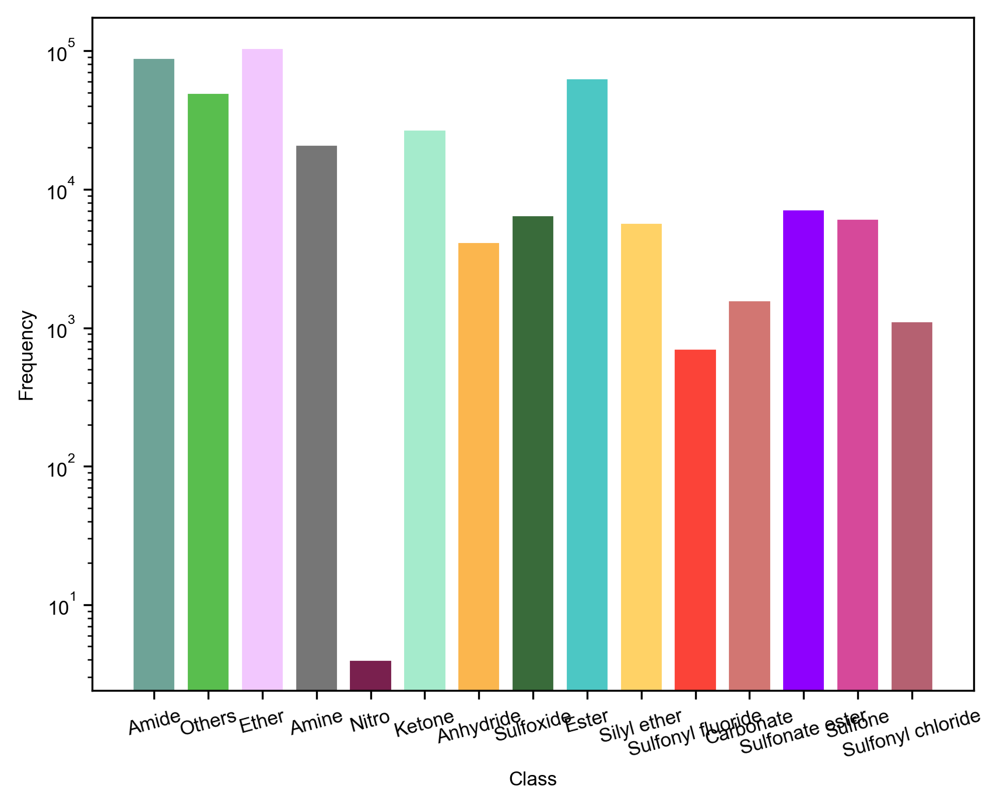

In [17]:
fig, ax = plt.subplots(figsize=(6.5, 5))
# Define colors
colors = [c2, green, pink, gray, c4, c5, orange, c1, anvil, c6, red, c7, dark_purple, purple, c3]

# Plot histogram for 'class' column
# class_counts = df_or['class'].value_counts().sort_index()
# class_counts = df_or['class'].value_counts()
# classes = class_counts.index
classes = df_or['class'].unique().tolist()
# Calculate class counts and reindex to match the order of 'classes' list
class_counts = df_or['class'].value_counts().reindex(classes).fillna(0).astype(int)
frequencies = class_counts.values

# Create bar plot
bars = plt.bar(classes, frequencies, color=colors[:len(classes)], edgecolor='white')

# Rotate x-axis labels
plt.xticks(rotation=15)

# Calculate fractions
total = frequencies.sum()
fractions = frequencies / total

# Create legend with fractions
legend_labels = [f'{cls}: {frac:.3%}' for cls, frac in zip(classes, fractions)]
# plt.legend(bars, legend_labels, title="Class Fractions", frameon=False, loc=(1.01, 0.1))
# Set y-axis scale to logarithmic
plt.yscale('log')

plt.xlabel('Class')
plt.ylabel('Frequency')
# plt.title('Histogram of Class Column')
plt.show()

#### Pie chart

In [7]:
patch_colors = [colors[i % len(colors)] for i in range(len(classes))]
patch_colors

['#6ea397',
 (0.349, 0.745, 0.306),
 (0.95, 0.78, 0.996),
 (0.463, 0.463, 0.463),
 '#79204e',
 '#a5ebcc',
 (0.984, 0.713, 0.305),
 '#396b3a',
 (0.298, 0.78, 0.77),
 '#ffd266',
 (0.984, 0.262, 0.219),
 '#d27672',
 (0.557, 0, 0.998),
 (0.839, 0.286, 0.604),
 '#b56171']

([<matplotlib.patches.Wedge at 0x332c8d370>,
 [Text(-1.0997265712296678, -0.024524855380581946, 'Amide'),
  Text(-0.45271334821247083, -1.0025221316012203, 'Others'),
  Text(0.8097528125777809, -0.7445135207115942, 'Ether'),
  Text(1.058720689854806, 0.29851382023846723, 'Amine'),
  Text(0.9926236808284963, 0.47402344695013526, 'Nitro'),
  Text(0.8662685072117902, 0.677922468585499, 'Ketone'),
  Text(0.6697051636167307, 0.872636805220298, 'Anhydride'),
  Text(0.5918909216299811, 0.9271812858831933, 'Sulfoxide'),
  Text(0.0035144954009096903, 1.099994385586616, 'Ester'),
  Text(-0.5800254539542397, 0.9346499198979147, 'Silyl ether'),
  Text(-0.6278693379746949, 0.9032054552709581, 'Sulfonyl fluoride'),
  Text(-0.6445070186147873, 0.8914093913327806, 'Carbonate'),
  Text(-0.7059282522128209, 0.8436025739219577, 'Sulfonate ester'),
  Text(-0.79263678968507, 0.7627102461864179, 'Sulfone'),
  Text(-0.8362082979448212, 0.714671730550625, 'Sulfonyl chloride')],
 [Text(-0.5998508570343642, -0.

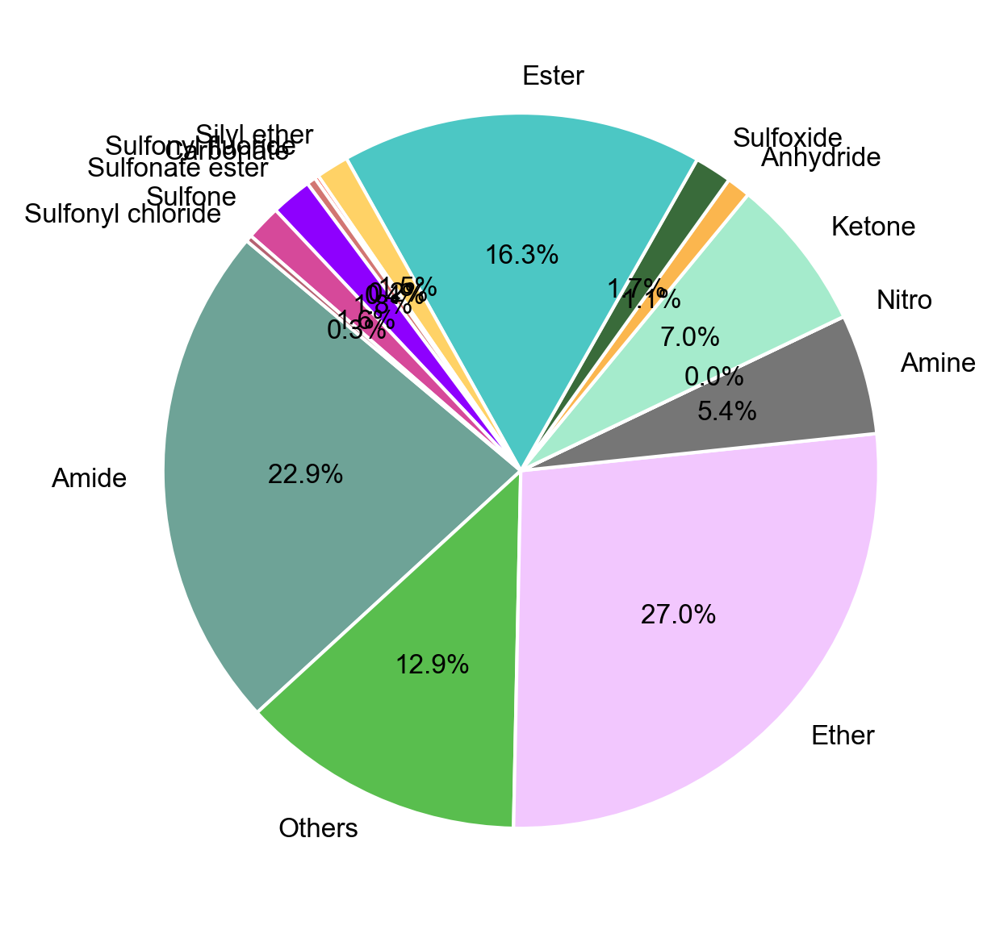

In [19]:
plt.pie(frequencies, labels=classes, colors=patch_colors, autopct='%1.1f%%', startangle=140,
        wedgeprops=dict(edgecolor='w'))

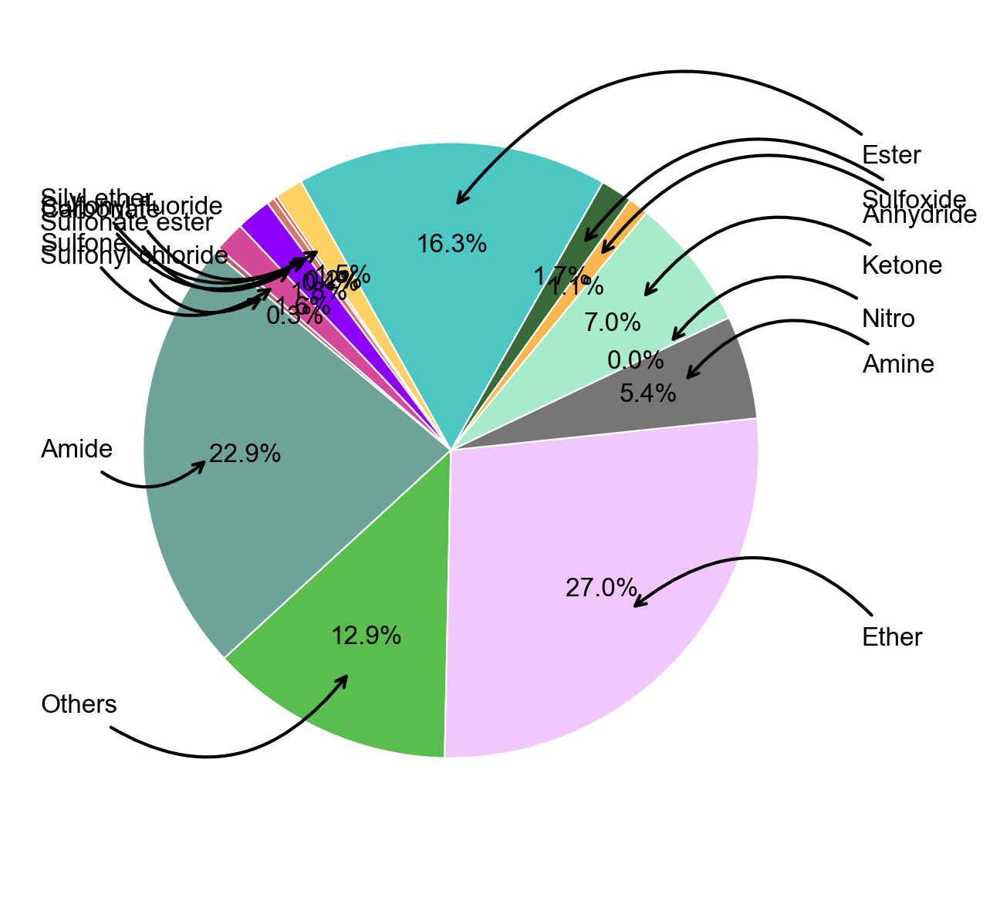

In [22]:
# Create pie chart
fig, ax = plt.subplots()
wedges, texts, autotexts = ax.pie(frequencies, colors=patch_colors, autopct='%1.1f%%', startangle=140,
                                  wedgeprops=dict(edgecolor='w', linewidth=0.5))

# Draw arrows from pie wedges to legends (classes)
for i, (wedge, text, autotext) in enumerate(zip(wedges, texts, autotexts)):
    text.set_horizontalalignment('center')
    text.set_verticalalignment('center')
    text.set_fontsize(10)
    autotext.set_fontsize(8)
    autotext.set_color('black')
    
    # Calculate the angle for the arrow
    angle = (wedge.theta2 - wedge.theta1) / 2. + wedge.theta1
    x = wedge.r * 0.7 * np.cos(np.deg2rad(angle))
    y = wedge.r * 0.7 * np.sin(np.deg2rad(angle))
    
    # Draw arrow -> frequency number on wedges
    ax.annotate(classes[i], xy=(x, y), xytext=(1.2 * np.sign(x), 1.2 * y),
                arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=.5"))
    # # Draw arrow -> frequency number below classes
    # ax.annotate(f'{classes[i]}\n{frequencies[i]}', xy=(x, y), xytext=(1.2 * np.sign(x), 1.2 * y),
    #             arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=.5"),
    #             horizontalalignment='center', verticalalignment='center')

# Reduce the edge length of wedges slightly compared to default values
for wedge in wedges:
    wedge.set_radius(wedge.r * 0.9)

plt.show()

### Solvent class distribution -> inclusive distribution (using this as of Sept 1, 2024) -> Peiyuan used his own version

#### Histogram: bar plot

In [120]:
df_classes_num = pd.read_csv('fgrp_class_num_083024_incl.csv')
df_classes_num.drop(columns=['Total'], inplace=True)
df_classes_num

,Carbonate,Sulfone,Ether,Ester,Sulfoxide,Sulfonyl fluoride,Sulfonyl chloride,Sulfonate ester,Amine,Amide,Nitro,Ketone,Anhydride,Imide,Silyl ether,Others
0,1886,6308,126973,68682,6693,709,1122,7188,131136,170085,11,51000,4165,39701,12709,35160


In [8]:
df_classes_num.iloc[0,:].values

array([  1886,   6308, 126973,  68682,   6693,    709,   1122,   7188,
       131136, 170085,     11,  51000,   4165,  39701,  12709,  35160])

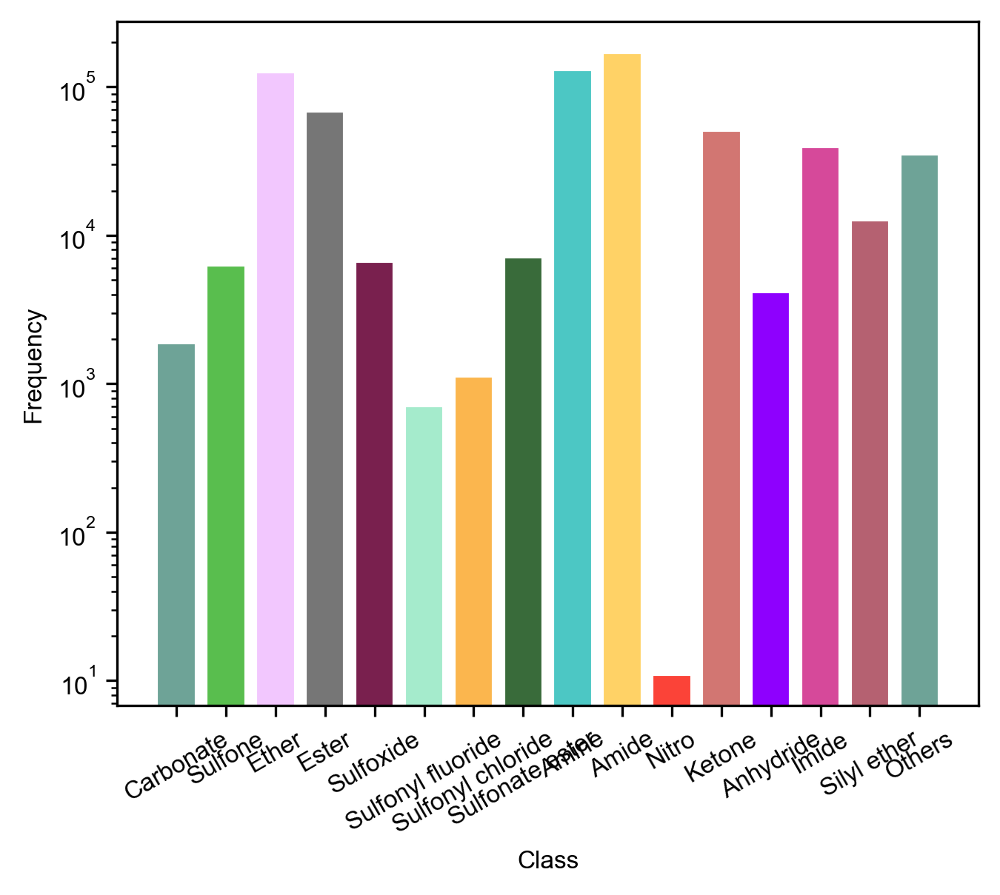

In [122]:
fig, ax = plt.subplots(figsize=(5,4))
# Define colors
colors = [c2, green, pink, gray, c4, c5, orange, c1, anvil, c6, red, c7, dark_purple, purple, c3]

# Plot histogram for 'class' column
classes = df_classes_num.columns.tolist()
frequencies = df_classes_num.iloc[0,:].values

# # Calculate class counts and reindex to match the order of 'classes' list
# class_counts = df_or['class'].value_counts().reindex(classes).fillna(0).astype(int)
# frequencies = class_counts.values

# Create bar plot
bars = plt.bar(classes, frequencies, color=colors[:len(classes)], edgecolor='white')

# Rotate x-axis labels
plt.xticks(rotation=30)

# Calculate fractions
total = frequencies.sum()
fractions = frequencies / total

# Create legend with fractions
legend_labels = [f'{cls}: {frac:.3%}' for cls, frac in zip(classes, fractions)]
# plt.legend(bars, legend_labels, title="Class Fractions", frameon=False, loc=(1.01, 0.1))
# Set y-axis scale to logarithmic
plt.yscale('log')

plt.xlabel('Class')
plt.ylabel('Frequency')
# plt.title('Histogram of Class Column')
plt.show()

### t-SNE plot for acquisitions from different batches

In [3]:
# df_tsne = pd.read_csv('../red-embed-opt_090124/tsne_default_openTSNE.csv')
# df_tsne

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
0,CN(C)C=O,0,['Amide'],0,-29.652721,-91.122684
1,CN1CCN(C)C1=O,0,['Amide'],0,63.663623,30.721911
2,CN(C)C(=O)N(C)C,0,['Amide'],0,-63.760388,9.938176
3,CB(C)C=O,0,['Others'],1,-11.815345,-51.883275
4,[CH2]N(C)C=O,0,['Amide'],0,-29.670045,-91.193283
...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,-1,['Ether'],7,-20.242432,-20.010327
388009,FC(F)COCCOCC(F)F,-2,['Ether'],7,4.972566,-54.523802
388010,FC(F)COCCOCC(F)(F)F,-2,['Ether'],7,23.341277,-78.180018
388011,FCCOCCF,-2,['Ether'],7,16.235649,-47.809552


In [4]:
# df_label_all = pd.read_csv('label_ecfp_pca_add_feat_iter_7_051124_batch.csv')
# df_label_all

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_14,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.022233,0.02168,0.022967,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.000573,0.00046,0.000360,0.000407,0.0006,0.000593,0.000447,0.000333,0.0,0.0
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
194,COC1CCCCC1=O,[Li+].F[P-](F)(F)(F)(F)F,NaN,0.996265,-0.567873,1.168385,-0.494515,-0.269926,0.307456,-0.150987,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
195,COC1CCCCC1=O,[Li+].O=C1O[B-](F)(F)OC1=O,NaN,0.996265,-0.567873,1.168385,-0.494515,-0.269926,0.307456,-0.150987,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
196,COCCS(=O)(=O)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,NaN,-0.774656,-1.131648,1.061661,-0.391643,-0.188458,0.184919,0.733522,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
197,COCCSC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,NaN,-0.819883,-1.431011,0.956715,-0.464875,-0.484067,0.206120,0.691785,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0


#### no need to run these again...

In [24]:
df_label_6 = pd.read_csv('../campaign-6/just_label_iter_6.csv')
df_label_5 = pd.read_csv('../campaign-5/just_label_iter_5.csv')
df_label_4 = pd.read_csv('../campaign-4/just_label_iter_4.csv')
df_label_3 = pd.read_csv('../campaign-3/just_label_iter_3.csv')
df_label_2 = pd.read_csv('../campaign-2/just_label_iter_2.csv')
df_label_6

,index_3,index_2,index_1,index_0,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,...,salt_ecfp_pca_7,salt_ecfp_pca_8,salt_ecfp_pca_9,mol_wt_solv,mol_wt_salt,conc_salt_1,conc_salt_2,theor_capacity,amt_electrolyte,pressure_type
0,95149,95152,95158,95164,COCCOCC(OC)OC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.171924,-1.054353,0.913877,-0.509980,...,0.258767,0.301779,-0.272648,164.104859,186.939685,1.0,0.0,150,50,2
1,424107,424116,424134,424155,COCCOCC(OC)OC,[Li+].F[P-](F)(F)(F)(F)F,-1.171924,-1.054353,0.913877,-0.509980,...,0.195230,0.319099,-0.209425,164.104859,151.980186,1.0,0.0,150,50,2
2,753093,753106,753133,753166,COCCOCC(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.171924,-1.054353,0.913877,-0.509980,...,0.008496,0.161338,0.109063,164.104859,144.001775,1.0,0.0,150,50,2
3,26837,26838,26839,26842,COCCCCCl,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.895787,-1.564556,0.936152,-0.167522,...,0.258767,0.301779,-0.272648,122.049843,186.939685,1.0,0.0,150,50,2
4,373015,373023,373037,373055,COCCCCCl,[Li+].F[P-](F)(F)(F)(F)F,-0.895787,-1.564556,0.936152,-0.167522,...,0.195230,0.319099,-0.209425,122.049843,151.980186,1.0,0.0,150,50,2
5,699458,699470,699493,699523,COCCCCCl,[Li+].O=C1O[B-](F)(F)OC1=O,-0.895787,-1.564556,0.936152,-0.167522,...,0.008496,0.161338,0.109063,122.049843,144.001775,1.0,0.0,150,50,2
6,125053,125056,125062,125071,COCC(F)(F)C(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.682909,-1.492217,1.039659,-0.738617,...,0.258767,0.301779,-0.272648,164.026056,186.939685,1.0,0.0,150,50,2
7,389881,389890,389906,389926,COCC(F)(F)C(F)(F)F,[Li+].F[P-](F)(F)(F)(F)F,-0.682909,-1.492217,1.039659,-0.738617,...,0.195230,0.319099,-0.209425,164.026056,151.980186,1.0,0.0,150,50,2
8,754617,754630,754657,754690,COCC(F)(F)C(F)(F)F,[Li+].O=C1O[B-](F)(F)OC1=O,-0.682909,-1.492217,1.039659,-0.738617,...,0.008496,0.161338,0.109063,164.026056,144.001775,1.0,0.0,150,50,2
9,3278,3278,3278,3279,CCOCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.084384,-1.014022,0.862732,0.014255,...,0.258767,0.301779,-0.272648,104.083730,186.939685,1.0,0.0,150,50,2


In [33]:
df_label_6
str('df_label_6').split('_')[-1]

'6'

In [25]:
def find_batch_num(df, num):
    # batch = f'{df}'.split('_')[-1]
    uniq_solv = df['solv_comb_sm'].unique().tolist()
    for i in range(len(df_label_all)):
        if df_label_all['solv_comb_sm'][i] in uniq_solv:
            df_label_all['batch'][i] = num-1
    return df_label_all


In [26]:
find_batch_num(df_label_6, 6)
find_batch_num(df_label_5, 5)
find_batch_num(df_label_4, 4)
find_batch_num(df_label_3, 3)
# find_batch_num(df_label_2, 2)

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_85291/1748052809.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_label_all['batch'][i] = num-1
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_85291/1748052809.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_label_all['batch'][i] = num-1
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_85291/1748052809.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versu

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_14,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.022233,0.02168,0.022967,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.000573,0.00046,0.000360,0.000407,0.0006,0.000593,0.000447,0.000333,0.0,0.0
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
194,COC1CCCCC1=O,[Li+].F[P-](F)(F)(F)(F)F,NaN,0.996265,-0.567873,1.168385,-0.494515,-0.269926,0.307456,-0.150987,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
195,COC1CCCCC1=O,[Li+].O=C1O[B-](F)(F)OC1=O,NaN,0.996265,-0.567873,1.168385,-0.494515,-0.269926,0.307456,-0.150987,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
196,COCCS(=O)(=O)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,NaN,-0.774656,-1.131648,1.061661,-0.391643,-0.188458,0.184919,0.733522,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0
197,COCCSC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,NaN,-0.819883,-1.431011,0.956715,-0.464875,-0.484067,0.206120,0.691785,...,0.000000,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0


In [87]:
df_label_all.loc[df_label_all['batch'] == 5]
# df_label_all.loc[df_label_all['batch'] == pd.notna]
df_label_all.loc[df_label_all['batch'] == 4]
# df_label_all.loc[df_label_all['batch'] == 3]
# df_label_all.loc[df_label_all['batch'] == 2]
df_label_all.loc[df_label_all['batch'] == 0]

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.021680,0.022967,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.000460,0.000360,0.000407,0.000600,0.000593,0.000447,0.000333,0.000000,0.000000,0.0
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
5,CCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.092295,-1.519334,-0.056200,-0.093036,-0.572012,-0.583818,-0.053796,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
6,CCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.092295,-1.519334,-0.056200,-0.093036,-0.572012,-0.583818,-0.053796,...,0.146987,0.135520,0.122253,0.109647,0.104447,0.098607,0.088353,0.000000,0.000000,0.0
7,CCCCOCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.067892,-1.253529,0.602357,0.775134,-0.714364,1.295648,0.646532,...,0.023487,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
8,COCCOC1CCCC1,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,0.394637,-0.462672,0.854416,-0.416162,-1.007141,1.060702,0.662827,...,0.019667,0.019633,0.021167,0.022867,0.026233,0.025507,0.025267,0.000000,0.000000,0.0
9,CCCCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.075803,-1.758840,-0.316575,0.667843,-0.912376,0.097061,-0.035434,...,0.044827,0.041993,0.037160,0.043613,0.046513,0.048480,0.050413,0.000000,0.000000,0.0


In [28]:
df_label_all['batch'][183:] = 6
df_label_all.iloc[183:]

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_85291/3189194787.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_label_all['batch'][183:] = 6


,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_14,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23
183,COCCOCCOCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,-0.899245,-1.039674,1.079794,-0.351354,-0.360827,0.421555,0.804488,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
184,COCCOCCOCCOCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,-0.899245,-1.039674,1.079794,-0.351354,-0.360827,0.421555,0.804488,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
185,COC1CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,0.807314,-0.951595,0.879080,-0.605456,-0.644732,0.730071,0.164348,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
186,COCCCCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,-0.946328,-1.547746,0.906366,0.007913,-0.568101,0.750411,0.805634,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
187,COC(=O)C1CCCCCC1=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,0.719334,0.636090,1.590740,-0.247047,-0.124693,0.317496,-0.297293,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
188,COC(=O)C1CCCCCC1=O,[Li+].F[P-](F)(F)(F)(F)F,6.0,0.719334,0.636090,1.590740,-0.247047,-0.124693,0.317496,-0.297293,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
189,COC(=O)C1CCCCCC1=O,[Li+].O=C1O[B-](F)(F)OC1=O,6.0,0.719334,0.636090,1.590740,-0.247047,-0.124693,0.317496,-0.297293,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
190,COCCOCOCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,-0.900062,-1.026422,1.018114,-0.356201,-0.343756,0.403599,0.757477,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
191,CCCCOCCOCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,-1.067892,-1.253529,0.602357,0.775134,-0.714364,1.295648,0.646532,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
192,CCOCCOCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,-1.097146,-1.027000,0.868116,0.014163,-0.384779,0.651601,0.660382,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [86]:
print("# unique solvents for batch-0: ", len(df_label_all.loc[df_label_all['batch'] == 0]['solv_comb_sm'].unique()))
print("# unique solvents for batch-1: ", len(df_label_all.loc[df_label_all['batch'] == 1]['solv_comb_sm'].unique()))
print("# unique solvents for batch-2: ", len(df_label_all.loc[df_label_all['batch'] == 2]['solv_comb_sm'].unique()))
print("# unique solvents for batch-3: ", len(df_label_all.loc[df_label_all['batch'] == 3]['solv_comb_sm'].unique()))
print("# unique solvents for batch-4: ", len(df_label_all.loc[df_label_all['batch'] == 4]['solv_comb_sm'].unique()))
print("# unique solvents for batch-5: ", len(df_label_all.loc[df_label_all['batch'] == 5]['solv_comb_sm'].unique()))
print("# unique solvents for batch-6: ", len(df_label_all.loc[df_label_all['batch'] == 6]['solv_comb_sm'].unique()))
# len(df_label_all.loc[df_label_all['batch'] == 7]['solv_comb_sm'].unique())

# unique solvents for batch-0:  25
# unique solvents for batch-1:  14
# unique solvents for batch-2:  11
# unique solvents for batch-3:  7
# unique solvents for batch-4:  9
# unique solvents for batch-5:  11
# unique solvents for batch-6:  11


#### ...till here

In [4]:
# # df_label_all.to_csv('label_all_ecfp_pca_add_feat_090524.csv', index=False)
# df_label_all = pd.read_csv('label_all_ecfp_pca_add_feat_090524.csv')
# df_label_all

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.02168,0.022967,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.00046,0.000360,0.000407,0.0006,0.000593,0.000447,0.000333,0.0,0.0,0.0
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
194,COC1CCCCC1=O,[Li+].F[P-](F)(F)(F)(F)F,6.0,0.996265,-0.567873,1.168385,-0.494515,-0.269926,0.307456,-0.150987,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,6.0
195,COC1CCCCC1=O,[Li+].O=C1O[B-](F)(F)OC1=O,6.0,0.996265,-0.567873,1.168385,-0.494515,-0.269926,0.307456,-0.150987,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,6.0
196,COCCS(=O)(=O)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,-0.774656,-1.131648,1.061661,-0.391643,-0.188458,0.184919,0.733522,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,6.0
197,COCCSC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,6.0,-0.819883,-1.431011,0.956715,-0.464875,-0.484067,0.206120,0.691785,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,6.0


In [5]:
# # full_cap_7 = [115.6 (2), 34.4 (3), 0 (1), 66.3 (7), 108.9 (6), 0.01 (9), 116.5(4), 115.8 (5), 123 (8)]
# full_cap_7 = [0.0, 115.6, 34.4, 116.5, 115.8, 108.9, 66.3, 123, 0.01] # manually looked at molecular structures two cells below & then edited cell below
# norm_cap_3 = [cap/150.0 for cap in full_cap_7]
# norm_cap_3

[0.0,
 0.7706666666666666,
 0.22933333333333333,
 0.7766666666666666,
 0.772,
 0.7260000000000001,
 0.442,
 0.82,
 6.666666666666667e-05]

In [6]:
# iter_7_smiles = ['COCCOS(=O)(=O)C(F)(F)F', 'COCCOCC(F)F', 'COC1CCCCO1', 'COCCCOCCCC', 'COCCCCOCC', 'COCCCCOCC(F)(F)F', 'COCCCOCC(C)(C)C', 'COCCCOCC(C(F)F)(F)F', 'COCCCF'] # manually added
# iter_7_sm_std = [Chem.MolToSmiles(Chem.MolFromSmiles(sm)) for sm in iter_7_smiles]
# df_iter_7 = pd.DataFrame({'solv_comb_sm': iter_7_sm_std, 'salt_comb_sm': '[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F', 'theor_capacity': 150.0, 'norm_capacity_3': norm_cap_3, 'batch': 7})
# df_tt = pd.concat([df_label_all, df_iter_7], ignore_index=True)
# df_tt

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.02168,0.022967,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.00046,0.000360,0.000407,0.0006,0.000593,0.000447,0.000333,0.0,0.0,0.0
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,CCOCCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
204,COCCCCOCC(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
205,COCCCOCC(C)(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
206,COCCCOCC(F)(F)C(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


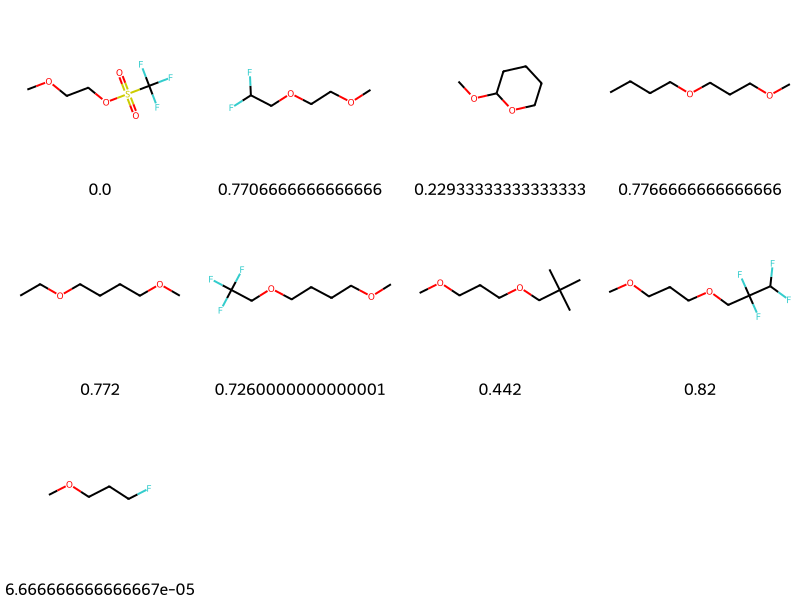

In [7]:
# PandasTools.AddMoleculeColumnToFrame(df_tt,'solv_comb_sm')
# PandasTools.FrameToGridImage(df_tt.iloc[199:], legendsCol='norm_capacity_3', molsPerRow=4, subImgSize=(200,200), maxMols=16)
# # df_tt

In [8]:
# df_tt['theor_capacity']
# len(df_tt['norm_capacity_3'].unique())
# len(df_tt['solv_comb_sm'].unique())

97

In [5]:
# df_tt['solv_comb_sm'] = df_tt['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
# df_tt['expt_test'] = df_tt['batch']
# # df_tt.to_csv('label_all_ecfp_pca_add_feat_incl_b7_090824.csv', index=False)

In [2]:
df_tt = pd.read_csv('label_all_ecfp_pca_add_feat_incl_b7_090824.csv')
uniq_solv_all = df_tt['solv_comb_sm'].unique().tolist()

In [3]:
df_tt.loc[df_tt['norm_capacity_3'] == (df_tt.loc[df_tt['batch'] == 0]['norm_capacity_3'].max())]['norm_capacity_3']

20    0.816787
Name: norm_capacity_3, dtype: float64

In [4]:
0.816787*150

122.51805

In [9]:
# # Extract unique solvents from df_tsne
# unique_solv_tsne = df_tsne['std_smiles'].unique().tolist()

# # Filter df_label_all to include only rows with unique solvents from df_tsne
# filtered_df_label_all = df_tt[df_tt['solv_comb_sm'].isin(unique_solv_tsne)]

# # Create a dictionary to map 'solv_comb_sm' to 'expt_test'
# solv_to_expt_test = dict(zip(filtered_df_label_all['solv_comb_sm'], filtered_df_label_all['expt_test']))

# # Map 'expt_test' values to df_tsne based on 'solv_comb_sm'
# df_tsne['expt_test'] = df_tsne['std_smiles'].map(solv_to_expt_test)
# df_tsne

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
0,CN(C)C=O,NaN,['Amide'],0,-29.652721,-91.122684
1,CN1CCN(C)C1=O,NaN,['Amide'],0,63.663623,30.721911
2,CN(C)C(=O)N(C)C,NaN,['Amide'],0,-63.760388,9.938176
3,CB(C)C=O,NaN,['Others'],1,-11.815345,-51.883275
4,[CH2]N(C)C=O,NaN,['Amide'],0,-29.670045,-91.193283
...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,NaN,['Ether'],7,-20.242432,-20.010327
388009,FC(F)COCCOCC(F)F,NaN,['Ether'],7,4.972566,-54.523802
388010,FC(F)COCCOCC(F)(F)F,NaN,['Ether'],7,23.341277,-78.180018
388011,FCCOCCF,NaN,['Ether'],7,16.235649,-47.809552


In [47]:
# # filtered_df_label_all.loc[filtered_df_label_all['expt_test'] == 0]['norm_capacity_3']
# df_label_all.loc[df_label_all['expt_test'] == 0]['solv_comb_sm'][31]

'COCCOCc1ccco1'

In [10]:
# # # Filter DataFrame to include only rows with unique solvents
# # filtered_df = df_label_all[df_label_all['solv_comb_sm'].isin(uniq_solv_all)]

# # # Extract corresponding 'batch' values
# # corresponding_batches = filtered_df['batch'].tolist()
# # len(corresponding_batches)
# df_tsne['expt_test'].replace(np.nan, -1, inplace=True)
# df_tsne['expt_test'].unique()

array([-1.,  4.,  1.,  7.,  5.,  2.,  3.,  6.,  0.])

In [5]:
f5dee = Chem.MolToSmiles(Chem.MolFromSmiles('C(COCC(F)(F)F)OCC(F)F'))
f5dee

'FC(F)COCCOCC(F)(F)F'

In [12]:
# df_tsne.loc[df_tsne['std_smiles'] == 'COCCOCC1CCCO1', 'expt_test'] = 0 ## manually changing its batch number to 0
# df_tsne.loc[df_tsne['std_smiles'] == f5dee, 'expt_test'] = 8 ## manually changing its batch number to 8 (benchmark)

In [13]:
# print("# unique solvents for batch-0: ", len(df_tsne.loc[df_tsne['expt_test'] == 0]['std_smiles'].unique()))
# print("# unique solvents for batch-1: ", len(df_tsne.loc[df_tsne['expt_test'] == 1]['std_smiles'].unique()))
# print("# unique solvents for batch-2: ", len(df_tsne.loc[df_tsne['expt_test'] == 2]['std_smiles'].unique()))
# print("# unique solvents for batch-3: ", len(df_tsne.loc[df_tsne['expt_test'] == 3]['std_smiles'].unique()))
# print("# unique solvents for batch-4: ", len(df_tsne.loc[df_tsne['expt_test'] == 4]['std_smiles'].unique()))
# print("# unique solvents for batch-5: ", len(df_tsne.loc[df_tsne['expt_test'] == 5]['std_smiles'].unique()))
# print("# unique solvents for batch-6: ", len(df_tsne.loc[df_tsne['expt_test'] == 6]['std_smiles'].unique()))
# print("# unique solvents for batch-7: ", len(df_tsne.loc[df_tsne['expt_test'] == 7]['std_smiles'].unique()))

# unique solvents for batch-0:  25
# unique solvents for batch-1:  14
# unique solvents for batch-2:  11
# unique solvents for batch-3:  7
# unique solvents for batch-4:  9
# unique solvents for batch-5:  11
# unique solvents for batch-6:  11
# unique solvents for batch-7:  9


In [26]:
# df_tsne.to_csv('tsne_default_openTSNE_090124_new_class_acquisition_090824.csv', index=False)
df_tsne = pd.read_csv('tsne_default_openTSNE_090124_new_class_acquisition_090824.csv')
df_tsne

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
0,CN(C)C=O,-1.0,['Amide'],0,-29.652721,-91.122684
1,CN1CCN(C)C1=O,-1.0,['Amide'],0,63.663623,30.721911
2,CN(C)C(=O)N(C)C,-1.0,['Amide'],0,-63.760388,9.938176
3,CB(C)C=O,-1.0,['Others'],1,-11.815345,-51.883275
4,[CH2]N(C)C=O,-1.0,['Amide'],0,-29.670045,-91.193283
...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,0.0,['Ether'],7,-20.242432,-20.010327
388009,FC(F)COCCOCC(F)F,-1.0,['Ether'],7,4.972566,-54.523802
388010,FC(F)COCCOCC(F)(F)F,8.0,['Ether'],7,23.341277,-78.180018
388011,FCCOCCF,-1.0,['Ether'],7,16.235649,-47.809552


In [27]:
blue = (0, 0.576, 0.902) # 0, 147, 230
green = (0.349,0.745,0.306) # 89, 190, 78
red = (0.984, 0.262, 0.219) # 251, 67, 56 
orange = (0.984, 0.713, 0.305) # 251, 182, 78 
purple = (0.839, 0.286, 0.604) # 214, 73, 1541
anvil = (0.298, 0.78, 0.77) # 76, 199, 196
dark_purple = (0.557, 0, 0.998) # 142, 0, 252
pink = (0.95, 0.78, 0.996) # 242, 199, 154
gray = (0.463,0.463,0.463) # 118, 118, 118
c1 = '#396b3a'
c2 = '#6ea397'
c3 = '#b56171'
c4 = '#79204e'
c5 = '#a5ebcc'
c6 = '#ffd266'
c7 = '#d27672'

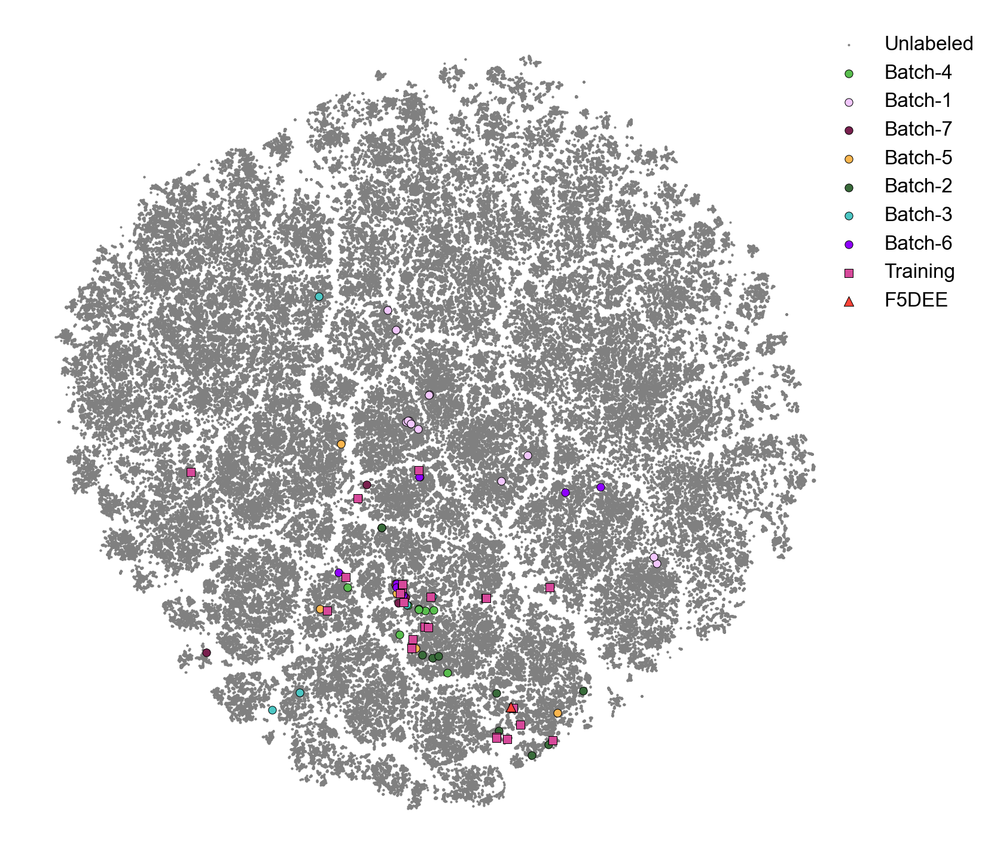

In [14]:
## plotted on 09-05-2024 -> not using this
fig, ax = plt.subplots(figsize=(6, 6))
# plt.title("t-SNE params: {} | {} | {} | {:.3f} [trial: {}]".format(random_state_raw[trial], perplexity_raw[trial], metric_raw[trial], float(exaggeration_raw[trial]), trial_))
classes = df_tsne['expt_test'].unique()
classes_names = ['Unlabeled', 'Batch-4', 'Batch-1', 'Batch-7', 'Batch-5', 'Batch-2', 'Batch-3', 'Batch-6', 'Training', 'F5DEE']
# colors = ['gray', c2, green, pink, c4, c5, orange, c1, anvil, c6, red, c7, dark_purple, purple, c3]
colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple, red]
sizes = [0.5, 10, 10, 10, 10, 10, 10, 10, 10, 15]
shapes = ['o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 's', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black']
l_widths = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i=0
for cls in classes:
    df_cls = df_tsne.loc[df_tsne['expt_test'] == cls]
    # ax.scatter(df_cls['tsne_0'], df_cls['tsne_1'], label=cls, alpha=1.0, color=colors[i], edgecolor=edge_color[i], linewidth=0.25, s=20)
    ax.scatter(df_cls['tsne_0'], df_cls['tsne_1'], label=classes_names[i], alpha=1.0, color=colors[i], edgecolor=e_colors[i], linewidth=l_widths[i], s=sizes[i], marker=shapes[i])
    i += 1
# plt.text(-12, -5.5, 'KNN: {:.4f}'.format(df_tsne_opentsne['knn_1'][trial]), family='Arial', size=8, color='black')
# plt.text(-12, -6.5, 'KNC: {:.4f}'.format(df_tsne_opentsne['knc_1'][trial]), family='Arial', size=8, color='black')
# plt.text(-12, -7.5, 'CPD: {:.4f}'.format(df_tsne_opentsne['cpd_1'][trial]), family='Arial', size=8, color='black')

# n = 1
# for i in range(len(ether_list)):
#     plt.text(df_1['tnse_0'].iloc[ether_list[i]], df_1['tnse_1'].iloc[ether_list[i]], n, family='Arial', size=8, color='black')
#     n += 1
plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('tsne_trial_{}_open.tiff'.format(trial), dpi=300)

In [28]:
df_tsne_ = df_tsne.copy()
df_tsne_.sort_values(by='expt_test', inplace=True, ascending=True)
df_tsne_

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
0,CN(C)C=O,-1.0,['Amide'],0,-29.652721,-91.122684
258660,CN(C)CC1CCCN1CCN1C(=O)CN(C)C1=O,-1.0,"['Amide', 'Amine', 'Imide']",30,68.972773,53.941402
258659,CCOP(=O)(OCC)OC(C)CN1CCCCC1,-1.0,['Amine'],2,33.643392,-11.548105
258658,CCCN(CC(=O)C(C)C)C(=O)CC,-1.0,"['Ketone', 'Amide']",10,-81.282841,49.286531
258657,ClC(Cl)(Cl)C1(Cl)CCCC1,-1.0,['Others'],1,-6.311334,1.483383
...,...,...,...,...,...,...
44375,COC1CCCCO1,7.0,['Ether'],7,-17.715517,-16.261435
62540,CCCCOCCCOC,7.0,['Ether'],7,-7.058974,-49.030989
161035,COCCOS(=O)(=O)C(F)(F)F,7.0,"['Sulfonate ester', 'Ether']",94,-63.292505,-63.019249
355235,FC(F)COCCOCC(F)(F)F,8.0,['Ether'],7,23.340995,-78.178449


In [46]:
PandasTools.AddMoleculeColumnToFrame(df_tsne_,'std_smiles')

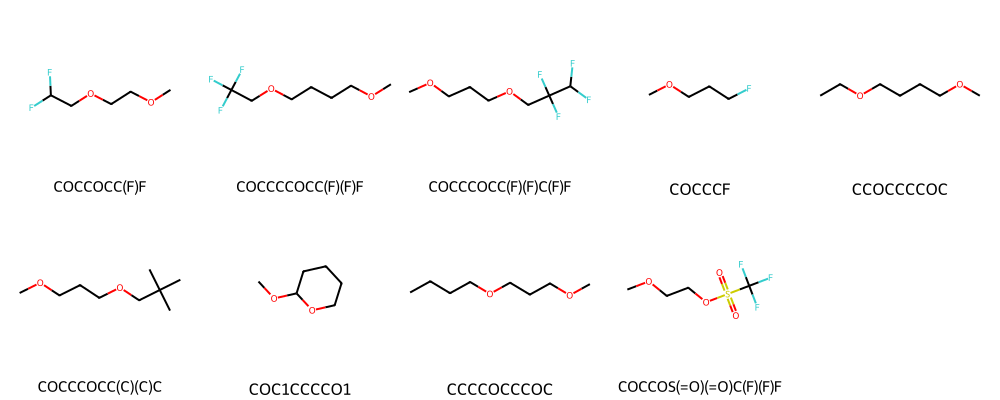

In [84]:
# classes
# for cls in classes:
#     print(cls, len(df_tsne_.loc[df_tsne_['expt_test'] == cls]))
PandasTools.FrameToGridImage(df_tsne_.loc[df_tsne_['expt_test'] == 2], legendsCol='std_smiles', molsPerRow=5, subImgSize=(200,200), maxMols=100)
PandasTools.FrameToGridImage(df_tsne_.loc[df_tsne_['expt_test'] == 3], legendsCol='std_smiles', molsPerRow=5, subImgSize=(200,200), maxMols=100)
# PandasTools.FrameToGridImage(df_tsne_.loc[df_tsne_['expt_test'] == 4], legendsCol='std_smiles', molsPerRow=5, subImgSize=(200,200), maxMols=100)
# PandasTools.FrameToGridImage(df_tsne_.loc[df_tsne_['expt_test'] == 5], legendsCol='std_smiles', molsPerRow=5, subImgSize=(200,200), maxMols=100)
# PandasTools.FrameToGridImage(df_tsne_.loc[df_tsne_['expt_test'] == 6], legendsCol='std_smiles', molsPerRow=5, subImgSize=(200,200), maxMols=100)
PandasTools.FrameToGridImage(df_tsne_.loc[df_tsne_['expt_test'] == 7], legendsCol='std_smiles', molsPerRow=5, subImgSize=(200,200), maxMols=100)

In [10]:
df_tsne_.loc[df_tsne_['expt_test'] == 2]
df_tsne_.loc[df_tsne_['expt_test'] == 3]
# df_tsne_.loc[df_tsne_['expt_test'] == 4]
# df_tsne_.loc[df_tsne_['expt_test'] == 5]
# df_tsne_.loc[df_tsne_['expt_test'] == 6]
df_tsne_.loc[df_tsne_['expt_test'] == 7]

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
29055,COCCOCC(F)F,7.0,['Ether'],7,-4.915706,-62.043563
163833,COCCCCOCC(F)(F)F,7.0,['Ether'],7,19.261401,-86.297124
289161,COCCCOCC(F)(F)C(F)F,7.0,['Ether'],7,19.213023,-86.356050
2430,COCCCF,7.0,['Ether'],7,-9.645800,-44.215816
35399,CCOCCCCOC,7.0,['Ether'],7,-6.691852,-47.669169
154991,COCCCOCC(C)(C)C,7.0,['Ether'],7,-8.691542,-49.143758
44375,COC1CCCCO1,7.0,['Ether'],7,-17.715517,-16.261435
62540,CCCCOCCCOC,7.0,['Ether'],7,-7.058974,-49.030989
161035,COCCOS(=O)(=O)C(F)(F)F,7.0,"['Sulfonate ester', 'Ether']",94,-63.292505,-63.019249


In [29]:
df_tsne__ = df_tsne_.copy()
# df_tsne__.drop(index=[161035,44375,2430,154991,355235,388010], inplace=True) ## removing batch 7 compunds with discharge capacity < 100 & F5DEE
df_tsne__.drop(index=[355235,388010], inplace=True) ## removing only F5DEE
df_tsne__.reset_index(drop=True, inplace=True)
df_tsne__.loc[df_tsne__['expt_test'] == 7]

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
388002,COCCOCC(F)F,7.0,['Ether'],7,-4.915706,-62.043563
388003,COCCCCOCC(F)(F)F,7.0,['Ether'],7,19.261401,-86.297124
388004,COCCCOCC(F)(F)C(F)F,7.0,['Ether'],7,19.213023,-86.356050
388005,COCCCF,7.0,['Ether'],7,-9.645800,-44.215816
388006,CCOCCCCOC,7.0,['Ether'],7,-6.691852,-47.669169
388007,COCCCOCC(C)(C)C,7.0,['Ether'],7,-8.691542,-49.143758
388008,COC1CCCCO1,7.0,['Ether'],7,-17.715517,-16.261435
388009,CCCCOCCCOC,7.0,['Ether'],7,-7.058974,-49.030989
388010,COCCOS(=O)(=O)C(F)(F)F,7.0,"['Sulfonate ester', 'Ether']",94,-63.292505,-63.019249


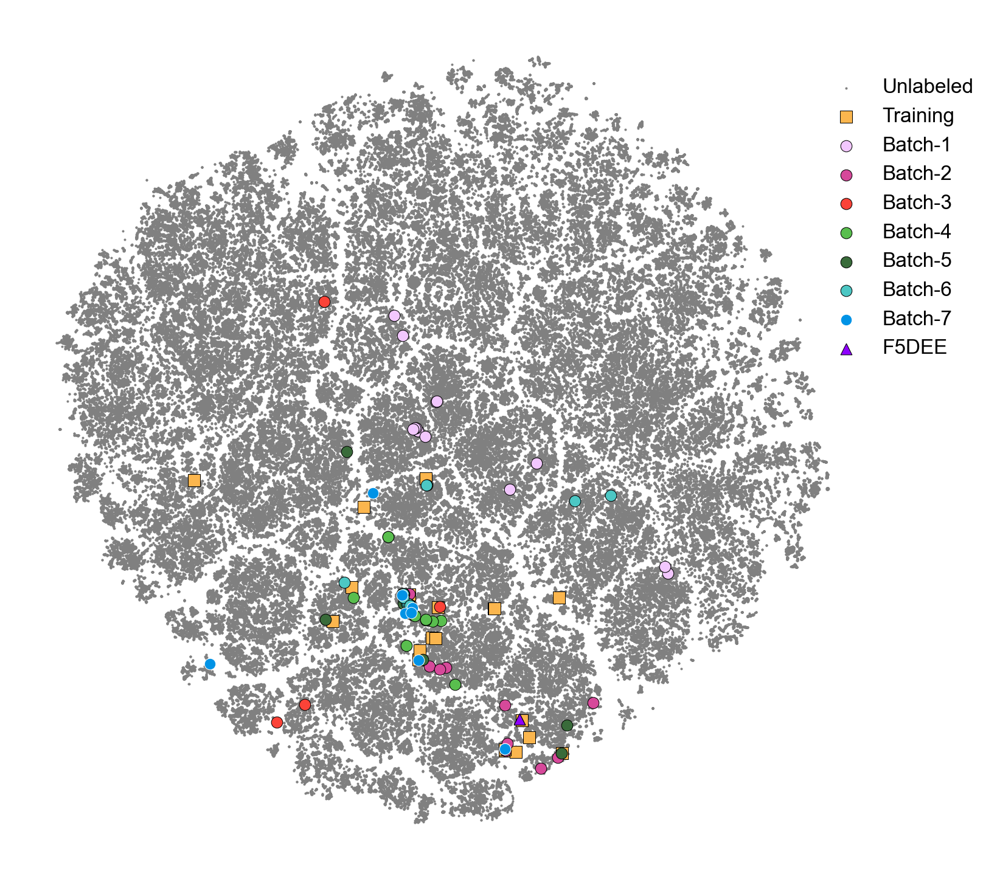

In [33]:
## plotted on 09-08-2024
fig, ax = plt.subplots(figsize=(6, 6))
classes = df_tsne_['expt_test'].unique()
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i=0
for cls in classes:
    df_cls = df_tsne_.loc[df_tsne_['expt_test'] == cls]
    ax.scatter(df_cls['tsne_0'], df_cls['tsne_1'], label=classes_names[i], alpha=1.0, color=colors[i], edgecolor=e_colors[i], linewidth=l_widths[i], s=sizes[i], marker=shapes[i])
    i += 1

plt.legend(bbox_to_anchor=(0.93, 0.95), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('x_tsne_fig2_acquisition_091024.tiff', dpi=300)

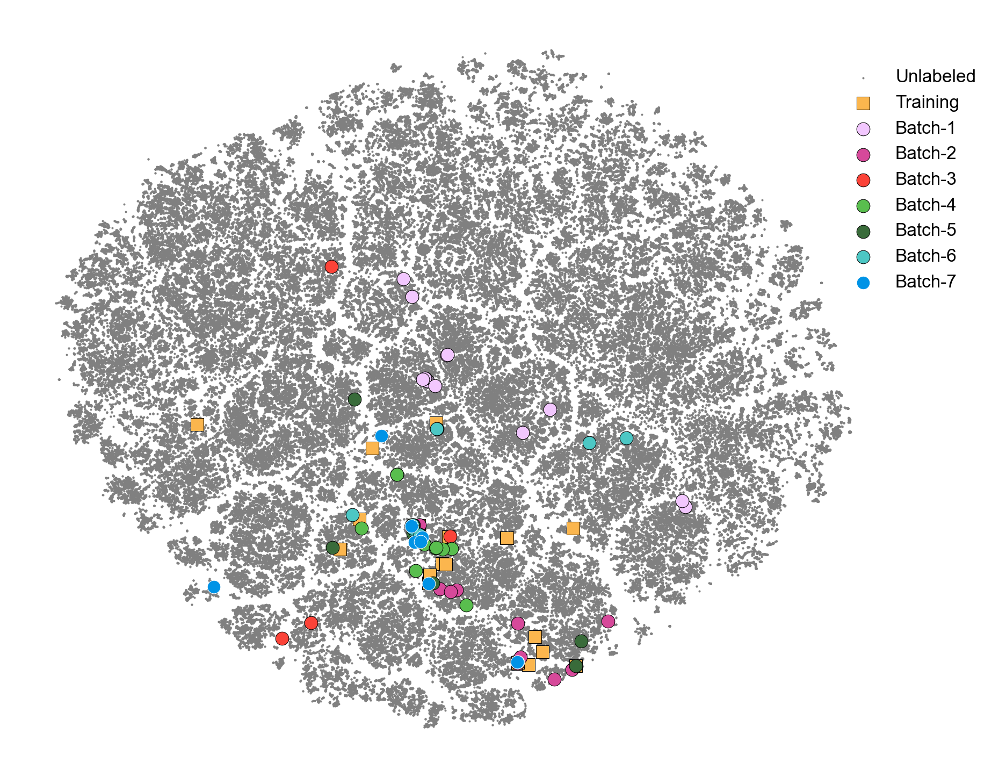

In [36]:
## plotted on 11-11-2024 => removed F5DEE; new on 12-03-2024 (increase width of t-SNE & size of labeled scatter points)
fig, ax = plt.subplots(figsize=(7, 6))
classes = df_tsne__['expt_test'].unique()
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue]
sizes = [0.5, 35, 35, 35, 35, 35, 35, 35, 35]
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white']
l_widths = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i=0
for cls in classes:
    df_cls = df_tsne__.loc[df_tsne__['expt_test'] == cls]
    ax.scatter(df_cls['tsne_0'], df_cls['tsne_1'], label=classes_names[i], alpha=1.0, color=colors[i], edgecolor=e_colors[i], linewidth=l_widths[i], s=sizes[i], marker=shapes[i])
    i += 1

plt.legend(bbox_to_anchor=(0.93, 0.95), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('tsne_fig2_acquisition_manu_111124.tiff', dpi=300, transparent=True)
plt.savefig('tsne_fig2_acquisition_manu_120324.tiff', dpi=300, transparent=True)

In [24]:
## checking for two compounds from batch 2 (supposedly one of them is best in batch 2)
df_tsne__.loc[df_tsne__['std_smiles'] == 'COC(CC(F)(F)F)OC']
# df_tsne__.loc[df_tsne__['std_smiles'] == 'CCCOC']

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
387956,COC(CC(F)(F)F)OC,2.0,['Ether'],7,19.258299,-74.33771


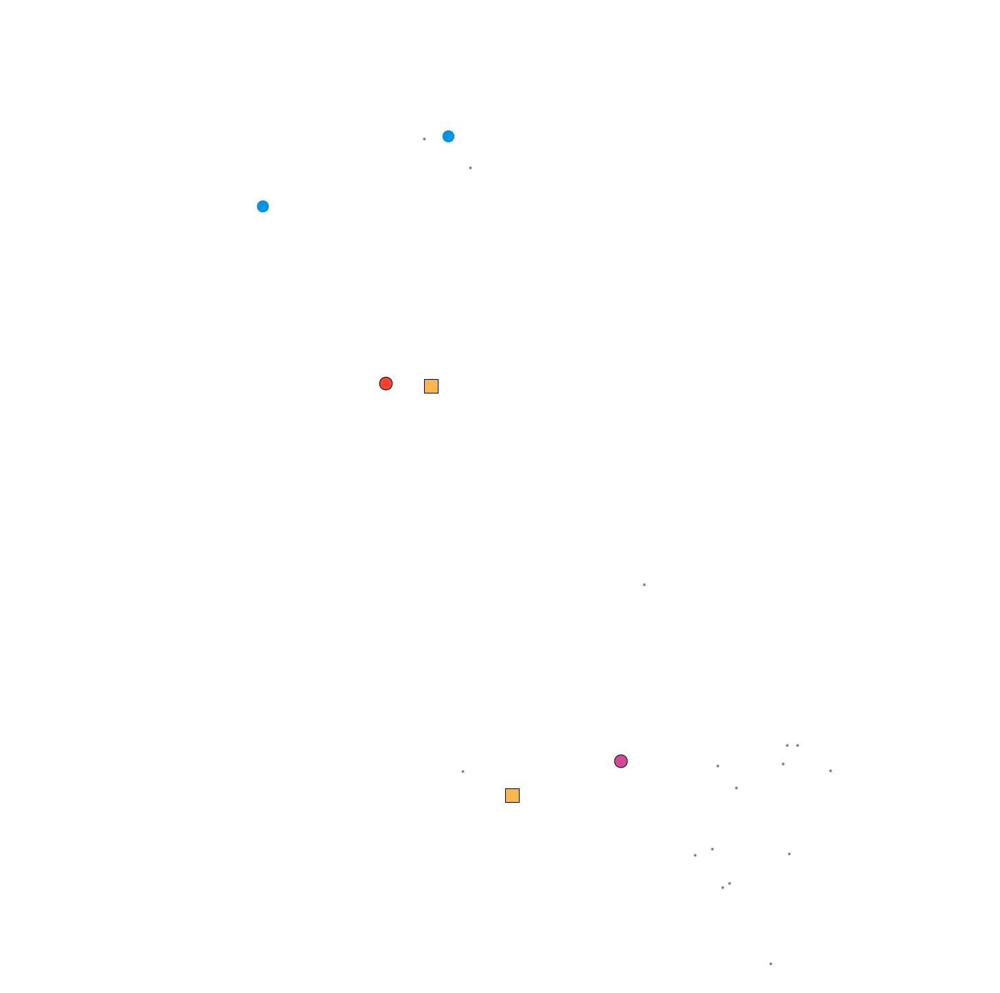

In [82]:
## plotted on 09-08-2024
fig, ax = plt.subplots(figsize=(6, 6))
classes = df_tsne_['expt_test'].unique()
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i=0
for cls in classes:
    df_cls = df_tsne_.loc[df_tsne_['expt_test'] == cls]
    ax.scatter(df_cls['tsne_0'], df_cls['tsne_1'], label=classes_names[i], alpha=1.0, color=colors[i], edgecolor=e_colors[i], linewidth=l_widths[i], s=sizes[i], marker=shapes[i])
    i += 1

# plt.legend(bbox_to_anchor=(0.95, 0.95), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.xlim(19.15, 19.4)
plt.ylim(-87, -86.2)
plt.savefig('tsne_fig2_acquisition_091024_zoom_1.eps', dpi=300)

In [ ]:
## plotted on 09-08-2024
fig, ax = plt.subplots(figsize=(6, 6))
classes = df_tsne['expt_test'].unique()
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i=0
for cls in classes:
    df_cls = df_tsne_.loc[df_tsne_['expt_test'] == cls]
    ax.scatter(df_cls['tsne_0'], df_cls['tsne_1'], label=classes_names[i], alpha=1.0, color=colors[i], edgecolor=e_colors[i], linewidth=l_widths[i], s=sizes[i], marker=shapes[i])
    i += 1

plt.legend(bbox_to_anchor=(0.93, 0.95), loc='upper left', frameon=False)
# plt.xticks([])
# plt.yticks([])
# for spine in ax.spines.values():
#     spine.set_visible(False)
# plt.savefig('x_tsne_fig2_acquisition_091024.tiff', dpi=300)

In [72]:
from rdkit.Chem import AllChem, DataStructs, PandasTools, Fragments, rdMolDescriptors, Descriptors, rdDepictor, Draw
from rdkit.Chem.Draw import IPythonConsole, rdMolDraw2D
from rdkit.Chem.PandasTools import ChangeMoleculeRendering
from IPython.display import SVG, display
from bokeh.plotting import figure, show, output_notebook, ColumnDataSource
from bokeh.models import HoverTool, ColorBar, CategoricalColorMapper
from bokeh.transform import factor_cmap
from bokeh.plotting import figure, output_file, save
from bokeh.transform import linear_cmap
from bokeh.layouts import column
from bokeh.models import TextInput, CustomJS
from bokeh.io import curdoc
from bokeh.models import Button
from bokeh.layouts import row

def _prepareMol(mol,kekulize):
    mc = Chem.Mol(mol.ToBinary())
    if kekulize:
        try:
            Chem.Kekulize(mc)
        except:
            mc = Chem.Mol(mol.ToBinary())
    if not mc.GetNumConformers():
        rdDepictor.Compute2DCoords(mc)
    return mc

def moltosvg(mol,molSize=(250,100),kekulize=True,drawer=None,**kwargs):
    mc = _prepareMol(mol,kekulize)
    if drawer is None:
        drawer = rdMolDraw2D.MolDraw2DSVG(molSize[0],molSize[1])
    drawer.DrawMolecule(mc,**kwargs)
    drawer.FinishDrawing()
    svg = drawer.GetDrawingText()
    return SVG(svg.replace('svg:',''))

## not plotting unlabeled data
unlabel_ind = df_tsne_.loc[df_tsne_['expt_test'] == -1].index
df_tsne__ = df_tsne_.copy()
df_tsne__.drop(index=unlabel_ind, axis=0, inplace=True)

PandasTools.AddMoleculeColumnToFrame(df_tsne__,'std_smiles', 'solv')

svgs_solv = [moltosvg(m).data for m in df_tsne__.solv]
smile = df_tsne__['std_smiles'].values.tolist()
database_class = df_tsne__['expt_test'].values.tolist()
ind = df_tsne__.index.values.tolist()
ChangeMoleculeRendering(renderer='PNG')

edge_color_dict = {0: '#000000', 1: '#000000', 2: '#000000', 3: '#000000', 4: '#000000', 
                   5: '#000000', 6: '#000000', 7: '#FFFFFF', 8: '#000000'}
df_tsne__['edge_color'] = df_tsne__['expt_test'].map(edge_color_dict)

def rgb_to_hex(rgb):
    return '#%02x%02x%02x' % (int(rgb[0]*255), int(rgb[1]*255), int(rgb[2]*255))

blue_hex = rgb_to_hex(blue)
anvil_hex = rgb_to_hex(anvil)
orange_hex = rgb_to_hex(orange)
red_hex = rgb_to_hex(red)
green_hex = rgb_to_hex(green)
purple_hex = rgb_to_hex(purple)
dark_purple_hex = rgb_to_hex(dark_purple)
pink_hex = rgb_to_hex(pink)
gray_hex = rgb_to_hex(gray)

color_dict = {0: orange_hex, 1: pink_hex, 2: purple_hex,
              3: red_hex, 4: green_hex, 5: c1, 
              6: anvil_hex, 7: blue_hex, 8: dark_purple_hex}

source = ColumnDataSource(data=dict(x=df_tsne__['tsne_0'], y=df_tsne__['tsne_1'], svgs_solv=svgs_solv, desc=database_class, smile=smile, color=df_tsne__['expt_test'].map(color_dict), edge_color=df_tsne__['edge_color']))

hover = HoverTool(tooltips="""
    <div>
        <div> 
            <span style="font-size: 12px; font-weight: bold;"> @svgs_solv{safe} </span>
        </div>
        <div>
            <span style="font-size: 12px; font-weight: bold;"> SMILES: @smile </span>
        </div>
        <div>
            <span style="font-size: 12px; font-weight: bold;"> Class: @desc </span>
        </div>
    </div>
    """
)

# Store the original data in a separate variable
original_data = source.data.copy()

# Add a Button widget for the refresh functionality
refresh_button = Button(label="Refresh Plot", button_type="success")

# Add a JavaScript callback to reset the data source to its original state
reset_callback = CustomJS(args=dict(source=source, original_data=original_data), code="""
    source.data = original_data;
    source.change.emit();
""")

refresh_button.js_on_click(reset_callback)

# Add a TextInput widget for the search box
search_box = TextInput(value="", title="Search SMILES:")

# Add a JavaScript callback to filter the data based on the SMILES string -> this clears out all other points
# callback = CustomJS(args=dict(source=source), code="""
#     const data = source.data;
#     const search_value = cb_obj.value.toLowerCase();
#     const smiles = data['smile'];
#     const x = data['x'];
#     const y = data['y'];
#     const color = data['color'];
#     const edge_color = data['edge_color'];
#     const svgs_solv = data['svgs_solv'];
#     const desc = data['desc'];
    
#     const new_x = [];
#     const new_y = [];
#     const new_color = [];
#     const new_edge_color = [];
#     const new_svgs_solv = [];
#     const new_desc = [];
#     const new_smile = [];

#     for (let i = 0; i < smiles.length; i++) {
#         if (smiles[i].toLowerCase().includes(search_value)) {
#             new_x.push(x[i]);
#             new_y.push(y[i]);
#             new_color.push(color[i]);
#             new_edge_color.push(edge_color[i]);
#             new_svgs_solv.push(svgs_solv[i]);
#             new_desc.push(desc[i]);
#             new_smile.push(smiles[i]);
#         }
#     }

#     source.data = {
#         'x': new_x,
#         'y': new_y,
#         'color': new_color,
#         'edge_color': new_edge_color,
#         'svgs_solv': new_svgs_solv,
#         'desc': new_desc,
#         'smile': new_smile
#     };
#     source.change.emit();
# """)

# Add a JavaScript callback to filter the data based on the SMILES string and include neighboring points
callback = CustomJS(args=dict(source=source), code="""
    const data = source.data;
    const search_value = cb_obj.value.toLowerCase();
    const smiles = data['smile'];
    const x = data['x'];
    const y = data['y'];
    const color = data['color'];
    const edge_color = data['edge_color'];
    const svgs_solv = data['svgs_solv'];
    const desc = data['desc'];
    
    const new_x = [];
    const new_y = [];
    const new_color = [];
    const new_edge_color = [];
    const new_svgs_solv = [];
    const new_desc = [];
    const new_smile = [];

    const radius = 10;  // Adjust the radius as needed

    for (let i = 0; i < smiles.length; i++) {
        if (smiles[i].toLowerCase().includes(search_value)) {
            const center_x = x[i];
            const center_y = y[i];

            for (let j = 0; j < smiles.length; j++) {
                const dist = Math.sqrt(Math.pow(center_x - x[j], 2) + Math.pow(center_y - y[j], 2));
                if (dist <= radius) {
                    new_x.push(x[j]);
                    new_y.push(y[j]);
                    new_color.push(color[j]);
                    new_edge_color.push(edge_color[j]);
                    new_svgs_solv.push(svgs_solv[j]);
                    new_desc.push(desc[j]);
                    new_smile.push(smiles[j]);
                }
            }
            break;  // Only consider the first match
        }
    }

    source.data = {
        'x': new_x,
        'y': new_y,
        'color': new_color,
        'edge_color': new_edge_color,
        'svgs_solv': new_svgs_solv,
        'desc': new_desc,
        'smile': new_smile
    };
    source.change.emit();
""")

search_box.js_on_change('value', callback)

interactive_map = figure(width=1000, height=1000, tools=['reset,box_zoom,wheel_zoom,zoom_in,zoom_out,pan',hover])
interactive_map.title.text = "t-SNE visualization for acquired data"
interactive_map.title.align = "center"
interactive_map.title.text_color = "orange"
interactive_map.title.text_font_size = "25px"

interactive_map.scatter('x', 'y', 
                        color = 'color',
                        line_color = 'edge_color',
                        source=source, 
                        size=12, 
                        fill_alpha=1.0)

# Layout
# layout = column(search_box, interactive_map) ## just search box & interactive map
layout = column(row(search_box, refresh_button), interactive_map)

# output_file("interactive_map_acquired_090824.html")
# save(interactive_map)

# save(layout)

# If running in a Jupyter notebook, use show(layout) instead of save(layout)
show(layout)

### t-SNE plot for suggestions from different batches (on September 25, 2024)

In [82]:
df_tsne = pd.read_csv('tsne_default_openTSNE_090124_new_class_acquisition_090824.csv')
df_tsne

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
0,CN(C)C=O,-1.0,['Amide'],0,-29.652721,-91.122684
1,CN1CCN(C)C1=O,-1.0,['Amide'],0,63.663623,30.721911
2,CN(C)C(=O)N(C)C,-1.0,['Amide'],0,-63.760388,9.938176
3,CB(C)C=O,-1.0,['Others'],1,-11.815345,-51.883275
4,[CH2]N(C)C=O,-1.0,['Amide'],0,-29.670045,-91.193283
...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,0.0,['Ether'],7,-20.242432,-20.010327
388009,FC(F)COCCOCC(F)F,-1.0,['Ether'],7,4.972566,-54.523802
388010,FC(F)COCCOCC(F)(F)F,8.0,['Ether'],7,23.341277,-78.180018
388011,FCCOCCF,-1.0,['Ether'],7,16.235649,-47.809552


In [28]:
df_sugg_b1 = pd.read_json('sugg_batch1_all_uniq_top5000.json')
df_sugg_b2 = pd.read_json('sugg_batch2_all_uniq_top5000.json')
df_sugg_b3 = pd.read_json('sugg_batch3_all_uniq_top10000.json')
df_sugg_b4 = pd.read_json('sugg_batch4_all_uniq_top10000.json')
df_sugg_b5 = pd.read_json('sugg_batch5_all_uniq_top5000.json')
df_sugg_b6 = pd.read_json('sugg_batch6_all_uniq_top5000.json')
df_sugg_b7 = pd.read_json('sugg_batch7_all_uniq_top5000_greed.json')
df_sugg_b1

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,norm_capacity_3_pred,norm_capacity_3_uncer,EI_pair,EI_matern,EI_rq,EI_rbfexpsin,EI_aggr,std_smiles,rank,class
0,COC1(C(F)F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.274757,-1.203490,1.041326,-1.025159,-0.415797,-0.178878,-0.554024,0.520806,...,0.000005,0.000001,0.207654,0.312272,0.032396,0.482305,1.448200e-06,COC1(C(F)F)CCCCC1,1,[Ether]
1,COC1(C(F)(F)F)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.285596,-1.266693,1.241411,-1.102478,0.376095,0.166441,0.024304,0.431072,...,0.000005,0.000001,0.205546,0.287685,0.030553,0.455206,1.431900e-06,COC1(C(F)(F)F)CCCC1,2,[Ether]
2,COC1(C(C)(F)F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.307584,-1.226729,1.247259,-1.216207,0.634606,0.169550,0.293654,0.228677,...,0.000004,0.000001,0.255937,0.284593,0.029139,0.468436,1.427100e-06,COC1(C(C)(F)F)CCCCC1,3,[Ether]
3,COC1(C(F)F)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.212383,-1.226273,1.055989,-0.997153,-0.403396,-0.225401,-0.523877,0.563653,...,0.000005,0.000001,0.176826,0.300631,0.033008,0.448318,1.424400e-06,COC1(C(F)F)CCCC1,4,[Ether]
4,COC1(F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.431572,-1.193527,1.149880,-0.973532,-0.004855,0.304571,-0.444267,0.611225,...,0.000005,0.000001,0.204828,0.308852,0.031455,0.476645,1.414000e-06,COC1(F)CCCCC1,5,[Ether]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,COC1(N(C)C)CCCN(C=O)C1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.851376,-0.103686,0.435008,-0.624247,0.082175,0.010039,-0.210949,1.345988,...,0.000003,0.000001,0.099633,0.160821,0.022038,0.240340,6.724000e-07,COC1(N(C)C)CCCN(C=O)C1,4996,"[Ether, Amide, Amine]"
4996,CC(C)S(=O)(=O)N1CCCC(=O)C1(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.919765,-0.738924,0.410033,-0.039115,0.401307,-1.606753,-0.360065,0.420094,...,0.000003,0.000001,0.079183,0.155627,0.023258,0.230383,6.723000e-07,CC(C)S(=O)(=O)N1CCCC(=O)C1(C)C,4997,"[Ketone, Amine]"
4997,COC(C)(C)CN1CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.530021,-0.678923,0.777904,-0.079169,0.266731,-0.372377,1.513170,0.303756,...,0.000004,0.000001,0.085666,0.112525,0.019859,0.191656,6.723000e-07,COC(C)(C)CN1CCCC1,4998,"[Ether, Amine]"
4998,CC1(C)CC(F)(F)CCC1=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.535133,-1.218282,0.895559,-0.445502,0.728748,-0.887856,-1.237669,0.645537,...,0.000004,0.000001,0.062658,0.146347,0.024031,0.188132,6.723000e-07,CC1(C)CC(F)(F)CCC1=O,4999,[Ketone]


In [39]:
blue = (0, 0.576, 0.902) # 0, 147, 230
green = (0.349,0.745,0.306) # 89, 190, 78
red = (0.984, 0.262, 0.219) # 251, 67, 56 
orange = (0.984, 0.713, 0.305) # 251, 182, 78 
purple = (0.839, 0.286, 0.604) # 214, 73, 1541
anvil = (0.298, 0.78, 0.77) # 76, 199, 196
dark_purple = (0.557, 0, 0.998) # 142, 0, 252
pink = (0.95, 0.78, 0.996) # 242, 199, 154
gray = (0.463,0.463,0.463) # 118, 118, 118
c1 = '#396b3a'
c2 = '#6ea397'
c3 = '#b56171'
c4 = '#79204e'
c5 = '#a5ebcc'
c6 = '#ffd266'
c7 = '#d27672'

In [27]:
df_train = df_tsne.loc[df_tsne['expt_test'] == 0]
df_tsne['sugg_batch'] = df_tsne['expt_test']
df_tsne

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,sugg_batch
0,CN(C)C=O,-1.0,['Amide'],0,-29.652721,-91.122684,-1.0
1,CN1CCN(C)C1=O,-1.0,['Amide'],0,63.663623,30.721911,-1.0
2,CN(C)C(=O)N(C)C,-1.0,['Amide'],0,-63.760388,9.938176,-1.0
3,CB(C)C=O,-1.0,['Others'],1,-11.815345,-51.883275,-1.0
4,[CH2]N(C)C=O,-1.0,['Amide'],0,-29.670045,-91.193283,-1.0
...,...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,0.0,['Ether'],7,-20.242432,-20.010327,0.0
388009,FC(F)COCCOCC(F)F,-1.0,['Ether'],7,4.972566,-54.523802,-1.0
388010,FC(F)COCCOCC(F)(F)F,8.0,['Ether'],7,23.341277,-78.180018,8.0
388011,FCCOCCF,-1.0,['Ether'],7,16.235649,-47.809552,-1.0


In [29]:
## since same molecules are suggested in multiple batches, total number of molecules in earlier batches will be samller than actual values
common_smiles_1 = df_tsne['std_smiles'].isin(df_sugg_b1['std_smiles'])
df_tsne.loc[common_smiles_1, 'sugg_batch'] = 1
common_smiles_2 = df_tsne['std_smiles'].isin(df_sugg_b2['std_smiles'])
df_tsne.loc[common_smiles_2, 'sugg_batch'] = 2
common_smiles_3 = df_tsne['std_smiles'].isin(df_sugg_b3['std_smiles'])
df_tsne.loc[common_smiles_3, 'sugg_batch'] = 3
common_smiles_4 = df_tsne['std_smiles'].isin(df_sugg_b4['std_smiles'])
df_tsne.loc[common_smiles_4, 'sugg_batch'] = 4
common_smiles_5 = df_tsne['std_smiles'].isin(df_sugg_b5['std_smiles'])
df_tsne.loc[common_smiles_5, 'sugg_batch'] = 5
common_smiles_6 = df_tsne['std_smiles'].isin(df_sugg_b6['std_smiles'])
df_tsne.loc[common_smiles_6, 'sugg_batch'] = 6
common_smiles_7 = df_tsne['std_smiles'].isin(df_sugg_b7['std_smiles'])
df_tsne.loc[common_smiles_7, 'sugg_batch'] = 7
df_tsne.loc[df_tsne['sugg_batch'] == 2]

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,sugg_batch
736,COC(C)F,-1.0,['Ether'],7,10.719707,-52.897546,2.0
3280,CO[Si](OC)(OC)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)...,-1.0,['Silyl ether'],24,39.945759,-55.454321,2.0
4895,CO[Si](CC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F)(...,-1.0,['Silyl ether'],24,13.399768,-27.722742,2.0
5040,COC(C)C,-1.0,['Ether'],7,11.108626,-52.868250,2.0
5894,COC(F)CF,-1.0,['Ether'],7,4.394863,-65.004001,2.0
...,...,...,...,...,...,...,...
383441,CO[Si](CCCCC(F)OCCC[Si](OC)(OC)OC)(OC)OC,-1.0,"['Ether', 'Silyl ether']",81,-14.157443,-30.516927,2.0
385897,CO[Si](CCC(CC[Si](OC)(OC)OC)CC[Si](OC)(OC)OC)(...,-1.0,['Silyl ether'],24,-11.484580,-31.829628,2.0
385908,COCCC(OC)N(C)C(C)(C)C,-1.0,"['Ether', 'Amine']",8,-8.681959,-84.913655,2.0
386563,CO[Si](CCCCC(CCC[Si](OC)(OC)OC)C(C)(C)CC(C)(C)...,-1.0,['Silyl ether'],24,-12.842165,-29.867690,2.0


In [30]:
## use this code instead
df_sb1 = df_sugg_b1.merge(df_tsne, left_on='std_smiles', right_on='std_smiles', how='inner')
df_sb2 = df_sugg_b2.merge(df_tsne, left_on='std_smiles', right_on='std_smiles', how='inner')
df_sb3 = df_sugg_b3.merge(df_tsne, left_on='std_smiles', right_on='std_smiles', how='inner')
df_sb4 = df_sugg_b4.merge(df_tsne, left_on='std_smiles', right_on='std_smiles', how='inner')
df_sb5 = df_sugg_b5.merge(df_tsne, left_on='std_smiles', right_on='std_smiles', how='inner')
df_sb6 = df_sugg_b6.merge(df_tsne, left_on='std_smiles', right_on='std_smiles', how='inner')
df_sb7 = df_sugg_b7.merge(df_tsne, left_on='std_smiles', right_on='std_smiles', how='inner')
df_sb2

,Unnamed: 0,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,database,std_smiles,rank,class_x,expt_test,class_y,class_id,tsne_0,tsne_1,sugg_batch
0,736,COC(C)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.776835,-1.399544,0.649007,-0.799742,-0.514680,-0.964902,0.077170,...,suggestions_EI,COC(C)F,4165.0,[Ether],-1.0,['Ether'],7,10.719707,-52.897546,2.0
1,1050,CO[Si](CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.703865,-1.378061,0.988412,-0.661167,0.540599,-0.224957,0.849146,...,suggestions_EI,CO[Si](CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(...,1077.0,[Silyl ether],4.0,['Silyl ether'],24,-13.566738,-28.105992,4.0
2,1232,CO[Si](CCCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.861433,-1.423950,0.911623,-0.390941,0.479303,-0.022299,0.834731,...,suggestions_EI,CO[Si](CCCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C...,1092.0,[Silyl ether],-1.0,['Silyl ether'],24,-13.785915,-28.274712,4.0
3,1285,CO[Si](C)(CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)CC[Si]...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.539653,-1.463092,1.088129,-0.663931,0.622251,-0.101533,0.747581,...,suggestions_EI,CO[Si](C)(CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)CC[Si]...,1554.0,[Silyl ether],-1.0,['Silyl ether'],24,14.312994,-26.556956,4.0
4,1468,CO[Si](OC)(OC)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.492592,-1.463532,1.139268,-0.682042,0.564576,-0.265117,0.719485,...,suggestions_EI,CO[Si](OC)(OC)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)...,1012.0,[Silyl ether],-1.0,['Silyl ether'],24,39.942542,-55.452605,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3752,385211,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.915870,-0.938476,0.970829,0.044332,-0.738988,0.996804,0.802128,...,suggestions_EI,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,4362.0,"[Ether, Silyl ether]",-1.0,"['Ether', 'Silyl ether']",81,-14.952945,-32.208720,6.0
3753,385897,CO[Si](CCC(CC[Si](OC)(OC)OC)CC[Si](OC)(OC)OC)(...,[Li+].O=C1O[B-](F)(F)OC1=O,-0.784803,-1.203755,0.512146,-0.385240,-0.676515,-0.570004,0.204125,...,suggestions_EI,CO[Si](CCC(CC[Si](OC)(OC)OC)CC[Si](OC)(OC)OC)(...,4173.0,[Silyl ether],-1.0,['Silyl ether'],24,-11.484580,-31.829628,2.0
3754,385908,COCCC(OC)N(C)C(C)(C)C,[Li+].O=C1O[B-](F)(F)OC1=O,-1.204121,-0.980336,-0.080584,-1.088509,-0.349281,-0.071455,1.546685,...,suggestions_EI,COCCC(OC)N(C)C(C)(C)C,4615.0,"[Ether, Amine]",-1.0,"['Ether', 'Amine']",8,-8.681959,-84.913655,2.0
3755,386563,CO[Si](CCCCC(CCC[Si](OC)(OC)OC)C(C)(C)CC(C)(C)...,[Li+].O=C1O[B-](F)(F)OC1=O,-1.114709,-1.313834,0.572373,-0.257871,-0.122796,-0.486306,0.851936,...,suggestions_EI,CO[Si](CCCCC(CCC[Si](OC)(OC)OC)C(C)(C)CC(C)(C)...,1017.0,[Silyl ether],-1.0,['Silyl ether'],24,-12.842165,-29.867690,2.0


#### All batches together

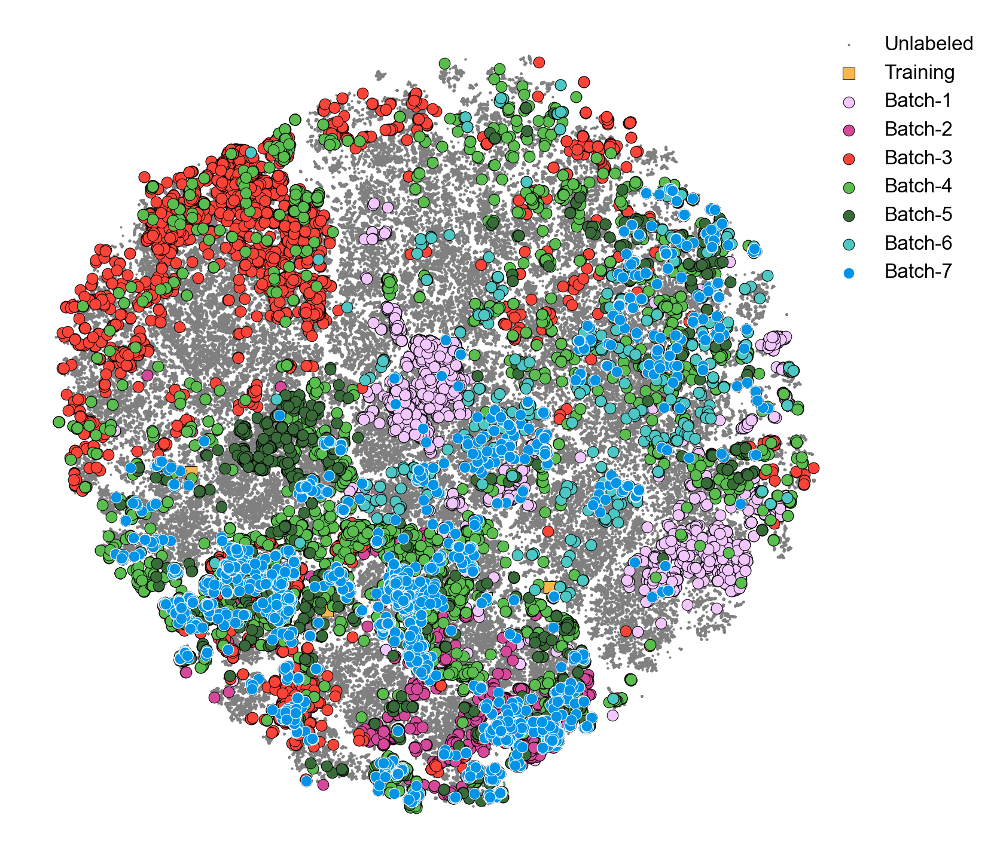

In [27]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i=0
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
ax.scatter(df_sb1['tsne_0'], df_sb1['tsne_1'], label='Batch-1', alpha=1.0, color=colors[2], edgecolor=e_colors[2], linewidth=l_widths[2], s=sizes[2], marker=shapes[2])
ax.scatter(df_sb2['tsne_0'], df_sb2['tsne_1'], label='Batch-2', alpha=1.0, color=colors[3], edgecolor=e_colors[3], linewidth=l_widths[3], s=sizes[3], marker=shapes[3])
ax.scatter(df_sb3['tsne_0'], df_sb3['tsne_1'], label='Batch-3', alpha=1.0, color=colors[4], edgecolor=e_colors[4], linewidth=l_widths[4], s=sizes[4], marker=shapes[4])
ax.scatter(df_sb4['tsne_0'], df_sb4['tsne_1'], label='Batch-4', alpha=1.0, color=colors[5], edgecolor=e_colors[5], linewidth=l_widths[5], s=sizes[5], marker=shapes[5])
ax.scatter(df_sb5['tsne_0'], df_sb5['tsne_1'], label='Batch-5', alpha=1.0, color=colors[6], edgecolor=e_colors[6], linewidth=l_widths[6], s=sizes[6], marker=shapes[6])
ax.scatter(df_sb6['tsne_0'], df_sb6['tsne_1'], label='Batch-6', alpha=1.0, color=colors[7], edgecolor=e_colors[7], linewidth=l_widths[7], s=sizes[7], marker=shapes[7])
ax.scatter(df_sb7['tsne_0'], df_sb7['tsne_1'], label='Batch-7', alpha=1.0, color=colors[8], edgecolor=e_colors[8], linewidth=l_widths[8], s=sizes[8], marker=shapes[8])
plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)

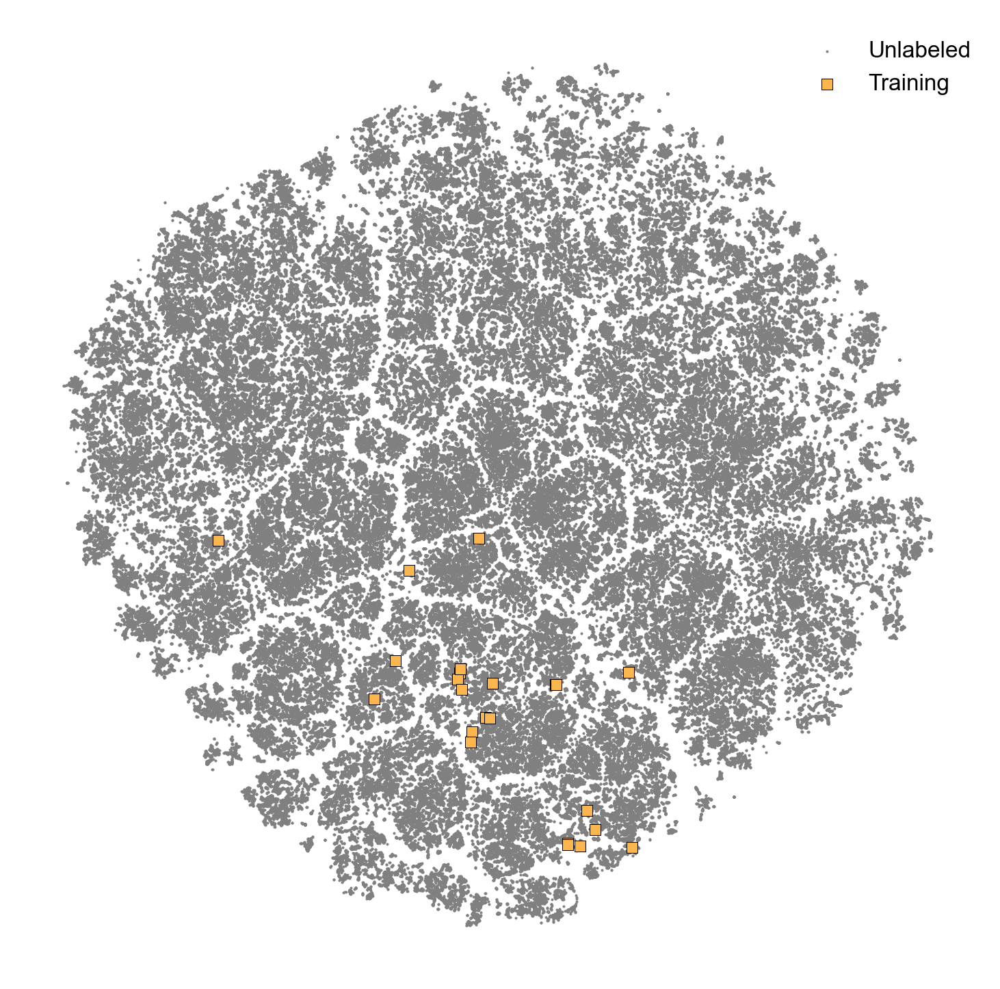

In [71]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 15, 20, 20, 20, 20, 20, 20, 20, 20]
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i=0
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
# ax.scatter(df_sb1['tsne_0'], df_sb1['tsne_1'], label='Batch-1', alpha=1.0, color=colors[2], edgecolor=e_colors[2], linewidth=l_widths[2], s=sizes[2], marker=shapes[2])
# ax.scatter(df_sb2['tsne_0'], df_sb2['tsne_1'], label='Batch-2', alpha=1.0, color=colors[3], edgecolor=e_colors[3], linewidth=l_widths[3], s=sizes[3], marker=shapes[3])
# ax.scatter(df_sb3['tsne_0'], df_sb3['tsne_1'], label='Batch-3', alpha=1.0, color=colors[4], edgecolor=e_colors[4], linewidth=l_widths[4], s=sizes[4], marker=shapes[4])
# ax.scatter(df_sb4['tsne_0'], df_sb4['tsne_1'], label='Batch-4', alpha=1.0, color=colors[5], edgecolor=e_colors[5], linewidth=l_widths[5], s=sizes[5], marker=shapes[5])
# ax.scatter(df_sb5['tsne_0'], df_sb5['tsne_1'], label='Batch-5', alpha=1.0, color=colors[6], edgecolor=e_colors[6], linewidth=l_widths[6], s=sizes[6], marker=shapes[6])
# ax.scatter(df_sb6['tsne_0'], df_sb6['tsne_1'], label='Batch-6', alpha=1.0, color=colors[7], edgecolor=e_colors[7], linewidth=l_widths[7], s=sizes[7], marker=shapes[7])
# ax.scatter(df_sb7['tsne_0'], df_sb7['tsne_1'], label='Batch-7', alpha=1.0, color=colors[8], edgecolor=e_colors[8], linewidth=l_widths[8], s=sizes[8], marker=shapes[8])
plt.legend(bbox_to_anchor=(0.80, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('training_data_tsne.jpg', dpi=300)

#### Batch: 1

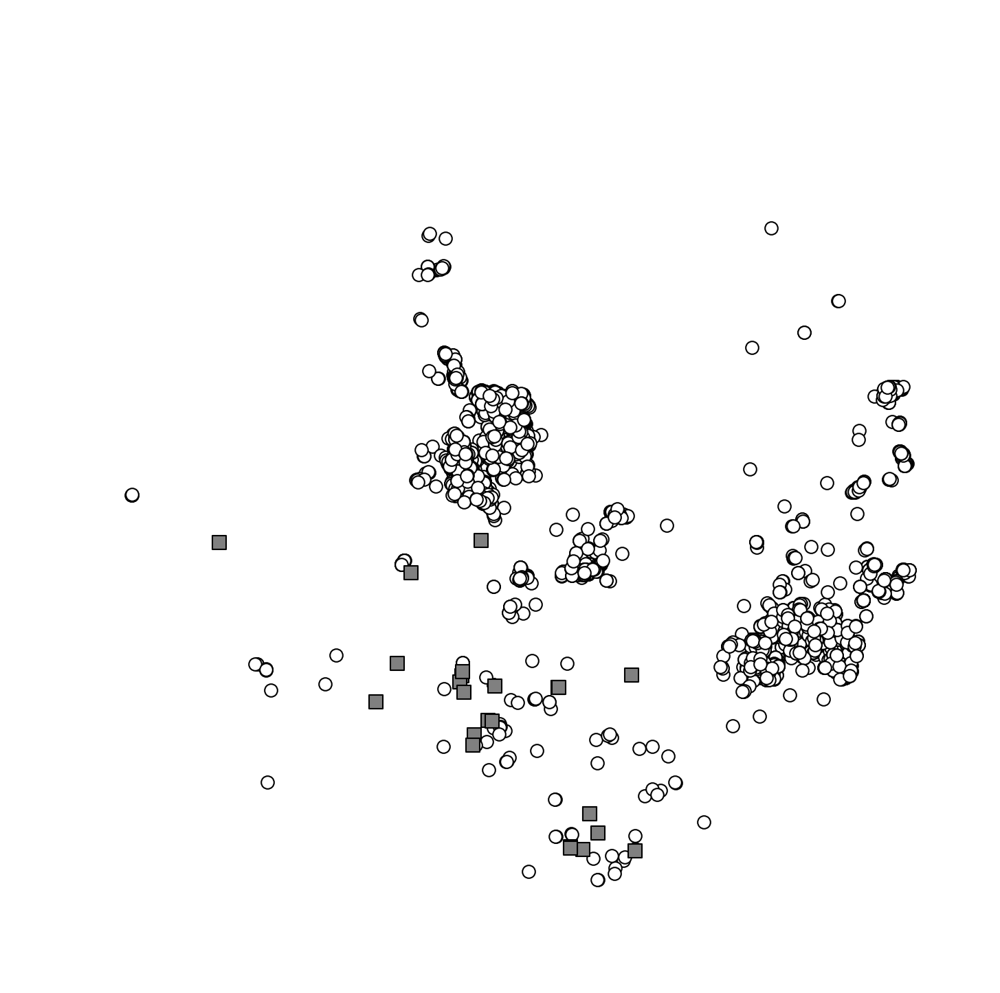

In [59]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.5, 0.5, 0.5, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i=0
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, facecolor='None', edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
# ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
# ax.scatter(df_sb1['tsne_0'], df_sb1['tsne_1'], label='Batch-1', alpha=1.0, color=colors[2], edgecolor=e_colors[2], linewidth=l_widths[2], s=sizes[2], marker=shapes[2])
ax.scatter(df_sb1['tsne_0'], df_sb1['tsne_1'], label='Batch-1', alpha=1.0, facecolor='white', edgecolor=e_colors[2], linewidth=l_widths[2], s=sizes[2], marker=shapes[2])

# ax.scatter(df_sb2['tsne_0'], df_sb2['tsne_1'], label='Batch-2', alpha=1.0, color=colors[3], edgecolor=e_colors[3], linewidth=l_widths[3], s=sizes[3], marker=shapes[3])
# ax.scatter(df_sb3['tsne_0'], df_sb3['tsne_1'], label='Batch-3', alpha=1.0, color=colors[4], edgecolor=e_colors[4], linewidth=l_widths[4], s=sizes[4], marker=shapes[4])
# ax.scatter(df_sb4['tsne_0'], df_sb4['tsne_1'], label='Batch-4', alpha=1.0, color=colors[5], edgecolor=e_colors[5], linewidth=l_widths[5], s=sizes[5], marker=shapes[5])
# ax.scatter(df_sb5['tsne_0'], df_sb5['tsne_1'], label='Batch-5', alpha=1.0, color=colors[6], edgecolor=e_colors[6], linewidth=l_widths[6], s=sizes[6], marker=shapes[6])
# ax.scatter(df_sb6['tsne_0'], df_sb6['tsne_1'], label='Batch-6', alpha=1.0, color=colors[7], edgecolor=e_colors[7], linewidth=l_widths[7], s=sizes[7], marker=shapes[7])
# ax.scatter(df_sb7['tsne_0'], df_sb7['tsne_1'], label='Batch-7', alpha=1.0, color=colors[8], edgecolor=e_colors[8], linewidth=l_widths[8], s=sizes[8], marker=shapes[8])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, facecolor='gray', edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])

# plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('tsne_batch1_acq.png', transparent=True)

#### Batch: 2

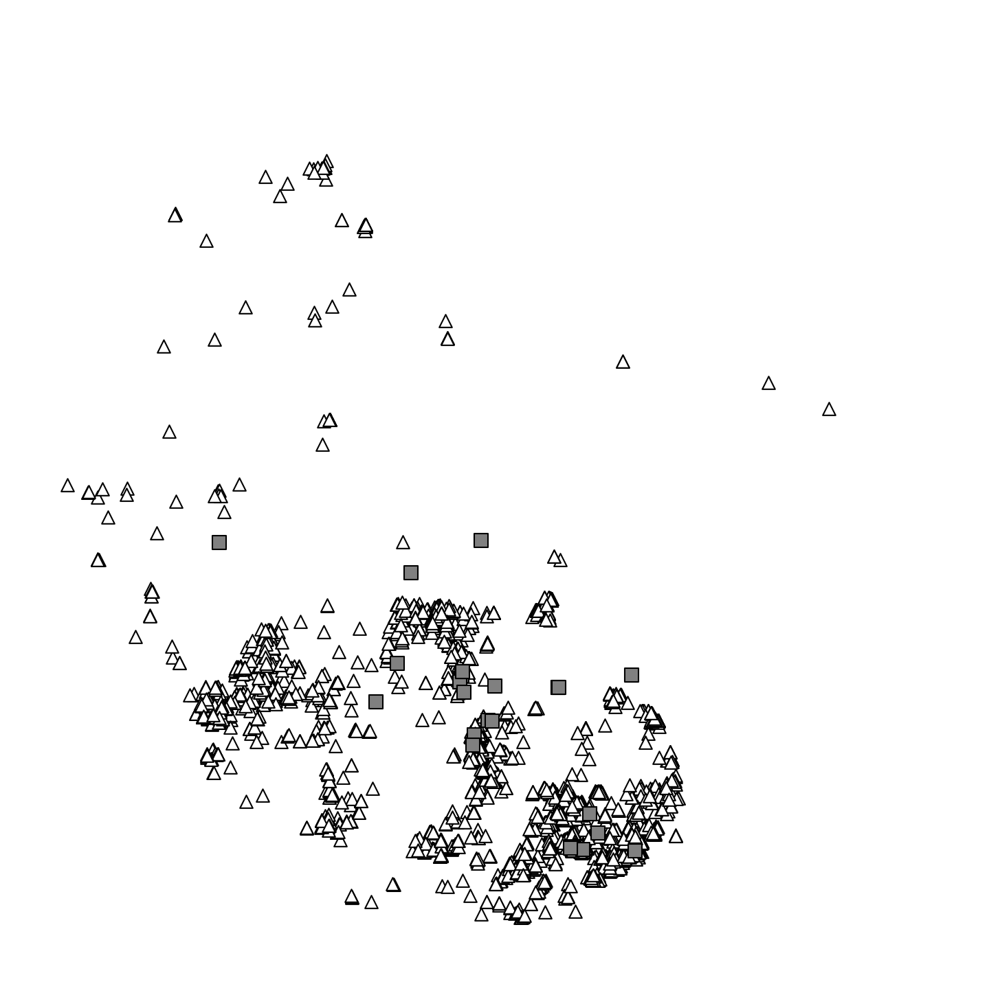

In [58]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
# shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
shapes = ['o', 's', 'o', '^', 'o', 'o', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
i=0
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, facecolor='none', edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
# ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
# ax.scatter(df_sb1['tsne_0'], df_sb1['tsne_1'], label='Batch-1', alpha=1.0, color=colors[2], edgecolor=e_colors[2], linewidth=l_widths[2], s=sizes[2], marker=shapes[2])
# ax.scatter(df_sb2['tsne_0'], df_sb2['tsne_1'], label='Batch-2', alpha=1.0, color=colors[3], edgecolor=e_colors[3], linewidth=l_widths[3], s=sizes[3], marker=shapes[3])
ax.scatter(df_sb2['tsne_0'], df_sb2['tsne_1'], label='Batch-2', alpha=1.0, facecolor='white', edgecolor=e_colors[3], linewidth=l_widths[3], s=sizes[3], marker=shapes[3])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, facecolor='gray', edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])

# plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('tsne_batch2_acq.png', transparent=True)

#### Batch: 3

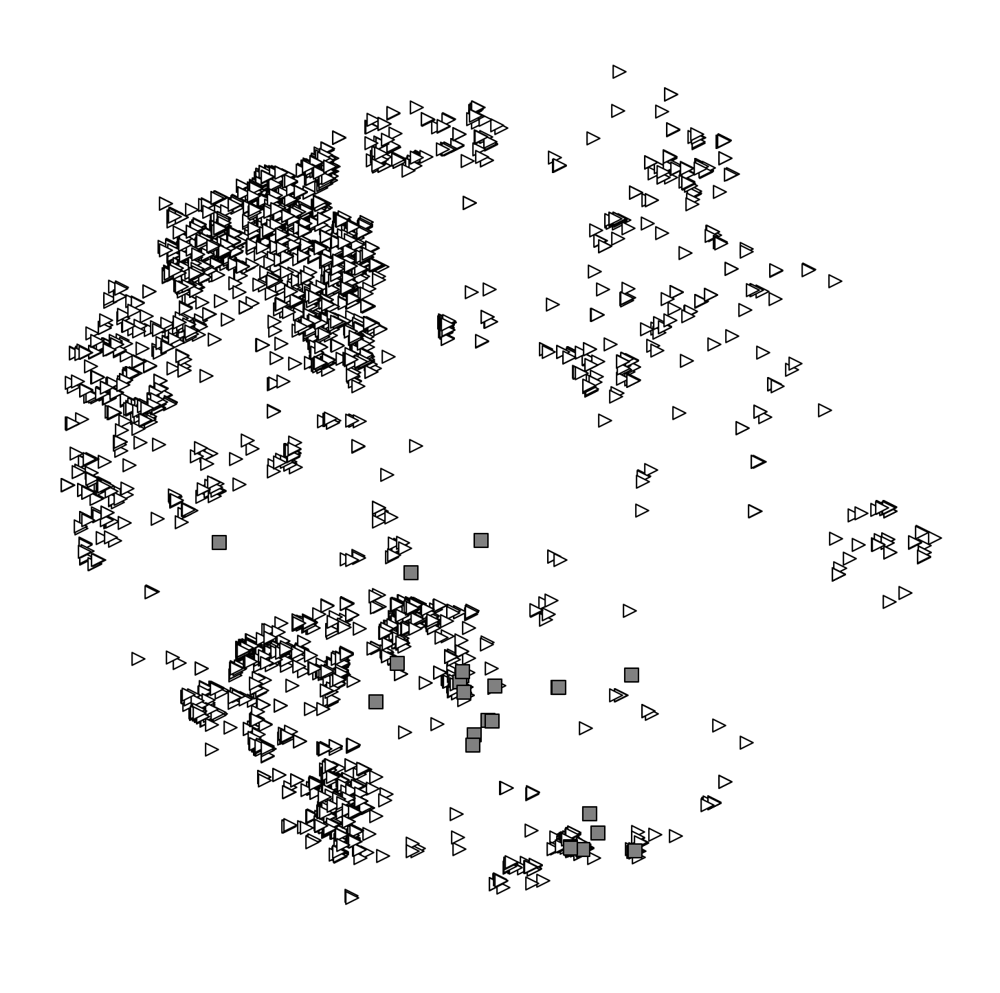

In [57]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
# shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
shapes = ['o', 's', 'o', 'o', '>', 'o', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
i=0
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, facecolor='none', edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
# ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
# ax.scatter(df_sb3['tsne_0'], df_sb3['tsne_1'], label='Batch-3', alpha=1.0, color=colors[4], edgecolor=e_colors[4], linewidth=l_widths[4], s=sizes[4], marker=shapes[4])
ax.scatter(df_sb3['tsne_0'], df_sb3['tsne_1'], label='Batch-3', alpha=1.0, facecolor='white', edgecolor=e_colors[4], linewidth=l_widths[4], s=sizes[4], marker=shapes[4])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, facecolor='gray', edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])

# plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('tsne_batch3_acq.png', transparent=True)

#### Batch: 4

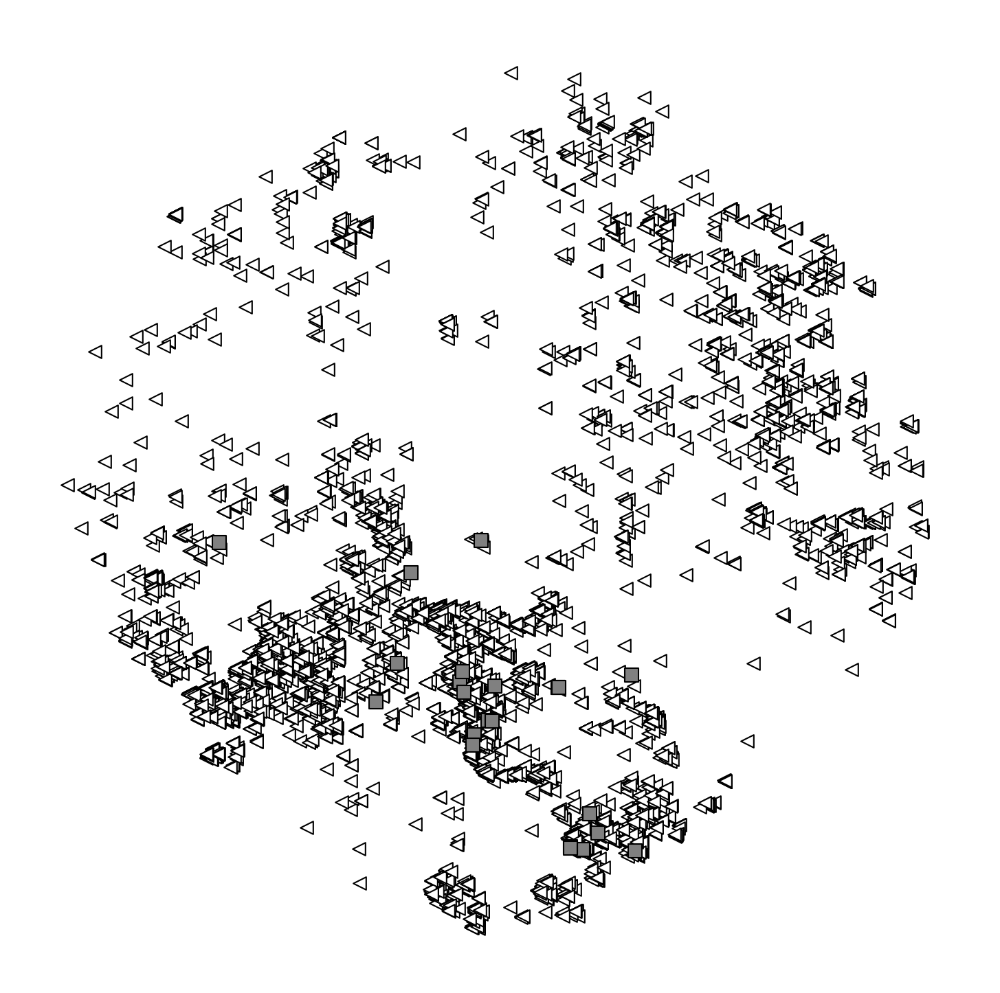

In [56]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
# shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
shapes = ['o', 's', 'o', 'o', 'o', '<', 'o', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
i=0
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, facecolor='none', edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
# ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
ax.scatter(df_sb4['tsne_0'], df_sb4['tsne_1'], label='Batch-4', alpha=1.0, color='white', edgecolor=e_colors[5], linewidth=l_widths[5], s=sizes[5], marker=shapes[5])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, facecolor='gray', edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])

# plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('tsne_batch4_acq.png', transparent=True)


#### Batch: 5

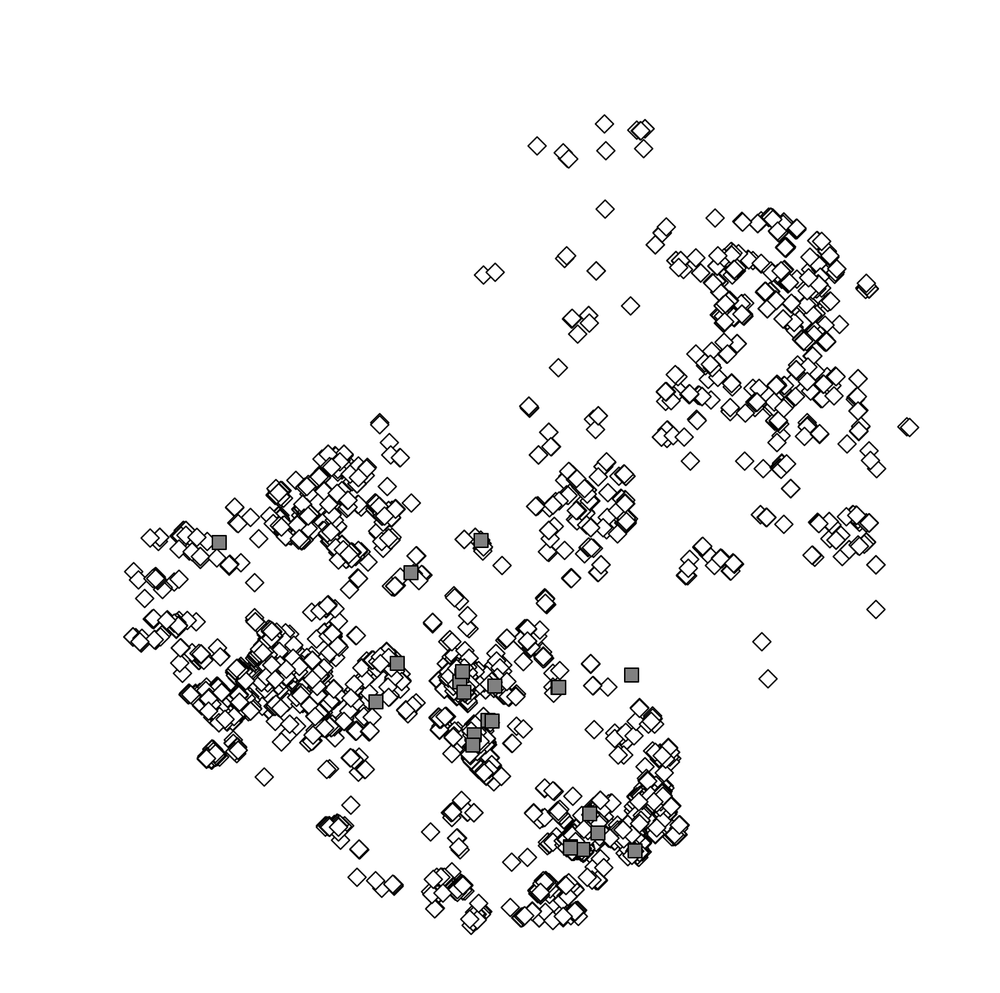

In [55]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
# shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'D', 'o', 'o', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
i=0
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, facecolor='none', edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
# ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
# ax.scatter(df_sb5['tsne_0'], df_sb5['tsne_1'], label='Batch-5', alpha=1.0, color=colors[6], edgecolor=e_colors[6], linewidth=l_widths[6], s=sizes[6], marker=shapes[6])
ax.scatter(df_sb5['tsne_0'], df_sb5['tsne_1'], label='Batch-5', alpha=1.0, color='white', edgecolor=e_colors[6], linewidth=l_widths[6], s=sizes[6], marker=shapes[6])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, facecolor='gray', edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])

# plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('tsne_batch5_acq.png', transparent=True)

#### Batch: 6

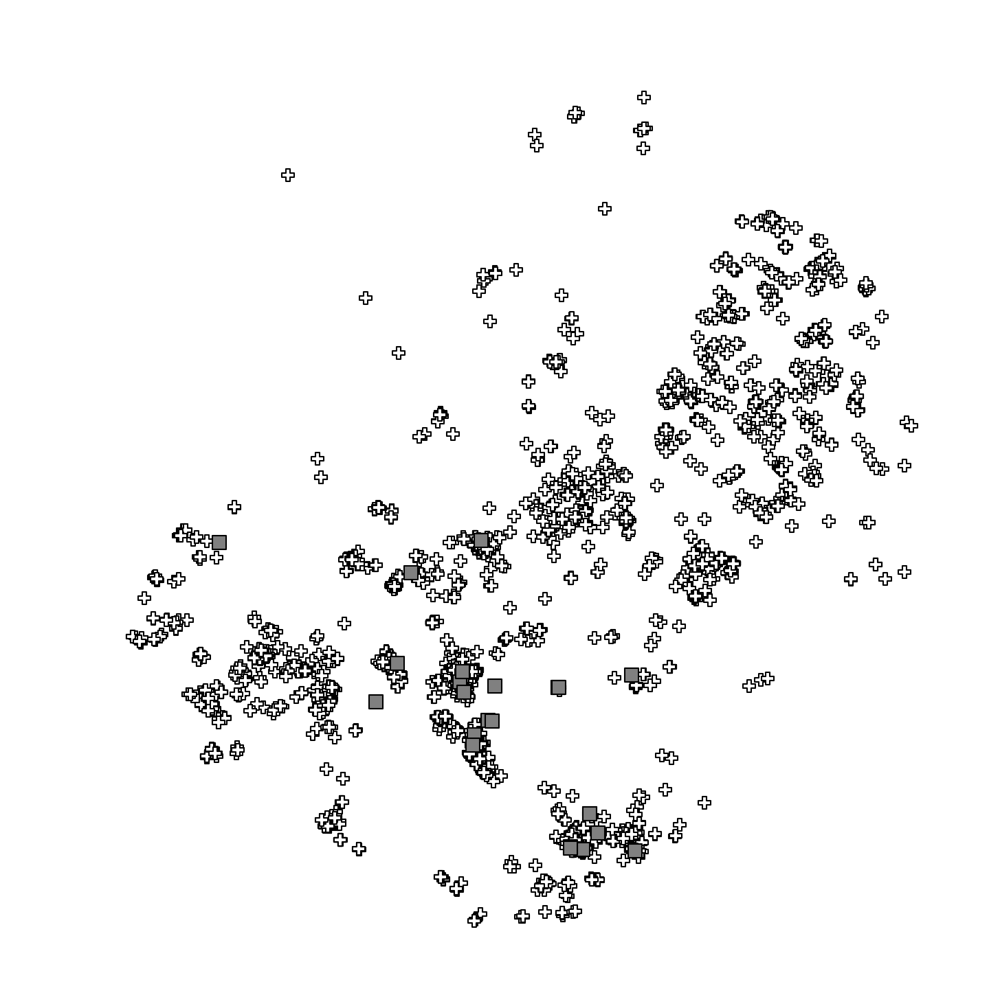

In [54]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
# shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'P', 'h', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'white', 'black']
l_widths = [0.25, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
i=0
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, facecolor='none', edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
# ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
# ax.scatter(df_sb6['tsne_0'], df_sb6['tsne_1'], label='Batch-6', alpha=1.0, color=colors[7], edgecolor=e_colors[7], linewidth=l_widths[7], s=sizes[7], marker=shapes[7])
ax.scatter(df_sb6['tsne_0'], df_sb6['tsne_1'], label='Batch-6', alpha=1.0, color='white', edgecolor=e_colors[7], linewidth=l_widths[7], s=sizes[7], marker=shapes[7])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, facecolor='gray', edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])

# plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('tsne_batch6_acq.png', transparent=True)

#### Batch: 7

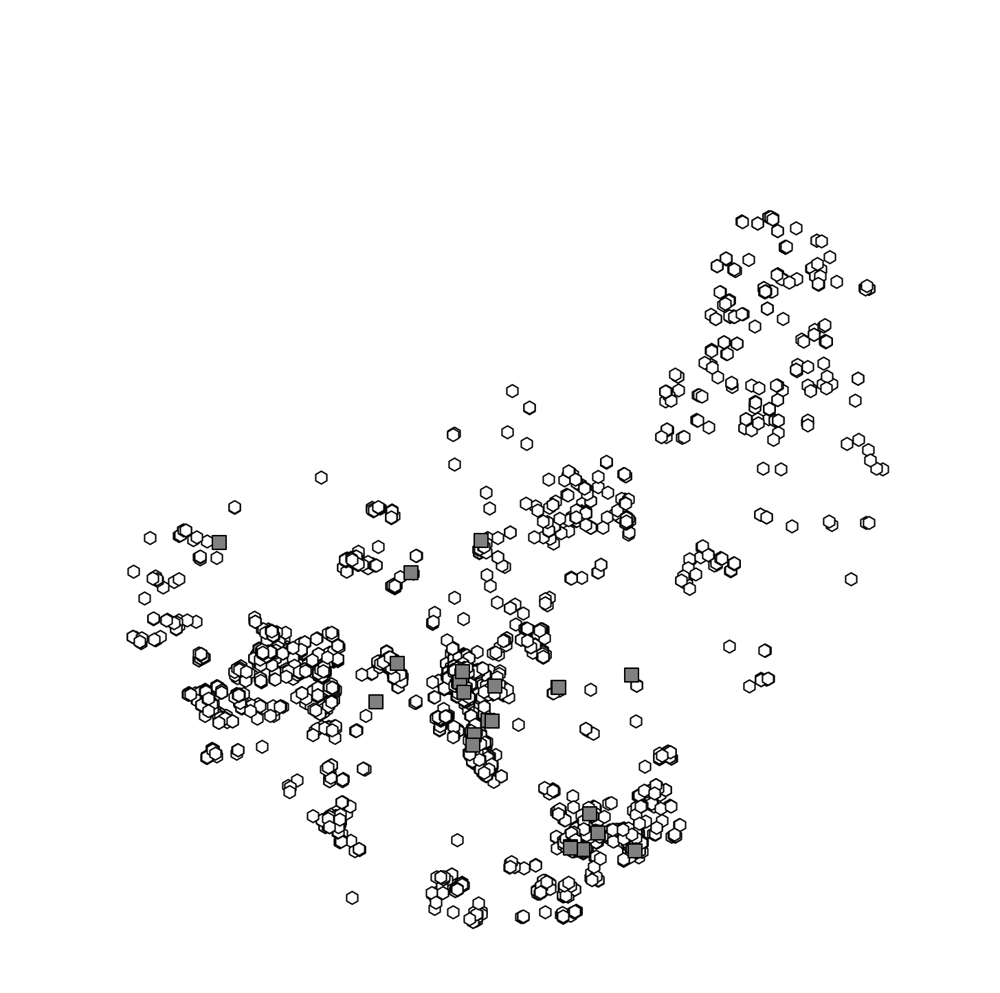

In [53]:
fig, ax = plt.subplots(figsize=(6, 6))
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7']
# colors = ['gray', green, pink, c4, orange, c1, anvil, dark_purple, purple]
classes_names = ['Unlabeled', 'Training', 'Batch-1', 'Batch-2', 'Batch-3', 'Batch-4', 'Batch-5', 'Batch-6', 'Batch-7', 'F5DEE']
colors = ['gray', orange, pink, purple, red, green, c1, anvil, blue, dark_purple]
sizes = [0.5, 23, 20, 20, 20, 20, 20, 20, 20, 20]
# shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '^']
shapes = ['o', 's', 'o', 'o', 'o', 'o', 'o', 'o', 'h', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black']
l_widths = [0.25, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
i=0
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, color=colors[0], edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='Unlabeled', alpha=1.0, facecolor='none', edgecolor=e_colors[0], linewidth=l_widths[0], s=sizes[0], marker=shapes[0])
# ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, color=colors[1], edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])
# ax.scatter(df_sb7['tsne_0'], df_sb7['tsne_1'], label='Batch-7', alpha=1.0, color=colors[8], edgecolor=e_colors[8], linewidth=l_widths[8], s=sizes[8], marker=shapes[8])
ax.scatter(df_sb7['tsne_0'], df_sb7['tsne_1'], label='Batch-7', alpha=1.0, color='white', edgecolor=e_colors[8], linewidth=l_widths[8], s=sizes[8], marker=shapes[8])
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Training', alpha=1.0, facecolor='gray', edgecolor=e_colors[1], linewidth=l_widths[1], s=sizes[1], marker=shapes[1])

import matplotlib.patches as mpatches
# # Add striped pattern using custom patches
# for x, y in zip(df_train['tsne_0'], df_train['tsne_1']):
#     circle = mpatches.Circle((x, y), radius=0.15, edgecolor='black', facecolor='none', hatch='//', linewidth=1.5)
#     ax.add_patch(circle)

# # Add striped pattern using custom patches
# for x, y in zip(df_train['tsne_0'], df_train['tsne_1']):
#     square = mpatches.Rectangle((x, y), 3, 3, edgecolor='black', facecolor='none', hatch='//', linewidth=0.25)
#     ax.add_patch(square)

# plt.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('tsne_batch7_acq.png', transparent=True)
plt.savefig('tsne_batch7_acq.png', transparent=True)

### t-SNE plot in terms of individual functional groups (mutually inclusive classification)

**Also including the phosphates on Sep 18th, 2024**

In [4]:
df_tsne = pd.read_csv('tsne_default_openTSNE_090124_new_class_acquisition_090824.csv')
df_tsne

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
0,CN(C)C=O,-1.0,['Amide'],0,-29.652721,-91.122684
1,CN1CCN(C)C1=O,-1.0,['Amide'],0,63.663623,30.721911
2,CN(C)C(=O)N(C)C,-1.0,['Amide'],0,-63.760388,9.938176
3,CB(C)C=O,-1.0,['Others'],1,-11.815345,-51.883275
4,[CH2]N(C)C=O,-1.0,['Amide'],0,-29.670045,-91.193283
...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,0.0,['Ether'],7,-20.242432,-20.010327
388009,FC(F)COCCOCC(F)F,-1.0,['Ether'],7,4.972566,-54.523802
388010,FC(F)COCCOCC(F)(F)F,8.0,['Ether'],7,23.341277,-78.180018
388011,FCCOCCF,-1.0,['Ether'],7,16.235649,-47.809552


In [5]:
## non-exclusive classification
def ether_exlc_anhydride(mol):
    if thermo.is_anhydride(mol) == False and thermo.is_carbonate(mol) == False:
        if Fragments.fr_ether(mol) >= 1 and Fragments.fr_ether(mol) > Fragments.fr_ester(mol):
            return True
    elif thermo.is_anhydride(mol) == True and thermo.is_carbonate(mol) == False:
        if Fragments.fr_ether(mol) > 1 and Fragments.fr_ether(mol) > Fragments.fr_ester(mol):
            return True 
    elif thermo.is_carbonate(mol) == True:
        if Fragments.fr_ether(mol) >= 1 and Fragments.fr_ether(mol) < Fragments.fr_C_O(mol):
            return True
    else:
        return False
    
def ester_exlc_anhydride(mol):
    if thermo.is_anhydride(mol) == False:
        if Fragments.fr_ester(mol) >= 1:
            return True
    elif thermo.is_anhydride(mol) == True:
        if Fragments.fr_ester(mol) > 1:
            return True 
    else:
        return False

def calc_func_grp_frac(df_curated, smiles_col):
    # classes = {"Carbonate":[], "Sulfone":[], "Ether":[], "Ester":[], "Nitrile":[], "Sulfoxide":[], "Sulfonyl fluoride":[], "Sulfonyl chloride":[],
    classes = {"Carbonate":[], "Sulfone":[], "Ether":[], "Ester":[], "Sulfoxide":[], "Sulfonyl fluoride":[], "Sulfonyl chloride":[], ## no Nitrile
            "Sulfonate ester":[], "Amine":[], "Amide":[], "Nitro":[], "Ketone":[], "Anhydride":[], "Imide":[], "Silyl ether":[], 
            "Phosphate": [], "Others":[]}
    class_arr = []
    for i in range(len(df_curated)):
        if type(df_curated[smiles_col][i]) == float:
            continue
        else:
            mol = Chem.MolFromSmiles(df_curated[smiles_col][i])
            entry_classes = []
            if thermo.is_anhydride(mol):
                classes['Anhydride'].append(df_curated[smiles_col][i])
                entry_classes.append('Anhydride')
            if thermo.is_sulfonate_ester(mol):
                classes['Sulfonate ester'].append(df_curated[smiles_col][i])
                entry_classes.append('Sulfonate ester')
            if "S(=O)(=O)Cl" in df_curated[smiles_col][i] and not thermo.is_sulfonate_ester(mol):
                classes['Sulfonyl chloride'].append(df_curated[smiles_col][i])
                entry_classes.append('Sulfonyl chloride')
            if "S(=O)(=O)F" in df_curated[smiles_col][i] and not thermo.is_sulfonate_ester(mol):
                classes['Sulfonyl fluoride'].append(df_curated[smiles_col][i])
                entry_classes.append('Sulfonyl fluoride')
            if Fragments.fr_sulfone(mol) >= 1:
                classes['Sulfone'].append(df_curated[smiles_col][i])
                entry_classes.append('Sulfone')
            if thermo.is_sulfoxide(mol):
                classes['Sulfoxide'].append(df_curated[smiles_col][i])
                entry_classes.append('Sulfoxide')
            if thermo.is_carbonate(mol):
                classes['Carbonate'].append(df_curated[smiles_col][i])
                entry_classes.append('Carbonate')
            # if Fragments.fr_ester(mol) >= 1:
            if ester_exlc_anhydride(mol) == True:
                classes['Ester'].append(df_curated[smiles_col][i])
                entry_classes.append('Ester')
            if Fragments.fr_nitrile(mol) >= 1: ## nitrile not present in this dataset
                classes['Nitrile'].append(df_curated[smiles_col][i])
                entry_classes.append('Nitrile')
            # if Fragments.fr_ether(mol) >= 1 and Fragments.fr_ether(mol) > Fragments.fr_ester(mol) and thermo.is_anhydride(mol) == True:
            if ether_exlc_anhydride(mol) == True:
                classes['Ether'].append(df_curated[smiles_col][i])
                entry_classes.append('Ether')
            if thermo.is_ketone(mol):
                classes['Ketone'].append(df_curated[smiles_col][i])
                entry_classes.append('Ketone')
            # if thermo.is_amide(mol):
            #     classes['Amide'].append(df_curated[smiles_col][i])
            #     entry_classes.append('Amide')
            if Fragments.fr_amide(mol) >= 1 and Fragments.fr_amide(mol) > 2 * Fragments.fr_imide(mol):
                classes['Amide'].append(df_curated[smiles_col][i])
                entry_classes.append('Amide')
            # if thermo.is_tertiary_amine(mol):
            if Fragments.fr_NH0(mol) >= 1 and Fragments.fr_NH0(mol) > Fragments.fr_amide(mol):
                classes['Amine'].append(df_curated[smiles_col][i])
                entry_classes.append('Amine')
            if thermo.is_nitro(mol):
                classes['Nitro'].append(df_curated[smiles_col][i])
                entry_classes.append('Nitro')
            # if thermo.is_imide(mol):
            if Fragments.fr_imide(mol):
                classes['Imide'].append(df_curated[smiles_col][i])
                entry_classes.append('Imide')
            if thermo.is_silyl_ether(mol):
                classes['Silyl ether'].append(df_curated[smiles_col][i])
                entry_classes.append('Silyl ether')
            if Fragments.fr_phos_ester(mol) >= 1:
                classes['Phosphate'].append(df_curated[smiles_col][i])
                entry_classes.append('Phosphate')
            # if thermo.is_phosphodiester(mol): ## not needed, already covered by phosphate
            #     classes['Phosphate diester'].append(df_curated[smiles_col][i])
            #     entry_classes.append('Phosphate diester')
            if not entry_classes:
                classes['Others'].append(df_curated[smiles_col][i])
                entry_classes.append('Others')
            class_arr.append(entry_classes)
    df_curated['class'] = class_arr
    return df_curated, classes, class_arr

In [6]:
df_tsne, classes, class_arr = calc_func_grp_frac(df_tsne, 'std_smiles')
df_tsne

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
0,CN(C)C=O,-1.0,[Amide],0,-29.652721,-91.122684
1,CN1CCN(C)C1=O,-1.0,[Amide],0,63.663623,30.721911
2,CN(C)C(=O)N(C)C,-1.0,[Amide],0,-63.760388,9.938176
3,CB(C)C=O,-1.0,[Others],1,-11.815345,-51.883275
4,[CH2]N(C)C=O,-1.0,[Amide],0,-29.670045,-91.193283
...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,0.0,[Ether],7,-20.242432,-20.010327
388009,FC(F)COCCOCC(F)F,-1.0,[Ether],7,4.972566,-54.523802
388010,FC(F)COCCOCC(F)(F)F,8.0,[Ether],7,23.341277,-78.180018
388011,FCCOCCF,-1.0,[Ether],7,16.235649,-47.809552


In [7]:
classes.keys()

dict_keys(['Carbonate', 'Sulfone', 'Ether', 'Ester', 'Sulfoxide', 'Sulfonyl fluoride', 'Sulfonyl chloride', 'Sulfonate ester', 'Amine', 'Amide', 'Nitro', 'Ketone', 'Anhydride', 'Imide', 'Silyl ether', 'Phosphate', 'Others'])

In [43]:
df_ether = df_tsne[df_tsne['class'].apply(lambda x: 'Ether' in x)]
df_carb = df_tsne[df_tsne['class'].apply(lambda x: 'Carbonate' in x)]
df_sulf = df_tsne[df_tsne['class'].apply(lambda x: 'Sulfone' in x)]
df_sulf_fl = df_tsne[df_tsne['class'].apply(lambda x: 'Sulfonyl fluoride' in x)]
df_sulf_cl = df_tsne[df_tsne['class'].apply(lambda x: 'Sulfonyl chloride' in x)]
df_sulf_ester = df_tsne[df_tsne['class'].apply(lambda x: 'Sulfonate ester' in x)]
df_anh = df_tsne[df_tsne['class'].apply(lambda x: 'Anhydride' in x)]
df_ket = df_tsne[df_tsne['class'].apply(lambda x: 'Ketone' in x)]
df_imide = df_tsne[df_tsne['class'].apply(lambda x: 'Imide' in x)]
df_sil = df_tsne[df_tsne['class'].apply(lambda x: 'Silyl ether' in x)]
df_amine = df_tsne[df_tsne['class'].apply(lambda x: 'Amine' in x)]
df_amide = df_tsne[df_tsne['class'].apply(lambda x: 'Amide' in x)]
df_phos = df_tsne[df_tsne['class'].apply(lambda x: 'Phosphate' in x)]
df_ester = df_tsne[df_tsne['class'].apply(lambda x: 'Ester' in x)]
df_other = df_tsne[df_tsne['class'].apply(lambda x: 'Others' in x)]
df_ether

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
13,CN1COCN(C)C1=O,-1.0,"[Ether, Amide]",4,65.728928,29.145800
45,COC(=O)N(C)C,-1.0,"[Ether, Amide]",4,-55.547049,10.005886
53,[CH2]OC(=O)N(C)C,-1.0,"[Ether, Amide]",4,-57.544916,5.968644
56,CN1COCC1=O,-1.0,"[Ether, Amide]",4,67.920632,29.818495
64,CB1CCOC1,-1.0,[Ether],7,3.166015,-24.302747
...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,0.0,[Ether],7,-20.242432,-20.010327
388009,FC(F)COCCOCC(F)F,-1.0,[Ether],7,4.972566,-54.523802
388010,FC(F)COCCOCC(F)(F)F,8.0,[Ether],7,23.341277,-78.180018
388011,FCCOCCF,-1.0,[Ether],7,16.235649,-47.809552


In [29]:
print(len(df_amide))
print(len(df_amide))
print(len(df_imide))
print(len(df_anh))
print(len(df_sulf_ester))
print(len(df_sulf_fl))
print(len(df_sulf_cl))
print(len(df_sulf))

170085
39701
4165
7188
709
1122
6308


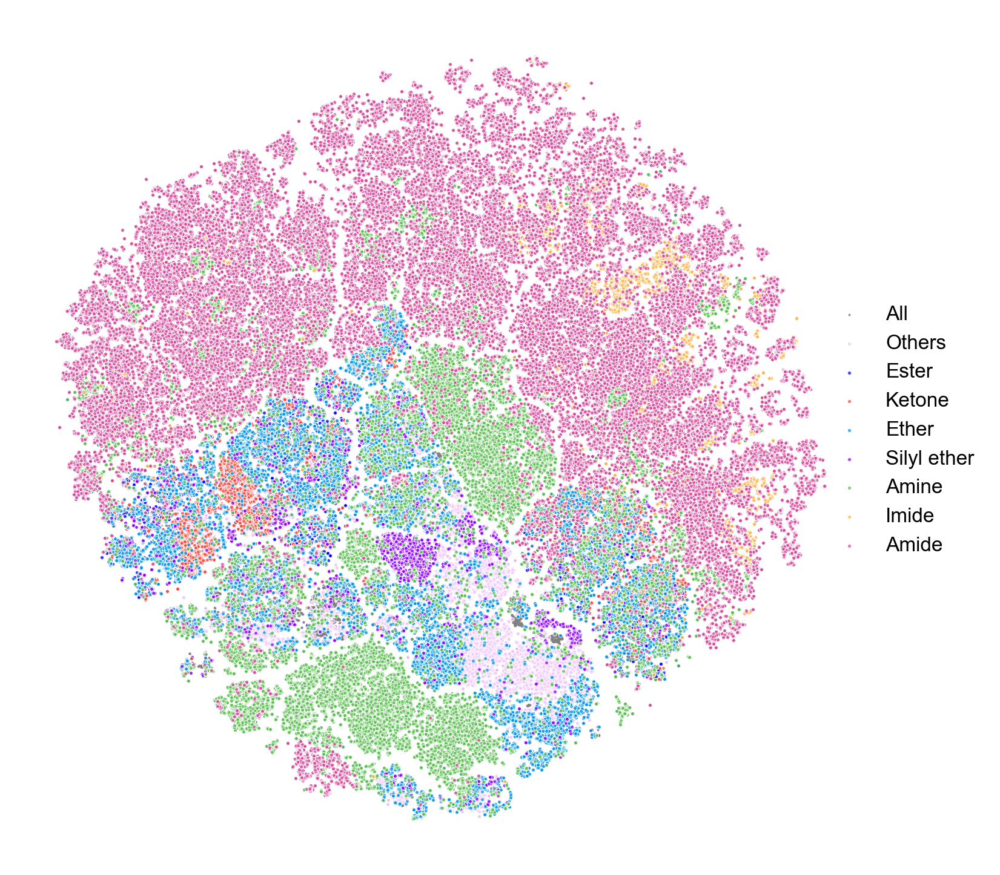

In [50]:
## plotting in terms of mutually inclusive classes
fig, ax = plt.subplots(figsize=(6, 6))
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
ax.scatter(df_other['tsne_0'], df_other['tsne_1'], label='Others', alpha=0.75, color=pink, edgecolor='white', linewidth=0.25, s=2, marker='o')
# ax.scatter(df_sulf['tsne_0'], df_sulf['tsne_1'], label='Sulfone', alpha=1.0, color=anvil, edgecolor='white', linewidth=0.25, s=3, marker='o')
ax.scatter(df_ester['tsne_0'], df_ester['tsne_1'], label='Ester', alpha=0.75, color='blue', edgecolor='white', linewidth=0.25, s=2, marker='o')
ax.scatter(df_ket['tsne_0'], df_ket['tsne_1'], label='Ketone', alpha=0.75, color=red, edgecolor='white', linewidth=0.25, s=2, marker='o')
ax.scatter(df_ether['tsne_0'], df_ether['tsne_1'], label='Ether', alpha=0.75, color=blue, edgecolor='white', linewidth=0.25, s=2, marker='o')
ax.scatter(df_sil['tsne_0'], df_sil['tsne_1'], label='Silyl ether', alpha=0.75, color=dark_purple, edgecolor='white', linewidth=0.25, s=2, marker='o')
ax.scatter(df_amine['tsne_0'], df_amine['tsne_1'], label='Amine', alpha=0.75, color=green, edgecolor='white', linewidth=0.25, s=2, marker='o')
# ax.scatter(df_carb['tsne_0'], df_carb['tsne_1'], label='Carbonate', alpha=1.0, color=orange, edgecolor='white', linewidth=0.25, s=3, marker='o')
ax.scatter(df_imide['tsne_0'], df_imide['tsne_1'], label='Imide', alpha=0.75, color=orange, edgecolor='white', linewidth=0.25, s=2, marker='o')
ax.scatter(df_amide['tsne_0'], df_amide['tsne_1'], label='Amide', alpha=0.75, color=purple, edgecolor='white', linewidth=0.25, s=2, marker='o')
# ax.scatter(df_phos['tsne_0'], df_phos['tsne_1'], label='Phosphate', alpha=1.0, color=dark_purple, edgecolor='white', linewidth=0.25, s=3, marker='o')
plt.legend(frameon=False, loc=(0.95, 0.35))
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('tsne_figSI_topclass_incl_091924.tiff', dpi=300)

In [38]:
df_ether = df_tsne[df_tsne['class'].apply(lambda x: 'Ether' in x and len(x) == 1)]
df_carb = df_tsne[df_tsne['class'].apply(lambda x: 'Carbonate' in x and len(x) == 1)]
df_sulf = df_tsne[df_tsne['class'].apply(lambda x: 'Sulfone' in x and len(x) == 1)]
df_amine = df_tsne[df_tsne['class'].apply(lambda x: 'Amine' in x and len(x) == 1)]
df_amide = df_tsne[df_tsne['class'].apply(lambda x: 'Amide' in x and len(x) == 1)]
df_phos = df_tsne[df_tsne['class'].apply(lambda x: 'Phosphate' in x and len(x) == 1)]
df_other = df_tsne[df_tsne['class'].apply(lambda x: 'Others' in x and len(x) == 1)]
df_other

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
3,CB(C)C=O,-1.0,[Others],1,-11.815345,-51.883275
27,CB(C)CF,-1.0,[Others],1,18.568990,-39.986600
50,CCB(C)C,-1.0,[Others],1,7.273691,-38.542696
60,CB(C)C(C)=O,-1.0,[Others],1,-45.740886,-21.626177
123,CB(C)P=O,-1.0,[Others],1,18.529232,-38.921584
...,...,...,...,...,...,...
387962,C[Si](C)(Cl)CC[Si](C)(Cl)Cl,-1.0,[Others],1,20.523136,-33.241213
387963,CO[Si](C)(OC)C(C)C,-1.0,[Others],1,13.349023,-49.950012
387978,CCCC[SiH2]OC(CC)CC,-1.0,[Others],1,7.772989,-63.182957
387984,BC(C(=O)OSC)C(=O)OSC,-1.0,[Others],1,-48.065682,2.907866


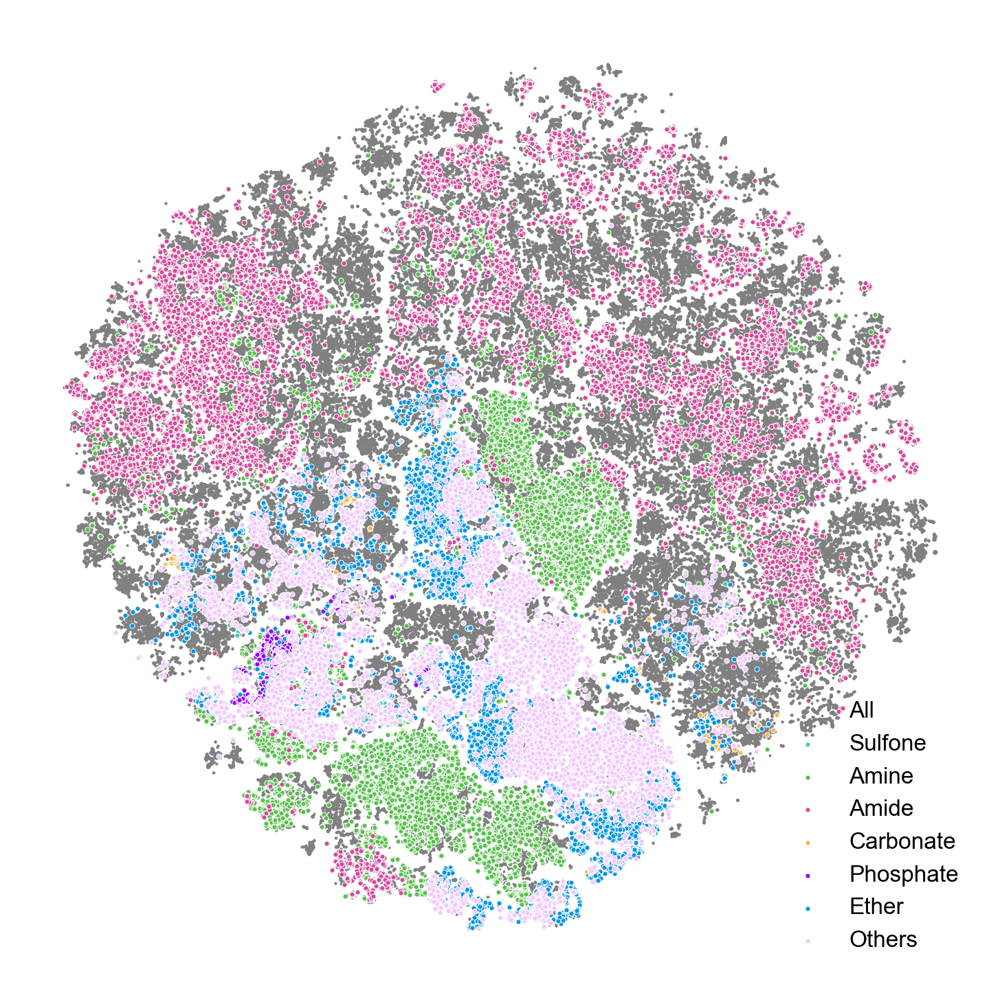

In [22]:
## plotting in terms of mutually inclusive classes
fig, ax = plt.subplots(figsize=(6, 6))
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=1.0, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
ax.scatter(df_sulf['tsne_0'], df_sulf['tsne_1'], label='Sulfone', alpha=1.0, color=anvil, edgecolor='white', linewidth=0.25, s=3, marker='o')
ax.scatter(df_amine['tsne_0'], df_amine['tsne_1'], label='Amine', alpha=1.0, color=green, edgecolor='white', linewidth=0.25, s=3, marker='o')
ax.scatter(df_amide['tsne_0'], df_amide['tsne_1'], label='Amide', alpha=1.0, color=purple, edgecolor='white', linewidth=0.25, s=3, marker='o')
ax.scatter(df_carb['tsne_0'], df_carb['tsne_1'], label='Carbonate', alpha=1.0, color=orange, edgecolor='white', linewidth=0.25, s=3, marker='o')
ax.scatter(df_phos['tsne_0'], df_phos['tsne_1'], label='Phosphate', alpha=1.0, color=dark_purple, edgecolor='white', linewidth=0.25, s=3, marker='o')
ax.scatter(df_ether['tsne_0'], df_ether['tsne_1'], label='Ether', alpha=1.0, color=blue, edgecolor='white', linewidth=0.25, s=3, marker='o')
# ax.scatter(df_other['tsne_0'], df_other['tsne_1'], label='Others', alpha=1.0, color=pink, edgecolor='white', linewidth=0.25, s=3, marker='o')
plt.legend(frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('x_tsne_fig2_acquisition_091024.tiff', dpi=300)

### t-SNE plot in terms of exploitation ratios

In [5]:
df_tsne = pd.read_csv('tsne_default_openTSNE_090124_new_class_acquisition_090824.csv')
df_tsne

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
0,CN(C)C=O,-1.0,['Amide'],0,-29.652721,-91.122684
1,CN1CCN(C)C1=O,-1.0,['Amide'],0,63.663623,30.721911
2,CN(C)C(=O)N(C)C,-1.0,['Amide'],0,-63.760388,9.938176
3,CB(C)C=O,-1.0,['Others'],1,-11.815345,-51.883275
4,[CH2]N(C)C=O,-1.0,['Amide'],0,-29.670045,-91.193283
...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,0.0,['Ether'],7,-20.242432,-20.010327
388009,FC(F)COCCOCC(F)F,-1.0,['Ether'],7,4.972566,-54.523802
388010,FC(F)COCCOCC(F)(F)F,8.0,['Ether'],7,23.341277,-78.180018
388011,FCCOCCF,-1.0,['Ether'],7,16.235649,-47.809552


In [8]:
df_tsne.loc[df_tsne['std_smiles'] == 'CC(OCCN(C)C)C(C)(C)[Si]']

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
321324,CC(OCCN(C)C)C(C)(C)[Si],-1.0,"['Ether', 'Amine']",8,-33.460405,-77.981274


In [15]:
df_train = df_tsne.loc[df_tsne['expt_test'] == 0]
df_train

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1
28126,CCOCCOCC,0.0,['Ether'],7,0.496001,-47.439290
36387,CCS(=O)(=O)F,0.0,['Sulfonyl fluoride'],98,-28.999701,-51.292300
103377,CCOCCS(=O)(=O)F,0.0,"['Sulfonyl fluoride', 'Ether']",153,-23.684909,-42.022341
333568,COCCOC,0.0,['Ether'],7,-7.776405,-45.004559
333838,COCCOCCOC,0.0,['Ether'],7,-8.224551,-46.568119
333855,CCCCOCCOC,0.0,['Ether'],7,-7.112939,-48.987523
333859,COCCOC(C)C,0.0,['Ether'],7,-4.673338,-59.285648
333915,COCCOC(C)(C)C,0.0,['Ether'],7,22.218557,-87.166777
334365,FCCOCCOCCF,0.0,['Ether'],7,16.220142,-47.850935
334890,CCOCCOC(C)(C)C,0.0,['Ether'],7,26.010677,-83.126759


#### Batch: 1

In [72]:
# df_b1_exp = pd.read_csv('../campaign-1/exploit_ratio_b1_5000_101124.csv')
# df_b1_exp = pd.read_csv('../campaign-1/exploit_ratio_b1_5000_101624.csv')
df_b1_exp = pd.read_csv('../campaign-1/exploit_ratio_b1_5000_110224.csv')
df_b1_exp['std_smiles'] = df_b1_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b1_exp['batch'] = '1'
df_b1_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,EI_rq,EI_rbfexpsin,EI_aggr,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,std_smiles,batch
0,COC1(C(F)F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.274757,-1.203490,1.041326,-1.025159,-0.415797,-0.178878,-0.554024,0.520806,...,0.032396,0.482305,1.448163e-06,0.000005,0.002300,8.438763e-07,6.042866e-07,0.417278,COC1(C(F)F)CCCCC1,1
1,COC1(C(F)(F)F)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.285596,-1.266693,1.241411,-1.102478,0.376095,0.166441,0.024304,0.431072,...,0.030553,0.455206,1.431874e-06,0.000005,0.002295,8.434955e-07,5.883782e-07,0.410915,COC1(C(F)(F)F)CCCC1,1
2,COC1(C(C)(F)F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.307584,-1.226729,1.247259,-1.216207,0.634606,0.169550,0.293654,0.228677,...,0.029139,0.468436,1.427106e-06,0.000004,0.002259,8.364115e-07,5.906943e-07,0.413911,COC1(C(C)(F)F)CCCCC1,1
3,COC1(C(F)F)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.212383,-1.226273,1.055989,-0.997153,-0.403396,-0.225401,-0.523877,0.563653,...,0.033008,0.448318,1.424359e-06,0.000005,0.002308,8.513511e-07,5.730075e-07,0.402292,COC1(C(F)F)CCCC1,1
4,COC1(F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.431572,-1.193527,1.149880,-0.973532,-0.004855,0.304571,-0.444267,0.611225,...,0.031455,0.476645,1.414010e-06,0.000005,0.002275,8.500037e-07,5.640064e-07,0.398870,COC1(F)CCCCC1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,COC1(N(C)C)CCCN(C=O)C1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.851376,-0.103686,0.435008,-0.624247,0.082175,0.010039,-0.210949,1.345988,...,0.022038,0.240340,6.723695e-07,0.000003,0.001721,8.959106e-07,-2.235411e-07,-0.332468,COC1(N(C)C)CCCN(C=O)C1,1
4996,CC(C)S(=O)(=O)N1CCCC(=O)C1(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.919765,-0.738924,0.410033,-0.039115,0.401307,-1.606753,-0.360065,0.420094,...,0.023258,0.230383,6.723394e-07,0.000003,0.001751,8.938906e-07,-2.215512e-07,-0.329523,CC(C)S(=O)(=O)N1CCCC(=O)C1(C)C,1
4997,COC(C)(C)CN1CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.530021,-0.678923,0.777904,-0.079169,0.266731,-0.372377,1.513170,0.303756,...,0.019859,0.191656,6.723381e-07,0.000004,0.001807,8.884141e-07,-2.160760e-07,-0.321380,COC(C)(C)CN1CCCC1,1
4998,CC1(C)CC(F)(F)CCC1=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.535133,-1.218282,0.895559,-0.445502,0.728748,-0.887856,-1.237669,0.645537,...,0.024031,0.188132,6.723154e-07,0.000004,0.001818,8.932022e-07,-2.208867e-07,-0.328546,CC1(C)CC(F)(F)CCC1=O,1


In [50]:
df_b1_exp_ = df_tsne.merge(df_b1_exp[['std_smiles', 'batch', 'ratio_aggr', 'exploit_aggr', 'explore_aggr', 'EI_aggr']], on='std_smiles', how='inner')
df_b1_exp_['new_ratio'] = df_b1_exp_['exploit_aggr'] / df_b1_exp_['explore_aggr']
# df_b1_exp_ = df_b1_exp_.sort_values(by='ratio_aggr', ascending=True)
df_b1_exp_ = df_b1_exp_.sort_values(by='new_ratio', ascending=True)
df_b1_exp_

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio
4556,COCC(OC)C(F)(F)Cl,-1.0,['Ether'],7,25.916989,-94.504865,1,-0.388624,-2.641666e-07,9.439145e-07,6.797479e-07,-0.279863
729,CCOP(OC)C(C)C,-1.0,['Others'],1,6.091659,-51.462162,1,-0.365574,-2.465749e-07,9.210626e-07,6.744877e-07,-0.267707
3747,COCC(OC)C(F)(F)F,-1.0,['Ether'],7,26.008004,-94.509792,1,-0.361132,-2.506293e-07,9.446398e-07,6.940105e-07,-0.265317
3444,COCCC(F)(F)C(F)(F)F,-1.0,['Ether'],7,19.559545,-83.438550,1,-0.355509,-2.489534e-07,9.492259e-07,7.002725e-07,-0.262270
2803,CCCOP(OC)C(C)C,-1.0,['Others'],1,4.419209,-50.787374,1,-0.350001,-2.389757e-07,9.217610e-07,6.827853e-07,-0.259260
...,...,...,...,...,...,...,...,...,...,...,...,...
4091,COCCOC1(C(F)(F)F)CCCC1,-1.0,['Ether'],7,-7.544518,-41.864004,1,0.399551,5.638591e-07,8.473732e-07,1.411232e-06,0.665420
2041,COC1(C(F)F)CCCC1,-1.0,['Ether'],7,-4.222640,2.258500,1,0.402292,5.730075e-07,8.513511e-07,1.424359e-06,0.673057
2874,COC1(C(F)(F)F)CCCC1,-1.0,['Ether'],7,-3.226903,4.628638,1,0.410915,5.883782e-07,8.434955e-07,1.431874e-06,0.697547
4462,COC1(C(C)(F)F)CCCCC1,-1.0,['Ether'],7,-3.162372,4.601508,1,0.413911,5.906943e-07,8.364115e-07,1.427106e-06,0.706225


#### Batch: 2

In [70]:
# df_b2_exp = pd.read_csv('../campaign-2/exploit_ratio_b2_5000_101124.csv')
# df_b2_exp = pd.read_csv('../campaign-2/exploit_ratio_b2_5000_101624.csv')
df_b2_exp = pd.read_csv('../campaign-2/exploit_ratio_b2_5000_110224.csv')
df_b2_exp['std_smiles'] = df_b2_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b2_exp['batch'] = '2'
df_b2_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,pressure_type,solv,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,COC(C)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.776835,-1.399544,0.649007,-0.799742,-0.514680,-0.964902,0.077170,-0.043500,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c1065190>,2.115874e-06,0.001038,8.787375e-08,-6.848229e-08,-3.531568,1.939147e-08,COC(C)F,2
1,CO[Si](CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.703865,-1.378061,0.988412,-0.661167,0.540599,-0.224957,0.849146,-0.022704,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c1065200>,1.449644e-06,0.000904,1.254453e-07,-9.557871e-08,-3.200191,2.986656e-08,CO[Si](CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(...,2
2,CO[Si](CCCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.861433,-1.423950,0.911623,-0.390941,0.479303,-0.022299,0.834731,0.002459,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c1065270>,1.371849e-06,0.000882,1.247090e-07,-9.496142e-08,-3.192244,2.974754e-08,CO[Si](CCCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C...,2
3,CO[Si](C)(CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)CC[Si]...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.539653,-1.463092,1.088129,-0.663931,0.622251,-0.101533,0.747581,0.091219,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c10652e0>,1.331733e-06,0.000863,1.167798e-07,-9.006070e-08,-3.370653,2.671907e-08,CO[Si](C)(CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)CC[Si]...,2
4,CO[Si](OC)(OC)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.492592,-1.463532,1.139268,-0.682042,0.564576,-0.265117,0.719485,-0.057621,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c1065350>,1.344172e-06,0.000877,1.268925e-07,-9.647359e-08,-3.171501,3.041890e-08,CO[Si](OC)(OC)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)...,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3752,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.915870,-0.938476,0.970829,0.044332,-0.738988,0.996804,0.802128,0.293352,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c5811900>,8.716616e-07,0.000732,9.147385e-08,-7.239964e-08,-3.795683,1.907421e-08,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,2
3753,CO[Si](CCC(CC[Si](OC)(OC)OC)CC[Si](OC)(OC)OC)(...,[Li+].O=C1O[B-](F)(F)OC1=O,-0.784803,-1.203755,0.512146,-0.385240,-0.676515,-0.570004,0.204125,-0.038398,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c5811970>,7.620538e-07,0.000704,9.309433e-08,-7.370886e-08,-3.802274,1.938547e-08,CO[Si](CCC(CC[Si](OC)(OC)OC)CC[Si](OC)(OC)OC)(...,2
3754,COCCC(OC)N(C)C(C)(C)C,[Li+].O=C1O[B-](F)(F)OC1=O,-1.204121,-0.980336,-0.080584,-1.088509,-0.349281,-0.071455,1.546685,0.465116,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c58119e0>,1.273999e-06,0.000840,8.813929e-08,-6.943111e-08,-3.711269,1.870818e-08,COCCC(OC)N(C)C(C)(C)C,2
3755,CO[Si](CCCCC(CCC[Si](OC)(OC)OC)C(C)(C)CC(C)(C)...,[Li+].O=C1O[B-](F)(F)OC1=O,-1.114709,-1.313834,0.572373,-0.257871,-0.122796,-0.486306,0.851936,-0.298315,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c5811a50>,9.009707e-07,0.000768,1.233529e-07,-9.302208e-08,-3.066918,3.033080e-08,CO[Si](CCCCC(CCC[Si](OC)(OC)OC)C(C)(C)CC(C)(C)...,2


In [71]:
df_b2_exp_ = df_tsne.merge(df_b2_exp[['std_smiles', 'batch', 'ratio_aggr', 'exploit_aggr', 'explore_aggr', 'EI_aggr']], on='std_smiles', how='inner')
# df_b2_exp_ = df_b2_exp_.sort_values(by='ratio_aggr', ascending=True)
df_b2_exp_['new_ratio'] = df_b2_exp_['exploit_aggr'] / df_b2_exp_['explore_aggr']
df_b2_exp_ = df_b2_exp_.sort_values(by='new_ratio', ascending=True)
df_b2_exp_

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio
2995,CC(OCCN(C)C)C(C)(C)[Si],-1.0,"['Ether', 'Amine']",8,-33.460405,-77.981274,2,-4.011636,-7.306047e-08,9.127261e-08,1.821214e-08,-0.800464
2350,COS(C)(OC)N(C)CC(C)(F)F,-1.0,['Amine'],2,-0.869205,-88.605419,2,-4.001284,-7.271590e-08,9.088904e-08,1.817314e-08,-0.800051
2589,CC(C)OCCCN(C)C(C)(C)C,-1.0,"['Ether', 'Amine']",8,-42.469064,-81.699423,2,-4.001079,-7.312048e-08,9.139567e-08,1.827519e-08,-0.800043
623,CON(C)CCCOOC(C)(C)C,-1.0,['Amine'],2,-35.925956,-74.713798,2,-3.998178,-7.319975e-08,9.150803e-08,1.830828e-08,-0.799927
2337,COC(C)(C)CN(C)CC(F)(F)F,-1.0,"['Ether', 'Amine']",8,8.698137,-92.427610,2,-3.996284,-7.312403e-08,9.142204e-08,1.829801e-08,-0.799851
...,...,...,...,...,...,...,...,...,...,...,...,...
1528,COCCOCC(C)(OC)C(F)(F)F,-1.0,['Ether'],7,19.401156,-86.965472,2,-1.300471,-1.170652e-07,2.070828e-07,9.001758e-08,-0.565306
2047,COCCC(C)(C)OOC(C)(C)C,-1.0,['Ether'],7,19.885507,-84.858407,2,-1.246004,-1.151357e-07,2.075397e-07,9.240399e-08,-0.554765
1441,COCCOCC(C)(OC)C(F)F,-1.0,['Ether'],7,40.098117,-83.412985,2,-1.219009,-1.199578e-07,2.183637e-07,9.840593e-08,-0.549348
2405,COCC(C)(COC)COCCF,-1.0,['Ether'],7,33.117483,-85.964529,2,-1.202448,-1.176734e-07,2.155350e-07,9.786158e-08,-0.545960


#### Batch: 3

In [6]:
df_b3_exp = pd.read_csv('../campaign-3/exploit_ratio_b3_10000_110224.csv')
df_b3_exp['std_smiles'] = df_b3_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b3_exp['batch'] = '3'
df_b3_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,amt_electrolyte,pressure_type,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.371209,0.423985,0.087168,-0.390568,1.106635,0.478028,0.524065,0.414960,...,50,2,9.818468e-07,0.000796,1.144290e-07,-8.759247e-08,-3.263929,2.683651e-08,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,3
1,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.431278,0.458372,0.033057,-0.526323,1.347255,0.546517,0.808674,0.145876,...,50,2,9.729763e-07,0.000797,1.184382e-07,-9.013896e-08,-3.185212,2.829920e-08,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,3
2,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.369815,0.425456,0.086003,-0.388726,1.105710,0.477714,0.523496,0.416414,...,50,2,1.031936e-06,0.000794,9.934253e-08,-7.795002e-08,-3.643800,2.139251e-08,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,3
3,COC(=O)C(F)(F)C(F)(F)C(F)(F)C(=O)N(C)CCC[Si](O...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.538909,0.674474,0.272739,-0.443989,1.058057,0.533427,0.546245,0.314937,...,50,2,1.027699e-06,0.000792,9.836540e-08,-7.733640e-08,-3.677607,2.102900e-08,COC(=O)C(F)(F)C(F)(F)C(F)(F)C(=O)N(C)CCC[Si](O...,3
4,CO[Si](CCCCN(C)C(=O)N(C(=O)N(C)C)C(=O)N(C)CCCC...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.370517,0.607333,-0.126657,-0.230992,0.625624,0.741056,-0.063577,0.746594,...,50,2,8.526140e-07,0.000795,1.457390e-07,-1.048731e-07,-2.566271,4.086594e-08,CO[Si](CCCCN(C)C(=O)N(C(=O)N(C)C)C(=O)N(C)CCCC...,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8949,CCCN(C)CCCCOCCOC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.200232,-0.716220,-0.632898,0.237957,-0.464196,1.822570,0.894457,0.749287,...,50,2,9.301365e-07,0.000749,7.381771e-08,-5.988471e-08,-4.298050,1.393300e-08,CCCN(C)CCCCOCCOC,3
8950,COCCN(C)CCC[Si](COC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.029200,-0.997617,-0.280489,-0.503384,-0.357378,1.088322,1.093044,1.384092,...,50,2,9.066336e-07,0.000738,6.721053e-08,-5.494478e-08,-4.479527,1.226576e-08,COCCN(C)CCC[Si](COC)(OC)OC,3
8951,COCCOCCCN(C)CCCCl,[Li+].O=C1O[B-](F)(F)OC1=O,-0.951036,-0.576891,-0.254395,-0.465784,-0.325791,1.397665,1.032146,0.948021,...,50,2,9.882002e-07,0.000762,6.936447e-08,-5.653333e-08,-4.405945,1.283115e-08,COCCOCCCN(C)CCCCl,3
8952,CCCCOCCN(CCC[Si](OC)(OC)OC)CCOC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.164254,-1.313408,-0.158492,0.408141,-0.805483,1.630553,0.830279,0.463970,...,50,2,9.512937e-07,0.000759,7.802918e-08,-6.290676e-08,-4.159836,1.512242e-08,CCCCOCCN(CCC[Si](OC)(OC)OC)CCOC,3


In [7]:
df_b3_exp_ = df_tsne.merge(df_b3_exp[['std_smiles', 'batch', 'prediction_aggr', 'uncertainty_aggr', 'ratio_aggr', 'exploit_aggr', 'explore_aggr', 'EI_aggr']], on='std_smiles', how='inner')
df_b3_exp_['new_ratio'] = df_b3_exp_['exploit_aggr'] / df_b3_exp_['explore_aggr']
df_b3_exp_ = df_b3_exp_.sort_values(by='new_ratio', ascending=True)
df_b3_exp_

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,prediction_aggr,uncertainty_aggr,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio
3959,CC(C)OCCCOCCN(C)C,-1.0,"['Ether', 'Amine']",8,-34.191615,-78.058136,3,1.204307e-06,0.000800,-4.688342,-5.757378e-08,6.985398e-08,1.228020e-08,-0.824202
603,CN(C)CCOCCC[Si],-1.0,"['Ether', 'Amine']",8,-38.172114,-74.892656,3,1.268256e-06,0.000820,-4.674639,-5.768137e-08,7.002059e-08,1.233921e-08,-0.823777
2860,CCCOCCCN(C)C(C)(C)C,-1.0,"['Ether', 'Amine']",8,-42.581510,-81.268902,3,1.284039e-06,0.000824,-4.674013,-5.741563e-08,6.969964e-08,1.228401e-08,-0.823758
382,CCOCCCN(C)N(C)C,-1.0,"['Ether', 'Amine']",8,-39.607921,-76.496098,3,1.353217e-06,0.000844,-4.673348,-5.755721e-08,6.987326e-08,1.231605e-08,-0.823737
8308,CCN(CC)C(=O)N(C)CCCCOC(C)C,-1.0,"['Ether', 'Amide']",4,-58.920922,68.028159,3,9.647973e-07,0.000738,-4.670905,-5.722958e-08,6.948193e-08,1.225235e-08,-0.823661
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3143,COCCOCCC(F)(F)C(F)(F)F,-1.0,['Ether'],7,20.000033,-83.324855,3,3.036429e-06,0.001320,-1.622163,-7.225869e-08,1.168034e-07,4.454466e-08,-0.618635
7151,COCCOCCO[Si](CCCN(C)C(=O)N(C)C)(OCCOCCOC)OCCOCCOC,-1.0,"['Ether', 'Amide', 'Silyl ether']",55,-45.420592,78.106399,3,1.147091e-06,0.000931,-1.618807,-1.233428e-07,1.995364e-07,7.619361e-08,-0.618147
8040,COCCCCCCN(C)C(=O)CN(C)C(=O)CN(C)C(=O)CN(C)C(=O...,-1.0,"['Ether', 'Amide', 'Amine']",13,-50.372253,71.113426,3,1.206434e-06,0.000947,-1.612581,-1.236758e-07,2.003702e-07,7.669432e-08,-0.617237
4076,COCCOCC(F)(OC)C(F)(F)F,-1.0,['Ether'],7,19.330343,-86.896152,3,3.143568e-06,0.001351,-1.388786,-7.047338e-08,1.212180e-07,5.074461e-08,-0.581377


#### Batch: 4

In [55]:
df_b4_exp = pd.read_csv('../campaign-4/exploit_ratio_b4_10000_110224.csv')
df_b4_exp['std_smiles'] = df_b4_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b4_exp['batch'] = '4'
df_b4_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,pressure_type,rank,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,CN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.842454,-0.969284,0.843293,0.542591,0.659271,-1.028246,-0.227193,0.548413,...,2,854.0,3.809569e-07,0.000613,4.717666e-08,-3.970714e-08,-5.315888,7.469522e-09,CN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(...,4
1,CN1C(=O)N2CN3C(=O)N4CN5C(=O)N(C)C6C5N(CN5C(=O)...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.140354,-0.922768,0.777714,0.484251,0.590515,-0.894770,-0.217753,0.316862,...,2,3380.0,3.333645e-07,0.000585,3.230432e-08,-2.769543e-08,-6.009128,4.608893e-09,CN1C(=O)N2CN3C(=O)N4CN5C(=O)N(C)C6C5N(CN5C(=O)...,4
2,CN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.842454,-0.969284,0.843293,0.542591,0.659271,-1.028246,-0.227193,0.548413,...,2,4319.0,4.195568e-07,0.000587,3.019479e-08,-2.597395e-08,-6.153732,4.220845e-09,CN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(...,4
3,CN1CCCC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)C...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.244749,-0.718715,0.816326,0.622103,0.842643,-1.134638,0.343202,0.456895,...,2,1275.0,4.778951e-07,0.000616,4.250074e-08,-3.603028e-08,-5.568422,6.470464e-09,CN1CCCC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)C...,4
4,CCCN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)C...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.545357,-1.096163,0.435487,1.288385,0.482219,-0.659059,-0.329151,0.365688,...,2,506.0,3.220242e-07,0.000620,5.466365e-08,-4.557863e-08,-5.016902,9.085015e-09,CCCN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)C...,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8744,COCCOCCCCCCCCCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.908149,-0.944494,0.971822,0.043047,-0.735702,0.985443,0.804811,0.287560,...,2,7032.0,7.301459e-07,0.000644,2.668225e-08,-2.318253e-08,-6.624107,3.499721e-09,COCCOCCCCCCCCCCC[Si](OC)(OC)OC,4
8745,CO[Si](OC)(OC)C([Si](OC)(OC)OC)([Si](OC)(OC)OC...,[Li+].O=C1O[B-](F)(F)OC1=O,-0.473794,-1.393888,1.066949,-0.607220,0.353716,-0.159430,0.584239,-0.017302,...,2,4871.0,3.959835e-07,0.000585,3.002041e-08,-2.597474e-08,-6.420383,4.045668e-09,CO[Si](OC)(OC)C([Si](OC)(OC)OC)([Si](OC)(OC)OC...,4
8746,CCCCCCCCCCCCOCCOCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.076872,-1.681724,0.426816,1.007279,-0.740516,1.312715,0.261993,-0.277779,...,2,1628.0,5.599071e-07,0.000624,4.023875e-08,-3.430591e-08,-5.782378,5.932837e-09,CCCCCCCCCCCCOCCOCCC[Si](OC)(OC)OC,4
8747,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.915870,-0.938476,0.970829,0.044332,-0.738988,0.996804,0.802128,0.293352,...,2,1700.0,6.721882e-07,0.000651,3.951917e-08,-3.366613e-08,-5.751911,5.853034e-09,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,4


In [56]:
df_b4_exp_ = df_tsne.merge(df_b4_exp[['std_smiles', 'batch', 'prediction_aggr', 'uncertainty_aggr', 'ratio_aggr', 'exploit_aggr', 'explore_aggr', 'EI_aggr']], on='std_smiles', how='inner')
df_b4_exp_['new_ratio'] = df_b4_exp_['exploit_aggr'] / df_b4_exp_['explore_aggr']
df_b4_exp_ = df_b4_exp_.sort_values(by='new_ratio', ascending=True)
df_b4_exp_

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,prediction_aggr,uncertainty_aggr,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio
8158,CCOC(=O)C12N(C)C(=O)N3CN(CCOC)CN(C(=O)N1C)C32C...,-1.0,"['Ester', 'Ether', 'Amide', 'Amine']",137,35.931888,-8.777703,4,3.069713e-07,0.000560,-6.912213,-2.001045e-08,2.290539e-08,2.894941e-09,-0.873613
8739,COC1(CN2CCN(C)CC2)CCCN(C(=O)CCN2C(=O)N(C)C(C)(...,-1.0,"['Ether', 'Amide', 'Amine', 'Imide']",118,104.664920,-4.403391,4,2.083570e-08,0.000573,-6.842396,-2.074245e-08,2.377391e-08,3.031460e-09,-0.872488
8748,CO[Si](CCCCCCCCCCCCO[Si](OC)(OC)OC)(OC)OC,-1.0,['Silyl ether'],24,-13.477308,-31.436743,4,4.737451e-07,0.000584,-6.826220,-2.104634e-08,2.412950e-08,3.083161e-09,-0.872224
8441,COP(=O)(OC)C(OF)(C(F)(F)C(F)(F)C(F)(F)F)P(=O)(...,-1.0,['Others'],1,-67.842939,-55.115195,4,6.922542e-07,0.000622,-6.791449,-2.062852e-08,2.366594e-08,3.037425e-09,-0.871654
8239,CN1[Si]N(C)[Si]N(C)[Si](C)(C)N(C)[Si](C)(C)N(C...,-1.0,['Amine'],2,14.918095,-16.335008,4,2.048330e-07,0.000556,-6.790062,-1.939446e-08,2.225076e-08,2.856300e-09,-0.871631
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2670,COCCC(C)(C)OP(=O)(OC)OC,-1.0,['Ether'],7,-63.460901,-49.495194,4,2.589734e-06,0.001186,-1.508503,-5.725453e-08,9.520908e-08,3.795455e-08,-0.601356
7459,COCC(OCF)(OCF)OCF,-1.0,['Ether'],7,34.306973,-87.055129,4,2.417959e-06,0.001109,-1.406882,-4.469087e-08,7.645675e-08,3.176589e-08,-0.584525
3500,COCCOC(F)(F)C(F)(F)CF,-1.0,['Ether'],7,22.929044,-86.745393,4,2.768886e-06,0.001226,-1.239438,-5.156123e-08,9.316172e-08,4.160049e-08,-0.553459
4145,COCCOCCC(F)(F)C(F)(F)F,-1.0,['Ether'],7,20.000033,-83.324855,4,2.946592e-06,0.001293,-1.169571,-5.850104e-08,1.085203e-07,5.001922e-08,-0.539079


#### Batch: 5

In [68]:
# df_b5_exp = pd.read_csv('../campaign-5/exploit_ratio_b5_5000_101624.csv')
df_b5_exp = pd.read_csv('../campaign-5/exploit_ratio_b5_5000_110224.csv')
df_b5_exp['std_smiles'] = df_b5_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b5_exp['batch'] = '5'
df_b5_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,pressure_type,rank,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,CCCOOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.920924,-1.603036,0.550274,0.249128,-0.250719,0.486272,0.282188,0.202565,...,2,1482.0,1.377135e-06,0.000729,1.646288e-08,-1.366268e-08,-4.879178,2.800201e-09,CCCOOC,5
1,[CH2]CCOOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.653605,-1.424194,0.878123,-0.406314,-0.163474,0.121483,0.449710,0.405105,...,2,4619.0,1.554081e-06,0.000790,1.153646e-08,-9.914691e-09,-6.113494,1.621772e-09,[CH2]CCOOC,5
2,CCCOP(=O)(OC)OOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.976774,-1.307574,0.817352,0.341483,-0.258352,0.456097,0.319158,0.267196,...,2,2813.0,1.414756e-06,0.000742,1.333075e-08,-1.127442e-08,-5.482795,2.056328e-09,CCCOP(=O)(OC)OOC,5
3,COCP(=O)(OC)OC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.879609,-0.651601,1.280382,-0.395084,0.304172,0.069591,0.741684,0.261875,...,2,1832.0,1.588343e-06,0.000811,1.585504e-08,-1.336783e-08,-5.374617,2.487215e-09,COCP(=O)(OC)OC,5
4,CCCOP(=O)(OOC)OOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.968314,-1.300380,0.783393,0.353633,-0.220336,0.434773,0.277325,0.253531,...,2,4515.0,1.329633e-06,0.000711,1.119901e-08,-9.563052e-09,-5.845538,1.635957e-09,CCCOP(=O)(OOC)OOC,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4994,CCC(=O)CC(CCOC)OC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.451813,-0.194807,0.881349,0.225478,-0.903288,-0.207091,0.387309,0.198267,...,2,1753.0,1.129130e-06,0.000668,1.558214e-08,-1.304327e-08,-5.137434,2.538868e-09,CCC(=O)CC(CCOC)OC,5
4995,FCCOCC(F)(F)C(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.645508,-1.686106,0.770590,-0.476692,0.716019,-0.145151,0.818991,0.095029,...,2,1188.0,1.599224e-06,0.000809,1.842024e-08,-1.526848e-08,-4.844427,3.151761e-09,FCCOCC(F)(F)C(F)(F)F,5
4996,COCOCOP=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.599196,-0.969392,0.889094,-0.231780,-0.288586,0.057383,0.397675,0.209634,...,2,4176.0,1.480941e-06,0.000762,1.163702e-08,-9.947592e-09,-5.888148,1.689426e-09,COCOCOP=O,5
4997,COCCOCCOCC(=O)OCC(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.660152,0.037751,1.085719,-0.276596,-0.883826,-0.435727,0.325705,0.298334,...,2,2200.0,1.200160e-06,0.000711,1.534372e-08,-1.305337e-08,-5.699309,2.290343e-09,COCCOCCOCC(=O)OCC(C)C,5


In [69]:
df_b5_exp_ = df_tsne.merge(df_b5_exp[['std_smiles', 'batch', 'ratio_aggr', 'exploit_aggr', 'explore_aggr', 'EI_aggr']], on='std_smiles', how='inner')
# df_b5_exp_ = df_b5_exp_.sort_values(by='ratio_aggr', ascending=True)
df_b5_exp_['new_ratio'] = df_b5_exp_['exploit_aggr'] / df_b5_exp_['explore_aggr']
df_b5_exp_ = df_b5_exp_.sort_values(by='new_ratio', ascending=True)
df_b5_exp_

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio
2798,COCCCCS(=O)(=O)F,-1.0,"['Sulfonyl fluoride', 'Ether']",153,-25.506931,-40.688276,5,-7.545809,-1.202026e-08,1.361323e-08,1.592971e-09,-0.882984
3332,COCCCN1C(=O)N(C)C(=O)C2(CCCCC2)C1=O,-1.0,"['Ether', 'Imide']",25,94.746815,-17.979920,5,-7.469672,-1.279568e-08,1.450870e-08,1.713017e-09,-0.881932
4702,COCCCN1C(=O)N(C)C(=O)C2(CCCCCC2)C1=O,-1.0,"['Ether', 'Imide']",25,94.749942,-17.980580,5,-7.445702,-1.298661e-08,1.473078e-08,1.744175e-09,-0.881597
4352,COCCCOCCCOS(C)(=O)=O,-1.0,"['Sulfonate ester', 'Ether']",94,-22.868409,-44.534037,5,-7.366198,-1.245276e-08,1.414328e-08,1.690527e-09,-0.880471
3792,COCCCOCCS(=O)(=O)Cl,-1.0,"['Sulfonyl chloride', 'Ether']",182,-24.568959,-40.752788,5,-7.349201,-1.236069e-08,1.404260e-08,1.681909e-09,-0.880228
...,...,...,...,...,...,...,...,...,...,...,...,...
2789,COCCOCCOC(F)(F)C(F)(F)F,-1.0,['Ether'],7,22.831560,-86.671198,5,-1.411431,-4.735364e-08,8.090374e-08,3.355010e-08,-0.585308
1550,COCCOC(F)(F)C(F)(F)F,-1.0,['Ether'],7,22.828980,-86.709768,5,-1.141046,-4.373799e-08,8.206948e-08,3.833149e-08,-0.532939
2371,COCCOC(F)(F)C(F)(F)CF,-1.0,['Ether'],7,22.929044,-86.745393,5,-1.089997,-4.301150e-08,8.247171e-08,3.946021e-08,-0.521530
2724,COCCOCCC(F)(F)C(F)(F)F,-1.0,['Ether'],7,20.000033,-83.324855,5,-0.761655,-4.110498e-08,9.507299e-08,5.396801e-08,-0.432352


#### Batch: 6

In [66]:
# df_b6_exp = pd.read_csv('../campaign-6/exploit_ratio_b6_5000_101624.csv')
df_b6_exp = pd.read_csv('../campaign-6/exploit_ratio_b6_5000_110224.csv')
df_b6_exp['std_smiles'] = df_b6_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b6_exp['batch'] = '6'
df_b6_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,pressure_type,rank,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,COCCOF,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.863536,-1.039067,1.081461,-0.406529,-0.227115,0.260969,0.755056,0.576431,...,2,1095.0,1.846807e-06,0.000938,1.757061e-08,-1.520749e-08,-6.435340,2.363121e-09,COCCOF,6
1,[CH2]CCOOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.653605,-1.424194,0.878123,-0.406314,-0.163474,0.121483,0.449710,0.405105,...,2,3925.0,1.573056e-06,0.000830,9.237026e-09,-8.166634e-09,-7.629569,1.070393e-09,[CH2]CCOOC,6
2,COCB(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.608169,-1.441212,0.926965,-0.546185,-0.079639,0.040126,0.487229,0.370232,...,2,4329.0,1.562349e-06,0.000826,8.804825e-09,-7.798488e-09,-7.749381,1.006337e-09,COCB(F)F,6
3,COCCO[Al],[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.843809,-0.989662,1.069399,-0.365416,-0.311995,0.308275,0.678411,0.599304,...,2,1636.0,1.779212e-06,0.000910,1.453641e-08,-1.267635e-08,-6.815016,1.860062e-09,COCCO[Al],6
4,COCCB=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.801731,-1.105580,1.083006,-0.354707,-0.315271,0.212797,0.668411,0.618927,...,2,1185.0,1.840186e-06,0.000939,1.722264e-08,-1.495731e-08,-6.602702,2.265332e-09,COCCB=O,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3655,COCCCCCOOCCCOOC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.963041,-1.537202,0.930112,-0.000216,-0.598388,0.780594,0.817360,0.704008,...,2,4797.0,1.271594e-06,0.000741,8.333448e-09,-7.393424e-09,-7.865138,9.400247e-10,COCCCCCOOCCCOOC,6
3656,COCCC1CCCN(C(=O)C(F)F)C1,[Li+].O=C1O[B-](F)(F)OC1=O,0.751896,0.844789,0.729120,0.442497,-1.227714,-0.132727,1.217904,-0.219517,...,2,3226.0,5.196018e-07,0.000567,1.029346e-08,-9.081568e-09,-7.493699,1.211894e-09,COCCC1CCCN(C(=O)C(F)F)C1,6
3657,COCCC1CCCN(CC=O)C1,[Li+].O=C1O[B-](F)(F)OC1=O,1.183272,-0.146497,0.667712,0.318337,-1.237932,0.317185,1.474304,0.149830,...,2,1009.0,1.045575e-06,0.000710,1.843212e-08,-1.593775e-08,-6.389482,2.494372e-09,COCCC1CCCN(CC=O)C1,6
3658,COC1CCCCCC(=O)OC(C)C1,[Li+].O=C1O[B-](F)(F)OC1=O,1.135297,-0.466424,0.870969,-0.693492,-0.429577,0.719366,-0.422886,-0.750610,...,2,3983.0,5.996270e-07,0.000567,8.686140e-09,-7.627014e-09,-7.201240,1.059125e-09,COC1CCCCCC(=O)OC(C)C1,6


In [67]:
df_b6_exp_ = df_tsne.merge(df_b6_exp[['std_smiles', 'batch', 'ratio_aggr', 'exploit_aggr', 'explore_aggr', 'EI_aggr']], on='std_smiles', how='inner')
# df_b6_exp_ = df_b6_exp_.sort_values(by='ratio_aggr', ascending=True)
df_b6_exp_['new_ratio'] = df_b6_exp_['exploit_aggr'] / df_b6_exp_['explore_aggr']
df_b6_exp_ = df_b6_exp_.sort_values(by='new_ratio', ascending=True)
df_b6_exp_

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio
2588,COCCCOCCCCN(C)C,-1.0,"['Ether', 'Amine']",8,-37.323195,-75.643780,6,-9.113130,-5.969490e-09,6.624532e-09,6.550428e-10,-0.901119
1469,COCCCOCCCN(C)C,-1.0,"['Ether', 'Amine']",8,-37.385482,-75.649676,6,-9.101776,-5.859057e-09,6.502784e-09,6.437268e-10,-0.901008
2402,COCCCOCCOCCN(C)C,-1.0,"['Ether', 'Amine']",8,-37.533400,-75.641945,6,-9.037760,-6.186127e-09,6.870603e-09,6.844757e-10,-0.900376
1083,COCCCOCCN(C)C,-1.0,"['Ether', 'Amine']",8,-37.552112,-75.609944,6,-8.959969,-6.175349e-09,6.864564e-09,6.892154e-10,-0.899598
1901,COCCCCOCCN(C)C,-1.0,"['Ether', 'Amine']",8,-37.526569,-75.587746,6,-8.863400,-6.388769e-09,7.109572e-09,7.208034e-10,-0.898615
...,...,...,...,...,...,...,...,...,...,...,...,...
3104,COCCCCOCCCC(F)(F)F,-1.0,['Ether'],7,20.021511,-82.988202,6,-3.409705,-5.927720e-08,7.666204e-08,1.738485e-08,-0.773227
1724,COCCCOCCCC(F)(F)F,-1.0,['Ether'],7,20.046541,-82.970952,6,-3.398304,-5.909176e-08,7.648036e-08,1.738860e-08,-0.772640
910,COCCCOCC(F)(F)F,-1.0,['Ether'],7,19.267212,-86.323747,6,-3.378993,-6.126927e-08,7.940168e-08,1.813241e-08,-0.771637
1657,COCCCCOCC(F)(F)F,7.0,['Ether'],7,19.261401,-86.297124,6,-3.374962,-6.211507e-08,8.051974e-08,1.840467e-08,-0.771427


#### Batch: 7

In [65]:
df_b7_exp = pd.read_csv('../campaign-7/exploit_ratio_b7_EI_5000_110224.csv')
df_b7_exp['std_smiles'] = df_b7_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b7_exp['batch'] = '7'

In [73]:
df_b7_exp_ = df_tsne.merge(df_b7_exp[['std_smiles', 'batch', 'ratio_aggr', 'exploit_aggr', 'explore_aggr', 'EI_aggr']], on='std_smiles', how='inner')
# df_b7_exp_ = df_b7_exp_.sort_values(by='ratio_aggr', ascending=True)
df_b7_exp_['new_ratio'] = df_b7_exp_['exploit_aggr'] / df_b7_exp_['explore_aggr']
df_b7_exp_ = df_b7_exp_.sort_values(by='new_ratio', ascending=True)
df_b7_exp_

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio
1684,COCCOCCOCCCN(C)C,-1.0,"['Ether', 'Amine']",8,-37.479790,-75.703346,7,-9.636348,-5.543551e-09,6.118826e-09,5.752750e-10,-0.905983
2244,COCCOCCCOCCN(C)C,-1.0,"['Ether', 'Amine']",8,-37.553692,-75.670980,7,-9.575017,-5.629536e-09,6.217476e-09,5.879400e-10,-0.905438
453,COCCOCCCN(C)C,-1.0,"['Ether', 'Amine']",8,-37.469618,-75.697462,7,-9.491696,-6.242698e-09,6.900399e-09,6.577010e-10,-0.904687
1167,COCCCCCN(C)C,-1.0,"['Ether', 'Amine']",8,-36.419171,-75.147945,7,-9.456824,-6.558878e-09,7.252438e-09,6.935604e-10,-0.904369
344,[CH]N(C)CCCOC,-1.0,"['Ether', 'Amine']",8,-39.517414,-80.361231,7,-9.356622,-6.801300e-09,7.528197e-09,7.268969e-10,-0.903443
...,...,...,...,...,...,...,...,...,...,...,...,...
2063,COCCCCOCCOC(C)(C)C,-1.0,['Ether'],7,22.248656,-86.066148,7,-3.091635,-6.466533e-08,8.558155e-08,2.091622e-08,-0.755599
3729,COCCCCOCCCC(F)(F)F,-1.0,['Ether'],7,20.021511,-82.988202,7,-3.065874,-6.896628e-08,9.146110e-08,2.249482e-08,-0.754050
3168,COCCCCOCC(C)(C)C,-1.0,['Ether'],7,-8.690590,-49.160602,7,-3.050756,-7.081566e-08,9.402815e-08,2.321250e-08,-0.753132
3803,COCCCCCOCC(F)(F)F,-1.0,['Ether'],7,19.255143,-86.299256,7,-3.044655,-7.375003e-08,9.797282e-08,2.422279e-08,-0.752760


#### Combine all

In [85]:
# df_b_all = pd.concat([df_b1_exp_, df_b2_exp_, df_b3_exp_, df_b4_exp_, df_b5_exp_, df_b6_exp_], ignore_index=True)
df_b_all = pd.concat([df_b1_exp_, df_b2_exp_, df_b3_exp_, df_b4_exp_, df_b5_exp_, df_b6_exp_, df_b7_exp_], ignore_index=True) ## excluding 1st batch
std_scaler = MinMaxScaler().fit(np.array(df_b_all['new_ratio']).reshape(-1, 1))
df_b_all['new_ratio_std'] = df_b_all['new_ratio'].apply(lambda x: std_scaler.transform(np.array(x).reshape(-1, 1))[0][0])
df_b_all

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio,prediction_aggr,uncertainty_aggr,new_ratio_std
0,COCC(OC)C(F)(F)Cl,-1.0,['Ether'],7,25.916989,-94.504865,1,-0.388624,-2.641666e-07,9.439145e-07,6.797479e-07,-0.279863,NaN,NaN,0.386001
1,CCOP(OC)C(C)C,-1.0,['Others'],1,6.091659,-51.462162,1,-0.365574,-2.465749e-07,9.210626e-07,6.744877e-07,-0.267707,NaN,NaN,0.393495
2,COCC(OC)C(F)(F)F,-1.0,['Ether'],7,26.008004,-94.509792,1,-0.361132,-2.506293e-07,9.446398e-07,6.940105e-07,-0.265317,NaN,NaN,0.394969
3,COCCC(F)(F)C(F)(F)F,-1.0,['Ether'],7,19.559545,-83.438550,1,-0.355509,-2.489534e-07,9.492259e-07,7.002725e-07,-0.262270,NaN,NaN,0.396847
4,CCCOP(OC)C(C)C,-1.0,['Others'],1,4.419209,-50.787374,1,-0.350001,-2.389757e-07,9.217610e-07,6.827853e-07,-0.259260,NaN,NaN,0.398703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39460,COCCCCOCCOC(C)(C)C,-1.0,['Ether'],7,22.248656,-86.066148,7,-3.091635,-6.466533e-08,8.558155e-08,2.091622e-08,-0.755599,NaN,NaN,0.092711
39461,COCCCCOCCCC(F)(F)F,-1.0,['Ether'],7,20.021511,-82.988202,7,-3.065874,-6.896628e-08,9.146110e-08,2.249482e-08,-0.754050,NaN,NaN,0.093666
39462,COCCCCOCC(C)(C)C,-1.0,['Ether'],7,-8.690590,-49.160602,7,-3.050756,-7.081566e-08,9.402815e-08,2.321250e-08,-0.753132,NaN,NaN,0.094232
39463,COCCCCCOCC(F)(F)F,-1.0,['Ether'],7,19.255143,-86.299256,7,-3.044655,-7.375003e-08,9.797282e-08,2.422279e-08,-0.752760,NaN,NaN,0.094461


#### t-SNE plots

In [75]:
def create_cmap(listval, color):
    vmin = min(listval)
    vmax = max(listval)
    norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
    cmap = mcolors.LinearSegmentedColormap.from_list('', [(norm(vmin), 'white'), (norm(vmax), color)])
    return cmap, norm

def create_cmap_log(listval, color):
    vmin = min(listval)
    vmax = max(listval)
    norm = mcolors.LogNorm(vmin=vmin, vmax=vmax)
    cmap = mcolors.LinearSegmentedColormap.from_list('', [(norm(vmin), 'white'), (norm(vmax), color)])
    return cmap, norm

In [20]:
blue = (0, 0.576, 0.902) # 0, 147, 230
green = (0.349,0.745,0.306) # 89, 190, 78
red = (0.984, 0.262, 0.219) # 251, 67, 56 
orange = (0.984, 0.713, 0.305) # 251, 182, 78 
purple = (0.839, 0.286, 0.604) # 214, 73, 1541
anvil = (0.298, 0.78, 0.77) # 76, 199, 196
dark_purple = (0.557, 0, 0.998) # 142, 0, 252
pink = (0.95, 0.78, 0.996) # 242, 199, 154
gray = (0.463,0.463,0.463) # 118, 118, 118

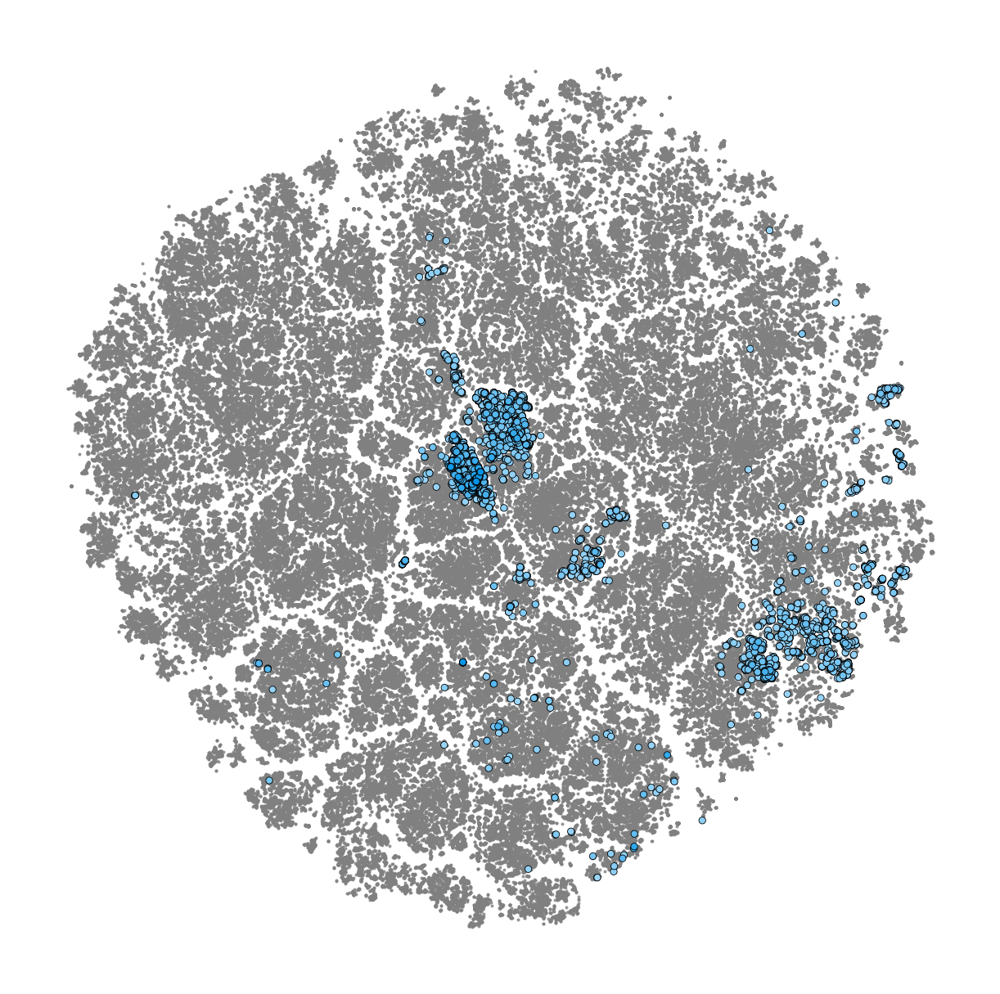

In [ ]:
## Batch 1 => not using this style
# import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap1, norm1 = create_cmap(df_b1_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b1_exp_)
cmap1, norm1 = create_cmap(df_b_all['new_ratio'], blue)  ## blue colormap (with respect to df_b1_exp_)
# scatter = ax.scatter(df_b1_exp_['tsne_0'], df_b1_exp_['tsne_1'], c=df_b1_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b1_exp_['tsne_0'], df_b1_exp_['tsne_1'], c=df_b1_exp_['new_ratio'], s=4, cmap=cmap1, norm=norm1, label='eMolecules', edgecolors='black', linewidth=0.2)
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b1_102224.jpg', dpi=300)

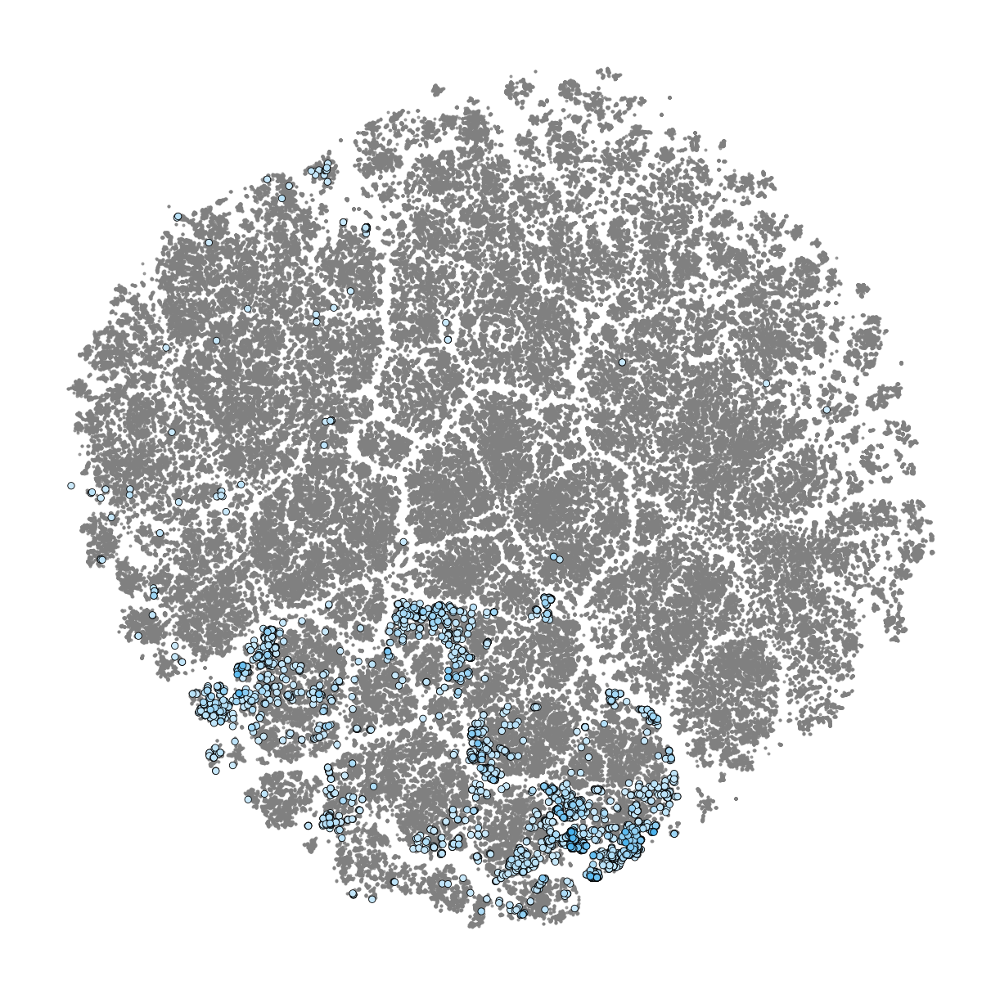

In [ ]:
## Batch 2 -> not using
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b2_rat = df_b_all[df_b_all['batch'] == '2']
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap2, norm2 = create_cmap(df_b2_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b2_exp_)
cmap2, norm2 = create_cmap(df_b_all['new_ratio_std'], blue)  ## anvil colormap (with respect to df_b2_exp_)
# scatter = ax.scatter(df_b2_exp_['tsne_0'], df_b2_exp_['tsne_1'], c=df_b2_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b2_rat['tsne_0'], df_b2_rat['tsne_1'], c=df_b2_rat['new_ratio_std'], s=4, cmap=cmap2, norm=norm2, label='Batch 2', edgecolors='black', linewidth=0.2)
# plt.colorbar(scatter)
# Add colorbar and turn off tick labels
# cbar = plt.colorbar(scatter)
# cbar.set_ticks([])
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('colorbar.jpg', dpi=300)
# plt.savefig('explore_exploit_tsne_sugg_b2_101124.jpg', dpi=300)

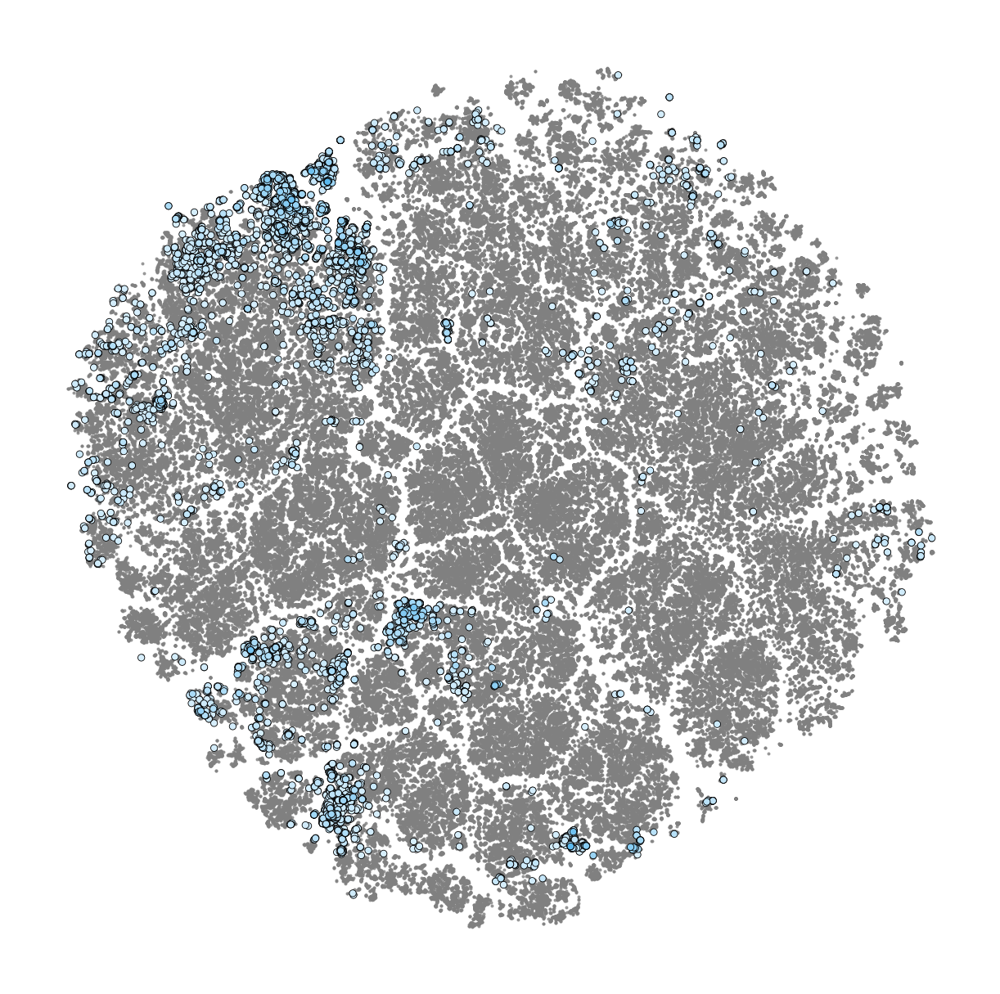

In [ ]:
## Batch 3 -> not using
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b3_rat = df_b_all[df_b_all['batch'] == '3']
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap3, norm3 = create_cmap(df_b3_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b3_exp_)
cmap3, norm3 = create_cmap(df_b_all['new_ratio_std'], blue)  ## anvil colormap (with respect to df_b3_exp_)
# scatter = ax.scatter(df_b3_exp_['tsne_0'], df_b3_exp_['tsne_1'], c=df_b3_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b3_rat['tsne_0'], df_b3_rat['tsne_1'], c=df_b3_rat['new_ratio_std'], s=4, cmap=cmap3, norm=norm3, label='eMolecules', edgecolors='black', linewidth=0.2)
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)

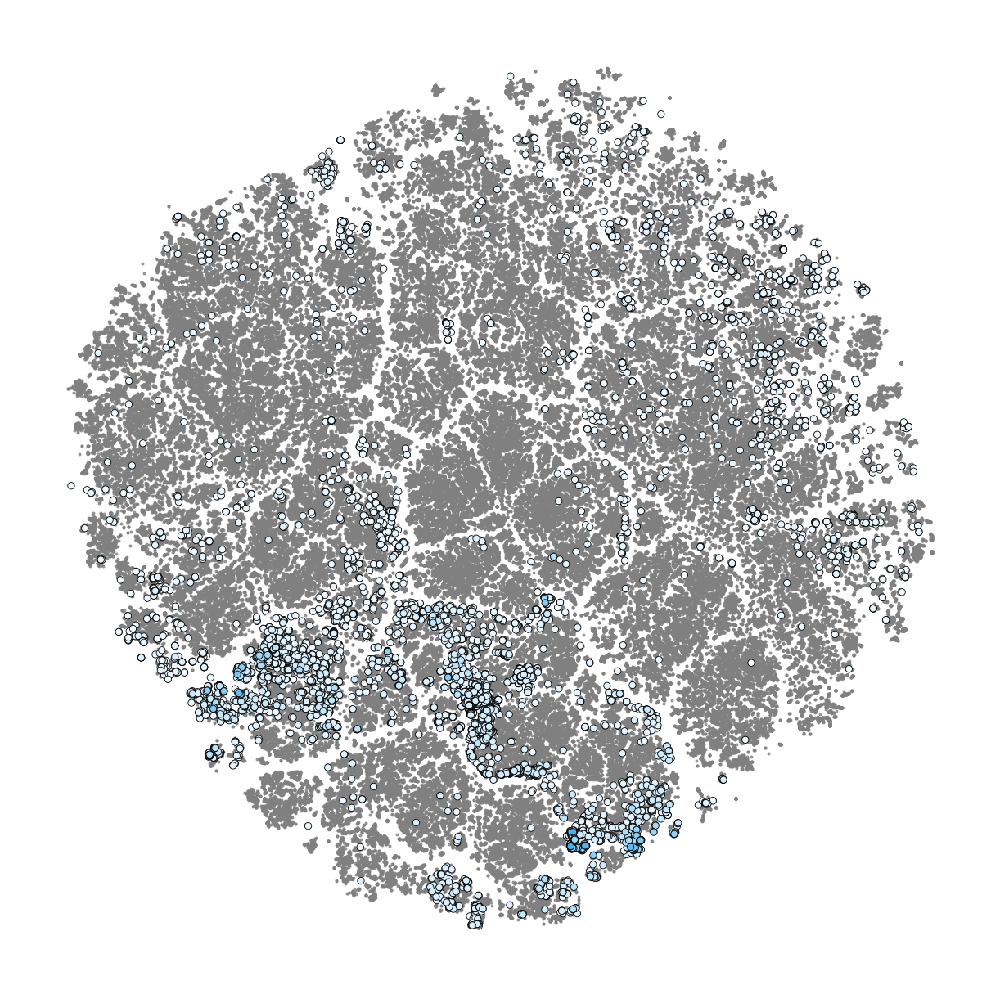

In [ ]:
## Batch 4 -> not using
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b4_rat = df_b_all[df_b_all['batch'] == '4']
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap4, norm4 = create_cmap(df_b4_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b4_exp_)
cmap4, norm4 = create_cmap(df_b_all['new_ratio_std'], blue)  ## anvil colormap (with respect to df_b4_exp_)
# scatter = ax.scatter(df_b4_exp_['tsne_0'], df_b4_exp_['tsne_1'], c=df_b4_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b4_rat['tsne_0'], df_b4_rat['tsne_1'], c=df_b4_rat['new_ratio_std'], s=4, cmap=cmap4, norm=norm4, label='eMolecules', edgecolors='black', linewidth=0.2)
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)

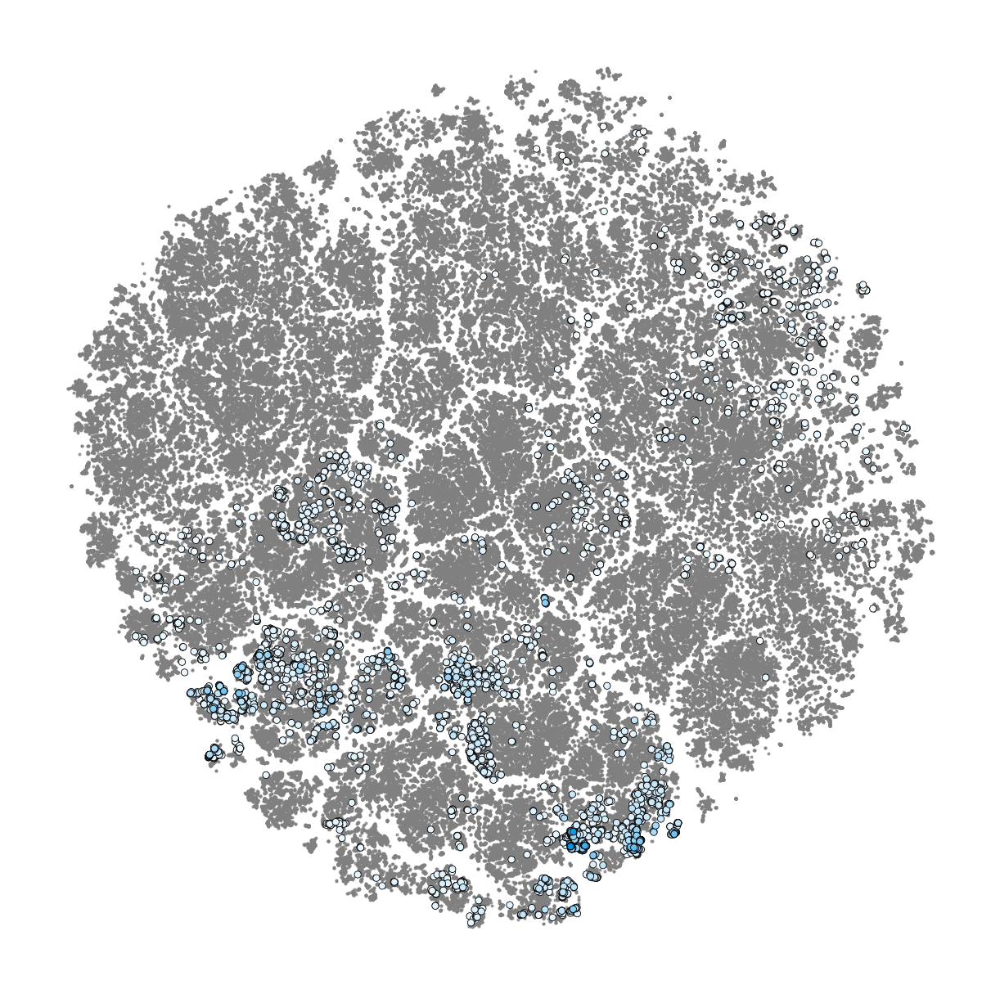

In [ ]:
## Batch 5 -> not using
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b5_rat = df_b_all[df_b_all['batch'] == '5']
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap5, norm5 = create_cmap(df_b5_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b5_exp_)
cmap5, norm5 = create_cmap(df_b_all['new_ratio_std'], blue)  ## anvil colormap (with respect to df_b5_exp_)
# scatter = ax.scatter(df_b5_exp_['tsne_0'], df_b5_exp_['tsne_1'], c=df_b5_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b5_rat['tsne_0'], df_b5_rat['tsne_1'], c=df_b5_rat['new_ratio_std'], s=4, cmap=cmap5, norm=norm5, label='eMolecules', edgecolors='black', linewidth=0.2)
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b5_101124.jpg', dpi=300)

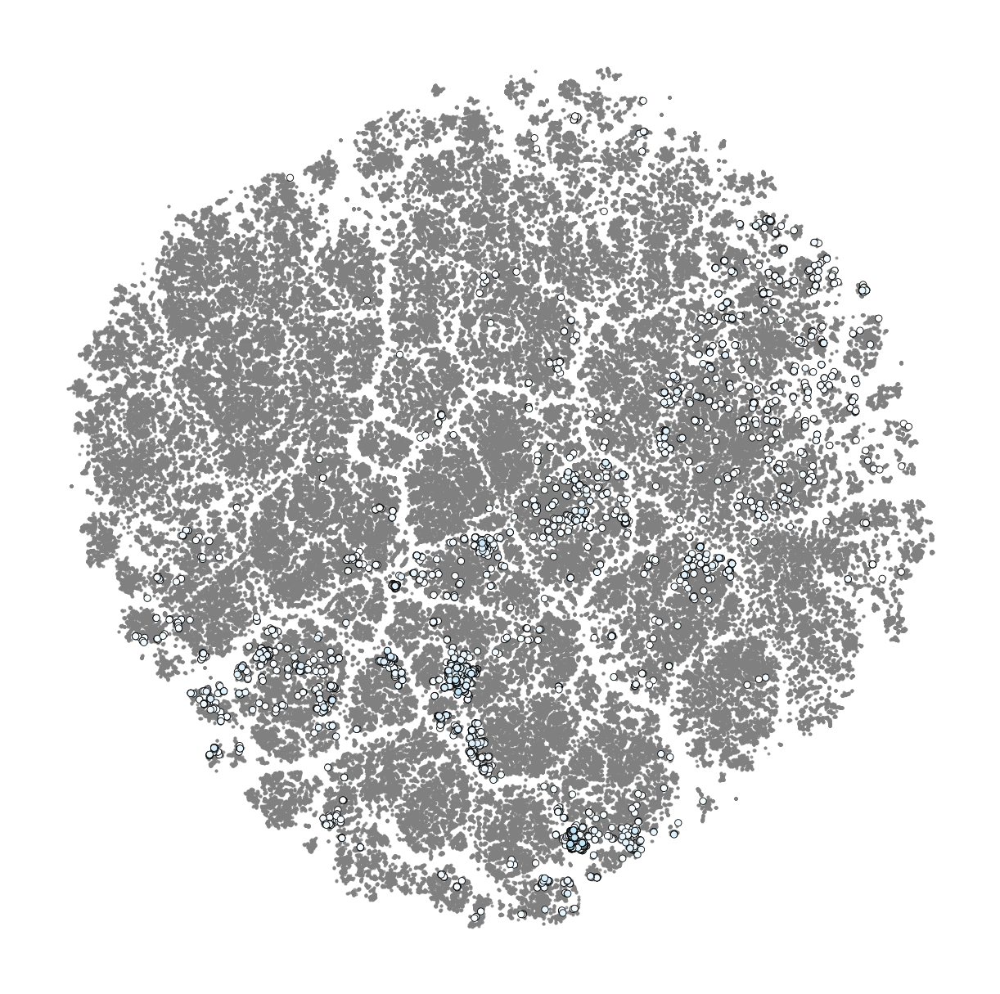

In [ ]:
## Batch 6 -> not using
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b6_rat = df_b_all[df_b_all['batch'] == '6']
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap6, norm6 = create_cmap(df_b6_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b6_exp_)
cmap6, norm6 = create_cmap(df_b_all['new_ratio_std'], blue)  ## anvil colormap (with respect to df_b6_exp_)
# scatter = ax.scatter(df_b6_exp_['tsne_0'], df_b6_exp_['tsne_1'], c=df_b6_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b6_rat['tsne_0'], df_b6_rat['tsne_1'], c=df_b6_rat['new_ratio_std'], s=4, cmap=cmap6, norm=norm6, label='eMolecules', edgecolors='black', linewidth=0.2)
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b6_101124.jpg', dpi=300)

##### Batch: 1 

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/128823566.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_b1_rat.sort_values(by='new_ratio', ascending=True, inplace=True)


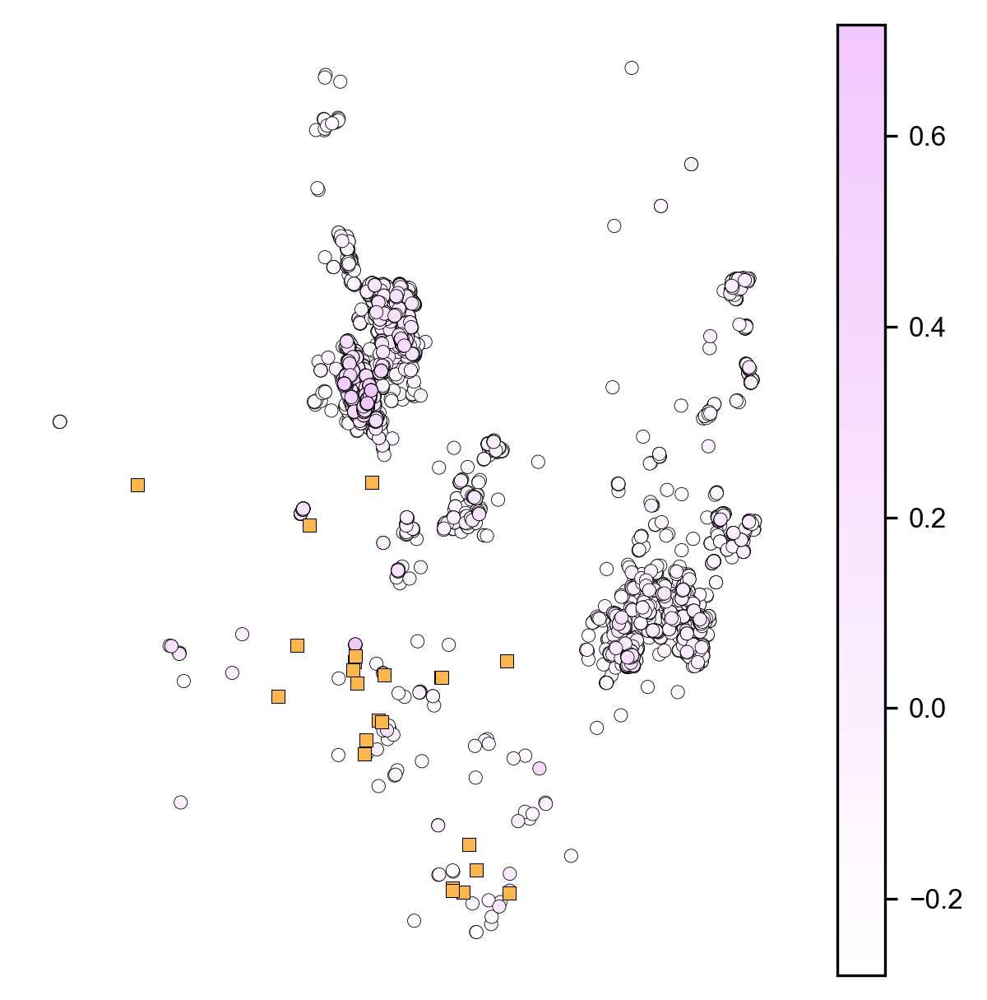

In [91]:
## Batch 1
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b1_rat = df_b_all[df_b_all['batch'] == '1']
df_b1_rat.sort_values(by='new_ratio', ascending=True, inplace=True)
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap2, norm2 = create_cmap(df_b2_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b2_exp_)
cmap2, norm2 = create_cmap(df_b1_rat['new_ratio'], pink)  ## anvil colormap (with respect to df_b2_exp_)
# scatter = ax.scatter(df_b2_exp_['tsne_0'], df_b2_exp_['tsne_1'], c=df_b2_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b1_rat['tsne_0'], df_b1_rat['tsne_1'], c=df_b1_rat['new_ratio'], s=15, cmap=cmap2, norm=norm2, label='Batch 2', edgecolors='black', linewidth=0.2)
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Train', alpha=1, color=orange, edgecolor='black', linewidth=0.25, s=15, marker='s')
# plt.colorbar(scatter)
# Add colorbar and turn off tick labels
# cbar = plt.colorbar(scatter)
# cbar.set_ticks([])
plt.xticks([])
plt.yticks([])
plt.colorbar(scatter)
for spine in ax.spines.values():
    spine.set_visible(False)
plt.savefig('explore_exploit_tsne_sugg_b1_112624_colorbar.eps', dpi=300)
# plt.savefig('explore_exploit_tsne_sugg_b1_112624.tiff', dpi=300, transparent=True)

##### Batch: 2

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/1110059296.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_b2_rat.sort_values(by='new_ratio', ascending=True, inplace=True)


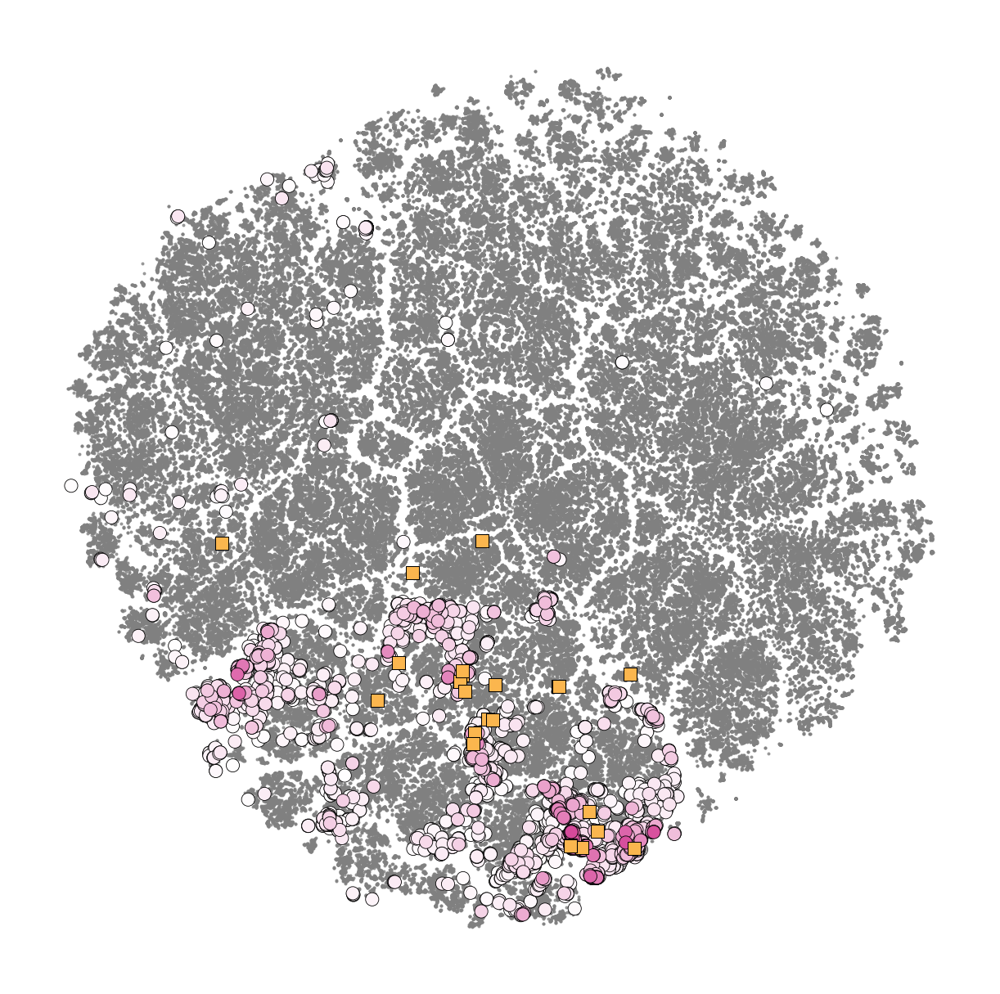

In [95]:
## Batch 2
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b2_rat = df_b_all[df_b_all['batch'] == '2']
df_b2_rat.sort_values(by='new_ratio', ascending=True, inplace=True)
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap2, norm2 = create_cmap(df_b2_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b2_exp_)
cmap2, norm2 = create_cmap(df_b2_rat['new_ratio'], purple)  ## anvil colormap (with respect to df_b2_exp_)
# scatter = ax.scatter(df_b2_exp_['tsne_0'], df_b2_exp_['tsne_1'], c=df_b2_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b2_rat['tsne_0'], df_b2_rat['tsne_1'], c=df_b2_rat['new_ratio'], s=15, cmap=cmap2, norm=norm2, label='Batch 2', edgecolors='black', linewidth=0.2)
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Train', alpha=1, color=orange, edgecolor='black', linewidth=0.25, s=15, marker='s')
# plt.colorbar(scatter)
# Add colorbar and turn off tick labels
# cbar = plt.colorbar(scatter)
# cbar.set_ticks([])
plt.xticks([])
plt.yticks([])
# plt.colorbar(scatter)
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b2_110424.tiff', dpi=300)
# plt.savefig('explore_exploit_tsne_sugg_b2_110424_colorbar.eps', dpi=300)
# plt.savefig('explore_exploit_tsne_sugg_b2_112624_colorbar.eps', dpi=300)
plt.savefig('explore_exploit_tsne_sugg_b2_112624.tiff', dpi=300, transparent=True)

##### Batch: 3

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/4060299946.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_b3_rat.sort_values(by='new_ratio', ascending=True, inplace=True)


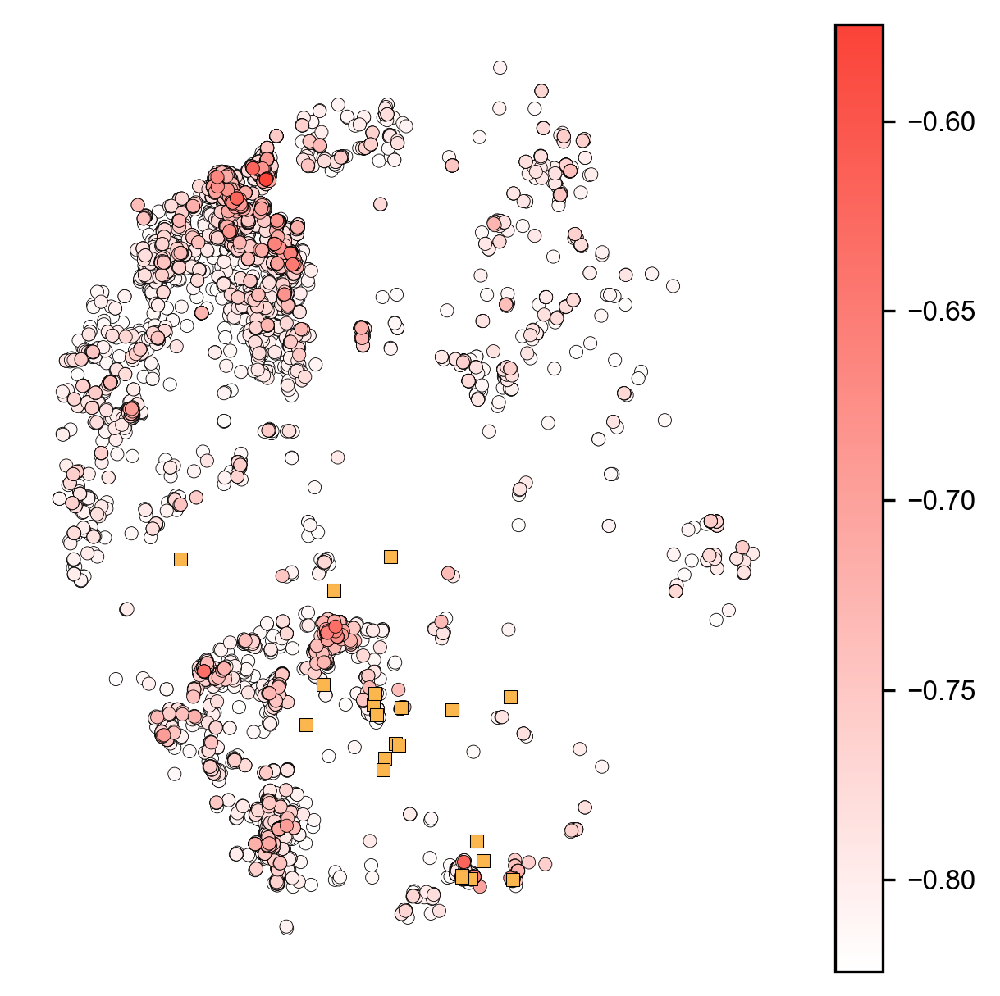

In [98]:
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b3_rat = df_b_all[df_b_all['batch'] == '3']
df_b3_rat.sort_values(by='new_ratio', ascending=True, inplace=True)
# ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap3, norm3 = create_cmap(df_b3_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b3_exp_)
cmap3, norm3 = create_cmap(df_b3_rat['new_ratio'], red)  ## anvil colormap (with respect to df_b3_exp_)
# scatter = ax.scatter(df_b3_exp_['tsne_0'], df_b3_exp_['tsne_1'], c=df_b3_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b3_rat['tsne_0'], df_b3_rat['tsne_1'], c=df_b3_rat['new_ratio'], s=15, cmap=cmap3, norm=norm3, label='Batch 3', edgecolors='black', linewidth=0.2)
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Train', alpha=1, color=orange, edgecolor='black', linewidth=0.25, s=15, marker='s')
plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b3_110424.tiff', dpi=300)
# plt.savefig('explore_exploit_tsne_sugg_b3_110424_colorbar.eps', dpi=300)
plt.savefig('explore_exploit_tsne_sugg_b3_112624_colorbar.eps', dpi=300)
# plt.savefig('explore_exploit_tsne_sugg_b3_112624.tiff', dpi=300, transparent=True)

##### Batch: 4

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/3359937072.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_b4_rat.sort_values(by='new_ratio', ascending=True, inplace=True)


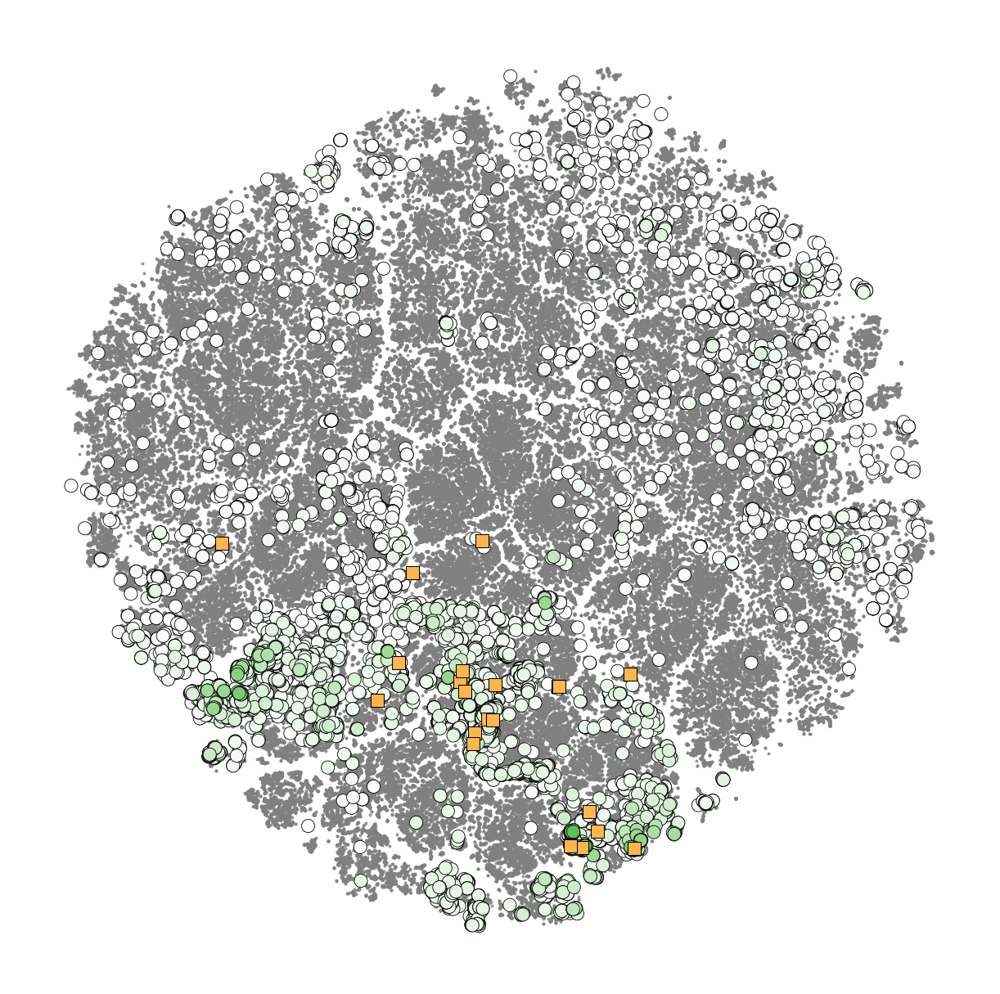

In [108]:
## Batch 4
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b4_rat = df_b_all[df_b_all['batch'] == '4']
df_b4_rat.sort_values(by='new_ratio', ascending=True, inplace=True)
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap4, norm4 = create_cmap(df_b4_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b4_exp_)
cmap4, norm4 = create_cmap(df_b4_rat['new_ratio'], green)  ## anvil colormap (with respect to df_b4_exp_)
# scatter = ax.scatter(df_b4_exp_['tsne_0'], df_b4_exp_['tsne_1'], c=df_b4_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b4_rat['tsne_0'], df_b4_rat['tsne_1'], c=df_b4_rat['new_ratio'], s=15, cmap=cmap4, norm=norm4, label='eMolecules', edgecolors='black', linewidth=0.2)
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Train', alpha=1, color=orange, edgecolor='black', linewidth=0.25, s=15, marker='s')
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b4_112624_colorbar.eps', dpi=300)
plt.savefig('explore_exploit_tsne_sugg_b4_112624.tiff', dpi=300, transparent=True)

##### Batch: 5

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/2521663314.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_b5_rat.sort_values(by='new_ratio', ascending=True, inplace=True)


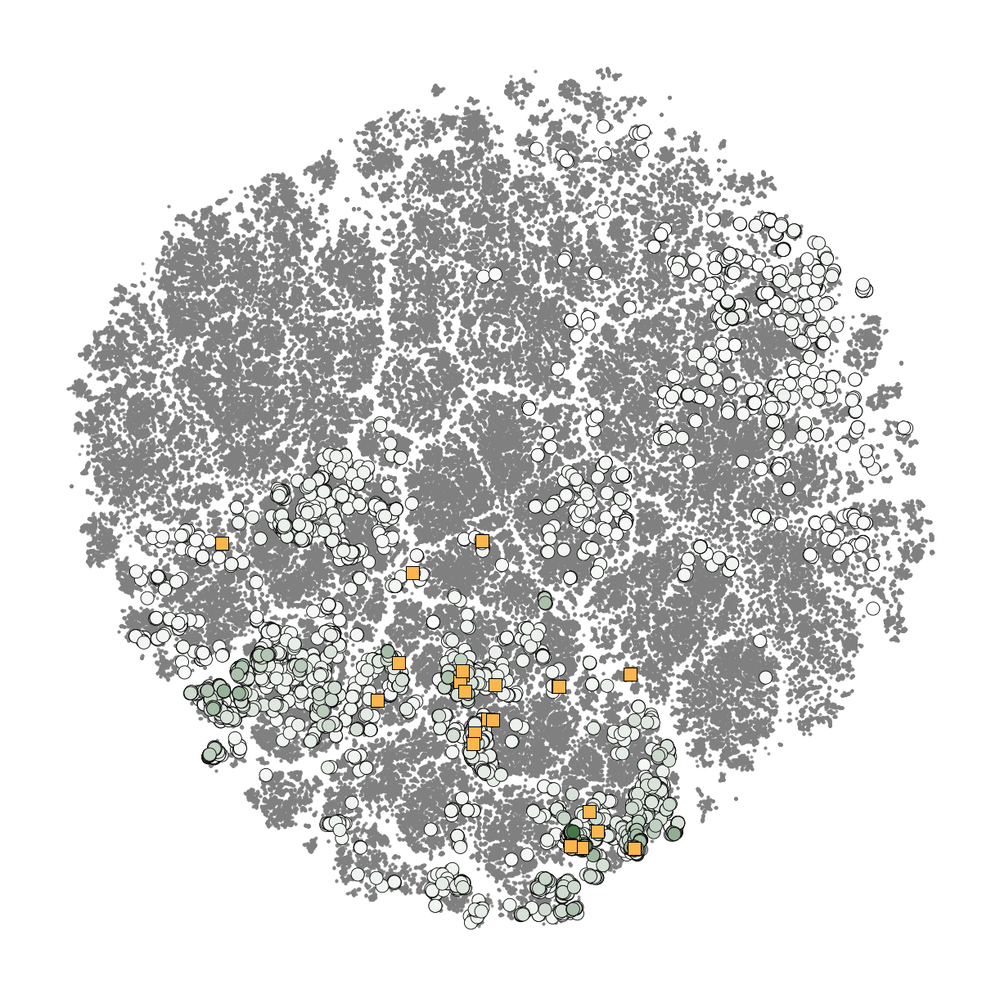

In [109]:
## Batch 5
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b5_rat = df_b_all[df_b_all['batch'] == '5']
df_b5_rat.sort_values(by='new_ratio', ascending=True, inplace=True)
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap5, norm5 = create_cmap(df_b5_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b5_exp_)
cmap5, norm5 = create_cmap(df_b5_rat['new_ratio'], c1)  ## anvil colormap (with respect to df_b5_exp_)
# scatter = ax.scatter(df_b5_exp_['tsne_0'], df_b5_exp_['tsne_1'], c=df_b5_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b5_rat['tsne_0'], df_b5_rat['tsne_1'], c=df_b5_rat['new_ratio'], s=15, cmap=cmap5, norm=norm5, label='Batch 5', edgecolors='black', linewidth=0.2)
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Train', alpha=1, color=orange, edgecolor='black', linewidth=0.25, s=15, marker='s')
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b5_112624_colorbar.eps', dpi=300)
plt.savefig('explore_exploit_tsne_sugg_b5_112624.tiff', dpi=300, transparent=True)

##### Batch: 6

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/2353329862.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_b6_rat.sort_values(by='new_ratio', ascending=True, inplace=True)


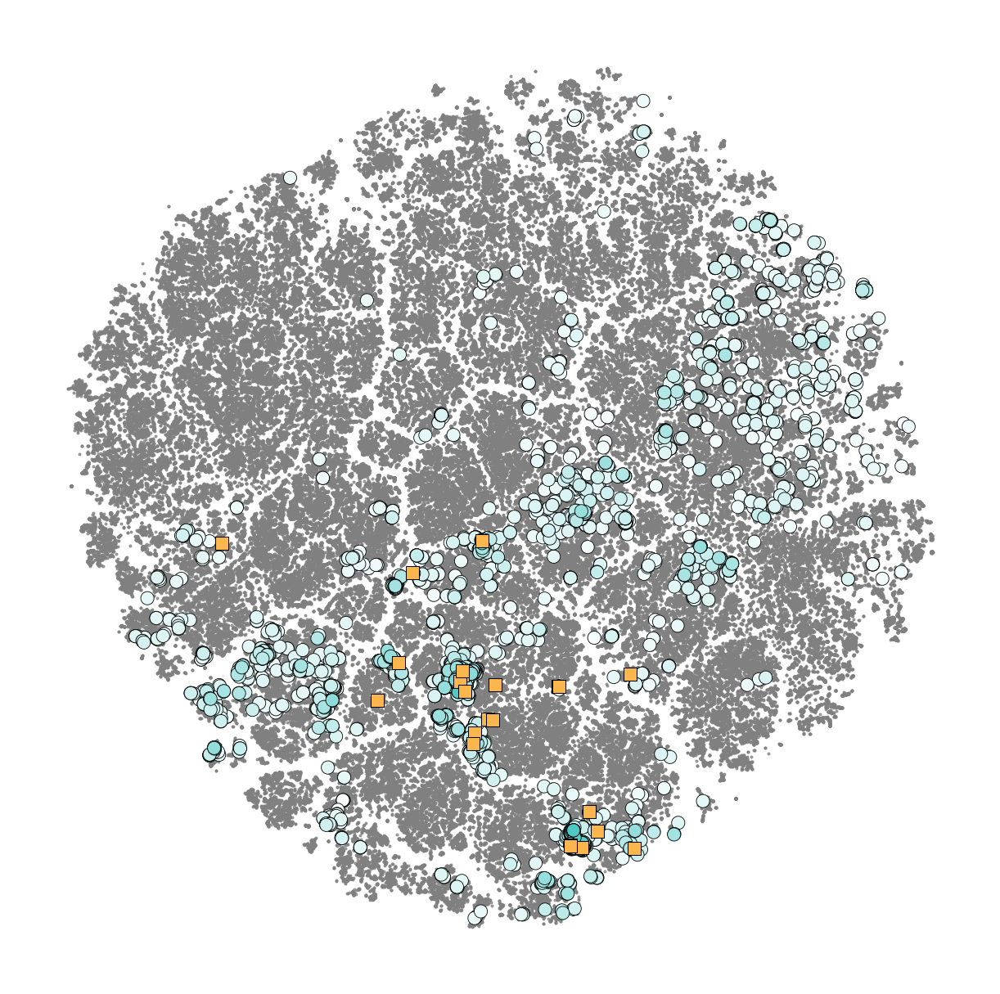

In [110]:
## Batch 6
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b6_rat = df_b_all[df_b_all['batch'] == '6']
df_b6_rat.sort_values(by='new_ratio', ascending=True, inplace=True)
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap6, norm6 = create_cmap(df_b6_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b6_exp_)
cmap6, norm6 = create_cmap(df_b6_rat['new_ratio'], anvil)  ## anvil colormap (with respect to df_b6_exp_)
# scatter = ax.scatter(df_b6_exp_['tsne_0'], df_b6_exp_['tsne_1'], c=df_b6_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b6_rat['tsne_0'], df_b6_rat['tsne_1'], c=df_b6_rat['new_ratio'], s=15, cmap=cmap6, norm=norm6, label='eMolecules', edgecolors='black', linewidth=0.2)
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Train', alpha=1, color=orange, edgecolor='black', linewidth=0.25, s=15, marker='s')
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b6_112624_colorbar.eps', dpi=300)
plt.savefig('explore_exploit_tsne_sugg_b6_112624.tiff', dpi=300, transparent=True)

##### Batch: 7

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/1988259958.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_b7_rat.sort_values(by='new_ratio', ascending=True, inplace=True)


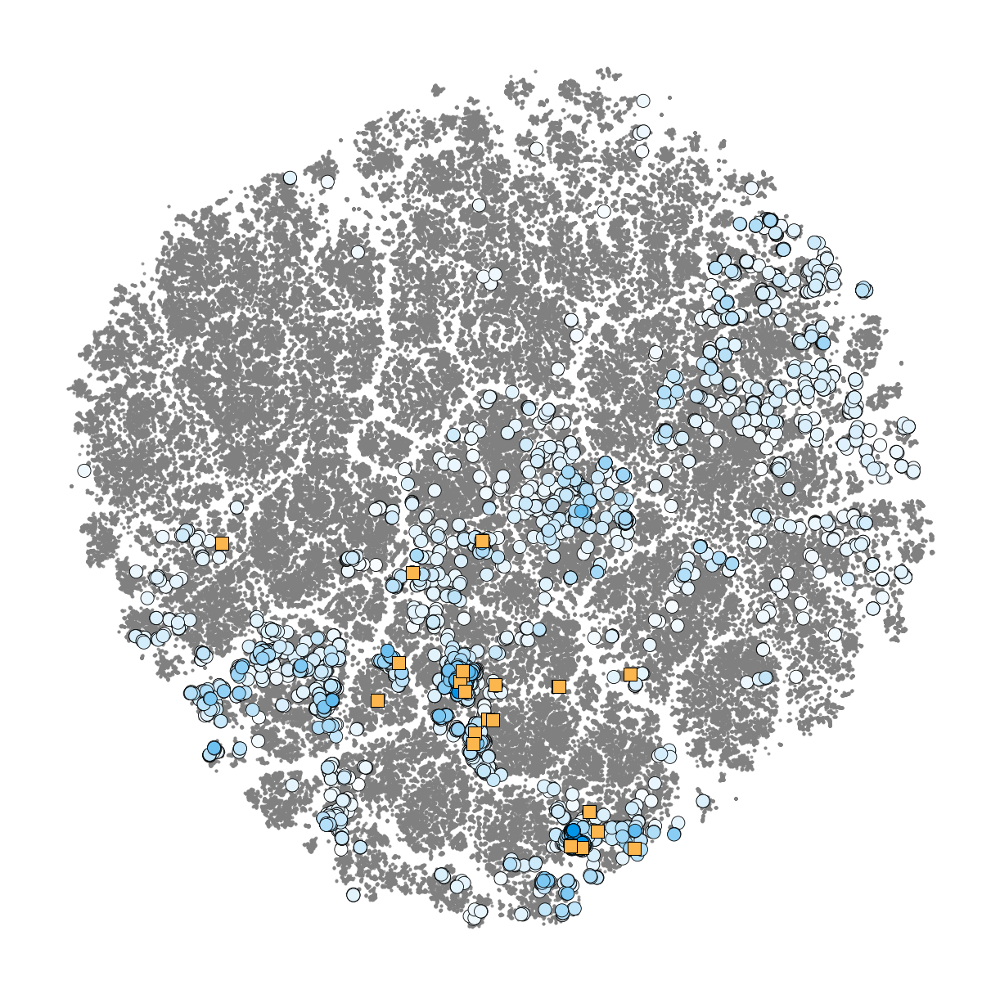

In [111]:
## Batch 7
fig, ax = plt.subplots(figsize=(5, 5))
# ax = plt.gca()
df_b7_rat = df_b_all[df_b_all['batch'] == '7']
df_b7_rat.sort_values(by='new_ratio', ascending=True, inplace=True)
ax.scatter(df_tsne['tsne_0'], df_tsne['tsne_1'], label='All', alpha=0.75, color='gray', edgecolor=None, linewidth=0.25, s=0.5, marker='o')
# cmap7, norm7 = create_cmap(df_b7_exp_['ratio'], (0.298, 0.78, 0.77))  ## anvil colormap (with respect to df_b7_exp_)
cmap7, norm7 = create_cmap(df_b7_rat['new_ratio'], blue)  ## anvil colormap (with respect to df_b7_exp_)
# scatter = ax.scatter(df_b7_exp_['tsne_0'], df_b7_exp_['tsne_1'], c=df_b7_exp_['ratio'], cmap='viridis', s=1)
scatter = ax.scatter(df_b7_rat['tsne_0'], df_b7_rat['tsne_1'], c=df_b7_rat['new_ratio'], s=15, cmap=cmap7, norm=norm7, label='Batch 7', edgecolors='black', linewidth=0.2)
ax.scatter(df_train['tsne_0'], df_train['tsne_1'], label='Train', alpha=1, color=orange, edgecolor='black', linewidth=0.25, s=15, marker='s')
# plt.colorbar(scatter)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('explore_exploit_tsne_sugg_b7_112624_colorbar.eps', dpi=300)
plt.savefig('explore_exploit_tsne_sugg_b7_112624.tiff', dpi=300, transparent=True)

Text(0, 0.5, 'Normalized exploitation ratio')

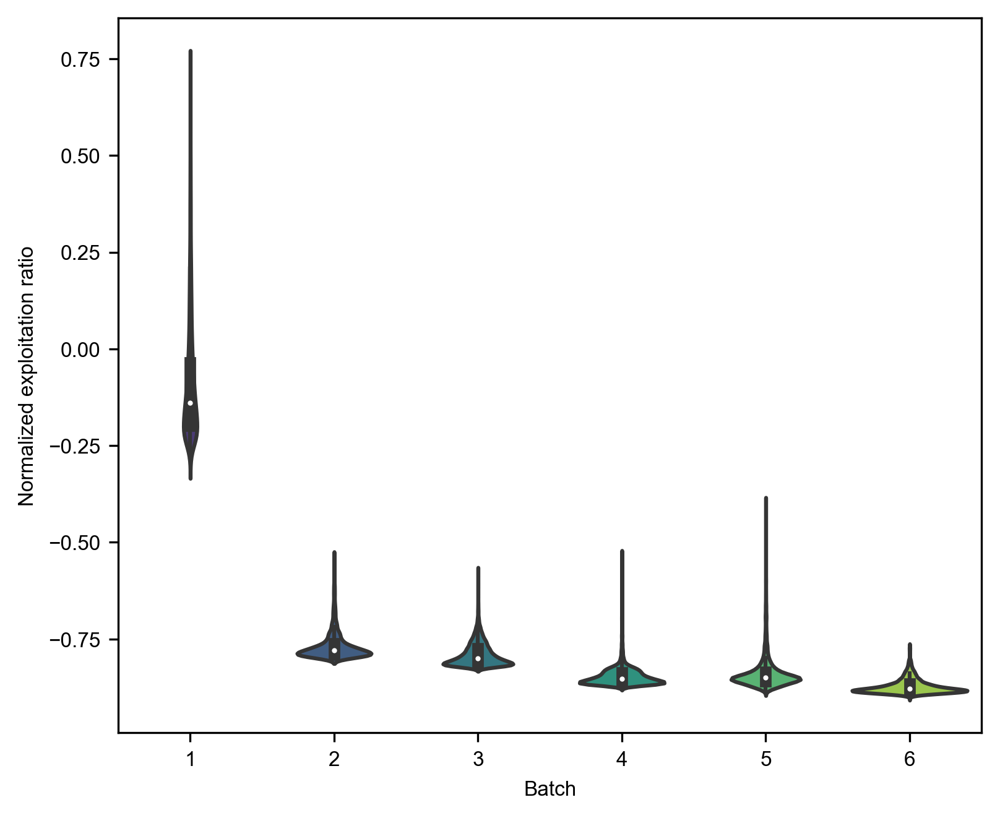

In [70]:
## violin plot for exploitation ratio
plt.figure(figsize=(6, 5))
sns.violinplot(x='batch', y='new_ratio', data=df_b_all, palette='viridis')
plt.xlabel('Batch')
plt.ylabel('Normalized exploitation ratio')

In [21]:
# df_b3_exp_.reset_index(drop=True, inplace=True)
df_b3_exp__

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,batch,prediction_aggr,uncertainty_aggr,ratio_aggr,exploit_aggr,explore_aggr,EI_aggr,new_ratio
0,CC(C)OCCCOCCN(C)C,-1.0,"['Ether', 'Amine']",8,-34.191615,-78.058136,3,1.204307e-06,0.000800,-4.688342,-5.757378e-08,6.985398e-08,1.228020e-08,-0.824202
1,CN(C)CCOCCC[Si],-1.0,"['Ether', 'Amine']",8,-38.172114,-74.892656,3,1.268256e-06,0.000820,-4.674639,-5.768137e-08,7.002059e-08,1.233921e-08,-0.823777
2,CCCOCCCN(C)C(C)(C)C,-1.0,"['Ether', 'Amine']",8,-42.581510,-81.268902,3,1.284039e-06,0.000824,-4.674013,-5.741563e-08,6.969964e-08,1.228401e-08,-0.823758
3,CCOCCCN(C)N(C)C,-1.0,"['Ether', 'Amine']",8,-39.607921,-76.496098,3,1.353217e-06,0.000844,-4.673348,-5.755721e-08,6.987326e-08,1.231605e-08,-0.823737
4,CCN(CC)C(=O)N(C)CCCCOC(C)C,-1.0,"['Ether', 'Amide']",4,-58.920922,68.028159,3,9.647973e-07,0.000738,-4.670905,-5.722958e-08,6.948193e-08,1.225235e-08,-0.823661
5,CN(C)CCCOCC(F)F,-1.0,"['Ether', 'Amine']",8,-37.352104,-76.510713,3,1.310582e-06,0.000831,-4.669032,-5.786118e-08,7.025372e-08,1.239254e-08,-0.823603
6,CCN(C)CCCCOC(C)(C)C,-1.0,"['Ether', 'Amine']",8,-41.799939,-74.238915,3,1.240344e-06,0.000813,-4.668294,-5.726619e-08,6.953324e-08,1.226705e-08,-0.823580
7,CCOCCCN(C)CC(F)F,-1.0,"['Ether', 'Amine']",8,-41.955332,-78.004129,3,1.252986e-06,0.000814,-4.667201,-5.802658e-08,7.045942e-08,1.243284e-08,-0.823546
8,CCN(C)CCCCOSC,-1.0,['Amine'],2,-35.861072,-77.473659,3,1.296853e-06,0.000830,-4.662925,-5.738412e-08,6.969059e-08,1.230647e-08,-0.823413
9,CCOCCCCN(C)C(C)C,-1.0,"['Ether', 'Amine']",8,-35.759062,-80.248669,3,1.217483e-06,0.000803,-4.662764,-5.806736e-08,7.052078e-08,1.245342e-08,-0.823408


/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_46911/4107450063.py:6: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df_train, x='tsne_0', y='tsne_1', color='red', label='Batch 3', hue='class', fill=True)
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_46911/4107450063.py:6: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df_train, x='tsne_0', y='tsne_1', color='red', label='Batch 3', hue='class', fill=True)
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_46911/4107450063.py:6: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df_train, x='tsne_0', y='tsne_1', color='red', label='Batch 3', hue='class', fill=True)
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_46911/41074500

<AxesSubplot: xlabel='tsne_0', ylabel='tsne_1'>

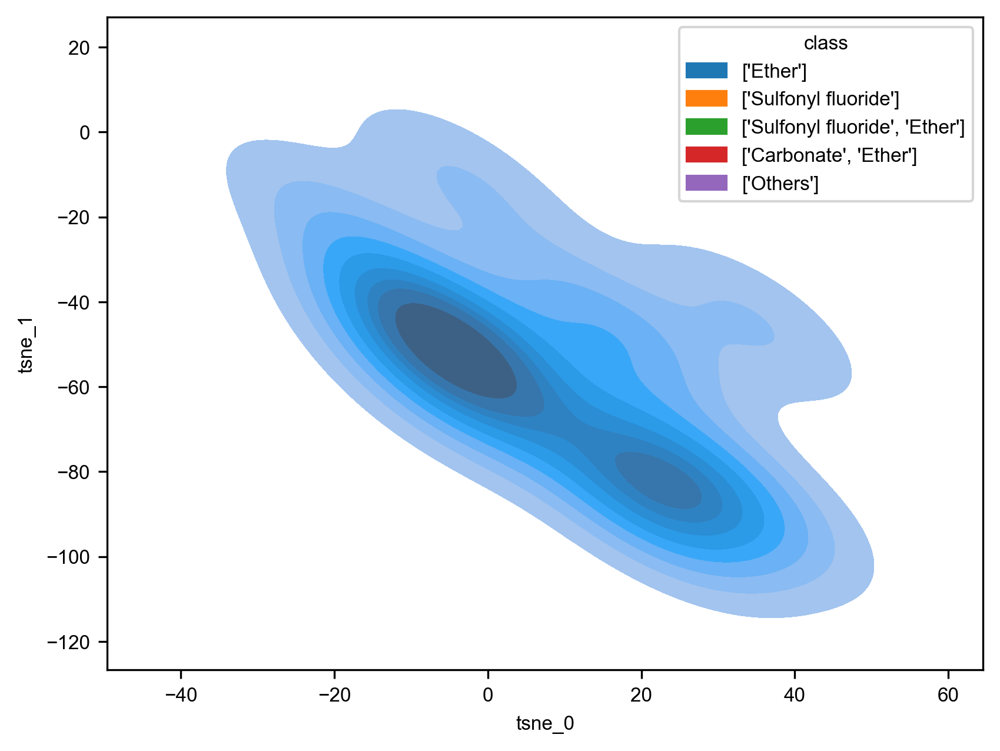

In [18]:
import seaborn as sns
# sns.kdeplot(df_b3_exp_['new_ratio'], color='red', label='Batch 3')
# df_b3_exp_.reset_index(drop=True, inplace=True)
# df_b3_exp__ = df_b3_exp_.iloc[:100,:]
# sns.kdeplot(df_b3_exp__, x='tsne_0', y='tsne_1', color='red', label='Batch 3', hue='new_ratio')
sns.kdeplot(df_train, x='tsne_0', y='tsne_1', color='red', label='Batch 3', hue='class', fill=True)

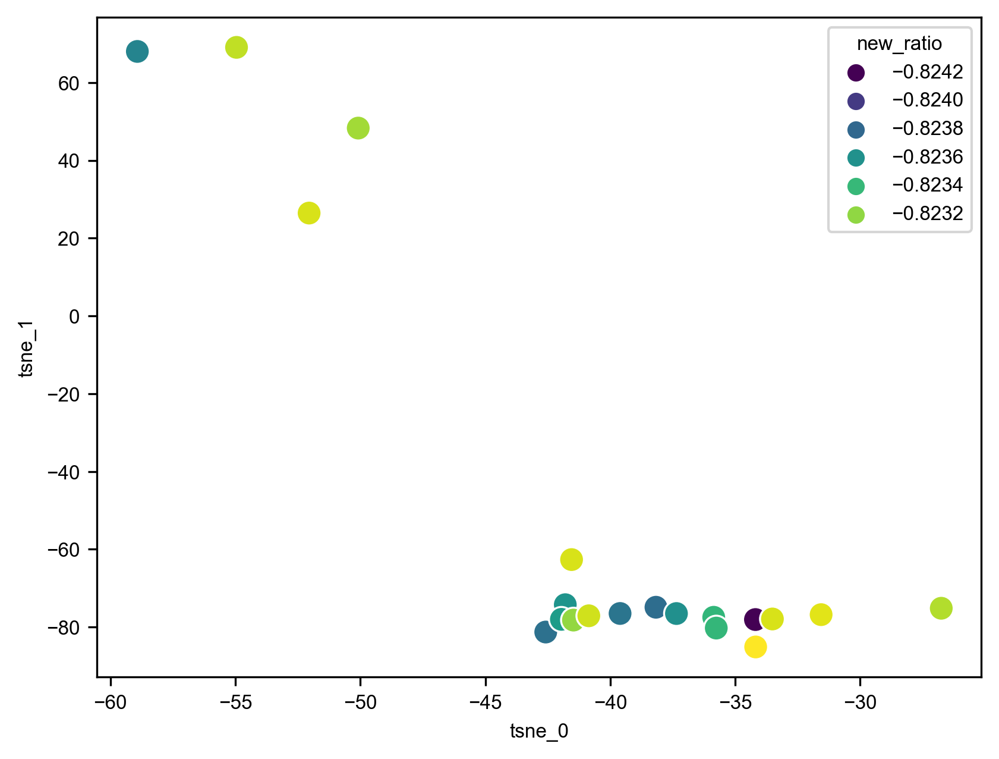

In [23]:
if not df_b3_exp__.empty:
	sns.scatterplot(data=df_b3_exp__, x='tsne_0', y='tsne_1', hue='new_ratio', palette='viridis', edgecolor='w', s=100)
else:
	print("df_b3_exp__ is empty")

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_46911/3595819141.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_b3_exp__['new_ratio_int'] = df_b3_exp__['new_ratio'].apply(lambda x: int(x))


<AxesSubplot: xlabel='tsne_0', ylabel='tsne_1'>

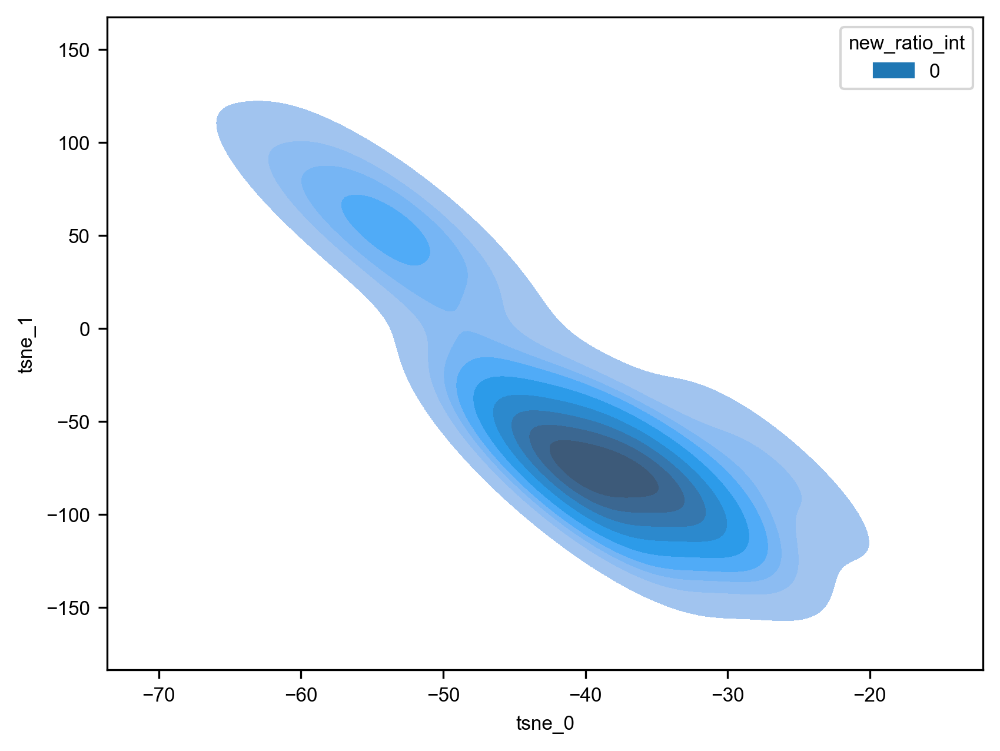

In [25]:
df_b3_exp__['new_ratio_int'] = df_b3_exp__['new_ratio'].apply(lambda x: int(x))
sns.kdeplot(data=df_b3_exp__, x='tsne_0', y='tsne_1', hue='new_ratio_int', fill=True)

### Violin plot for EI aggregate distribution

In [41]:
df_b1_exp['batch'] = 1
df_b2_exp['batch'] = 2
df_b3_exp['batch'] = 3
df_b4_exp['batch'] = 4
df_b5_exp['batch'] = 5
df_b6_exp['batch'] = 6
df_EI_all = pd.concat([df_b1_exp, df_b2_exp, df_b3_exp, df_b4_exp_, df_b5_exp, df_b6_exp], ignore_index=True)
df_EI_all_ = df_EI_all[['std_smiles', 'batch', 'EI_aggr', 'ratio_aggr']]
df_EI_all_

,std_smiles,batch,EI_aggr,ratio_aggr
0,COC1(C(F)F)CCCCC1,1,1.448163e-06,0.417278
1,COC1(C(F)(F)F)CCCC1,1,1.431874e-06,0.410915
2,COC1(C(C)(F)F)CCCCC1,1,1.427106e-06,0.413911
3,COC1(C(F)F)CCCC1,1,1.424359e-06,0.402292
4,COC1(F)CCCCC1,1,1.414010e-06,0.398870
...,...,...,...,...
35114,COCCCCCOOCCCOOC,6,9.400247e-10,-7.865138
35115,COCCC1CCCN(C(=O)C(F)F)C1,6,1.211894e-09,-7.493699
35116,COCCC1CCCN(CC=O)C1,6,2.494372e-09,-6.389482
35117,COC1CCCCCC(=O)OC(C)C1,6,1.059125e-09,-7.201240


In [42]:
df_EI_all_['log_EI_aggr'] = np.log10(df_EI_all_['EI_aggr'])
df_EI_all_

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/3425995236.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_EI_all_['log_EI_aggr'] = np.log10(df_EI_all_['EI_aggr'])


,std_smiles,batch,EI_aggr,ratio_aggr,log_EI_aggr
0,COC1(C(F)F)CCCCC1,1,1.448163e-06,0.417278,-5.839183
1,COC1(C(F)(F)F)CCCC1,1,1.431874e-06,0.410915,-5.844095
2,COC1(C(C)(F)F)CCCCC1,1,1.427106e-06,0.413911,-5.845544
3,COC1(C(F)F)CCCC1,1,1.424359e-06,0.402292,-5.846381
4,COC1(F)CCCCC1,1,1.414010e-06,0.398870,-5.849547
...,...,...,...,...,...
35114,COCCCCCOOCCCOOC,6,9.400247e-10,-7.865138,-9.026861
35115,COCCC1CCCN(C(=O)C(F)F)C1,6,1.211894e-09,-7.493699,-8.916535
35116,COCCC1CCCN(CC=O)C1,6,2.494372e-09,-6.389482,-8.603039
35117,COC1CCCCCC(=O)OC(C)C1,6,1.059125e-09,-7.201240,-8.975053


/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-packages/seaborn/categorical.py:3544: UserWarning: 26.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-packages/seaborn/categorical.py:3544: UserWarning: 84.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-packages/seaborn/categorical.py:3544: UserWarning: 94.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-packages/seaborn/categorical.py:3544: UserWarning: 95.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warn

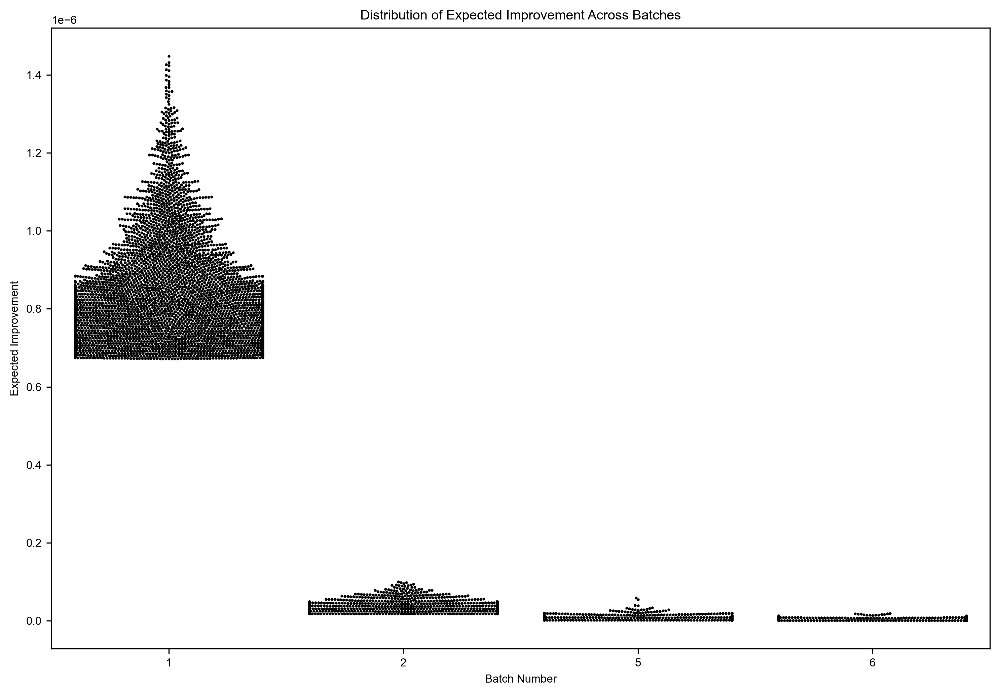

In [91]:
## swarmplot -> not using (takes very long time)
import seaborn as sns
plt.figure(figsize=(12, 8))
# sns.violinplot(x='batch', y='EI_aggr', data=df_EI_all_, palette='viridis', inner='quartile')
# sns.violinplot(x='batch', y='EI_aggr', data=df_EI_all_, palette='viridis', linewidth=1) ## in absolute values
sns.swarmplot(x='batch', y='EI_aggr', data=df_EI_all_, color='black', size=2)
# plt.yscale('log')  # Set y-axis to log scale
plt.title('Distribution of Expected Improvement Across Batches')
plt.xlabel('Batch Number')
plt.ylabel('Expected Improvement')
plt.show()


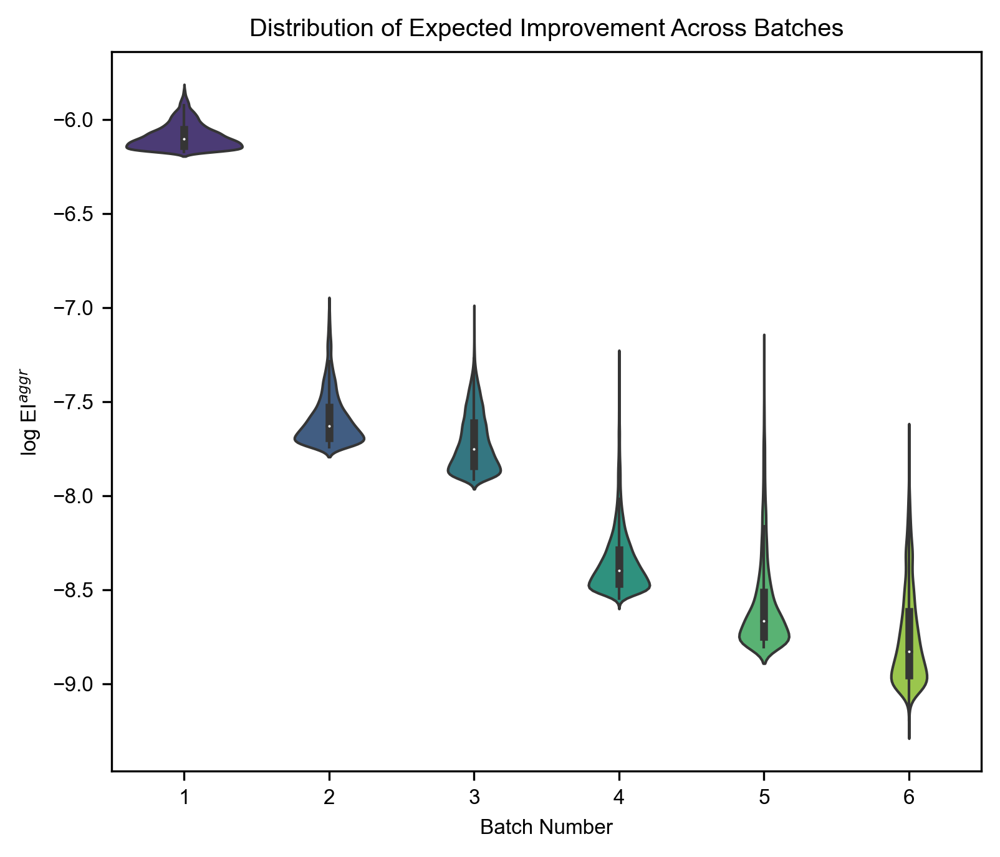

In [61]:
# import seaborn as sns
plt.figure(figsize=(6, 5))
# sns.violinplot(x='batch', y='EI_aggr', data=df_EI_all_, palette='viridis', inner='quartile')
sns.violinplot(x='batch', y='log_EI_aggr', data=df_EI_all_, palette='viridis', linewidth=1) ## in absolute values
# sns.swarmplot(x='batch', y='EI_aggr', data=df_EI_all_, color='black', size=2)
# plt.yscale('log')  # Set y-axis to log scale
plt.title('Distribution of Expected Improvement Across Batches')
plt.xlabel('Batch Number')
plt.ylabel('log EI$^{aggr}$')
# plt.show()
plt.savefig('plot_log_EI_aggr_manu.eps', dpi=300)

<AxesSubplot: xlabel='Count', ylabel='tsne_1'>

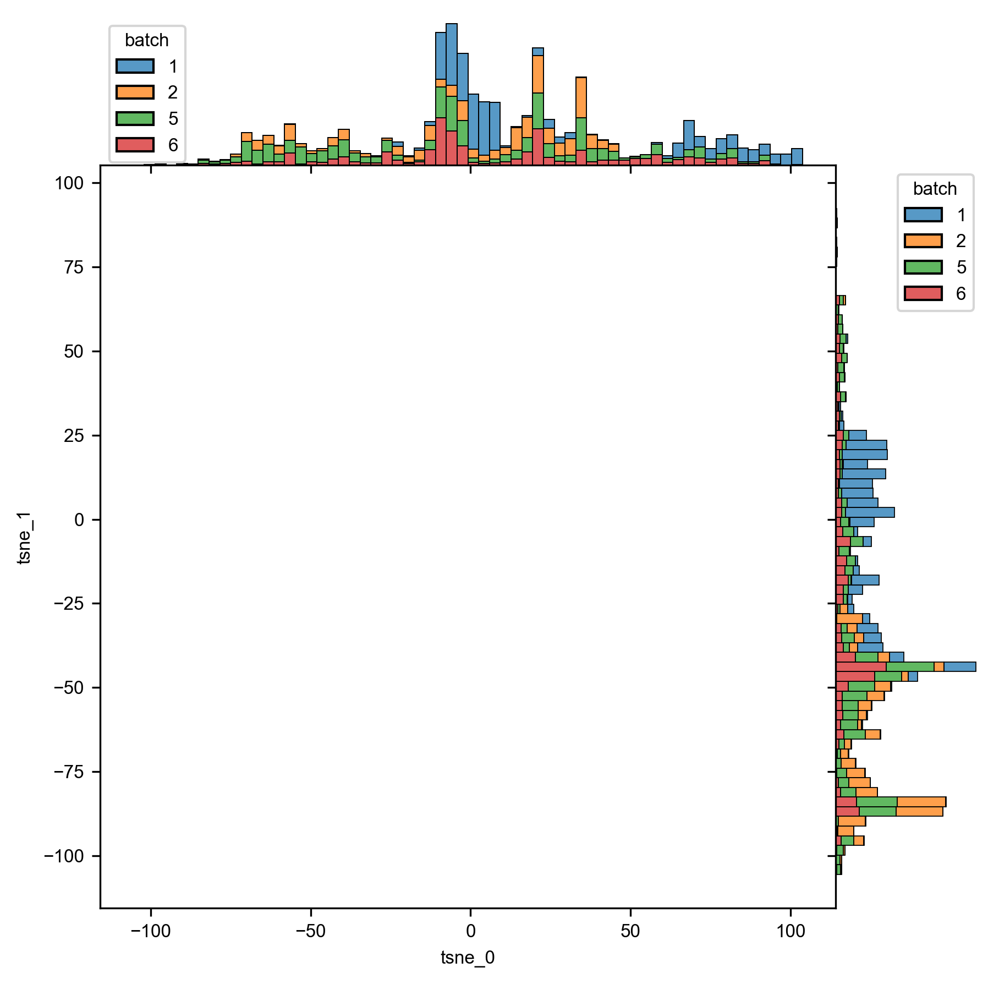

In [116]:
# Create a DataFrame for easier plotting
# data = pd.DataFrame({
#     'Dim1': X_embedded[:, 0],
#     'Dim2': X_embedded[:, 1],
#     'EI': EI_values,
#     'Batch': batch_labels
# })
# fig, ax = plt.subplots(figsize=(5, 5))
batch_labels = df_b_all['batch']
# Joint plot with EI values as hue
g = sns.JointGrid(data=df_b_all, x='tsne_0', y='tsne_1', space=0)

# # Scatter plot in the joint area
# for batch_number in np.unique(batch_labels):
#     idx = (df_b_all['batch'] == batch_number)
#     sns.scatterplot(x='tsne_0', y='tsne_1', data=df_b_all[idx],
#                     hue='EI_aggr', palette='viridis', ax=g.ax_joint,
#                     edgecolor='k', alpha=0.7, label=f'Batch {batch_number}')

# Marginal histograms for EI distributions per batch
sns.histplot(data=df_b_all, x='tsne_0', hue='batch', multiple='stack', ax=g.ax_marg_x, palette='tab10')
sns.histplot(data=df_b_all, y='tsne_1', hue='batch', multiple='stack', ax=g.ax_marg_y, palette='tab10', bins=70)

# plt.xticks([])
# plt.yticks([])
# for spine in ax.spines.values():
#     spine.set_visible(False)

# g.ax_joint.legend()
# plt.show()

### Violin plot for uncertainty aggregate distribution

In [53]:
df_b1_exp = pd.read_csv('../campaign-1/exploit_ratio_b1_5000_110224.csv')
df_b1_exp['std_smiles'] = df_b1_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b1_exp['batch'] = '1'
df_b1_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,EI_rq,EI_rbfexpsin,EI_aggr,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,std_smiles,batch
0,COC1(C(F)F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.274757,-1.203490,1.041326,-1.025159,-0.415797,-0.178878,-0.554024,0.520806,...,0.032396,0.482305,1.448163e-06,0.000005,0.002300,8.438763e-07,6.042866e-07,0.417278,COC1(C(F)F)CCCCC1,1
1,COC1(C(F)(F)F)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.285596,-1.266693,1.241411,-1.102478,0.376095,0.166441,0.024304,0.431072,...,0.030553,0.455206,1.431874e-06,0.000005,0.002295,8.434955e-07,5.883782e-07,0.410915,COC1(C(F)(F)F)CCCC1,1
2,COC1(C(C)(F)F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.307584,-1.226729,1.247259,-1.216207,0.634606,0.169550,0.293654,0.228677,...,0.029139,0.468436,1.427106e-06,0.000004,0.002259,8.364115e-07,5.906943e-07,0.413911,COC1(C(C)(F)F)CCCCC1,1
3,COC1(C(F)F)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.212383,-1.226273,1.055989,-0.997153,-0.403396,-0.225401,-0.523877,0.563653,...,0.033008,0.448318,1.424359e-06,0.000005,0.002308,8.513511e-07,5.730075e-07,0.402292,COC1(C(F)F)CCCC1,1
4,COC1(F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.431572,-1.193527,1.149880,-0.973532,-0.004855,0.304571,-0.444267,0.611225,...,0.031455,0.476645,1.414010e-06,0.000005,0.002275,8.500037e-07,5.640064e-07,0.398870,COC1(F)CCCCC1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,COC1(N(C)C)CCCN(C=O)C1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.851376,-0.103686,0.435008,-0.624247,0.082175,0.010039,-0.210949,1.345988,...,0.022038,0.240340,6.723695e-07,0.000003,0.001721,8.959106e-07,-2.235411e-07,-0.332468,COC1(N(C)C)CCCN(C=O)C1,1
4996,CC(C)S(=O)(=O)N1CCCC(=O)C1(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.919765,-0.738924,0.410033,-0.039115,0.401307,-1.606753,-0.360065,0.420094,...,0.023258,0.230383,6.723394e-07,0.000003,0.001751,8.938906e-07,-2.215512e-07,-0.329523,CC(C)S(=O)(=O)N1CCCC(=O)C1(C)C,1
4997,COC(C)(C)CN1CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.530021,-0.678923,0.777904,-0.079169,0.266731,-0.372377,1.513170,0.303756,...,0.019859,0.191656,6.723381e-07,0.000004,0.001807,8.884141e-07,-2.160760e-07,-0.321380,COC(C)(C)CN1CCCC1,1
4998,CC1(C)CC(F)(F)CCC1=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.535133,-1.218282,0.895559,-0.445502,0.728748,-0.887856,-1.237669,0.645537,...,0.024031,0.188132,6.723154e-07,0.000004,0.001818,8.932022e-07,-2.208867e-07,-0.328546,CC1(C)CC(F)(F)CCC1=O,1


In [46]:
df_b2_exp = pd.read_csv('../campaign-2/exploit_ratio_b2_5000_110224.csv')
df_b2_exp['std_smiles'] = df_b2_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b2_exp['batch'] = '2'
df_b2_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,pressure_type,solv,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,COC(C)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.776835,-1.399544,0.649007,-0.799742,-0.514680,-0.964902,0.077170,-0.043500,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c1065190>,2.115874e-06,0.001038,8.787375e-08,-6.848229e-08,-3.531568,1.939147e-08,COC(C)F,2
1,CO[Si](CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.703865,-1.378061,0.988412,-0.661167,0.540599,-0.224957,0.849146,-0.022704,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c1065200>,1.449644e-06,0.000904,1.254453e-07,-9.557871e-08,-3.200191,2.986656e-08,CO[Si](CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(...,2
2,CO[Si](CCCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.861433,-1.423950,0.911623,-0.390941,0.479303,-0.022299,0.834731,0.002459,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c1065270>,1.371849e-06,0.000882,1.247090e-07,-9.496142e-08,-3.192244,2.974754e-08,CO[Si](CCCC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C...,2
3,CO[Si](C)(CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)CC[Si]...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.539653,-1.463092,1.088129,-0.663931,0.622251,-0.101533,0.747581,0.091219,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c10652e0>,1.331733e-06,0.000863,1.167798e-07,-9.006070e-08,-3.370653,2.671907e-08,CO[Si](C)(CCC(F)(F)C(F)(F)C(F)(F)C(F)(F)CC[Si]...,2
4,CO[Si](OC)(OC)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.492592,-1.463532,1.139268,-0.682042,0.564576,-0.265117,0.719485,-0.057621,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c1065350>,1.344172e-06,0.000877,1.268925e-07,-9.647359e-08,-3.171501,3.041890e-08,CO[Si](OC)(OC)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)...,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3752,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.915870,-0.938476,0.970829,0.044332,-0.738988,0.996804,0.802128,0.293352,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c5811900>,8.716616e-07,0.000732,9.147385e-08,-7.239964e-08,-3.795683,1.907421e-08,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,2
3753,CO[Si](CCC(CC[Si](OC)(OC)OC)CC[Si](OC)(OC)OC)(...,[Li+].O=C1O[B-](F)(F)OC1=O,-0.784803,-1.203755,0.512146,-0.385240,-0.676515,-0.570004,0.204125,-0.038398,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c5811970>,7.620538e-07,0.000704,9.309433e-08,-7.370886e-08,-3.802274,1.938547e-08,CO[Si](CCC(CC[Si](OC)(OC)OC)CC[Si](OC)(OC)OC)(...,2
3754,COCCC(OC)N(C)C(C)(C)C,[Li+].O=C1O[B-](F)(F)OC1=O,-1.204121,-0.980336,-0.080584,-1.088509,-0.349281,-0.071455,1.546685,0.465116,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c58119e0>,1.273999e-06,0.000840,8.813929e-08,-6.943111e-08,-3.711269,1.870818e-08,COCCC(OC)N(C)C(C)(C)C,2
3755,CO[Si](CCCCC(CCC[Si](OC)(OC)OC)C(C)(C)CC(C)(C)...,[Li+].O=C1O[B-](F)(F)OC1=O,-1.114709,-1.313834,0.572373,-0.257871,-0.122796,-0.486306,0.851936,-0.298315,...,2,<rdkit.Chem.rdchem.Mol object at 0x2c5811a50>,9.009707e-07,0.000768,1.233529e-07,-9.302208e-08,-3.066918,3.033080e-08,CO[Si](CCCCC(CCC[Si](OC)(OC)OC)C(C)(C)CC(C)(C)...,2


In [57]:
df_b3_exp = pd.read_csv('../campaign-3/exploit_ratio_b3_10000_110224.csv')
df_b3_exp['std_smiles'] = df_b3_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b3_exp['batch'] = '3'
df_b3_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,amt_electrolyte,pressure_type,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.371209,0.423985,0.087168,-0.390568,1.106635,0.478028,0.524065,0.414960,...,50,2,9.818468e-07,0.000796,1.144290e-07,-8.759247e-08,-3.263929,2.683651e-08,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,3
1,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.431278,0.458372,0.033057,-0.526323,1.347255,0.546517,0.808674,0.145876,...,50,2,9.729763e-07,0.000797,1.184382e-07,-9.013896e-08,-3.185212,2.829920e-08,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,3
2,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.369815,0.425456,0.086003,-0.388726,1.105710,0.477714,0.523496,0.416414,...,50,2,1.031936e-06,0.000794,9.934253e-08,-7.795002e-08,-3.643800,2.139251e-08,CO[Si](CCCN(C)C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F...,3
3,COC(=O)C(F)(F)C(F)(F)C(F)(F)C(=O)N(C)CCC[Si](O...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.538909,0.674474,0.272739,-0.443989,1.058057,0.533427,0.546245,0.314937,...,50,2,1.027699e-06,0.000792,9.836540e-08,-7.733640e-08,-3.677607,2.102900e-08,COC(=O)C(F)(F)C(F)(F)C(F)(F)C(=O)N(C)CCC[Si](O...,3
4,CO[Si](CCCCN(C)C(=O)N(C(=O)N(C)C)C(=O)N(C)CCCC...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.370517,0.607333,-0.126657,-0.230992,0.625624,0.741056,-0.063577,0.746594,...,50,2,8.526140e-07,0.000795,1.457390e-07,-1.048731e-07,-2.566271,4.086594e-08,CO[Si](CCCCN(C)C(=O)N(C(=O)N(C)C)C(=O)N(C)CCCC...,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8949,CCCN(C)CCCCOCCOC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.200232,-0.716220,-0.632898,0.237957,-0.464196,1.822570,0.894457,0.749287,...,50,2,9.301365e-07,0.000749,7.381771e-08,-5.988471e-08,-4.298050,1.393300e-08,CCCN(C)CCCCOCCOC,3
8950,COCCN(C)CCC[Si](COC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.029200,-0.997617,-0.280489,-0.503384,-0.357378,1.088322,1.093044,1.384092,...,50,2,9.066336e-07,0.000738,6.721053e-08,-5.494478e-08,-4.479527,1.226576e-08,COCCN(C)CCC[Si](COC)(OC)OC,3
8951,COCCOCCCN(C)CCCCl,[Li+].O=C1O[B-](F)(F)OC1=O,-0.951036,-0.576891,-0.254395,-0.465784,-0.325791,1.397665,1.032146,0.948021,...,50,2,9.882002e-07,0.000762,6.936447e-08,-5.653333e-08,-4.405945,1.283115e-08,COCCOCCCN(C)CCCCl,3
8952,CCCCOCCN(CCC[Si](OC)(OC)OC)CCOC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.164254,-1.313408,-0.158492,0.408141,-0.805483,1.630553,0.830279,0.463970,...,50,2,9.512937e-07,0.000759,7.802918e-08,-6.290676e-08,-4.159836,1.512242e-08,CCCCOCCN(CCC[Si](OC)(OC)OC)CCOC,3


In [48]:
df_b4_exp = pd.read_csv('../campaign-4/exploit_ratio_b4_10000_110224.csv')
df_b4_exp['std_smiles'] = df_b4_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b4_exp['batch'] = '4'
df_b4_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,pressure_type,rank,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,CN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.842454,-0.969284,0.843293,0.542591,0.659271,-1.028246,-0.227193,0.548413,...,2,854.0,3.809569e-07,0.000613,4.717666e-08,-3.970714e-08,-5.315888,7.469522e-09,CN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(...,4
1,CN1C(=O)N2CN3C(=O)N4CN5C(=O)N(C)C6C5N(CN5C(=O)...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.140354,-0.922768,0.777714,0.484251,0.590515,-0.894770,-0.217753,0.316862,...,2,3380.0,3.333645e-07,0.000585,3.230432e-08,-2.769543e-08,-6.009128,4.608893e-09,CN1C(=O)N2CN3C(=O)N4CN5C(=O)N(C)C6C5N(CN5C(=O)...,4
2,CN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.842454,-0.969284,0.843293,0.542591,0.659271,-1.028246,-0.227193,0.548413,...,2,4319.0,4.195568e-07,0.000587,3.019479e-08,-2.597395e-08,-6.153732,4.220845e-09,CN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(...,4
3,CN1CCCC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)C...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.244749,-0.718715,0.816326,0.622103,0.842643,-1.134638,0.343202,0.456895,...,2,1275.0,4.778951e-07,0.000616,4.250074e-08,-3.603028e-08,-5.568422,6.470464e-09,CN1CCCC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)C...,4
4,CCCN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)C...,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.545357,-1.096163,0.435487,1.288385,0.482219,-0.659059,-0.329151,0.365688,...,2,506.0,3.220242e-07,0.000620,5.466365e-08,-4.557863e-08,-5.016902,9.085015e-09,CCCN1CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)CC(=O)N(C)C...,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8744,COCCOCCCCCCCCCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.908149,-0.944494,0.971822,0.043047,-0.735702,0.985443,0.804811,0.287560,...,2,7032.0,7.301459e-07,0.000644,2.668225e-08,-2.318253e-08,-6.624107,3.499721e-09,COCCOCCCCCCCCCCC[Si](OC)(OC)OC,4
8745,CO[Si](OC)(OC)C([Si](OC)(OC)OC)([Si](OC)(OC)OC...,[Li+].O=C1O[B-](F)(F)OC1=O,-0.473794,-1.393888,1.066949,-0.607220,0.353716,-0.159430,0.584239,-0.017302,...,2,4871.0,3.959835e-07,0.000585,3.002041e-08,-2.597474e-08,-6.420383,4.045668e-09,CO[Si](OC)(OC)C([Si](OC)(OC)OC)([Si](OC)(OC)OC...,4
8746,CCCCCCCCCCCCOCCOCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-1.076872,-1.681724,0.426816,1.007279,-0.740516,1.312715,0.261993,-0.277779,...,2,1628.0,5.599071e-07,0.000624,4.023875e-08,-3.430591e-08,-5.782378,5.932837e-09,CCCCCCCCCCCCOCCOCCC[Si](OC)(OC)OC,4
8747,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.915870,-0.938476,0.970829,0.044332,-0.738988,0.996804,0.802128,0.293352,...,2,1700.0,6.721882e-07,0.000651,3.951917e-08,-3.366613e-08,-5.751911,5.853034e-09,COCCOCCCOCCCCCCCCCCC[Si](OC)(OC)OC,4


In [54]:
df_b5_exp = pd.read_csv('../campaign-5/exploit_ratio_b5_5000_110224.csv')
df_b5_exp['std_smiles'] = df_b5_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b5_exp['batch'] = '5'
df_b5_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,pressure_type,rank,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,CCCOOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.920924,-1.603036,0.550274,0.249128,-0.250719,0.486272,0.282188,0.202565,...,2,1482.0,1.377135e-06,0.000729,1.646288e-08,-1.366268e-08,-4.879178,2.800201e-09,CCCOOC,5
1,[CH2]CCOOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.653605,-1.424194,0.878123,-0.406314,-0.163474,0.121483,0.449710,0.405105,...,2,4619.0,1.554081e-06,0.000790,1.153646e-08,-9.914691e-09,-6.113494,1.621772e-09,[CH2]CCOOC,5
2,CCCOP(=O)(OC)OOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.976774,-1.307574,0.817352,0.341483,-0.258352,0.456097,0.319158,0.267196,...,2,2813.0,1.414756e-06,0.000742,1.333075e-08,-1.127442e-08,-5.482795,2.056328e-09,CCCOP(=O)(OC)OOC,5
3,COCP(=O)(OC)OC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.879609,-0.651601,1.280382,-0.395084,0.304172,0.069591,0.741684,0.261875,...,2,1832.0,1.588343e-06,0.000811,1.585504e-08,-1.336783e-08,-5.374617,2.487215e-09,COCP(=O)(OC)OC,5
4,CCCOP(=O)(OOC)OOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.968314,-1.300380,0.783393,0.353633,-0.220336,0.434773,0.277325,0.253531,...,2,4515.0,1.329633e-06,0.000711,1.119901e-08,-9.563052e-09,-5.845538,1.635957e-09,CCCOP(=O)(OOC)OOC,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4994,CCC(=O)CC(CCOC)OC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.451813,-0.194807,0.881349,0.225478,-0.903288,-0.207091,0.387309,0.198267,...,2,1753.0,1.129130e-06,0.000668,1.558214e-08,-1.304327e-08,-5.137434,2.538868e-09,CCC(=O)CC(CCOC)OC,5
4995,FCCOCC(F)(F)C(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.645508,-1.686106,0.770590,-0.476692,0.716019,-0.145151,0.818991,0.095029,...,2,1188.0,1.599224e-06,0.000809,1.842024e-08,-1.526848e-08,-4.844427,3.151761e-09,FCCOCC(F)(F)C(F)(F)F,5
4996,COCOCOP=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.599196,-0.969392,0.889094,-0.231780,-0.288586,0.057383,0.397675,0.209634,...,2,4176.0,1.480941e-06,0.000762,1.163702e-08,-9.947592e-09,-5.888148,1.689426e-09,COCOCOP=O,5
4997,COCCOCCOCC(=O)OCC(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-1.660152,0.037751,1.085719,-0.276596,-0.883826,-0.435727,0.325705,0.298334,...,2,2200.0,1.200160e-06,0.000711,1.534372e-08,-1.305337e-08,-5.699309,2.290343e-09,COCCOCCOCC(=O)OCC(C)C,5


In [55]:
df_b6_exp = pd.read_csv('../campaign-6/exploit_ratio_b6_5000_110224.csv')
df_b6_exp['std_smiles'] = df_b6_exp['solv_comb_sm'].apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)))
df_b6_exp['batch'] = '6'
df_b6_exp

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,pressure_type,rank,prediction_aggr,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,EI_aggr,std_smiles,batch
0,COCCOF,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.863536,-1.039067,1.081461,-0.406529,-0.227115,0.260969,0.755056,0.576431,...,2,1095.0,1.846807e-06,0.000938,1.757061e-08,-1.520749e-08,-6.435340,2.363121e-09,COCCOF,6
1,[CH2]CCOOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.653605,-1.424194,0.878123,-0.406314,-0.163474,0.121483,0.449710,0.405105,...,2,3925.0,1.573056e-06,0.000830,9.237026e-09,-8.166634e-09,-7.629569,1.070393e-09,[CH2]CCOOC,6
2,COCB(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.608169,-1.441212,0.926965,-0.546185,-0.079639,0.040126,0.487229,0.370232,...,2,4329.0,1.562349e-06,0.000826,8.804825e-09,-7.798488e-09,-7.749381,1.006337e-09,COCB(F)F,6
3,COCCO[Al],[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.843809,-0.989662,1.069399,-0.365416,-0.311995,0.308275,0.678411,0.599304,...,2,1636.0,1.779212e-06,0.000910,1.453641e-08,-1.267635e-08,-6.815016,1.860062e-09,COCCO[Al],6
4,COCCB=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,-0.801731,-1.105580,1.083006,-0.354707,-0.315271,0.212797,0.668411,0.618927,...,2,1185.0,1.840186e-06,0.000939,1.722264e-08,-1.495731e-08,-6.602702,2.265332e-09,COCCB=O,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3655,COCCCCCOOCCCOOC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.963041,-1.537202,0.930112,-0.000216,-0.598388,0.780594,0.817360,0.704008,...,2,4797.0,1.271594e-06,0.000741,8.333448e-09,-7.393424e-09,-7.865138,9.400247e-10,COCCCCCOOCCCOOC,6
3656,COCCC1CCCN(C(=O)C(F)F)C1,[Li+].O=C1O[B-](F)(F)OC1=O,0.751896,0.844789,0.729120,0.442497,-1.227714,-0.132727,1.217904,-0.219517,...,2,3226.0,5.196018e-07,0.000567,1.029346e-08,-9.081568e-09,-7.493699,1.211894e-09,COCCC1CCCN(C(=O)C(F)F)C1,6
3657,COCCC1CCCN(CC=O)C1,[Li+].O=C1O[B-](F)(F)OC1=O,1.183272,-0.146497,0.667712,0.318337,-1.237932,0.317185,1.474304,0.149830,...,2,1009.0,1.045575e-06,0.000710,1.843212e-08,-1.593775e-08,-6.389482,2.494372e-09,COCCC1CCCN(CC=O)C1,6
3658,COC1CCCCCC(=O)OC(C)C1,[Li+].O=C1O[B-](F)(F)OC1=O,1.135297,-0.466424,0.870969,-0.693492,-0.429577,0.719366,-0.422886,-0.750610,...,2,3983.0,5.996270e-07,0.000567,8.686140e-09,-7.627014e-09,-7.201240,1.059125e-09,COC1CCCCCC(=O)OC(C)C1,6


In [58]:
df_uncer_all = pd.concat([df_b1_exp, df_b2_exp, df_b3_exp, df_b4_exp, df_b5_exp, df_b6_exp], ignore_index=True)
# df_uncer_all = pd.concat([df_b2_exp, df_b3_exp, df_b4_exp], ignore_index=True)
df_uncer_all

,solv_comb_sm,salt_comb_sm,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,solv_ecfp_pca_7,...,uncertainty_aggr,explore_aggr,exploit_aggr,ratio_aggr,std_smiles,batch,conc_salt_2,pressure_type,solv,rank
0,COC1(C(F)F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.274757,-1.203490,1.041326,-1.025159,-0.415797,-0.178878,-0.554024,0.520806,...,0.002300,8.438763e-07,6.042866e-07,0.417278,COC1(C(F)F)CCCCC1,1,NaN,NaN,NaN,NaN
1,COC1(C(F)(F)F)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.285596,-1.266693,1.241411,-1.102478,0.376095,0.166441,0.024304,0.431072,...,0.002295,8.434955e-07,5.883782e-07,0.410915,COC1(C(F)(F)F)CCCC1,1,NaN,NaN,NaN,NaN
2,COC1(C(C)(F)F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.307584,-1.226729,1.247259,-1.216207,0.634606,0.169550,0.293654,0.228677,...,0.002259,8.364115e-07,5.906943e-07,0.413911,COC1(C(C)(F)F)CCCCC1,1,NaN,NaN,NaN,NaN
3,COC1(C(F)F)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.212383,-1.226273,1.055989,-0.997153,-0.403396,-0.225401,-0.523877,0.563653,...,0.002308,8.513511e-07,5.730075e-07,0.402292,COC1(C(F)F)CCCC1,1,NaN,NaN,NaN,NaN
4,COC1(F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.431572,-1.193527,1.149880,-0.973532,-0.004855,0.304571,-0.444267,0.611225,...,0.002275,8.500037e-07,5.640064e-07,0.398870,COC1(F)CCCCC1,1,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35114,COCCCCCOOCCCOOC,[Li+].O=C1O[B-](F)(F)OC1=O,-0.963041,-1.537202,0.930112,-0.000216,-0.598388,0.780594,0.817360,0.704008,...,0.000741,8.333448e-09,-7.393424e-09,-7.865138,COCCCCCOOCCCOOC,6,0.0,2.0,NaN,4797.0
35115,COCCC1CCCN(C(=O)C(F)F)C1,[Li+].O=C1O[B-](F)(F)OC1=O,0.751896,0.844789,0.729120,0.442497,-1.227714,-0.132727,1.217904,-0.219517,...,0.000567,1.029346e-08,-9.081568e-09,-7.493699,COCCC1CCCN(C(=O)C(F)F)C1,6,0.0,2.0,NaN,3226.0
35116,COCCC1CCCN(CC=O)C1,[Li+].O=C1O[B-](F)(F)OC1=O,1.183272,-0.146497,0.667712,0.318337,-1.237932,0.317185,1.474304,0.149830,...,0.000710,1.843212e-08,-1.593775e-08,-6.389482,COCCC1CCCN(CC=O)C1,6,0.0,2.0,NaN,1009.0
35117,COC1CCCCCC(=O)OC(C)C1,[Li+].O=C1O[B-](F)(F)OC1=O,1.135297,-0.466424,0.870969,-0.693492,-0.429577,0.719366,-0.422886,-0.750610,...,0.000567,8.686140e-09,-7.627014e-09,-7.201240,COC1CCCCCC(=O)OC(C)C1,6,0.0,2.0,NaN,3983.0


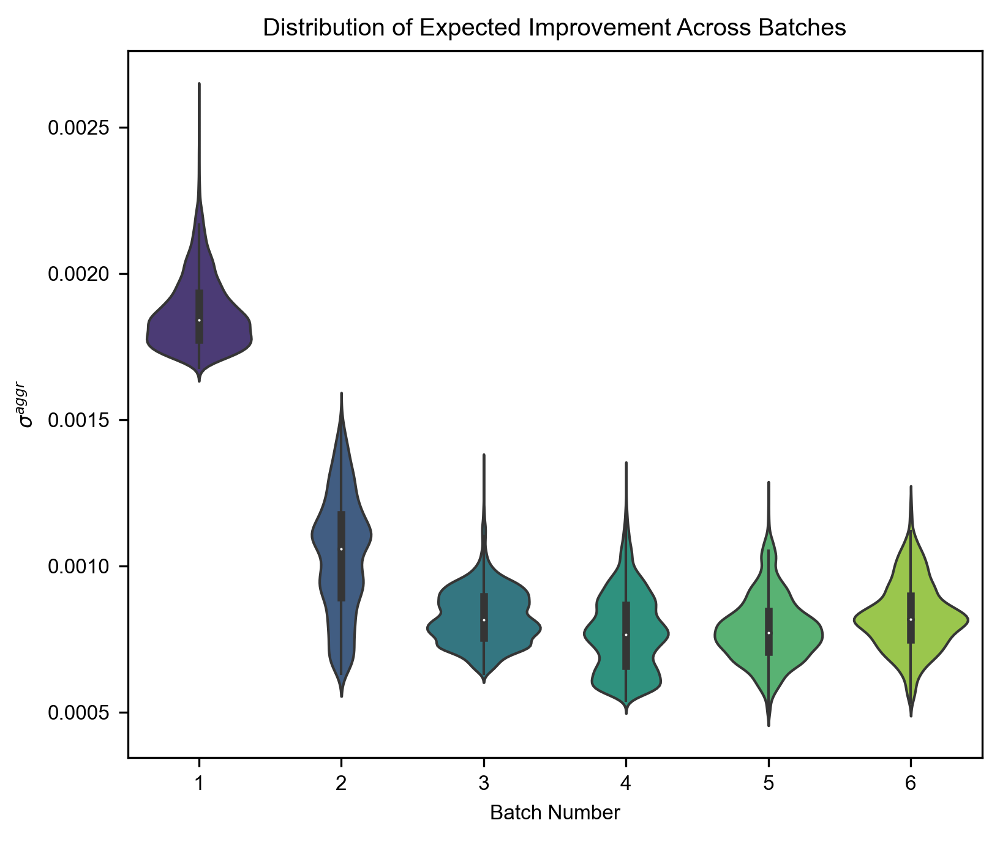

In [60]:
plt.figure(figsize=(6, 5))
# sns.violinplot(x='batch', y='EI_aggr', data=df_EI_all_, palette='viridis', inner='quartile')
sns.violinplot(x='batch', y='uncertainty_aggr', data=df_uncer_all, palette='viridis', linewidth=1) ## in absolute values
# sns.swarmplot(x='batch', y='EI_aggr', data=df_EI_all_, color='black', size=2)
# plt.yscale('log')  # Set y-axis to log scale
plt.title('Distribution of Expected Improvement Across Batches')
plt.xlabel('Batch Number')
plt.ylabel('$\sigma^{aggr}$')
# plt.show()
plt.savefig('plot_uncer_aggr_si.eps', dpi=300)

### Violin/scatter plot for distribution of labels

In [38]:
blue = (0, 0.576, 0.902) # 0, 147, 230
green = (0.349,0.745,0.306) # 89, 190, 78
red = (0.984, 0.262, 0.219) # 251, 67, 56 
orange = (0.984, 0.713, 0.305) # 251, 182, 78 
purple = (0.839, 0.286, 0.604) # 214, 73, 1541
anvil = (0.298, 0.78, 0.77) # 76, 199, 196
dark_purple = (0.557, 0, 0.998) # 142, 0, 252
pink = (0.95, 0.78, 0.996) # 242, 199, 154
gray = (0.463,0.463,0.463) # 118, 118, 118
c1 = '#396b3a'
c2 = '#6ea397'
c3 = '#b56171'
c4 = '#79204e'
c5 = '#a5ebcc'
c6 = '#ffd266'
c7 = '#d27672'

In [3]:
df_tt = pd.read_csv('../red-embed-opt/label_all_ecfp_pca_add_feat_incl_b7_090824.csv')
df_tt['capacity_3'] = df_tt['norm_capacity_3'] * df_tt['theor_capacity']
df_b0_aq = df_tt.loc[df_tt['expt_test'] == 0][['solv_comb_sm', 'salt_comb_sm', 'norm_capacity_3', 'theor_capacity', 'expt_test']]
df_b0_aq['capacity_3'] = df_b0_aq['norm_capacity_3'] * df_b0_aq['theor_capacity']
df_b1_aq = df_tt.loc[df_tt['expt_test'] == 1][['solv_comb_sm', 'salt_comb_sm', 'norm_capacity_3', 'theor_capacity', 'expt_test']]
df_b1_aq['capacity_3'] = df_b1_aq['norm_capacity_3'] * df_b1_aq['theor_capacity']
df_b2_aq = df_tt.loc[df_tt['expt_test'] == 2][['solv_comb_sm', 'salt_comb_sm', 'norm_capacity_3', 'theor_capacity', 'expt_test']]
df_b2_aq['capacity_3'] = df_b2_aq['norm_capacity_3'] * df_b2_aq['theor_capacity']
df_b3_aq = df_tt.loc[df_tt['expt_test'] == 3][['solv_comb_sm', 'salt_comb_sm', 'norm_capacity_3', 'theor_capacity', 'expt_test']]
df_b3_aq['capacity_3'] = df_b3_aq['norm_capacity_3'] * df_b3_aq['theor_capacity']
df_b4_aq = df_tt.loc[df_tt['expt_test'] == 4][['solv_comb_sm', 'salt_comb_sm', 'norm_capacity_3', 'theor_capacity', 'expt_test']]
df_b4_aq['capacity_3'] = df_b4_aq['norm_capacity_3'] * df_b4_aq['theor_capacity']
df_b5_aq = df_tt.loc[df_tt['expt_test'] == 5][['solv_comb_sm', 'salt_comb_sm', 'norm_capacity_3', 'theor_capacity', 'expt_test']]
df_b5_aq['capacity_3'] = df_b5_aq['norm_capacity_3'] * df_b5_aq['theor_capacity']
df_b6_aq = df_tt.loc[df_tt['expt_test'] == 6][['solv_comb_sm', 'salt_comb_sm', 'norm_capacity_3', 'theor_capacity', 'expt_test']]
df_b6_aq['capacity_3'] = df_b6_aq['norm_capacity_3'] * df_b6_aq['theor_capacity']
df_b7_aq = df_tt.loc[df_tt['expt_test'] == 7][['solv_comb_sm', 'salt_comb_sm', 'norm_capacity_3', 'theor_capacity', 'expt_test']]
df_b7_aq['capacity_3'] = df_b7_aq['norm_capacity_3'] * df_b7_aq['theor_capacity']
df_tt

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test,capacity_3
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0,41.487
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0,99.219
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.022967,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0,26.758
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.000360,0.000407,0.0006,0.000593,0.000447,0.000333,0.0,0.0,0.0,32.543
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0,3.928
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,CCOCCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,115.800
204,COCCCCOCC(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,108.900
205,COCCCOCC(C)(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,66.300
206,COCCCOCC(F)(F)C(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,123.000


In [5]:
df_b1_aq_uniq = df_b1_aq.drop_duplicates(subset=['solv_comb_sm'])
df_b1_aq_uniq.reset_index(drop=True, inplace=True)
df_b2_aq_uniq = df_b2_aq.drop_duplicates(subset=['solv_comb_sm'])
df_b2_aq_uniq.reset_index(drop=True, inplace=True)
df_b3_aq_uniq = df_b3_aq.drop_duplicates(subset=['solv_comb_sm'])
df_b3_aq_uniq.reset_index(drop=True, inplace=True)
df_b4_aq_uniq = df_b4_aq.drop_duplicates(subset=['solv_comb_sm'])
df_b4_aq_uniq.reset_index(drop=True, inplace=True)
df_b5_aq_uniq = df_b5_aq.drop_duplicates(subset=['solv_comb_sm'])
df_b5_aq_uniq.reset_index(drop=True, inplace=True)
df_b6_aq_uniq = df_b6_aq.drop_duplicates(subset=['solv_comb_sm'])
df_b6_aq_uniq.reset_index(drop=True, inplace=True)
df_b7_aq_uniq = df_b7_aq.drop_duplicates(subset=['solv_comb_sm'])
df_b7_aq_uniq.reset_index(drop=True, inplace=True)

Text(0, 0.5, 'Discharge capacity (mAh/g)')

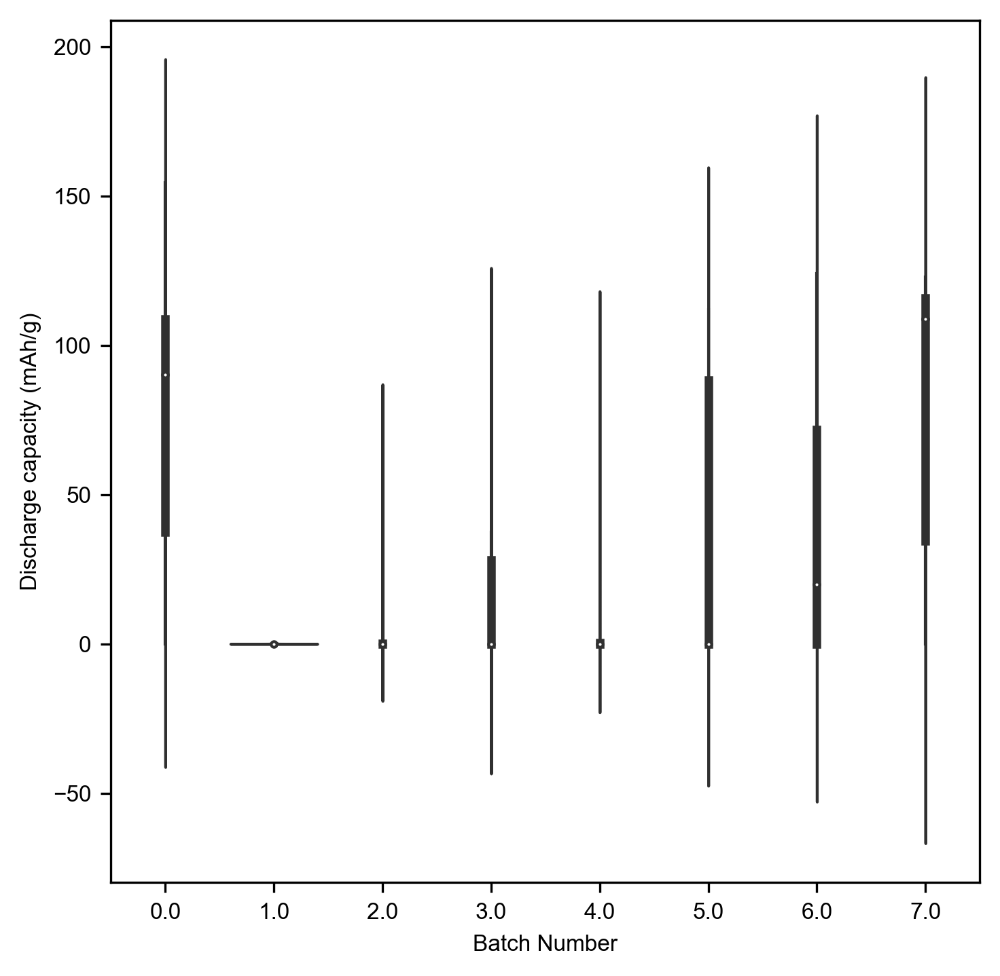

In [ ]:
## not sure why violin distribution is not showing -> not using
fig, ax = plt.subplots(figsize=(5.5, 5.5))
sns.violinplot(x='expt_test', y='capacity_3', data=df_tt, palette='viridis', linewidth=1)
plt.xlabel('Batch Number')
plt.ylabel('Discharge capacity (mAh/g)')

In [27]:
df_b7_aq_uniq['capacity_3'].describe()

count      9.000000
mean      75.612222
std       51.790005
min        0.000000
25%       34.400000
50%      108.900000
75%      115.800000
max      123.000000
Name: capacity_3, dtype: float64

/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-packages/seaborn/categorical.py:3544: UserWarning: 57.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-packages/seaborn/categorical.py:3544: UserWarning: 8.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<AxesSubplot: xlabel='expt_test', ylabel='capacity_3'>

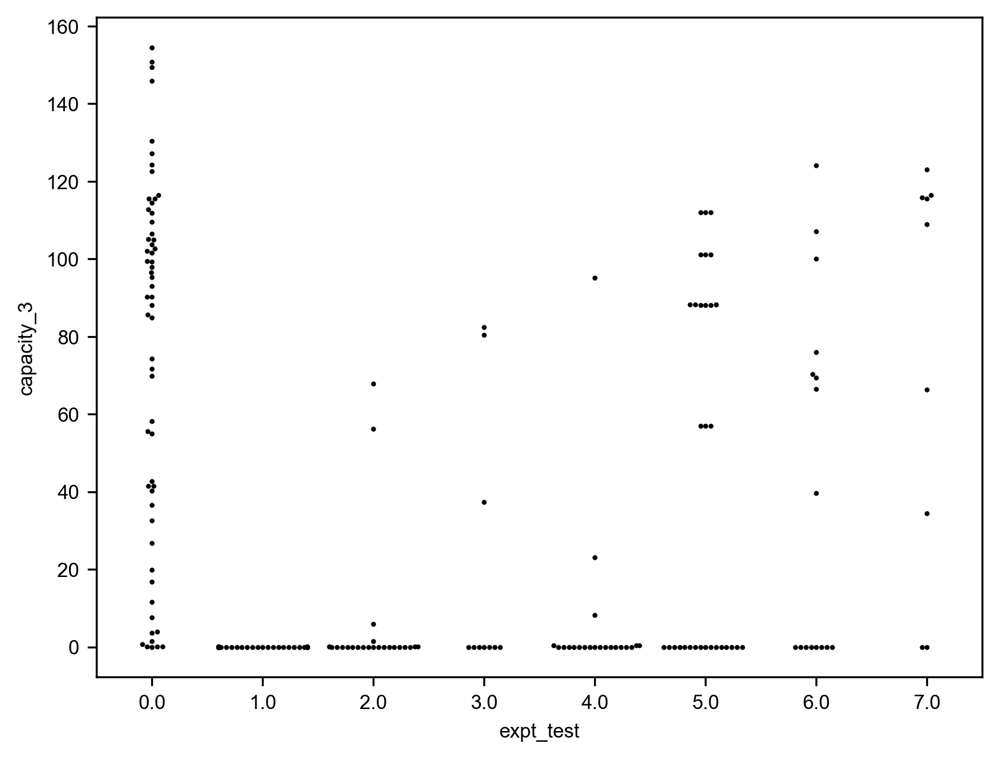

In [ ]:
## not using
sns.swarmplot(x='expt_test', y='capacity_3', data=df_tt, color='black', size=2)

<AxesSubplot: xlabel='expt_test', ylabel='capacity_3'>

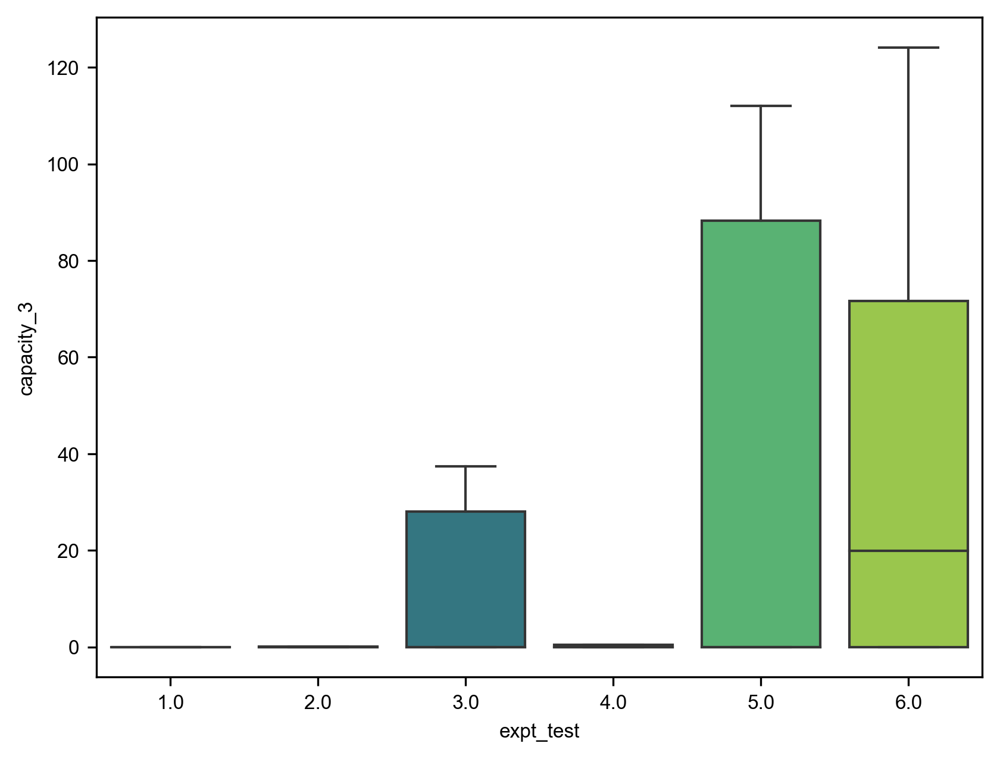

In [ ]:
## not using
df_tt_ = df_tt.copy()
ind_0 = df_tt_[df_tt_['expt_test'] == 0].index
ind_7 = df_tt_[df_tt_['expt_test'] == 7].index
ind_both = ind_0.append(ind_7)
df_tt_.drop(index=ind_both, inplace=True)
df_tt_.reset_index(drop=True, inplace=True)
sns.boxplot(x='expt_test', y='capacity_3', data=df_tt_, palette='viridis', linewidth=1, showfliers=False)

In [42]:
# mean_cap = [df_b1_aq_uniq['capacity_3'].mean(), df_b2_aq_uniq['capacity_3'].mean(), df_b3_aq_uniq['capacity_3'].mean(), df_b4_aq_uniq['capacity_3'].mean(), df_b5_aq_uniq['capacity_3'].mean(), df_b6_aq_uniq['capacity_3'].mean(), df_b7_aq_uniq['capacity_3'].mean()]
mean_cap = [df_b1_aq_uniq['capacity_3'].mean(), df_b2_aq_uniq['capacity_3'].mean(), df_b3_aq_uniq['capacity_3'].mean(), df_b4_aq_uniq['capacity_3'].mean(), df_b5_aq_uniq['capacity_3'].mean(), df_b6_aq_uniq['capacity_3'].mean()]
batch = [1, 2, 3, 4, 5, 6]

In [51]:
df_b0_aq['norm_capacity_3'].describe()

count    58.000000
mean      0.468918
std       0.275274
min       0.000009
25%       0.249642
50%       0.579023
75%       0.697443
max       0.816787
Name: norm_capacity_3, dtype: float64

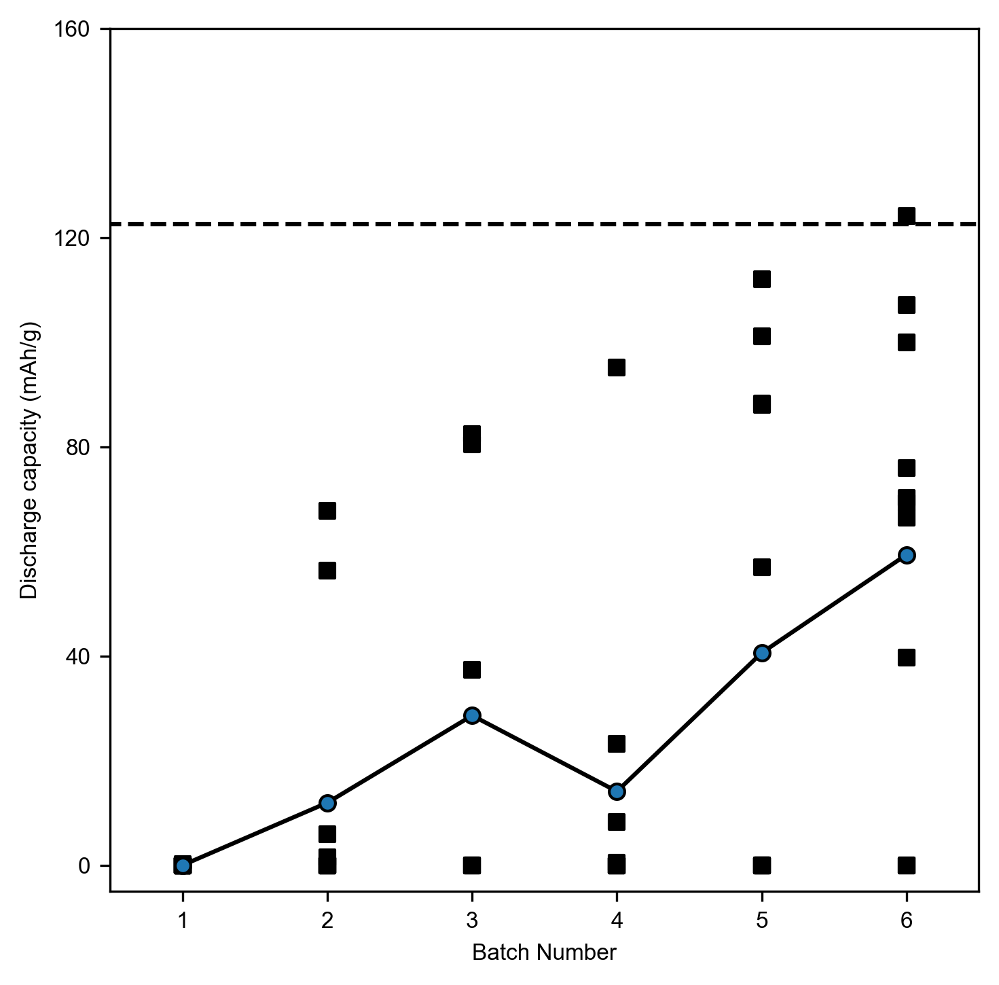

In [53]:
fig, ax = plt.subplots(figsize=(5.5, 5.5))
# plt.scatter(df_tt['expt_test'], df_tt['capacity_3'], color='black', s=2, marker='s')
plt.scatter(df_b1_aq_uniq['expt_test'], df_b1_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b2_aq_uniq['expt_test'], df_b2_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b3_aq_uniq['expt_test'], df_b3_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b4_aq_uniq['expt_test'], df_b4_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b5_aq_uniq['expt_test'], df_b5_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b6_aq_uniq['expt_test'], df_b6_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(batch, mean_cap, color=None, s=30, marker='o', edgecolors='black', zorder=2)
plt.hlines(y=0.816787*150.0, xmin=0, xmax=7, color='black', linestyle='--', zorder=1)
plt.plot(batch, mean_cap, color='black', linestyle='-', zorder=1)
plt.xlabel('Batch Number')
plt.ylabel('Discharge capacity (mAh/g)')
plt.ylim(-5, 160)
plt.yticks(np.arange(0, 200, 40))
plt.xlim(0.5, 6.5)
plt.savefig('plot_cap_20_mean_aq_111424.eps', dpi=300)

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_24526/2960014265.py:43: UserWarning: Glyph 8328 (\N{SUBSCRIPT EIGHT}) missing from current font.
  plt.tight_layout()
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_24526/2960014265.py:43: UserWarning: Glyph 8322 (\N{SUBSCRIPT TWO}) missing from current font.
  plt.tight_layout()
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_24526/2960014265.py:43: UserWarning: Glyph 8326 (\N{SUBSCRIPT SIX}) missing from current font.
  plt.tight_layout()
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_24526/2960014265.py:43: UserWarning: Glyph 8324 (\N{SUBSCRIPT FOUR}) missing from current font.
  plt.tight_layout()
/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 8328 (\N{SUBSCRIPT EIGHT}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-package

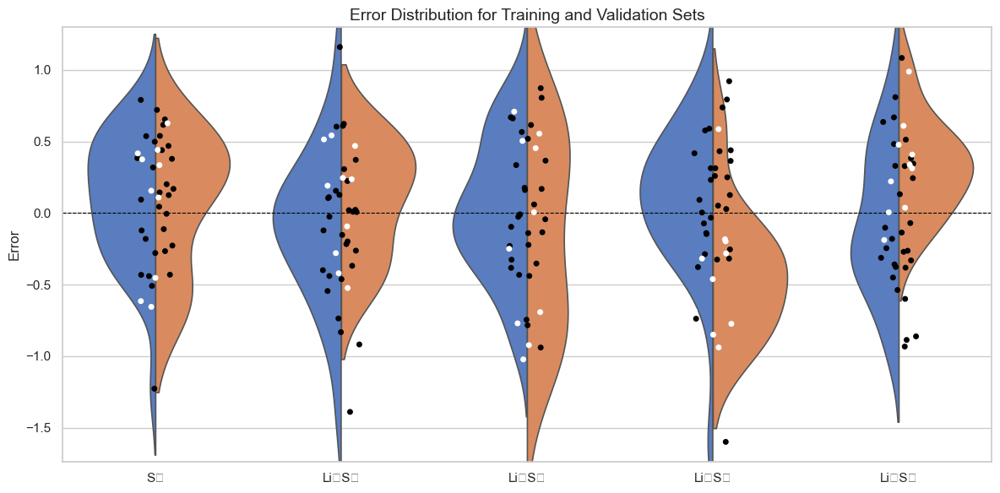

In [ ]:
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np
# import pandas as pd

# # Sample data preparation
# categories = ['S₈', 'Li₂S₈', 'Li₂S₆', 'Li₂S₄', 'Li₂S₂']
# training_errors = [np.random.normal(0, 0.5, 30) for _ in categories]
# validation_errors = [np.random.normal(0, 0.5, 10) for _ in categories]

# # Flatten data for plotting
# data = []
# for i, category in enumerate(categories):
#     data.extend([(error, category, 'Training set') for error in training_errors[i]])
#     data.extend([(error, category, 'Validation set') for error in validation_errors[i]])

# df = pd.DataFrame(data, columns=['Error', 'Category', 'Set'])

# # Plot setup
# plt.figure(figsize=(12, 6))
# sns.set(style="whitegrid")

# # Violin plot
# sns.violinplot(
#     data=df, x="Category", y="Error", hue="Set", split=True,
#     inner=None, linewidth=1.2, palette="muted"
# )

# # Overlay scatter points
# for set_name, color in zip(['Training set', 'Validation set'], ['black', 'white']):
#     subset = df[df['Set'] == set_name]
#     sns.stripplot(
#         data=subset, x="Category", y="Error", hue="Set",
#         dodge=True, size=5, jitter=True, palette=[color]
#     )

# # Final adjustments
# plt.axhline(0, color="black", linewidth=0.8, linestyle="--")
# plt.legend([], [], frameon=False)  # Hide duplicate legends
# plt.xlabel("")
# plt.ylabel("Error")
# plt.title("Error Distribution for Training and Validation Sets", fontsize=14)
# plt.tight_layout()

# plt.show()

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_24526/1066397341.py:80: UserWarning: Glyph 8328 (\N{SUBSCRIPT EIGHT}) missing from current font.
  plt.tight_layout()
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_24526/1066397341.py:80: UserWarning: Glyph 8322 (\N{SUBSCRIPT TWO}) missing from current font.
  plt.tight_layout()
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_24526/1066397341.py:80: UserWarning: Glyph 8326 (\N{SUBSCRIPT SIX}) missing from current font.
  plt.tight_layout()
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_24526/1066397341.py:80: UserWarning: Glyph 8324 (\N{SUBSCRIPT FOUR}) missing from current font.
  plt.tight_layout()
/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 8328 (\N{SUBSCRIPT EIGHT}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/riteshk/codes/miniconda3/envs/mdanalysis/lib/python3.8/site-package

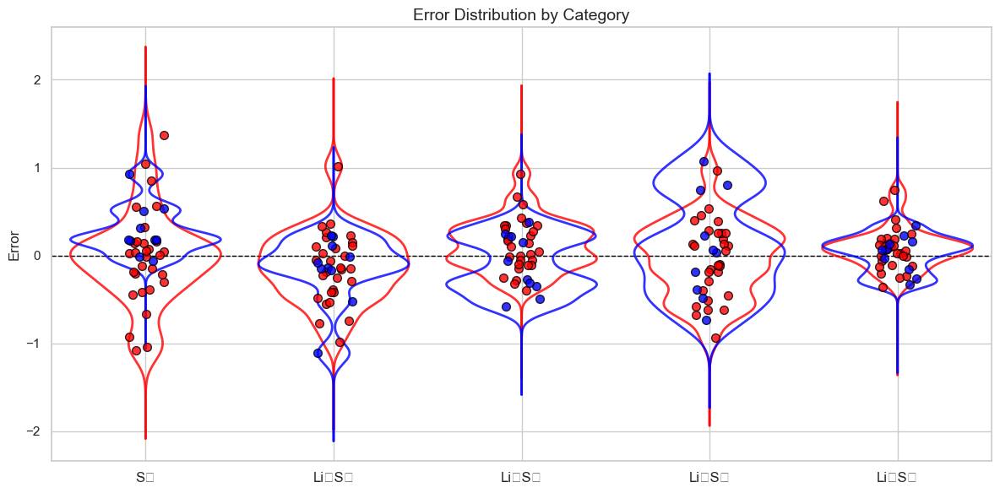

In [ ]:
# # Reattempting to generate the exact plot

# import matplotlib.pyplot as plt
# import numpy as np
# from scipy.stats import gaussian_kde

# # Data preparation
# categories = ['S₈', 'Li₂S₈', 'Li₂S₆', 'Li₂S₄', 'Li₂S₂']
# training_errors = [
#     np.random.normal(0, 0.5, 30),
#     np.random.normal(0, 0.4, 30),
#     np.random.normal(0, 0.3, 30),
#     np.random.normal(0, 0.5, 30),
#     np.random.normal(0, 0.2, 30),
# ]
# validation_errors = [
#     np.random.normal(0, 0.5, 10),
#     np.random.normal(0, 0.4, 10),
#     np.random.normal(0, 0.3, 10),
#     np.random.normal(0, 0.5, 10),
#     np.random.normal(0, 0.2, 10),
# ]

# # Plotting
# fig, ax = plt.subplots(figsize=(12, 6))

# # Helper function to plot scatter and density
# def plot_group(data, x_position, color, label, alpha=1.0):
#     # Scatter points
#     jitter = np.random.uniform(-0.1, 0.1, len(data))
#     ax.scatter(
#         np.full(len(data), x_position) + jitter,
#         data,
#         color=color,
#         edgecolor="black",
#         s=50,
#         zorder=3,
#         alpha=alpha,
#     )

#     # Density curve
#     kde = gaussian_kde(data, bw_method=0.3)
#     x_vals = np.linspace(min(data) - 1, max(data) + 1, 200)
#     density = kde(x_vals)
#     density = density / max(density) * 0.4  # Normalize and scale
#     ax.plot(
#         x_position + density,
#         x_vals,
#         color=color,
#         linewidth=2,
#         zorder=2,
#         alpha=alpha,
#     )
#     ax.plot(
#         x_position - density,
#         x_vals,
#         color=color,
#         linewidth=2,
#         zorder=2,
#         alpha=alpha,
#     )


# # Plot data for training and validation sets
# colors = ["red", "blue"]
# for i, (cat, train_data, val_data) in enumerate(
#     zip(categories, training_errors, validation_errors)
# ):
#     plot_group(train_data, i, colors[0], "Training set", alpha=0.8)
#     plot_group(val_data, i, colors[1], "Validation set", alpha=0.8)

# # Formatting
# ax.set_xticks(range(len(categories)))
# ax.set_xticklabels(categories, fontsize=12)
# ax.set_ylabel("Error", fontsize=12)
# ax.axhline(0, color="black", linestyle="--", linewidth=1, zorder=1)
# ax.set_xlim(-0.5, len(categories) - 0.5)
# ax.set_title("Error Distribution by Category", fontsize=14)

# plt.tight_layout()
# plt.show()


/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_46595/2753372112.py:17: UserWarning: 

The `vertical` parameter is deprecated; assigning data to `y`.
This will become an error in seaborn v0.13.0; please update your code.

  sns.kdeplot(df_tt['capacity_3'], vertical=True, ax=ax, color='blue', fill=True)


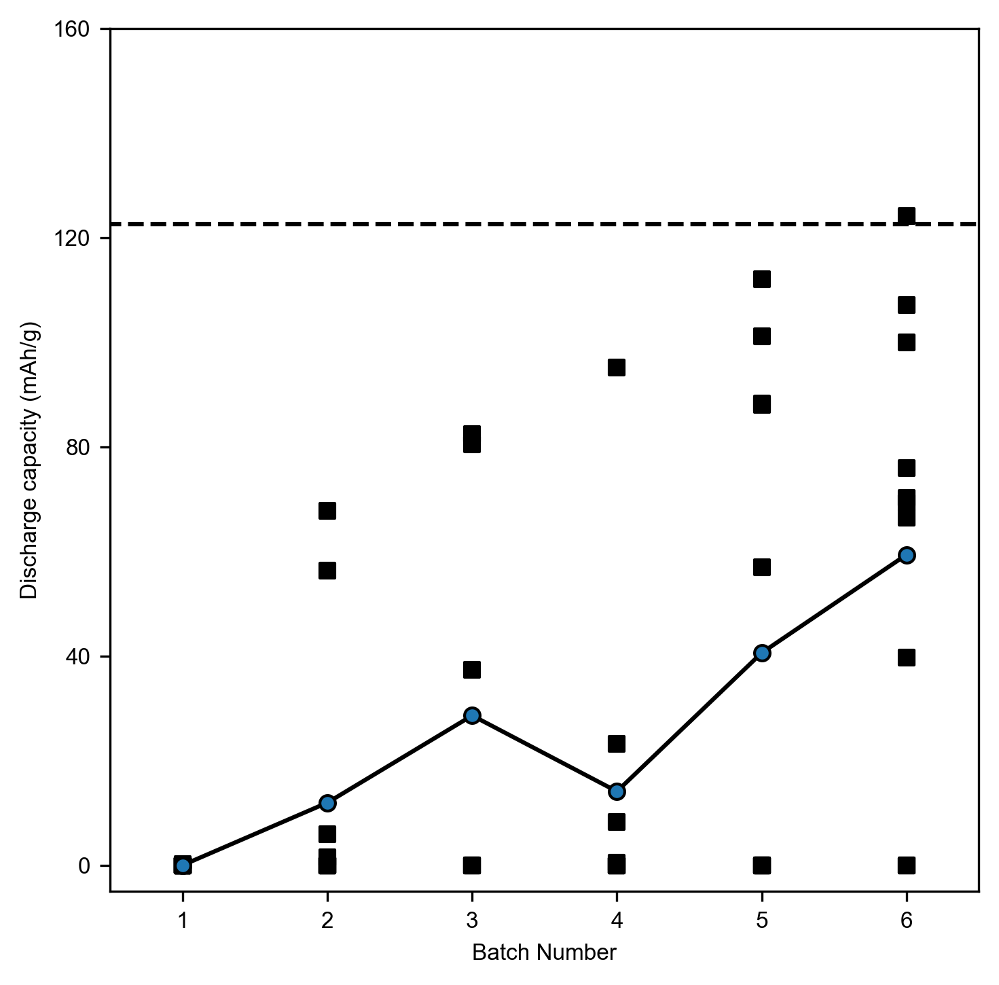

In [9]:
fig, ax = plt.subplots(figsize=(5.5, 5.5))

# Scatter plot for each batch
plt.scatter(df_b1_aq_uniq['expt_test'], df_b1_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b2_aq_uniq['expt_test'], df_b2_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b3_aq_uniq['expt_test'], df_b3_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b4_aq_uniq['expt_test'], df_b4_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b5_aq_uniq['expt_test'], df_b5_aq_uniq['capacity_3'], color='black', s=30, marker='s')
plt.scatter(df_b6_aq_uniq['expt_test'], df_b6_aq_uniq['capacity_3'], color='black', s=30, marker='s')

# Mean capacity for each batch
plt.scatter(batch, mean_cap, color=None, s=30, marker='o', edgecolors='black', zorder=2)
plt.hlines(y=0.816787*150.0, xmin=0, xmax=7, color='black', linestyle='--', zorder=1)
plt.plot(batch, mean_cap, color='black', linestyle='-', zorder=1)

# KDE density plot on the left side
sns.kdeplot(df_tt['capacity_3'], vertical=True, ax=ax, color='blue', fill=True)

# Labels and limits
plt.xlabel('Batch Number')
plt.ylabel('Discharge capacity (mAh/g)')
plt.ylim(-5, 160)
plt.yticks(np.arange(0, 200, 40))
plt.xlim(0.5, 6.5)

# Save the figure
# plt.savefig('plot_cap_20_mean_aq_111424.eps', dpi=300)
plt.show()

In [14]:
df_comb = pd.concat([df_b1_aq_uniq, df_b2_aq_uniq, df_b3_aq_uniq, df_b4_aq_uniq, df_b5_aq_uniq, df_b6_aq_uniq], ignore_index=True)
df_comb

,solv_comb_sm,salt_comb_sm,norm_capacity_3,theor_capacity,expt_test,capacity_3
0,CN1C(C)(C)CCCC1(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.000000,150.0,1.0,0.000000
1,CC1(C)CCCC(C)(C)N1Cl,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.000000,150.0,1.0,0.000000
2,CN1CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.000000,150.0,1.0,0.000000
3,CCN1CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.000000,150.0,1.0,0.000000
4,CC1(C(=O)Cl)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.000000,150.0,1.0,0.000000
...,...,...,...,...,...,...
58,CCCCOCCOCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.442987,150.0,6.0,66.448000
59,CCOCCOCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.666620,150.0,6.0,99.993000
60,COC1CCCCC1=O,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.000000,150.0,6.0,0.000000
61,COCCS(=O)(=O)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,0.264730,150.0,6.0,39.709449


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


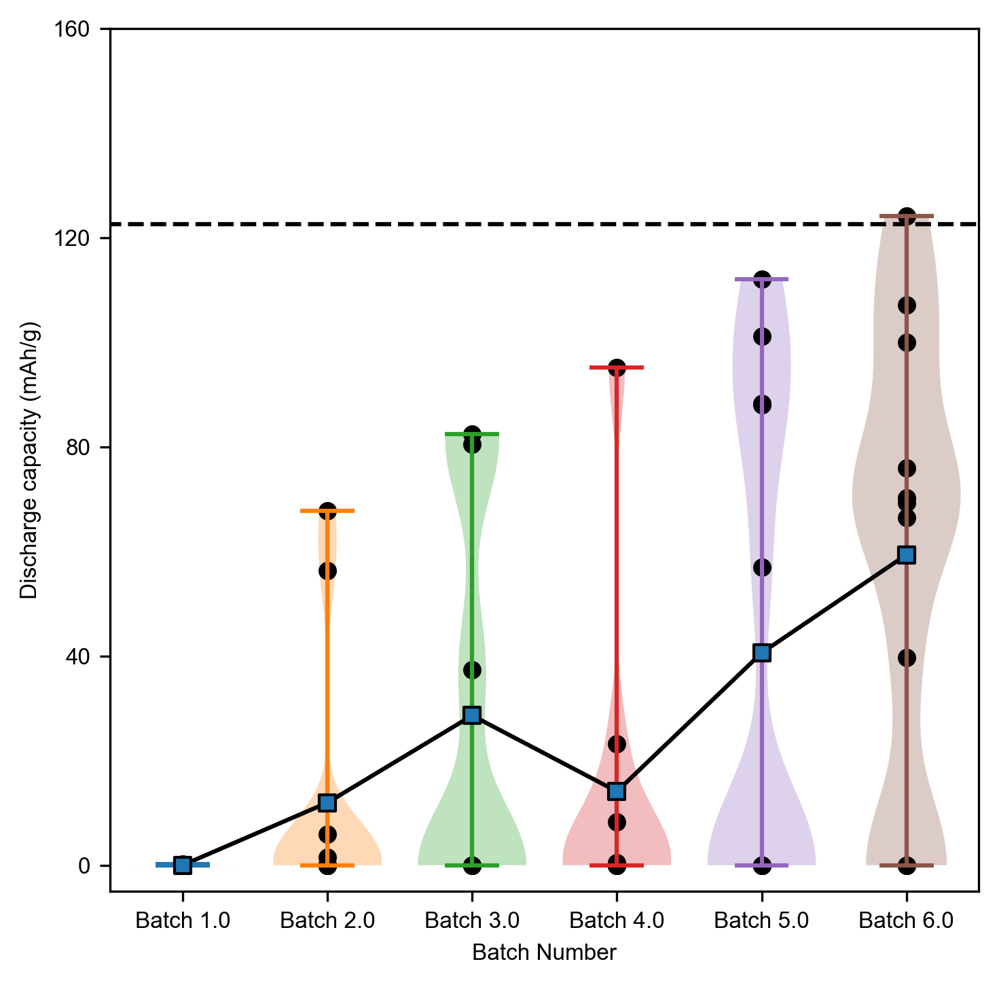

In [65]:
# Create the figure and axes
fig, ax = plt.subplots(figsize=(5.5, 5.5))
colors = [pink, purple, red, green, c1, anvil]
mean_cap = [df_b1_aq_uniq['capacity_3'].mean(), df_b2_aq_uniq['capacity_3'].mean(), df_b3_aq_uniq['capacity_3'].mean(), df_b4_aq_uniq['capacity_3'].mean(), df_b5_aq_uniq['capacity_3'].mean(), df_b6_aq_uniq['capacity_3'].mean()]
batch_ = [1, 2, 3, 4, 5, 6]


i = 0
# Vertical distribution plot
for batch in df_comb['expt_test'].unique():
    batch_data = df_comb[df_comb['expt_test'] == batch]['capacity_3']
    ax.violinplot(batch_data, positions=[batch], showmeans=False, showmedians=False, showextrema=True, widths=0.75, bw_method=0.3,)
    i += 1

# Scatter plot
ax.scatter(df_comb['expt_test'], df_comb['capacity_3'], s=30, color='black', marker='o')

plt.plot(batch_, mean_cap, color='black', linestyle='-', zorder=1)
plt.scatter(batch_, mean_cap, color=None, s=35, marker='s', edgecolors='black', zorder=2)
plt.hlines(y=0.816787*150.0, xmin=0, xmax=7, color='black', linestyle='--', zorder=1)

# Set labels and title
plt.xlabel('Batch Number')
plt.ylabel('Discharge capacity (mAh/g)')
plt.ylim(-5, 160)
plt.yticks(np.arange(0, 200, 40))
plt.xlim(0.5, 6.5)
# ax.set_title('Batch Capacity Distribution and Scatter')

# Adjust the x-axis ticks
ax.set_xticks(df_comb['expt_test'].unique())
ax.set_xticklabels([f'Batch {i}' for i in df_comb['expt_test'].unique()])
plt.savefig('plot_cap_20_mean_aq_violin_120424.eps', dpi=300)

ValueError: not enough values to unpack (expected 2, got 1)

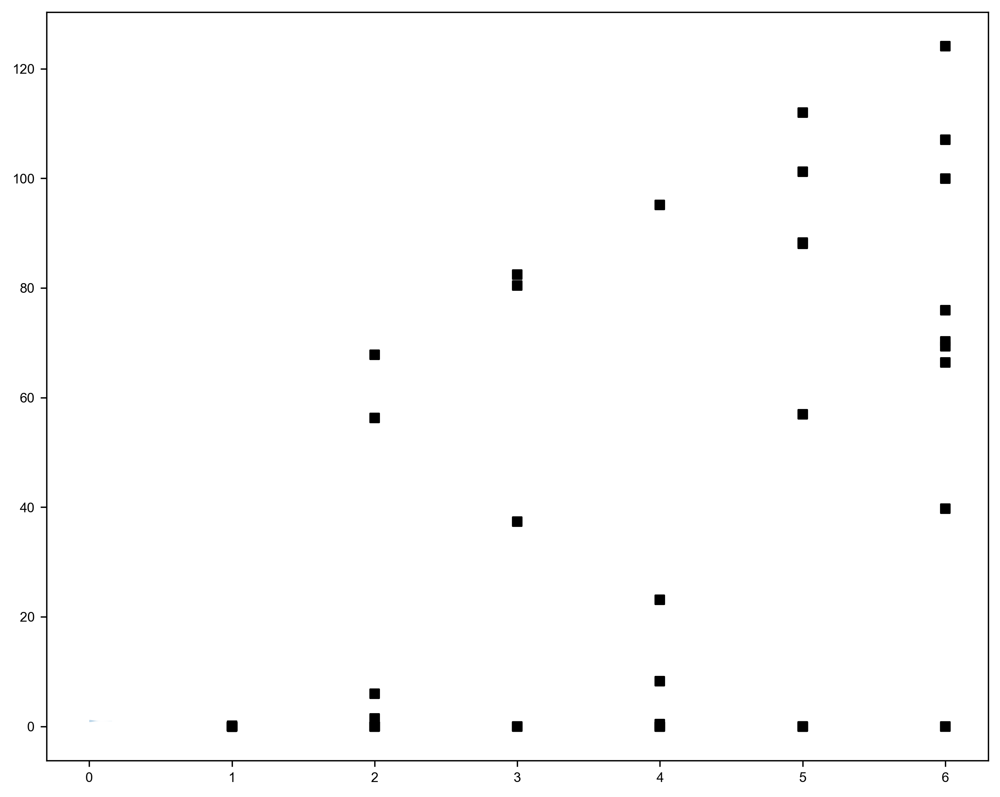

In [29]:
# # Create the figure and axes
# fig, ax = plt.subplots(figsize=(10, 8))

# # Scatter plot
# ax.scatter(df_comb['expt_test'], df_comb['capacity_3'], s=30, color='black', marker='s')

# # One-sided vertical distribution plot
# for batch in df_comb['expt_test'].unique():
#     batch_data = df_comb[df_comb['expt_test'] == batch]['capacity_3']
    
#     # Create the violin plot, but only keep the left half
#     _, bodies = ax.violinplot(batch_data, positions=[batch], showmeans=False, showmedians=False, showextrema=False, widths=0.4, vert=False)
#     for body in bodies['bodies']:
#         body.set_facecolor('none')
#         body.set_edgecolor('black')

# # Set labels and title
# ax.set_xlabel('Batch Number')
# ax.set_ylabel('Capacity (mAh/g)')
# ax.set_title('Batch Capacity Distribution and Scatter')

# # Adjust the x-axis ticks
# ax.set_xticks(df_comb['expt_test'].unique())
# ax.set_xticklabels([f'Batch {i}' for i in df_comb['expt_test'].unique()])

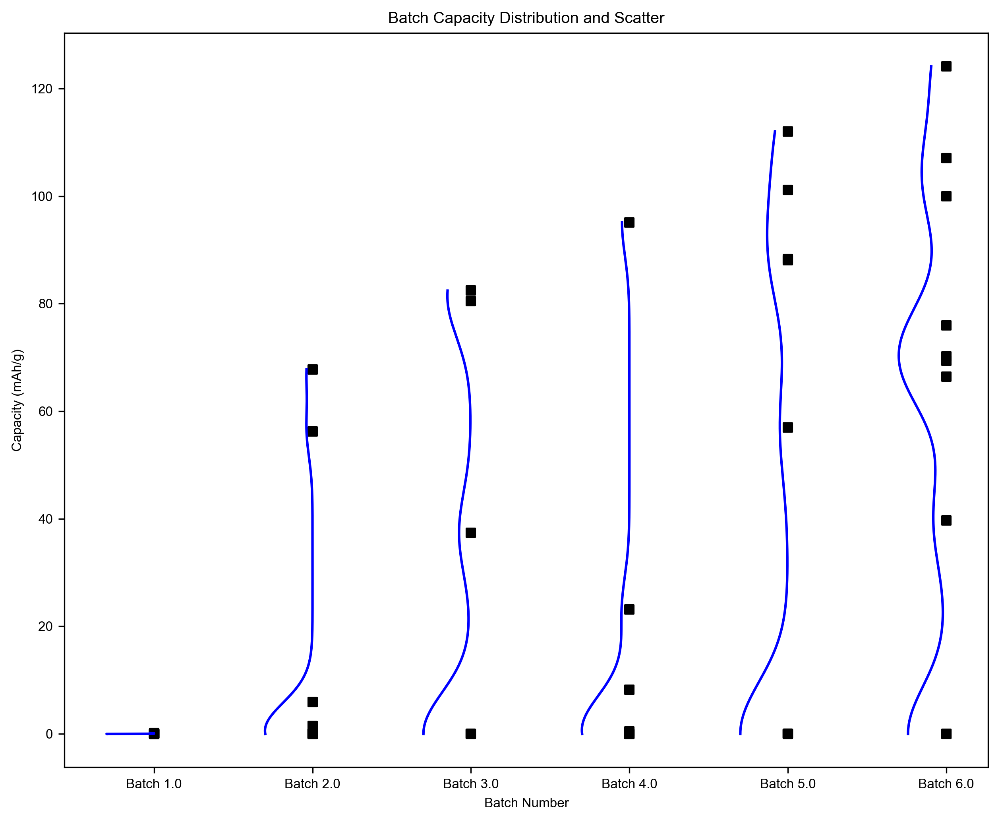

In [32]:
import matplotlib.pyplot as plt
import numpy as np


# Function to plot one-sided violin for each batch
def plot_one_sided_violin(ax, x_pos, data, bandwidth=0.2, width=0.3, color='blue', linewidth=1.5):
    """
    Plots a one-sided violin distribution at a given x position.
    """
    # Kernel Density Estimation (KDE)
    kde = gaussian_kde(data, bw_method=bandwidth)
    y = np.linspace(min(data), max(data), 500)  # Range of y-values
    density = kde(y)                           # Compute KDE density

    # Scale the density to fit within the desired width
    density = density / density.max() * width

    # Plot the one-sided violin (on the left side)
    ax.plot(x_pos - density, y, color=color, linewidth=linewidth)  # Left side of violin

# Assuming df_comb is your DataFrame
fig, ax = plt.subplots(figsize=(10, 8))

# Scatter plot
for batch in df_comb['expt_test'].unique():
    batch_data = df_comb[df_comb['expt_test'] == batch]['capacity_3']
    ax.scatter([batch] * len(batch_data), batch_data, s=30, color='black', marker='s')  # Scatter plot
    
    # One-sided violin plot
    plot_one_sided_violin(ax, x_pos=batch, data=batch_data, color='blue')

# Set labels and title
ax.set_xlabel('Batch Number')
ax.set_ylabel('Capacity (mAh/g)')
ax.set_title('Batch Capacity Distribution and Scatter')

# Adjust the x-axis ticks
ax.set_xticks(df_comb['expt_test'].unique())
ax.set_xticklabels([f'Batch {i}' for i in df_comb['expt_test'].unique()])

plt.show()


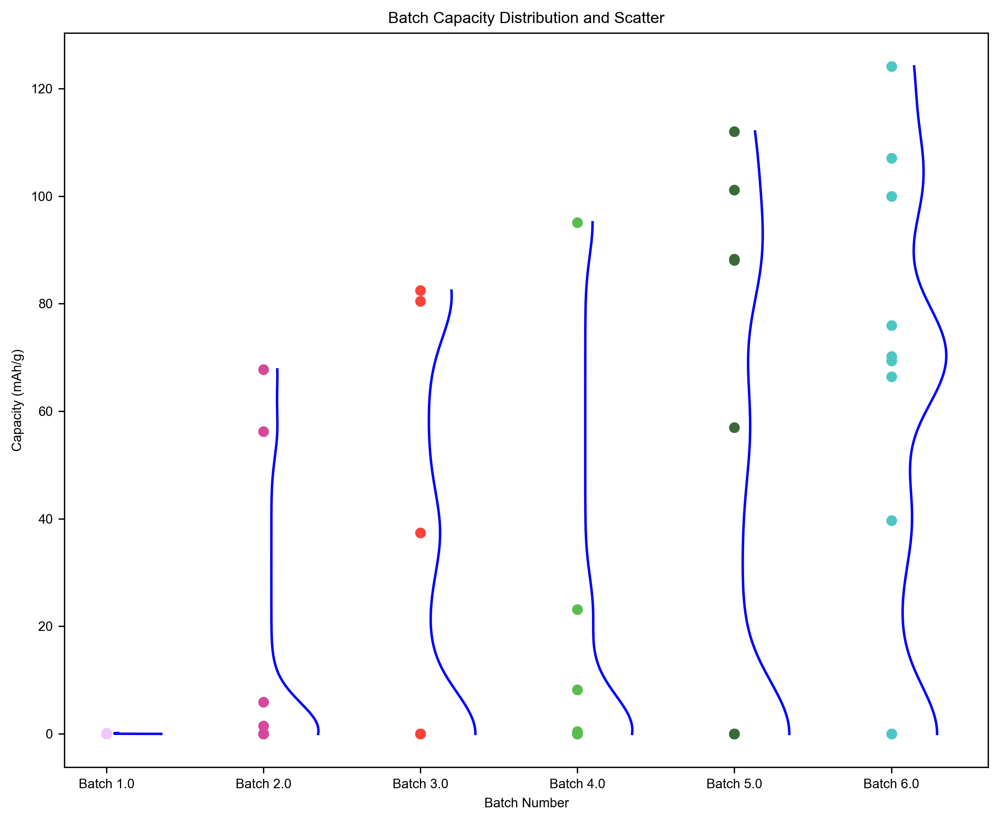

In [68]:
colors = [pink, purple, red, green, c1, anvil]

# Function to plot one-sided violin for each batch
def plot_one_sided_violin(ax, x_pos, data, bandwidth=0.2, width=0.3, color='blue', linewidth=1.5):
    """
    Plots a one-sided violin distribution to the right of a given x position.
    """
    # Kernel Density Estimation (KDE)
    # kde = gaussian_kde(data, bw_method=bandwidth)
    kde = gaussian_kde(data, bw_method=0.2)
    y = np.linspace(min(data), max(data), 500)  # Range of y-values
    density = kde(y)                           # Compute KDE density

    # Scale the density to fit within the desired width
    density = density / density.max() * width

    # Plot the one-sided violin (to the right side)
    ax.plot(x_pos + density, y, color=color, linewidth=linewidth)  # Right side of violin

# Assuming df_comb is your DataFrame
fig, ax = plt.subplots(figsize=(10, 8))

i = 0
# Scatter plot
for batch in df_comb['expt_test'].unique():
    batch_data = df_comb[df_comb['expt_test'] == batch]['capacity_3']
    ax.scatter([batch] * len(batch_data), batch_data, s=30, color=colors[i], marker='o')  # Scatter plot
    
    # One-sided violin plot shifted to the right of the scatter points
    plot_one_sided_violin(ax, x_pos=batch + 0.05, data=batch_data, color='blue')  # Shift violins right by 0.1
    i += 1

# Set labels and title
ax.set_xlabel('Batch Number')
ax.set_ylabel('Capacity (mAh/g)')
ax.set_title('Batch Capacity Distribution and Scatter')

# Adjust the x-axis ticks
ax.set_xticks(df_comb['expt_test'].unique())
ax.set_xticklabels([f'Batch {i}' for i in df_comb['expt_test'].unique()])

plt.show()


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


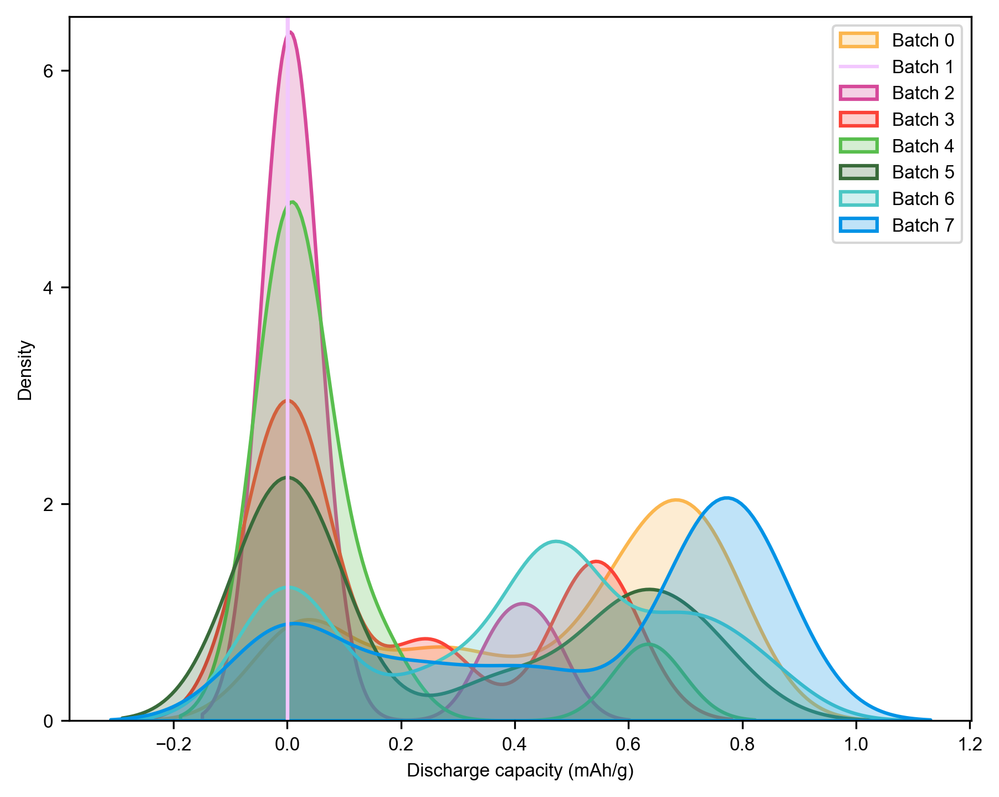

In [91]:
colors = [orange, pink, purple, red, green, c1, anvil, blue]
fig, ax = plt.subplots(figsize=(7, 5.5))
sns.kdeplot(df_b0_aq['norm_capacity_3'], color=colors[0], label='Batch 0', linewidth=1.5, bw_method=0.3, fill=True)
sns.kdeplot(df_b1_aq_uniq['norm_capacity_3'], color=colors[1], label='Batch 1', linewidth=1.5, bw_method=0.3)
sns.kdeplot(df_b2_aq_uniq['norm_capacity_3'], color=colors[2], label='Batch 2', linewidth=1.5, bw_method=0.3, fill=True)
sns.kdeplot(df_b3_aq_uniq['norm_capacity_3'], color=colors[3], label='Batch 3', linewidth=1.5, bw_method=0.3, fill=True)
sns.kdeplot(df_b4_aq_uniq['norm_capacity_3'], color=colors[4], label='Batch 4', linewidth=1.5, bw_method=0.3, fill=True)
sns.kdeplot(df_b5_aq_uniq['norm_capacity_3'], color=colors[5], label='Batch 5', linewidth=1.5, bw_method=0.3, fill=True)
sns.kdeplot(df_b6_aq_uniq['norm_capacity_3'], color=colors[6], label='Batch 6', linewidth=1.5, bw_method=0.3, fill=True)
sns.kdeplot(df_b7_aq_uniq['norm_capacity_3'], color=colors[7], label='Batch 7', linewidth=1.5, bw_method=0.3, fill=True)
plt.xlabel('Discharge capacity (mAh/g)')
plt.ylim(0, 6.5)
plt.yticks([0, 2, 4, 6])
plt.legend()
plt.savefig('plot_cap_20_kde_aq_120424.eps', dpi=300)

(0.0, 5.0)

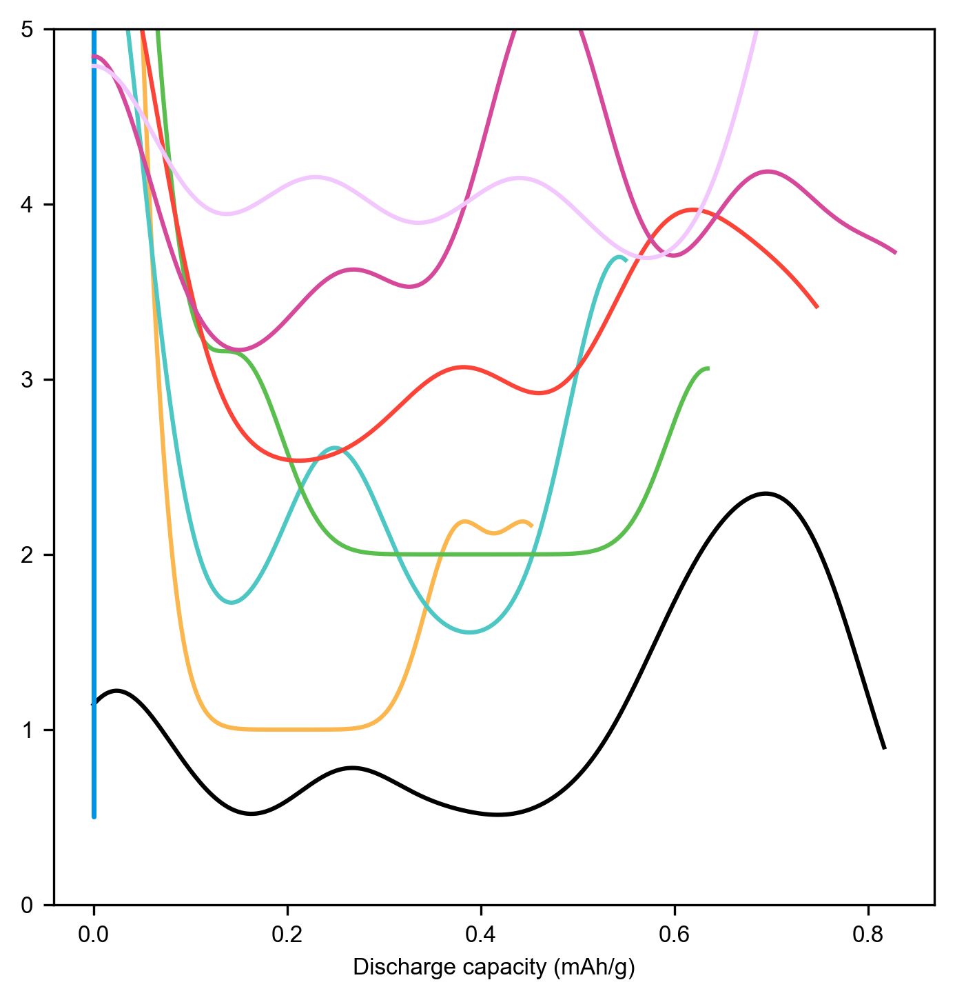

In [83]:
def calc_density(data, bandwidth=0.2):
    kde = gaussian_kde(data, bw_method=0.2)
    y = np.linspace(min(data), max(data), 500)  # Range of y-values
    density = kde(y) 
    return y, density

x_b0, den_b0 = calc_density(df_b0_aq['norm_capacity_3'])
x_b1, den_b1 = calc_density(df_b1_aq_uniq['norm_capacity_3'])
x_b2, den_b2 = calc_density(df_b2_aq_uniq['norm_capacity_3'])
x_b3, den_b3 = calc_density(df_b3_aq_uniq['norm_capacity_3'])
x_b4, den_b4 = calc_density(df_b4_aq_uniq['norm_capacity_3'])
x_b5, den_b5 = calc_density(df_b5_aq_uniq['norm_capacity_3'])
x_b6, den_b6 = calc_density(df_b6_aq_uniq['norm_capacity_3'])
x_b7, den_b7 = calc_density(df_b7_aq_uniq['norm_capacity_3'])

offset = [0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5]

fig, ax = plt.subplots(figsize=(5.5, 5.5))
# plt.plot(x_b0, den_b0+offset[0], color='black', label='Batch 0')
plt.plot(x_b0, den_b0, color='black', label='Batch 0')
plt.plot(x_b1, den_b1+offset[1], color=blue)
plt.plot(x_b2, den_b2+offset[2], color=orange)
plt.plot(x_b3, den_b3+offset[3], color=anvil)
plt.plot(x_b4, den_b4+offset[4], color=green)
plt.plot(x_b5, den_b5+offset[5], color=red)
plt.plot(x_b6, den_b6+offset[6], color=purple)
plt.plot(x_b7, den_b7+offset[7], color=pink)
plt.xlabel('Discharge capacity (mAh/g)')
plt.ylim(0, 5.0)

In [77]:
den_b0

array([1.14334153, 1.15365525, 1.16326912, 1.17217102, 1.18035054,
       1.18779898, 1.1945094 , 1.20047662, 1.20569718, 1.21016941,
       1.21389335, 1.21687078, 1.21910514, 1.22060154, 1.22136671,
       1.22140893, 1.22073803, 1.21936525, 1.21730328, 1.2145661 ,
       1.21116898, 1.20712834, 1.20246174, 1.19718777, 1.19132594,
       1.18489664, 1.17792105, 1.17042103, 1.16241906, 1.15393813,
       1.14500168, 1.13563353, 1.12585776, 1.11569864, 1.10518059,
       1.09432808, 1.08316555, 1.07171736, 1.06000774, 1.04806069,
       1.03589997, 1.02354901, 1.01103091, 0.99836835, 0.98558357,
       0.97269834, 0.95973394, 0.94671111, 0.93365005, 0.92057038,
       0.90749115, 0.89443081, 0.88140722, 0.86843763, 0.85553871,
       0.84272649, 0.83001644, 0.81742341, 0.80496169, 0.79264499,
       0.78048646, 0.76849871, 0.7566938 , 0.74508329, 0.73367822,
       0.72248916, 0.71152619, 0.70079893, 0.69031658, 0.68008788,
       0.67012117, 0.6604244 , 0.65100509, 0.64187042, 0.63302

### Wasserstein distance for acquisition from different batches (using features used for training surrogate models)

In [2]:
df_tt = pd.read_csv('label_all_ecfp_pca_add_feat_incl_b7_090824.csv')
df_tt

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.02168,0.022967,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.00046,0.000360,0.000407,0.0006,0.000593,0.000447,0.000333,0.0,0.0,0.0
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,CCOCCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
204,COCCCCOCC(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
205,COCCCOCC(C)(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
206,COCCCOCC(F)(F)C(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0


In [3]:
df_l_0 = df_tt.loc[df_tt['batch'] == 0]
df_l_0 = df_l_0.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_0.reset_index(drop=True, inplace=True)
df_l_1 = df_tt.loc[df_tt['batch'] == 1]
df_l_1 = df_l_1.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_1.reset_index(drop=True, inplace=True)
df_l_2 = df_tt.loc[df_tt['batch'] == 2]
df_l_2 = df_l_2.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_2.reset_index(drop=True, inplace=True)
df_l_3 = df_tt.loc[df_tt['batch'] == 3]
df_l_3 = df_l_3.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_3.reset_index(drop=True, inplace=True)
df_l_4 = df_tt.loc[df_tt['batch'] == 4]
df_l_4 = df_l_4.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_4.reset_index(drop=True, inplace=True)
df_l_5 = df_tt.loc[df_tt['batch'] == 5]
df_l_5 = df_l_5.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_5.reset_index(drop=True, inplace=True)
df_l_6 = df_tt.loc[df_tt['batch'] == 6]
df_l_6 = df_l_6.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_6.reset_index(drop=True, inplace=True)
df_l_7 = df_tt.loc[df_tt['batch'] == 7]
df_l_7 = df_l_7.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_7.reset_index(drop=True, inplace=True)
# df_l_1 = df_tt.loc[df_tt['batch'] == 1]
# # df_l_2 = df_tt.loc[df_tt['batch'] == 2]
# # df_l_3 = df_tt.loc[df_tt['batch'] == 3]
# # df_l_4 = df_tt.loc[df_tt['batch'] == 4]
# # df_l_5 = df_tt.loc[df_tt['batch'] == 5]
# # df_l_6 = df_tt.loc[df_tt['batch'] == 6]
# # df_l_7 = df_tt.loc[df_tt['batch'] == 7]
df_l_0

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.021680,0.022967,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
3,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
4,CCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.092295,-1.519334,-0.056200,-0.093036,-0.572012,-0.583818,-0.053796,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
5,CCCCOCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.067892,-1.253529,0.602357,0.775134,-0.714364,1.295648,0.646532,...,0.023487,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
6,COCCOC1CCCC1,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,0.394637,-0.462672,0.854416,-0.416162,-1.007141,1.060702,0.662827,...,0.019667,0.019633,0.021167,0.022867,0.026233,0.025507,0.025267,0.0,0.0,0.0
7,CCCCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.075803,-1.758840,-0.316575,0.667843,-0.912376,0.097061,-0.035434,...,0.044827,0.041993,0.037160,0.043613,0.046513,0.048480,0.050413,0.0,0.0,0.0
8,COCCOCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.899245,-1.039674,1.079794,-0.351354,-0.360827,0.421555,0.804488,...,0.000527,0.000473,0.000447,0.000447,0.000380,0.000427,0.000500,0.0,0.0,0.0
9,FC(F)(F)COCCOCCOCC(F)(F)F,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.657249,-1.593831,0.624976,-0.502685,0.783077,-0.000998,0.897057,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0


In [19]:
df_l_7

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test
0,COCCOS(=O)(=O)C(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
1,COCCOCC(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
2,COC1CCCCO1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
3,CCCCOCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
4,CCOCCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
5,COCCCCOCC(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
6,COCCCOCC(C)(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
7,COCCCOCC(F)(F)C(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
8,COCCCF,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0


In [23]:
df_b7_explore= pd.read_csv('../campaign-7/iter_7_top5000_sugg_ei_unique_explore.csv')
df_b7_exploit = pd.read_csv('../campaign-7/iter_7_top5000_sugg_ei_unique_exploit.csv')
df_b7 = pd.concat([df_b7_explore, df_b7_exploit], ignore_index=True)
df_b7.drop_duplicates(subset='solv_comb_sm', keep='first', inplace=True)
# df_l_7.iloc[:, 3:13]
df_l_7_ = df_l_7.merge(df_b7, how='inner', left_on='solv_comb_sm', right_on='solv_comb_sm')
df_l_7_.columns
df_l_7_.drop_duplicates(subset='solv_comb_sm', keep='first', inplace=True)
df_l_7_

,solv_comb_sm,salt_comb_sm_x,batch,solv_ecfp_pca_0_x,solv_ecfp_pca_1_x,solv_ecfp_pca_2_x,solv_ecfp_pca_3_x,solv_ecfp_pca_4_x,solv_ecfp_pca_5_x,solv_ecfp_pca_6_x,...,conc_salt_1_y,conc_salt_2_y,theor_capacity_y,amt_electrolyte_y,pressure_type_y,TSNE_0,TSNE_1,database,rank,norm_capacity_3_avg_pred
0,COCCOS(=O)(=O)C(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,23.028234,25.547901,sugg_7th_4,4631.0,NaN
1,COCCOCC(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,21.962004,-2.860457,sugg_7th_2,2115.0,NaN
2,COC1CCCCO1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,-19.605875,-5.217189,sugg_7th_8,3056.0,NaN
3,CCCCOCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,-35.071060,5.273153,sugg_7th_8,264.0,NaN
4,CCOCCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,-35.198833,5.118565,sugg_7th_8,130.0,NaN
5,COCCCCOCC(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,31.894388,-3.622852,sugg_7th_2,4.0,NaN
6,COCCCOCC(C)(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,31.893995,-3.603320,sugg_7th_2,5.0,NaN
7,COCCCOCC(F)(F)C(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,-5.942949,-9.629054,sugg_7th_1,16.0,NaN
8,COCCCF,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,150,50,2,-16.363634,36.386475,sugg_7th_0,285.0,NaN


In [27]:
df_l_7_.iloc[:,-32:-22]

,solv_ecfp_pca_0_y,solv_ecfp_pca_1_y,solv_ecfp_pca_2_y,solv_ecfp_pca_3_y,solv_ecfp_pca_4_y,solv_ecfp_pca_5_y,solv_ecfp_pca_6_y,solv_ecfp_pca_7_y,solv_ecfp_pca_8_y,solv_ecfp_pca_9_y
0,-1.168596,-0.281339,1.360376,-0.309095,0.524577,0.064871,0.989764,0.263234,-0.702198,-0.508844
1,-1.095649,-0.965356,0.935134,-0.459764,-0.700674,-0.116387,0.853413,0.497956,-0.709696,-0.398830
2,1.016226,-0.952835,1.050206,-0.993306,-0.181317,0.699064,0.240841,-0.729117,-0.185467,0.521839
3,-0.948577,-1.676686,0.484386,0.660827,-0.854012,1.322076,0.745136,0.142353,-0.330272,-0.299181
4,-0.825595,-1.404770,0.601096,0.177182,-0.731191,1.110972,0.791357,0.322660,-0.686619,-0.382294
5,-0.740833,-1.411703,0.814934,-0.453350,-0.102028,0.873072,1.559289,0.148085,-0.739979,-0.511874
6,-0.786659,-1.417662,0.909559,-0.453183,-0.080803,0.779823,1.703168,0.116674,-0.357596,-0.326230
7,-0.924801,-1.499450,0.749023,-0.542249,-0.491989,0.360325,1.438693,0.063002,-0.516826,-0.461135
8,-0.888535,-1.532757,0.907942,-0.240821,-0.416103,0.506808,0.882704,0.708297,-0.830122,-0.480509


In [28]:
from scipy.stats import wasserstein_distance
features_0 = df_l_0.iloc[:, 3:13]
features_1 = df_l_1.iloc[:, 3:13]
features_2 = df_l_2.iloc[:, 3:13]
features_3 = df_l_3.iloc[:, 3:13]
features_4 = df_l_4.iloc[:, 3:13]
features_5 = df_l_5.iloc[:, 3:13]
features_6 = df_l_6.iloc[:, 3:13]
# features_7 = df_l_7.iloc[:, 3:13]
features_7 = df_l_7_.iloc[:,-32:-22]

def cal_wasserstein_distance(df):
    distances = []
    for i in range(len(df)):
        for j in range(i + 1, len(df)):
            dist = wasserstein_distance(df.iloc[i], df.iloc[j])
            distances.append(dist)
    return np.array(distances)

distances_0 = cal_wasserstein_distance(features_0)
distances_1 = cal_wasserstein_distance(features_1)
distances_2 = cal_wasserstein_distance(features_2)
distances_3 = cal_wasserstein_distance(features_3)
distances_4 = cal_wasserstein_distance(features_4)
distances_5 = cal_wasserstein_distance(features_5)
distances_6 = cal_wasserstein_distance(features_6)
distances_7 = cal_wasserstein_distance(features_7)

# # Plot the density of the Wasserstein distances
# plt.figure(figsize=(6.5, 5))
# sns.kdeplot(distances_0, shade=False, label='Training', linestyle='solid')
# sns.kdeplot(distances_1, shade=False, label='Batch 1', linestyle='dashed')
# sns.kdeplot(distances_2, shade=False, label='Batch 2', linestyle='dotted')
# sns.kdeplot(distances_3, shade=False, label='Batch 3', linestyle='dashdot')
# sns.kdeplot(distances_4, shade=False, label='Batch 4', linestyle='solid')
# sns.kdeplot(distances_5, shade=False, label='Batch 5', linestyle='dashed')
# sns.kdeplot(distances_6, shade=False, label='Batch 6', linestyle='dotted')
# sns.kdeplot(distances_7, shade=False, label='Batch 7', linestyle='dashdot')
# plt.legend(frameon=False)  
# plt.title('Density Plot of Wasserstein Distances')
# plt.xlabel('Wasserstein Distance')
# plt.ylabel('Density')
# plt.show()

In [37]:
print(distances_0.shape)
print(distances_1.shape)
print(distances_2.shape)
print(distances_3.shape)
print(distances_4.shape)
print(distances_5.shape)
print(distances_6.shape)
print(distances_7.shape)

(300,)
(91,)
(55,)
(21,)
(36,)
(55,)
(55,)
(36,)


/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/2542872038.py:29: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  kde = sns.kdeplot(distances, shade=False, color=colors[i]).get_lines()[-1]
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/2542872038.py:29: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  kde = sns.kdeplot(distances, shade=False, color=colors[i]).get_lines()[-1]
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/2542872038.py:29: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  kde = sns.kdeplot(distances, shade=False, color=colors[i]).get_lines()[-1]
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/

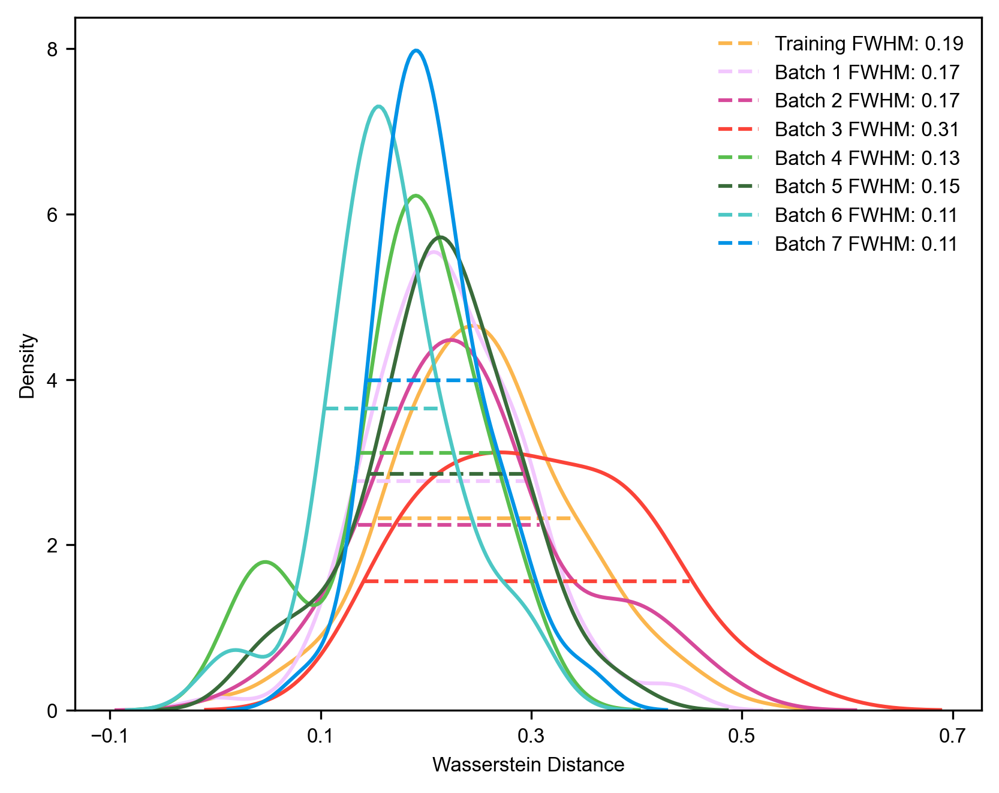

In [43]:
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt

def calculate_fwhm(x, y):
    half_max = max(y) / 2.0
    indices = np.where(y >= half_max)[0]
    fwhm = x[indices[-1]] - x[indices[0]]
    return fwhm, x[indices[0]], x[indices[-1]]

# Plot the density of the Wasserstein distances
plt.figure(figsize=(6.5, 5))
# sns.kdeplot(distances_0, shade=False, label='Training', linestyle='solid')
# sns.kdeplot(distances_1, shade=False, label='Batch 1', linestyle='dashed')
# sns.kdeplot(distances_2, shade=False, label='Batch 2', linestyle='dotted')
# sns.kdeplot(distances_3, shade=False, label='Batch 3', linestyle='dashdot')
# sns.kdeplot(distances_4, shade=False, label='Batch 4', linestyle='solid')
# sns.kdeplot(distances_5, shade=False, label='Batch 5', linestyle='dashed')
# sns.kdeplot(distances_6, shade=False, label='Batch 6', linestyle='dotted')
# sns.kdeplot(distances_7, shade=False, label='Batch 7', linestyle='dashdot')

colors = [orange, pink, purple, red, green, c1, anvil, blue]
# Calculate and plot FWHM for each distribution
i = 0
for distances, label in zip([distances_0, distances_1, distances_2, distances_3, distances_4, distances_5, distances_6, distances_7],
                            ['Training', 'Batch 1', 'Batch 2', 'Batch 3', 'Batch 4', 'Batch 5', 'Batch 6', 'Batch 7']):
    # kde = sns.kdeplot(distances, shade=False, label=label).get_lines()[-1]
    kde = sns.kdeplot(distances, shade=False, color=colors[i]).get_lines()[-1]
    x = kde.get_xdata()
    y = kde.get_ydata()
    fwhm, left_idx, right_idx = calculate_fwhm(x, y)
    plt.plot([left_idx, right_idx], [max(y)/2, max(y)/2], label=f'{label} FWHM: {fwhm:.2f}', linestyle='--', color=colors[i])
    i += 1

plt.legend(frameon=False)  
# plt.title('Density Plot of Wasserstein Distances with FWHM')
plt.xlabel('Wasserstein Distance')
plt.ylabel('Density')
plt.yticks([0, 2, 4, 6, 8])
# plt.yticklabels(['0', '2', '4', '6', '8'])
plt.xticks([-0.1, 0.1, 0.3, 0.5, 0.7])
# plt.show()
plt.savefig('plot_wasserstein_diversity_112524.eps', dpi=300)

In [44]:
def cal_wasserstein_distance_with_reference(df, reference):
    distances = []
    for i in range(len(df)):
        for j in range(len(reference)):
            dist = wasserstein_distance(df.iloc[i], reference.iloc[j])
            distances.append(dist)
    return np.array(distances)

distances_1 = cal_wasserstein_distance_with_reference(features_1, features_0)
distances_2 = cal_wasserstein_distance_with_reference(features_2, features_0)
distances_3 = cal_wasserstein_distance_with_reference(features_3, features_0)
distances_4 = cal_wasserstein_distance_with_reference(features_4, features_0)
distances_5 = cal_wasserstein_distance_with_reference(features_5, features_0)
distances_6 = cal_wasserstein_distance_with_reference(features_6, features_0)
distances_7 = cal_wasserstein_distance_with_reference(features_7, features_0)

# Plot the density of the Wasserstein distances
# plt.figure(figsize=(10, 6))
# sns.kdeplot(distances_1, shade=False, label='Batch 1 vs Training', linestyle='dashed')
# sns.kdeplot(distances_2, shade=False, label='Batch 2 vs Training', linestyle='dotted')
# sns.kdeplot(distances_3, shade=False, label='Batch 3 vs Training', linestyle='dashdot')
# sns.kdeplot(distances_4, shade=False, label='Batch 4 vs Training', linestyle='solid')
# sns.kdeplot(distances_5, shade=False, label='Batch 5 vs Training', linestyle='dashed')
# sns.kdeplot(distances_6, shade=False, label='Batch 6 vs Training', linestyle='dotted')
# sns.kdeplot(distances_7, shade=False, label='Batch 7 vs Training')
# plt.legend(frameon=False)  
# plt.title('Density Plot of Pairwise Wasserstein Distances with Training')
# plt.xlabel('Wasserstein Distance')
# plt.ylabel('Density')
# plt.show()

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/1772876994.py:3: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_1, shade=False, label='Batch 1 vs Training', color=colors[1])
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/1772876994.py:4: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_2, shade=False, label='Batch 2 vs Training', color=colors[2])
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_77630/1772876994.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_3, shade=False, label='Batch 3 vs Training', color=colors[3])
/var/folders/s5/lmr5dh0n4

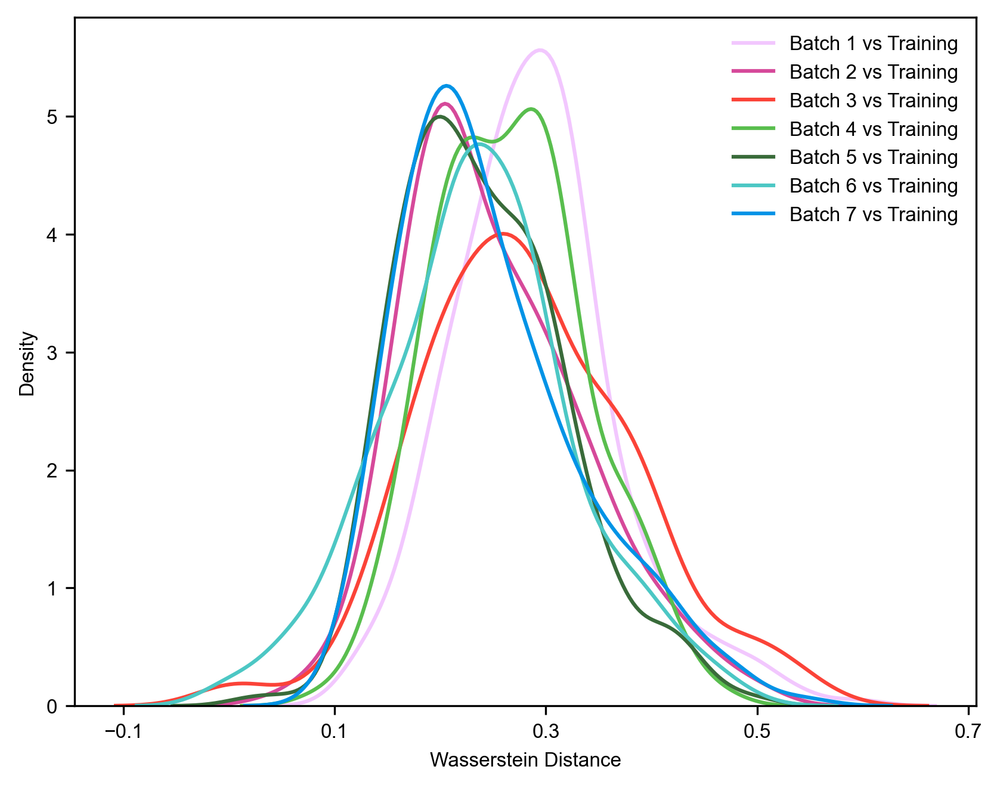

In [46]:
# Plot the density of the Wasserstein distances
plt.figure(figsize=(6.5, 5))
sns.kdeplot(distances_1, shade=False, label='Batch 1 vs Training', color=colors[1])
sns.kdeplot(distances_2, shade=False, label='Batch 2 vs Training', color=colors[2])
sns.kdeplot(distances_3, shade=False, label='Batch 3 vs Training', color=colors[3])
sns.kdeplot(distances_4, shade=False, label='Batch 4 vs Training', color=colors[4])
sns.kdeplot(distances_5, shade=False, label='Batch 5 vs Training', color=colors[5])
sns.kdeplot(distances_6, shade=False, label='Batch 6 vs Training', color=colors[6])
sns.kdeplot(distances_7, shade=False, label='Batch 7 vs Training', color=colors[7])
plt.legend(frameon=False)  
# plt.title('Density Plot of Pairwise Wasserstein Distances with Training')
plt.xlabel('Wasserstein Distance')
plt.ylabel('Density')
plt.xticks([-0.1, 0.1, 0.3, 0.5, 0.7])
# plt.show()
plt.savefig('plot_wasserstein_dissimilar_112524.eps', dpi=300)

In [91]:
features_0.shape
features_1.shape
distances_2.shape

(275,)

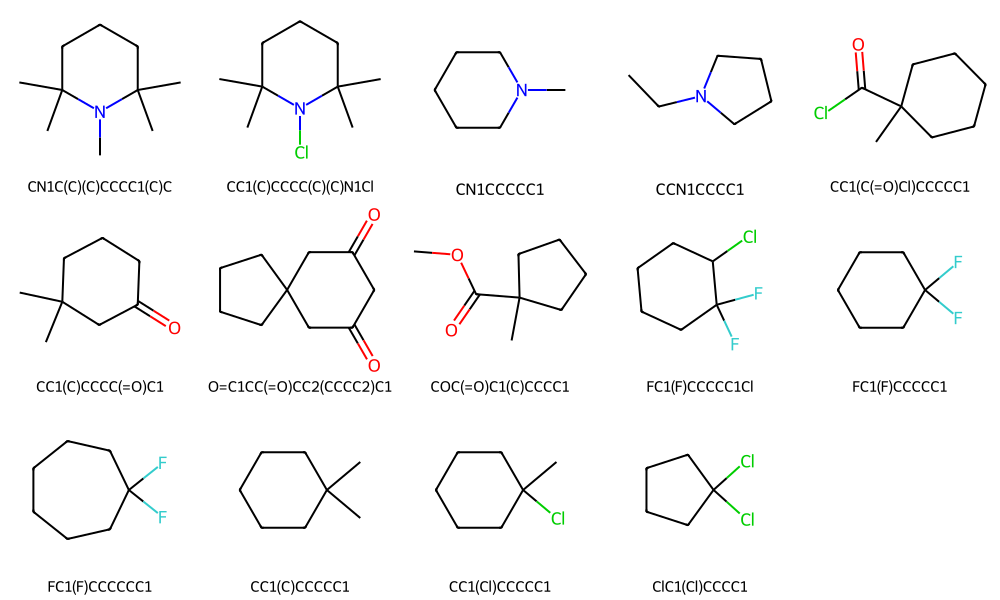

In [6]:
PandasTools.AddMoleculeColumnToFrame(df_l_1, smilesCol='solv_comb_sm')
PandasTools.FrameToGridImage(df_l_1, molsPerRow=5, legendsCol='solv_comb_sm', subImgSize=(200, 200))

In [7]:
df_l_1['solv_comb_sm'].value_counts()

solv_comb_sm
CN1C(C)(C)CCCC1(C)C       1
CC1(C)CCCC(C)(C)N1Cl      1
CN1CCCCC1                 1
CCN1CCCC1                 1
CC1(C(=O)Cl)CCCCC1        1
CC1(C)CCCC(=O)C1          1
O=C1CC(=O)CC2(CCCC2)C1    1
COC(=O)C1(C)CCCC1         1
FC1(F)CCCCC1Cl            1
FC1(F)CCCCC1              1
FC1(F)CCCCCC1             1
CC1(C)CCCCC1              1
CC1(Cl)CCCCC1             1
ClC1(Cl)CCCC1             1
Name: count, dtype: int64

In [8]:
not_label_1 = ['O=C1CC(=O)CC2(CCCC2)C1', 'FC1(F)CCCCC1Cl', 'FC1(F)CCCCC1', 'FC1(F)CCCCCC1', 'CC1(C)CCCCC1', 'CC1(Cl)CCCCC1', 'ClC1(Cl)CCCC1']
not_label_1_mol = [Chem.MolFromSmiles(x) for x in not_label_1]
not_label_1_mol

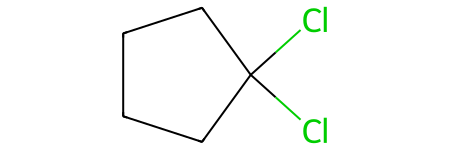

In [15]:
not_label_1_mol[6]

### Wasserstein distance for acquisition from different batches (using ECFP features) <- not using

In [117]:
def get_largest_fragment_from_smiles(s: str):
    mol = Chem.MolFromSmiles(s)
    if mol:
        clean_mol = LargestFragmentChooser().choose(mol)
        return Chem.MolToSmiles(clean_mol)
    return None

def compute_ecfp_descriptors(smiles_list: list):
    """ Computes ecfp descriptors """
    keep_idx = []
    descriptors = []
    for i, smiles in enumerate(smiles_list):
        ecfp = _compute_single_ecfp_descriptor(smiles)
        if ecfp is not None:
            keep_idx.append(i)
            descriptors.append(ecfp)

    return np.vstack(descriptors), keep_idx
    #return np.vstack(descriptors)

def _compute_single_ecfp_descriptor(smiles: str):
    try:
        mol = Chem.MolFromSmiles(smiles)
    except Exception as E:
        return None

    if mol:
        #fp = Chem.AllChem.GetMorganFingerprintAsBitVect(mol, radius=2, nBits=2048)
        fp = Chem.AllChem.GetMorganFingerprintAsBitVect(mol, radius=2, nBits=1024)
        return np.array(fp)
    return None

In [121]:
df_tt = pd.read_csv('label_all_ecfp_pca_add_feat_incl_b7_090824.csv')
ecfp_solv, keep_idx = compute_ecfp_descriptors(df_tt['solv_comb_sm'].to_list())
ecfp_solv.shape

(208, 1024)

In [124]:
for i in range(len(ecfp_solv.T)):
    # print(ecfp_solv[i])
    df_tt[f'ecfp_{i}'] = ecfp_solv.T[i]

df_tt

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/1822275487.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_tt[f'ecfp_{i}'] = ecfp_solv.T[i]
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/1822275487.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_tt[f'ecfp_{i}'] = ecfp_solv.T[i]
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/1822275487.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which 

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,ecfp_1014,ecfp_1015,ecfp_1016,ecfp_1017,ecfp_1018,ecfp_1019,ecfp_1020,ecfp_1021,ecfp_1022,ecfp_1023
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0,0,0,0,0,0,0,0,0,0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0,0,0,0,0,0,0,0,0,0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0,0,0,0,0,0,0,0,0,0
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0,0,0,0,0,0,0,0,0,0
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,CCOCCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
204,COCCCCOCC(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
205,COCCCOCC(C)(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
206,COCCCOCC(F)(F)C(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0


In [125]:
df_l_0 = df_tt.loc[df_tt['batch'] == 0]
df_l_0 = df_l_0.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_0.reset_index(drop=True, inplace=True)
df_l_1 = df_tt.loc[df_tt['batch'] == 1]
df_l_1 = df_l_1.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_1.reset_index(drop=True, inplace=True)
df_l_2 = df_tt.loc[df_tt['batch'] == 2]
df_l_2 = df_l_2.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_2.reset_index(drop=True, inplace=True)
df_l_3 = df_tt.loc[df_tt['batch'] == 3]
df_l_3 = df_l_3.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_3.reset_index(drop=True, inplace=True)
df_l_4 = df_tt.loc[df_tt['batch'] == 4]
df_l_4 = df_l_4.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_4.reset_index(drop=True, inplace=True)
df_l_5 = df_tt.loc[df_tt['batch'] == 5]
df_l_5 = df_l_5.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_5.reset_index(drop=True, inplace=True)
df_l_6 = df_tt.loc[df_tt['batch'] == 6]
df_l_6 = df_l_6.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_6.reset_index(drop=True, inplace=True)
df_l_7 = df_tt.loc[df_tt['batch'] == 7]
df_l_7 = df_l_7.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_7.reset_index(drop=True, inplace=True)
# df_l_1 = df_tt.loc[df_tt['batch'] == 1]
# # df_l_2 = df_tt.loc[df_tt['batch'] == 2]
# # df_l_3 = df_tt.loc[df_tt['batch'] == 3]
# # df_l_4 = df_tt.loc[df_tt['batch'] == 4]
# # df_l_5 = df_tt.loc[df_tt['batch'] == 5]
# # df_l_6 = df_tt.loc[df_tt['batch'] == 6]
# # df_l_7 = df_tt.loc[df_tt['batch'] == 7]
df_l_0

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,ecfp_1014,ecfp_1015,ecfp_1016,ecfp_1017,ecfp_1018,ecfp_1019,ecfp_1020,ecfp_1021,ecfp_1022,ecfp_1023
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0,0,0,0,0,0,0,0,0,0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0,0,0,0,0,0,0,0,0,0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0,0,0,0,0,0,0,0,0,0
3,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0,0,0,0,0,0,0,0,0,0
4,CCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.092295,-1.519334,-0.056200,-0.093036,-0.572012,-0.583818,-0.053796,...,0,0,0,0,0,0,0,0,0,0
5,CCCCOCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.067892,-1.253529,0.602357,0.775134,-0.714364,1.295648,0.646532,...,0,0,0,0,0,0,0,0,0,0
6,COCCOC1CCCC1,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,0.394637,-0.462672,0.854416,-0.416162,-1.007141,1.060702,0.662827,...,0,0,0,0,0,1,0,0,0,0
7,CCCCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.075803,-1.758840,-0.316575,0.667843,-0.912376,0.097061,-0.035434,...,0,0,0,0,0,0,0,0,0,0
8,COCCOCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.899245,-1.039674,1.079794,-0.351354,-0.360827,0.421555,0.804488,...,0,0,0,0,0,0,0,0,0,0
9,FC(F)(F)COCCOCCOCC(F)(F)F,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.657249,-1.593831,0.624976,-0.502685,0.783077,-0.000998,0.897057,...,0,0,0,0,0,0,0,0,0,0


/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/551130853.py:30: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_0, shade=False, label='Training', linestyle='solid')
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/551130853.py:31: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_1, shade=False, label='Batch 1', linestyle='dashed')
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/551130853.py:32: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_2, shade=False, label='Batch 2', linestyle='dotted')
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipy

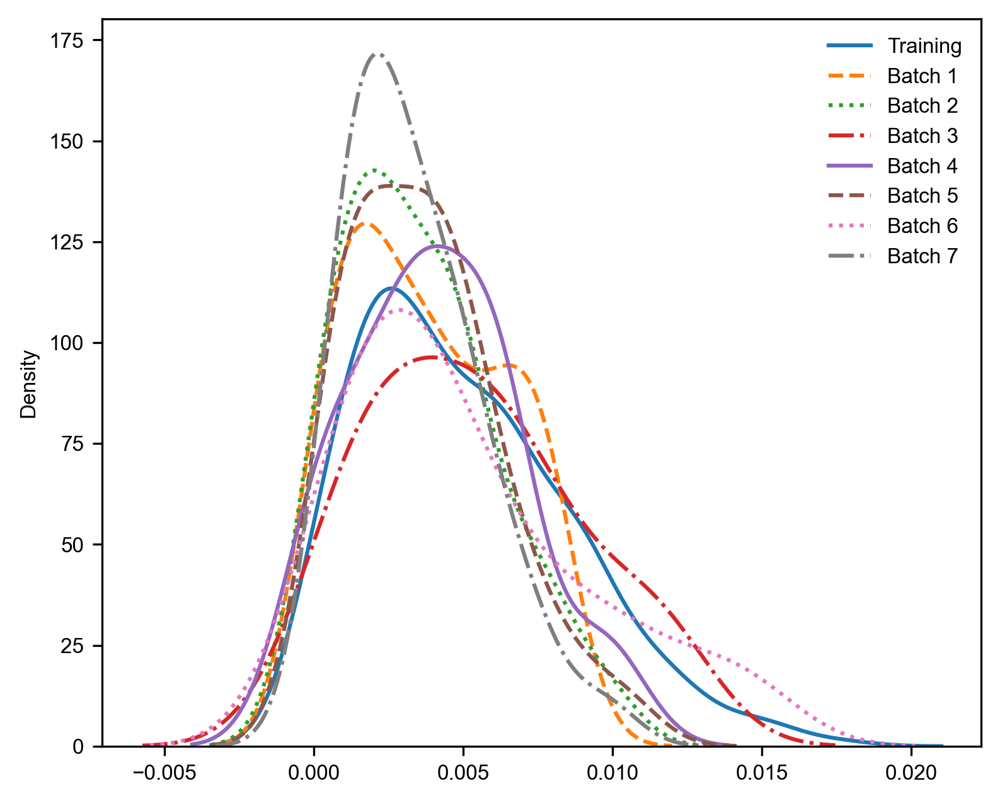

In [130]:
from scipy.stats import wasserstein_distance
features_0 = df_l_0.iloc[:, 54:]
features_1 = df_l_1.iloc[:, 54:]
features_2 = df_l_2.iloc[:, 54:]
features_3 = df_l_3.iloc[:, 54:]
features_4 = df_l_4.iloc[:, 54:]
features_5 = df_l_5.iloc[:, 54:]
features_6 = df_l_6.iloc[:, 54:]
features_7 = df_l_7.iloc[:, 54:]

def cal_wasserstein_distance(df):
    distances = []
    for i in range(len(df)):
        for j in range(i + 1, len(df)):
            dist = wasserstein_distance(df.iloc[i], df.iloc[j])
            distances.append(dist)
    return np.array(distances)

distances_0 = cal_wasserstein_distance(features_0)
distances_1 = cal_wasserstein_distance(features_1)
distances_2 = cal_wasserstein_distance(features_2)
distances_3 = cal_wasserstein_distance(features_3)
distances_4 = cal_wasserstein_distance(features_4)
distances_5 = cal_wasserstein_distance(features_5)
distances_6 = cal_wasserstein_distance(features_6)
distances_7 = cal_wasserstein_distance(features_7)

# Plot the density of the Wasserstein distances
plt.figure(figsize=(6, 5))
sns.kdeplot(distances_0, shade=False, label='Training', linestyle='solid')
sns.kdeplot(distances_1, shade=False, label='Batch 1', linestyle='dashed')
sns.kdeplot(distances_2, shade=False, label='Batch 2', linestyle='dotted')
sns.kdeplot(distances_3, shade=False, label='Batch 3', linestyle='dashdot')
sns.kdeplot(distances_4, shade=False, label='Batch 4', linestyle='solid')
sns.kdeplot(distances_5, shade=False, label='Batch 5', linestyle='dashed')
sns.kdeplot(distances_6, shade=False, label='Batch 6', linestyle='dotted')
sns.kdeplot(distances_7, shade=False, label='Batch 7', linestyle='dashdot')
plt.legend(frameon=False)

/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/1922232421.py:19: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_1, shade=False, label='Batch 1 vs Training', linestyle='dashed')
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/1922232421.py:20: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_2, shade=False, label='Batch 2 vs Training', linestyle='dotted')
/var/folders/s5/lmr5dh0n4bsgnpxrzwlts5lw0000gn/T/ipykernel_47993/1922232421.py:21: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(distances_3, shade=False, label='Batch 3 vs Training', linestyle='dashdot')
/var/folders

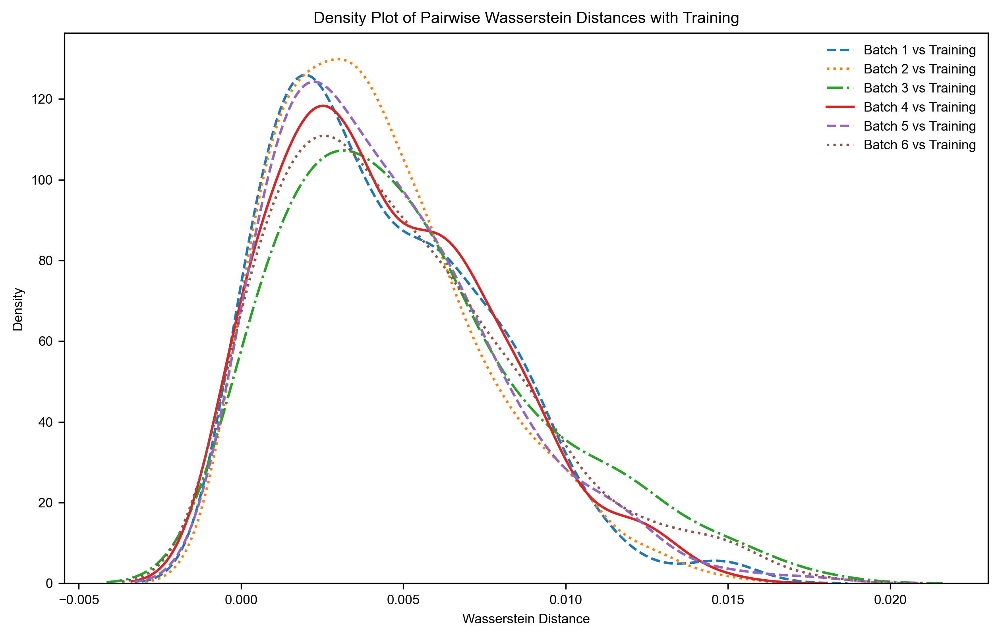

In [131]:
def cal_wasserstein_distance_with_reference(df, reference):
    distances = []
    for i in range(len(df)):
        for j in range(len(reference)):
            dist = wasserstein_distance(df.iloc[i], reference.iloc[j])
            distances.append(dist)
    return np.array(distances)

distances_1 = cal_wasserstein_distance_with_reference(features_1, features_0)
distances_2 = cal_wasserstein_distance_with_reference(features_2, features_0)
distances_3 = cal_wasserstein_distance_with_reference(features_3, features_0)
distances_4 = cal_wasserstein_distance_with_reference(features_4, features_0)
distances_5 = cal_wasserstein_distance_with_reference(features_5, features_0)
distances_6 = cal_wasserstein_distance_with_reference(features_6, features_0)
distances_7 = cal_wasserstein_distance_with_reference(features_7, features_0)

# Plot the density of the Wasserstein distances
plt.figure(figsize=(10, 6))
sns.kdeplot(distances_1, shade=False, label='Batch 1 vs Training', linestyle='dashed')
sns.kdeplot(distances_2, shade=False, label='Batch 2 vs Training', linestyle='dotted')
sns.kdeplot(distances_3, shade=False, label='Batch 3 vs Training', linestyle='dashdot')
sns.kdeplot(distances_4, shade=False, label='Batch 4 vs Training', linestyle='solid')
sns.kdeplot(distances_5, shade=False, label='Batch 5 vs Training', linestyle='dashed')
sns.kdeplot(distances_6, shade=False, label='Batch 6 vs Training', linestyle='dotted')
# sns.kdeplot(distances_7, shade=False, label='Batch 7 vs Training')
plt.legend(frameon=False)  
plt.title('Density Plot of Pairwise Wasserstein Distances with Training')
plt.xlabel('Wasserstein Distance')
plt.ylabel('Density')
plt.show()

In [133]:
distances_0.shape

(300,)

### Calculate Tanimoto coefficient for acquired molecules w.r.t in-house dataset (Nat-Comm-R1:02-25-25)

In [3]:
def get_largest_fragment_from_smiles(s: str):
    mol = Chem.MolFromSmiles(s)
    if mol:
        clean_mol = LargestFragmentChooser().choose(mol)
        return Chem.MolToSmiles(clean_mol)
    return None

def compute_ecfp_descriptors(smiles_list: list):
    """ Computes ecfp descriptors """
    keep_idx = []
    descriptors = []
    for i, smiles in enumerate(smiles_list):
        ecfp = _compute_single_ecfp_descriptor(smiles)
        if ecfp is not None:
            keep_idx.append(i)
            descriptors.append(ecfp)

    return np.vstack(descriptors), keep_idx
    #return np.vstack(descriptors)

def _compute_single_ecfp_descriptor(smiles: str):
    try:
        mol = Chem.MolFromSmiles(smiles)
    except Exception as E:
        return None

    if mol:
        #fp = Chem.AllChem.GetMorganFingerprintAsBitVect(mol, radius=2, nBits=2048)
        fp = Chem.AllChem.GetMorganFingerprintAsBitVect(mol, radius=2, nBits=1024)
        return np.array(fp)
    return None

In [6]:
# df_tt = pd.read_csv('label_all_ecfp_pca_add_feat_incl_b7_090824.csv')
df_tt = pd.read_csv('~/Downloads/label_all_ecfp_pca_add_feat_incl_b7_090824.csv')
df_tt

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.02168,0.022967,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
3,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.00046,0.000360,0.000407,0.0006,0.000593,0.000447,0.000333,0.0,0.0,0.0
4,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.00000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,CCOCCCCOC,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
204,COCCCCOCC(F)(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
205,COCCCOCC(C)(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
206,COCCCOCC(F)(F)C(F)F,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0


In [7]:
ecfp_solv, keep_idx = compute_ecfp_descriptors(df_tt['solv_comb_sm'].to_list())
ecfp_solv.shape

(208, 1024)

In [ ]:
for i in range(len(ecfp_solv.T)):
    # print(ecfp_solv[i])
    df_tt[f'ecfp_{i}'] = ecfp_solv.T[i]

df_tt

In [8]:
df_l_0 = df_tt.loc[df_tt['batch'] == 0]
df_l_0 = df_l_0.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_0.reset_index(drop=True, inplace=True)
df_l_1 = df_tt.loc[df_tt['batch'] == 1]
df_l_1 = df_l_1.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_1.reset_index(drop=True, inplace=True)
df_l_2 = df_tt.loc[df_tt['batch'] == 2]
df_l_2 = df_l_2.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_2.reset_index(drop=True, inplace=True)
df_l_3 = df_tt.loc[df_tt['batch'] == 3]
df_l_3 = df_l_3.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_3.reset_index(drop=True, inplace=True)
df_l_4 = df_tt.loc[df_tt['batch'] == 4]
df_l_4 = df_l_4.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_4.reset_index(drop=True, inplace=True)
df_l_5 = df_tt.loc[df_tt['batch'] == 5]
df_l_5 = df_l_5.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_5.reset_index(drop=True, inplace=True)
df_l_6 = df_tt.loc[df_tt['batch'] == 6]
df_l_6 = df_l_6.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_6.reset_index(drop=True, inplace=True)
df_l_7 = df_tt.loc[df_tt['batch'] == 7]
df_l_7 = df_l_7.drop_duplicates(subset='solv_comb_sm', keep='first')
df_l_7.reset_index(drop=True, inplace=True)
df_l_0

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_15,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test
0,COCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.845301,-0.995151,1.062720,-0.357552,-0.308720,0.309456,0.693325,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,COCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.183255,-0.948338,0.615257,-0.582269,-1.010187,-0.522075,0.496896,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
2,COCCOCC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.240814,-0.970769,0.671105,-0.607789,-1.124651,-0.436617,0.628824,...,0.021680,0.022967,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
3,CCOCCOC(C)(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.879184,-1.539457,0.507075,-0.111830,0.800175,0.133053,0.926130,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
4,CCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.092295,-1.519334,-0.056200,-0.093036,-0.572012,-0.583818,-0.053796,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
5,CCCCOCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.067892,-1.253529,0.602357,0.775134,-0.714364,1.295648,0.646532,...,0.023487,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
6,COCCOC1CCCC1,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,0.394637,-0.462672,0.854416,-0.416162,-1.007141,1.060702,0.662827,...,0.019667,0.019633,0.021167,0.022867,0.026233,0.025507,0.025267,0.0,0.0,0.0
7,CCCCOCCOC(C)C,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-1.075803,-1.758840,-0.316575,0.667843,-0.912376,0.097061,-0.035434,...,0.044827,0.041993,0.037160,0.043613,0.046513,0.048480,0.050413,0.0,0.0,0.0
8,COCCOCCOC,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.899245,-1.039674,1.079794,-0.351354,-0.360827,0.421555,0.804488,...,0.000527,0.000473,0.000447,0.000447,0.000380,0.000427,0.000500,0.0,0.0,0.0
9,FC(F)(F)COCCOCCOCC(F)(F)F,O=S(=O)(F)[N-]S(=O)(=O)F.[Li+],0.0,-0.657249,-1.593831,0.624976,-0.502685,0.783077,-0.000998,0.897057,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0


In [12]:
ref = df_l_0['solv_comb_sm']
ref_mol = [Chem.MolFromSmiles(sm) for sm in ref]
ref_fps = [AllChem.GetMorganFingerprintAsBitVect(mol, 2) for mol in ref_mol]

def check_similarity(smile):
    mol = Chem.MolFromSmiles(smile)
    mol_fps = AllChem.GetMorganFingerprintAsBitVect(mol, 2)
    similarity = [DataStructs.FingerprintSimilarity(mol_fps, ref) for ref in ref_fps]
    max_similarity = max(similarity)
    ind = similarity.index(max_similarity)
    sim_smile = ref[ind]
    return max_similarity
    # return max_similarity, ind, sim_smile

In [ ]:
similarity_list = []
most_similar_array = []

for i in range(len(uniq_list)):
    sm = uniq_list[i]
    max_similarity, ind, sim_sm = check_similarity(sm)
    print(sm, max_similarity, sim_sm)
    similarity_list.append(max_similarity)
    most_similar_array.append(sim_sm)

In [14]:
df_l_1['max_sim'] = df_l_1.apply(lambda x: check_similarity(x['solv_comb_sm']), axis=1)
df_l_2['max_sim'] = df_l_2.apply(lambda x: check_similarity(x['solv_comb_sm']), axis=1)
df_l_3['max_sim'] = df_l_3.apply(lambda x: check_similarity(x['solv_comb_sm']), axis=1)
df_l_4['max_sim'] = df_l_4.apply(lambda x: check_similarity(x['solv_comb_sm']), axis=1)
df_l_5['max_sim'] = df_l_5.apply(lambda x: check_similarity(x['solv_comb_sm']), axis=1)
df_l_6['max_sim'] = df_l_6.apply(lambda x: check_similarity(x['solv_comb_sm']), axis=1)
df_l_7['max_sim'] = df_l_7.apply(lambda x: check_similarity(x['solv_comb_sm']), axis=1)
df_l_1

,solv_comb_sm,salt_comb_sm,batch,solv_ecfp_pca_0,solv_ecfp_pca_1,solv_ecfp_pca_2,solv_ecfp_pca_3,solv_ecfp_pca_4,solv_ecfp_pca_5,solv_ecfp_pca_6,...,norm_capacity_16,norm_capacity_17,norm_capacity_18,norm_capacity_19,norm_capacity_20,norm_capacity_21,norm_capacity_22,norm_capacity_23,expt_test,max_sim
0,CN1C(C)(C)CCCC1(C)C,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,1.154581,-1.168030,0.649902,-0.116636,0.382290,-0.378235,-0.667126,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.100000
1,CC1(C)CCCC(C)(C)N1Cl,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,0.955033,-1.264246,0.621733,-0.341996,0.374763,-0.332263,-0.804000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.096774
2,CN1CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,1.389185,-0.935876,0.111029,0.485331,0.308117,-0.724181,0.398491,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.111111
3,CCN1CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,0.876502,-1.072168,-0.081963,0.736596,0.206000,-0.486059,0.263508,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.150000
4,CC1(C(=O)Cl)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,0.578054,-0.216590,0.983576,-0.309683,0.916454,-0.045955,-1.378522,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.117647
5,CC1(C)CCCC(=O)C1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,0.544321,-0.787394,0.681496,-0.289700,0.458624,0.255901,-0.920301,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.111111
6,O=C1CC(=O)CC2(CCCC2)C1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,0.771488,-1.039048,0.946017,-0.178269,0.757423,-0.206798,-1.220774,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.117647
7,COC(=O)C1(C)CCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,0.048043,0.285709,1.726344,-0.579638,0.175884,0.241914,-0.991960,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.218750
8,FC1(F)CCCCC1Cl,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,1.447440,-1.230973,0.492616,-0.724459,0.302936,0.289000,-0.715427,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.156250
9,FC1(F)CCCCC1,[Li+].[N-](S(=O)(=O)F)S(=O)(=O)F,1.0,0.680281,-1.383992,0.402121,-0.769924,0.378534,-0.445670,-0.916712,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.071429


In [15]:
mean_tc_max_1 = df_l_1['max_sim'].mean()
mean_tc_max_2 = df_l_2['max_sim'].mean()
mean_tc_max_3 = df_l_3['max_sim'].mean()
mean_tc_max_4 = df_l_4['max_sim'].mean()
mean_tc_max_5 = df_l_5['max_sim'].mean()
mean_tc_max_6 = df_l_6['max_sim'].mean()
mean_tc_max_7 = df_l_7['max_sim'].mean()
print(mean_tc_max_1, mean_tc_max_2, mean_tc_max_3, mean_tc_max_4, mean_tc_max_5, mean_tc_max_6, mean_tc_max_7)

0.11505579552300464 0.3847744084258848 0.5913700745998883 0.4444839715203759 0.5419509179884674 0.6348725554259151 0.5257358568504079


### ignore below...

In [40]:
tt = df_tsne.copy()
tt['norm_capacity_3'] = 0.0

solv_to_cap = dict(zip(filtered_df_label_all['solv_comb_sm'], filtered_df_label_all['norm_capacity_3']))
tt['norm_capacity_3'] = tt['std_smiles'].map(solv_to_cap)
tt

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,norm_capacity_3
0,CN(C)C=O,-1.0,['Amide'],0,-29.652721,-91.122684,NaN
1,CN1CCN(C)C1=O,-1.0,['Amide'],0,63.663623,30.721911,NaN
2,CN(C)C(=O)N(C)C,-1.0,['Amide'],0,-63.760388,9.938176,NaN
3,CB(C)C=O,-1.0,['Others'],1,-11.815345,-51.883275,NaN
4,[CH2]N(C)C=O,-1.0,['Amide'],0,-29.670045,-91.193283,NaN
...,...,...,...,...,...,...,...
388008,COCCOCC1CCCO1,0.0,['Ether'],7,-20.242432,-20.010327,NaN
388009,FC(F)COCCOCC(F)F,-1.0,['Ether'],7,4.972566,-54.523802,NaN
388010,FC(F)COCCOCC(F)(F)F,8.0,['Ether'],7,23.341277,-78.180018,NaN
388011,FCCOCCF,-1.0,['Ether'],7,16.235649,-47.809552,NaN


In [41]:
tt.loc[tt['expt_test'] == 0]
# tt.loc[tt['expt_test'] == 1]
# tt.loc[tt['expt_test'] == 2]
# tt.loc[tt['expt_test'] == 3]
# tt.loc[tt['expt_test'] == 4]
# tt.loc[tt['expt_test'] == 5]
# tt.loc[tt['expt_test'] == 6]
# tt.loc[tt['expt_test'] == 7]

,std_smiles,expt_test,class,class_id,tsne_0,tsne_1,norm_capacity_3
28126,CCOCCOCC,0.0,['Ether'],7,0.496001,-47.439290,0.770133
36387,CCS(=O)(=O)F,0.0,['Sulfonyl fluoride'],98,-28.999701,-51.292300,0.718571
103377,CCOCCS(=O)(=O)F,0.0,"['Sulfonyl fluoride', 'Ether']",153,-23.684909,-42.022341,0.077533
333568,COCCOC,0.0,['Ether'],7,-7.776405,-45.004559,0.761182
333838,COCCOCCOC,0.0,['Ether'],7,-8.224551,-46.568119,0.112013
333855,CCCCOCCOC,0.0,['Ether'],7,-7.112939,-48.987523,0.285020
333859,COCCOC(C)C,0.0,['Ether'],7,-4.673338,-59.285648,0.745733
333915,COCCOC(C)(C)C,0.0,['Ether'],7,22.218557,-87.166777,0.276148
334365,FCCOCCOCCF,0.0,['Ether'],7,16.220142,-47.850935,0.243500
334890,CCOCCOC(C)(C)C,0.0,['Ether'],7,26.010677,-83.126759,0.026187


In [48]:
tt.loc[tt['std_smiles'] == 'COCCOCC1CCCO1', 'norm_capacity_3'] = 0.000204

StopIteration: 

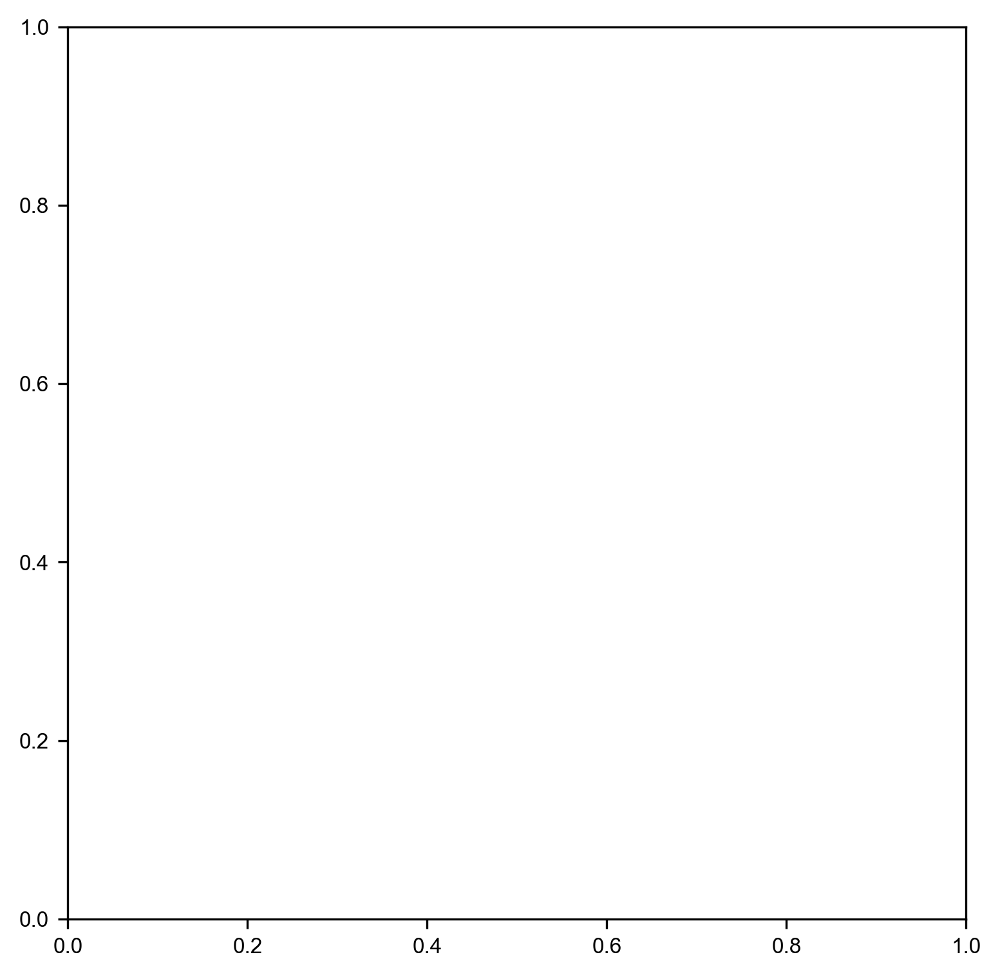

In [56]:
# Define the colors list
colors = ['gray', green, red, c4, orange, c1, anvil, dark_purple, purple, pink]

# Create a colormap for each color that transitions from white to the specified color
colormaps = [mcolors.LinearSegmentedColormap.from_list(f'cmap_{i}', ['white', color]) for i, color in enumerate(colors)]

fig, ax = plt.subplots(figsize=(6, 6))
classes = tt['expt_test'].unique()
classes_names = ['Unlabeled', 'Batch-4', 'Batch-1', 'Batch-7', 'Batch-5', 'Batch-2', 'Batch-3', 'Batch-6', 'Training', 'F5DEE']
sizes = [0.5, 15, 15, 15, 15, 15, 15, 15, 15, 20]
shapes = ['o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 's', '^']
e_colors = [None, 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black']
l_widths = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
i = 0

for cls in classes:
    df_cls = tt.loc[tt['expt_test'] == cls]
    norm = mcolors.Normalize(vmin=df_cls['norm_capacity_3'].min(), vmax=df_cls['norm_capacity_3'].max())
    cmap = colormaps[i]
    scatter = ax.scatter(df_cls['tsne_0'], df_cls['tsne_1'], label=classes_names[i], alpha=1.0, c=df_cls['norm_capacity_3'], cmap=cmap, edgecolor=e_colors[i], linewidth=l_widths[i], s=sizes[i], marker=shapes[i])
    
    # Add colorbar for each class
    cbar = plt.colorbar(scatter, ax=ax, orientation='vertical', fraction=0.02, pad=0.04)
    cbar.set_label(classes_names[i])
    
    i += 1

# plt.legend(bbox_to_anchor=(0.92, 0.95), loc='upper left', frameon=False)
plt.xticks([])
plt.yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)
# plt.savefig('tsne_trial_{}_open.tiff'.format(trial), dpi=300)
plt.show()

In [54]:
df_cls
colors

array([[0., 0., 0., 0.],
       [0., 0., 0., 0.]])

In [55]:
ax.scatter(df_cls['tsne_0'], df_cls['tsne_1'], label=classes_names[i], alpha=1.0, cmap=cmap., edgecolor=e_colors[i], linewidth=l_widths[i], s=sizes[i], marker=shapes[i])

IndexError: list index out of range

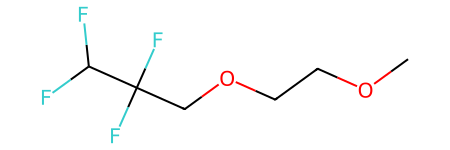

In [89]:
Chem.MolFromSmiles('COCC(F)(F)C(F)(F)COC')
Chem.MolFromSmiles('FC(F)COCCOCC(F)F')
Chem.MolFromSmiles('FC(F)(F)COCCOCCOCC(F)(F)F')
Chem.MolFromSmiles('FC(F)COCCOCC(F)(F)F')
Chem.MolFromSmiles('CC(C)(C)C(=O)OCC(F)F')
Chem.MolFromSmiles('FCCOCCF')
Chem.MolFromSmiles('CC(C)(C)C(=O)OCC(F)F') # 1
Chem.MolFromSmiles('CC1OCCCO1') # 2
Chem.MolFromSmiles('CC1(C)OCC(CF)O1') # 3
Chem.MolFromSmiles('COCCOCC(F)(F)C(F)F') # 3

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


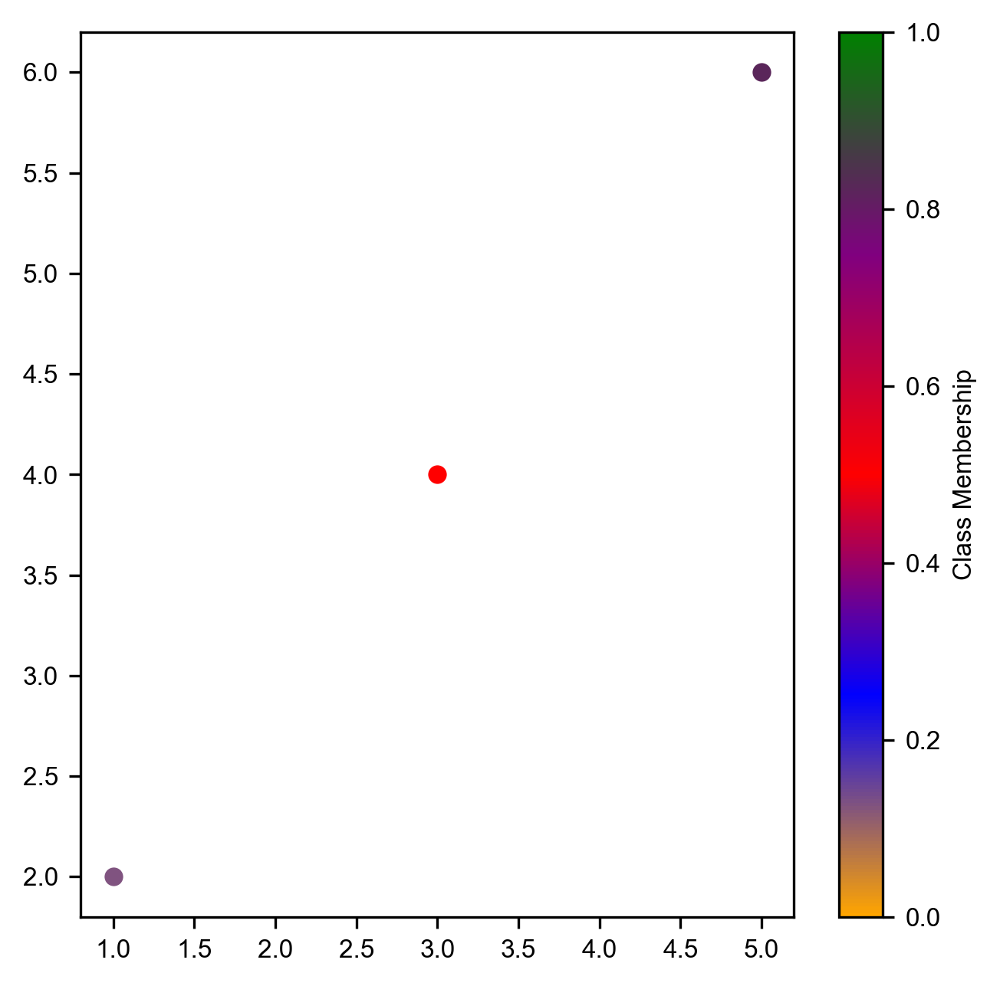

In [19]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import to_rgba, LinearSegmentedColormap

# Define colors for each class
colors = {
    'PubChem': to_rgba('orange'),
    'eMolecules': to_rgba('blue'),
    'Literature': to_rgba('red'),
    'Expt': to_rgba('purple'),
    'SOTA': to_rgba('green'),
}

# Function to blend colors
def blend_colors(color_weights):
    blended_color = np.zeros(4)  # RGBA
    total_weight = sum(color_weights.values())
    for color, weight in color_weights.items():
        blended_color += np.array(colors[color]) * (weight / total_weight)
    return blended_color

# Example data with class memberships
data = [
    {'coords': (1, 2), 'classes': {'PubChem': 0.5, 'eMolecules': 0.5}},
    {'coords': (3, 4), 'classes': {'Literature': 1.0}},
    {'coords': (5, 6), 'classes': {'Expt': 0.7, 'SOTA': 0.3}},
    # Add more data points as needed
]

fig, ax = plt.subplots(figsize=(5, 5))

# Plot each data point with blended color
for point in data:
    coords = point['coords']
    color_weights = point['classes']
    blended_color = blend_colors(color_weights)
    ax.scatter(coords[0], coords[1], color=blended_color, s=40, edgecolors='white', linewidth=0.5)

# Create a custom colormap for the color bar
cmap = LinearSegmentedColormap.from_list('custom_cmap', list(colors.values()), N=256)

# Create a color bar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=0, vmax=1))
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('Class Membership')

# plt.xlim(-40, 0)
# plt.ylim(-13, 40)
plt.legend(frameon=False)
plt.show()